In [1]:
import pandas as pd
import numpy as np
import gym
import tensorflow as tf
from tqdm.notebook import trange,tqdm
from matplotlib import pyplot as plt

In [2]:
%matplotlib inline
tf.get_logger().setLevel("ERROR")

In [3]:
def calculate_pendulum_coords(length, angle):
        x = length * np.sin(angle)
        y = -length * np.cos(angle)
        return x, y

In [4]:
class RLHFAgent:
    def __init__(self, env):
        self.env = env
        self.n_observations = env.observation_space.shape[0]
        self.n_actions = env.action_space.n
        self.model = self.build_model()

    def build_model(self):
        """Build a neural network model that maps observations to actions."""
        model = tf.keras.Sequential(
            [
                tf.keras.layers.Dense(
                    16, activation="relu", input_shape=(self.n_observations,)
                ),
                tf.keras.layers.Dense(16, activation="relu"),
                tf.keras.layers.Dense(self.n_actions, activation="softmax"),
            ]
        )
        model.compile(
            optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
            loss="categorical_crossentropy",
            metrics=["accuracy"],
        )
        return model

    def generate_action(self, observation):
        """Generate an action based on the observation.
        Different policies can be used here."""
        observation = np.reshape(observation, [1, self.n_observations])
        action_probabilities = self.model.predict(observation)[0]
        # takes a random action with probability proportional to its probability
        action = np.random.choice(self.n_actions, p=action_probabilities)
        return action

    def update_policy(self, observation, action, feedback):
        """Update the policy based on the feedback.
        Here this means we update the model that predicts actions from observations."""
        observation = np.reshape(observation, [1, self.n_observations])
        action_probabilities = self.model.predict(observation)[0]
        action_mask = np.zeros(self.n_actions)
        action_mask[action] = 1
        feedback = np.array([feedback])
        X = observation
        y = feedback * (action_mask - action_probabilities)
        y = np.reshape(y, (1, self.n_actions))
        loss = self.model.train_on_batch(X, y)
        return loss

    def feedback_from_reward_model(self, observation, action):
        """Get feedback from the user."""
        if observation[0] < -0.5 or observation[0] > 0.5:
            return 0
        else:
            return 100
        
    def run_episode(self, render=False):
        observation, info = self.env.reset()

        terminated = False
        total_reward = 0
        step = 0
        global episodic_loss
        episodic_loss = []
        
        while not terminated:
            
            step += 1
            length = 0.2
            
            cart_position=observation[0]
            cart_velocity=observation[1]
            pole_angle=observation[2]
            pole_velocity=observation[3]
            
            angle = pole_angle*0.01745329
            x_pendulum, y_pendulum = calculate_pendulum_coords(length, angle)

            print("\nSTEP: ",step)
            print("CART POSITION: ",cart_position)
            print("CART VELOCITY: ",cart_velocity)
            print("POLE ANGLE WRT CART: ",pole_angle)
            print("VELOCITY AT TOP OF POLE: ",pole_velocity)
            
            action = self.generate_action(observation)
            if action==0:
                print("ACTION: Push cart to left")
            elif action==1:
                print("ACTION: Push cart to right")
            
            fig, ax = plt.subplots()
            ax.plot(cart_position, [0], 'ko', label='Cart')  # Cart represented by a dot
            ax.plot([cart_position, x_pendulum], [0, y_pendulum], 'b')  # Pendulum
            ax.plot(x_pendulum, y_pendulum, 'bo', label='Pendulum Bob')  # Pendulum bob
            ax.set_aspect('equal', 'box')  # Equal aspect ratio
            ax.set_xlim([-1, 1])  # Setting x-axis limits
            ax.set_ylim([-1, 1])  # Setting y-axis limits
            ax.set_xlabel('X')  # Label for x-axis
            ax.set_ylabel('Y')  # Label for y-axis
            ax.set_title('CartPole Visualization')  # Title of the plot
            ax.legend()  # Display legend
            plt.grid(True)  # Display grid
            plt.show()
            
            
            observation, reward, terminated, truncated, info = self.env.step(action)
            plt.imshow(self.env.render())
            total_reward += reward
            
            #feedback = int(input("was the action good? (0/1)"))
            feedback = self.feedback_from_reward_model(observation, action)
            
            loss = self.update_policy(observation, action, feedback)
            episodic_loss.append(loss)
            
        return total_reward

In [5]:
env = gym.make("CartPole-v1", render_mode="rgb_array")
agent = RLHFAgent(env)

In [6]:
n_episodes = 50
episodic_rewards = []

  0%|          | 0/50 [00:00<?, ?it/s]


STEP:  1
CART POSITION:  -0.039784286
CART VELOCITY:  0.0004070864
POLE ANGLE WRT CART:  0.042930372
VELOCITY AT TOP OF POLE:  0.016473595
ACTION: Push cart to right


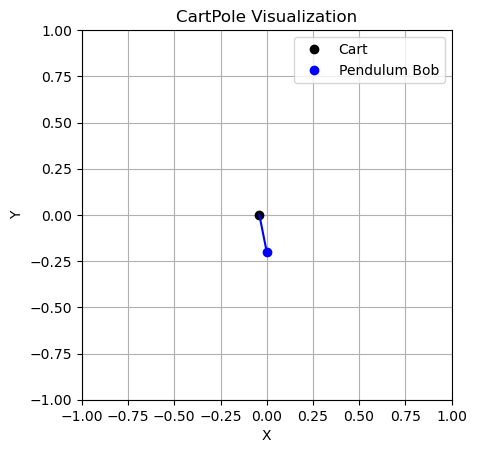


STEP:  2
CART POSITION:  -0.039776146
CART VELOCITY:  0.1948879
POLE ANGLE WRT CART:  0.043259844
VELOCITY AT TOP OF POLE:  -0.2623612
ACTION: Push cart to right


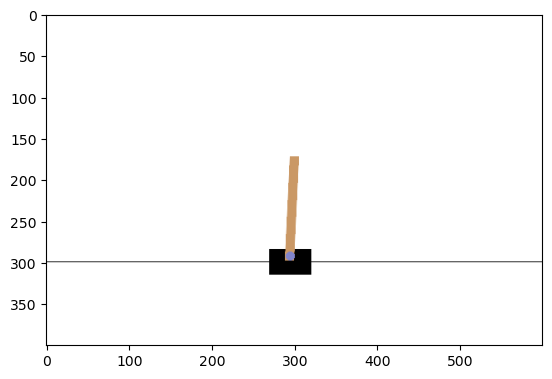

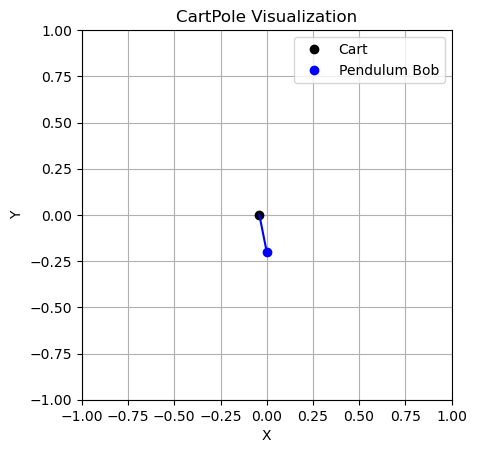


STEP:  3
CART POSITION:  -0.035878386
CART VELOCITY:  0.3893665
POLE ANGLE WRT CART:  0.03801262
VELOCITY AT TOP OF POLE:  -0.54109174
ACTION: Push cart to right


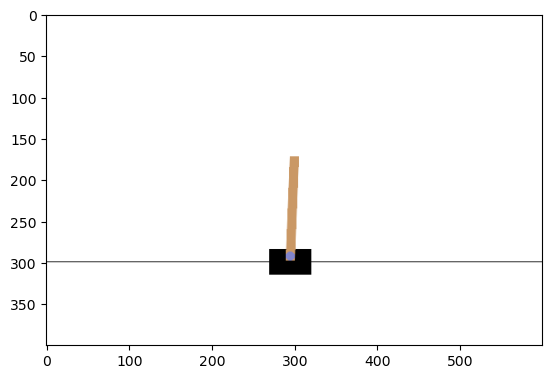

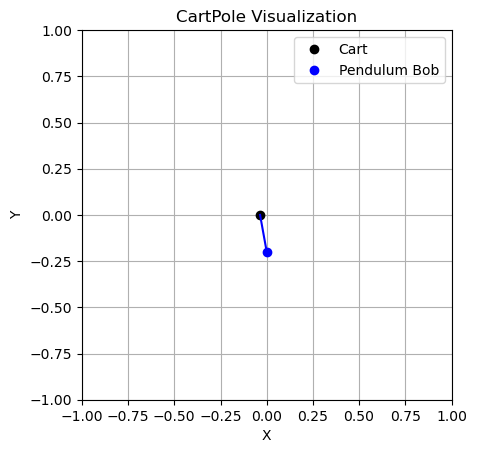


STEP:  4
CART POSITION:  -0.028091058
CART VELOCITY:  0.5839341
POLE ANGLE WRT CART:  0.027190784
VELOCITY AT TOP OF POLE:  -0.8215593
ACTION: Push cart to right


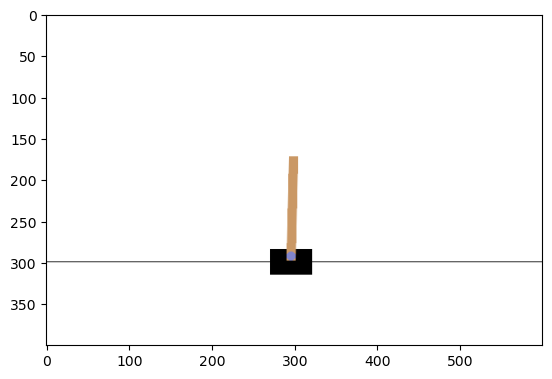

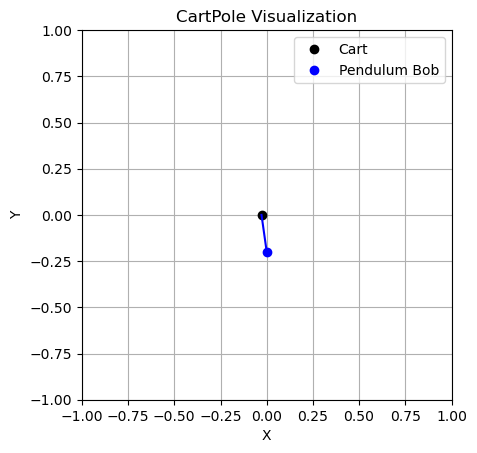


STEP:  5
CART POSITION:  -0.016412375
CART VELOCITY:  0.7786737
POLE ANGLE WRT CART:  0.010759597
VELOCITY AT TOP OF POLE:  -1.1055676
ACTION: Push cart to right


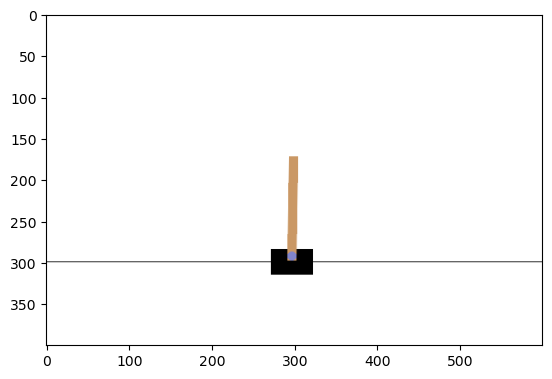

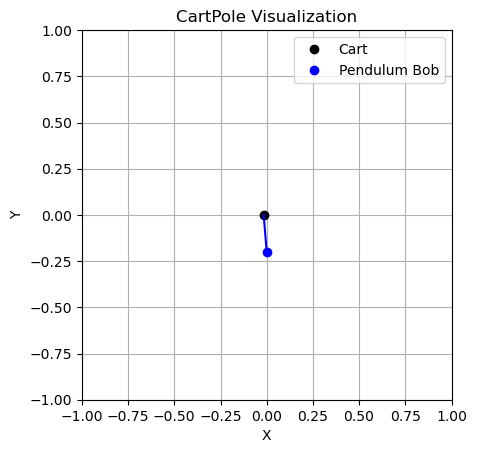


STEP:  6
CART POSITION:  -0.000838901
CART VELOCITY:  0.97365254
POLE ANGLE WRT CART:  -0.011351756
VELOCITY AT TOP OF POLE:  -1.3948556
ACTION: Push cart to right


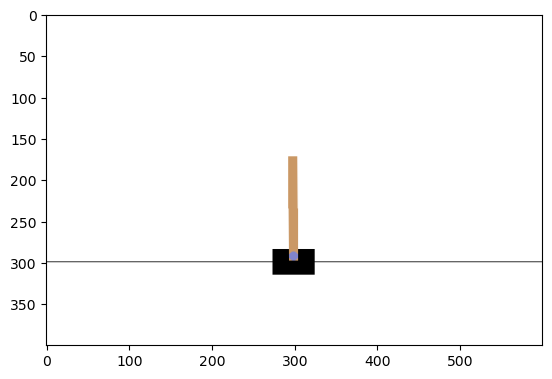

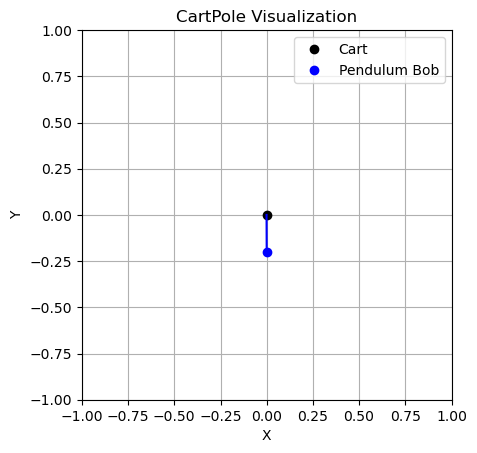


STEP:  7
CART POSITION:  0.01863415
CART VELOCITY:  1.1689138
POLE ANGLE WRT CART:  -0.03924887
VELOCITY AT TOP OF POLE:  -1.6910661
ACTION: Push cart to right


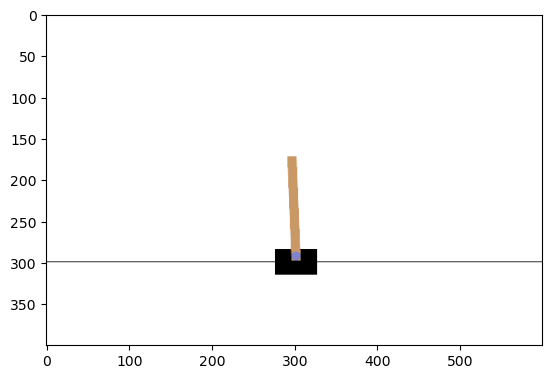

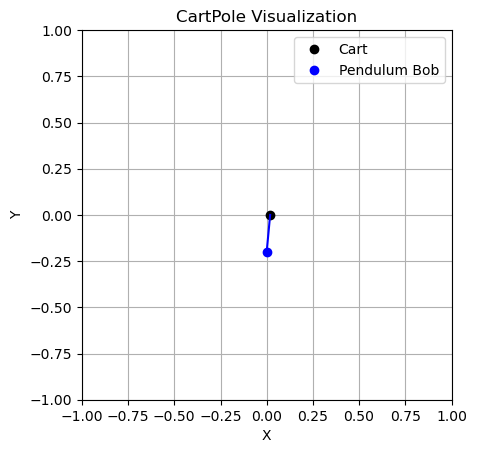


STEP:  8
CART POSITION:  0.042012427
CART VELOCITY:  1.3644667
POLE ANGLE WRT CART:  -0.07307019
VELOCITY AT TOP OF POLE:  -1.9957056
ACTION: Push cart to right


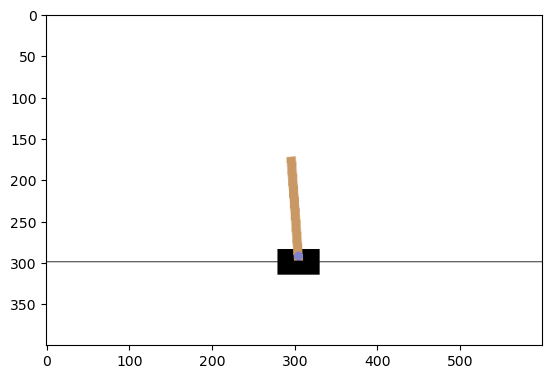

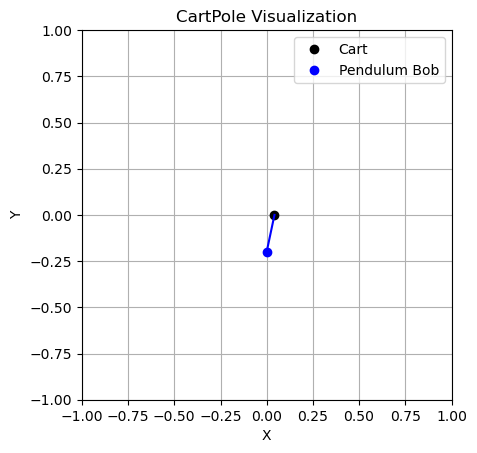


STEP:  9
CART POSITION:  0.06930176
CART VELOCITY:  1.5602727
POLE ANGLE WRT CART:  -0.1129843
VELOCITY AT TOP OF POLE:  -2.3100946
ACTION: Push cart to right


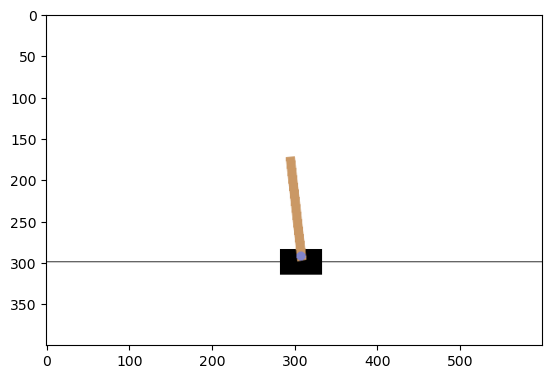

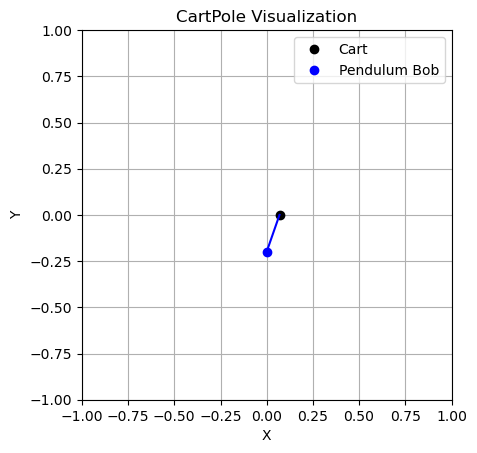


STEP:  10
CART POSITION:  0.100507215
CART VELOCITY:  1.756232
POLE ANGLE WRT CART:  -0.1591862
VELOCITY AT TOP OF POLE:  -2.6353061
ACTION: Push cart to right


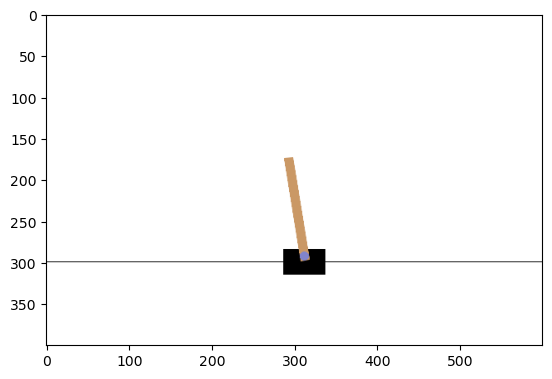

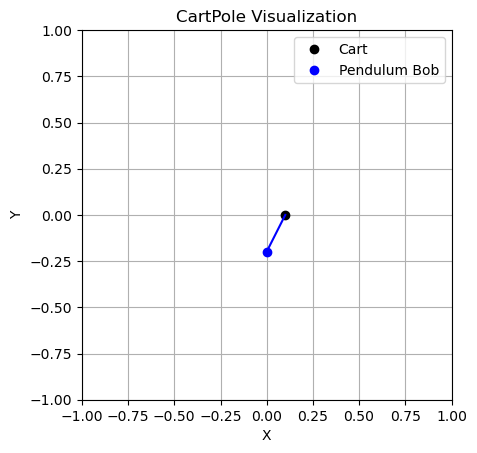


STEP:  1
CART POSITION:  0.00029824476
CART VELOCITY:  0.0012673844
POLE ANGLE WRT CART:  0.02704969
VELOCITY AT TOP OF POLE:  -0.025838647
ACTION: Push cart to right


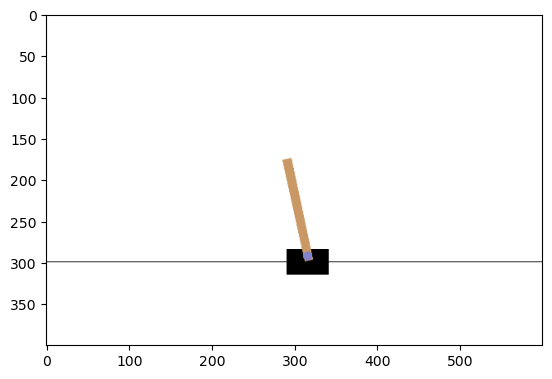

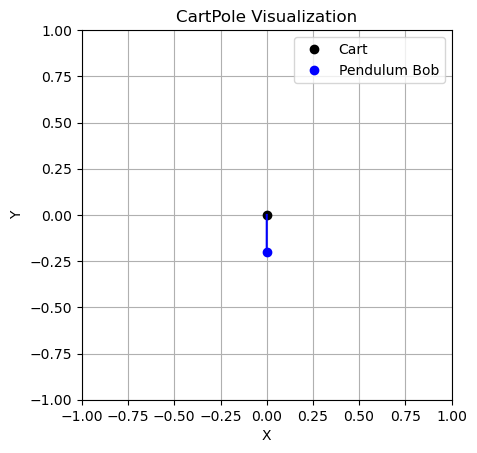


STEP:  2
CART POSITION:  0.00032359242
CART VELOCITY:  0.19599119
POLE ANGLE WRT CART:  0.026532918
VELOCITY AT TOP OF POLE:  -0.30986586
ACTION: Push cart to right


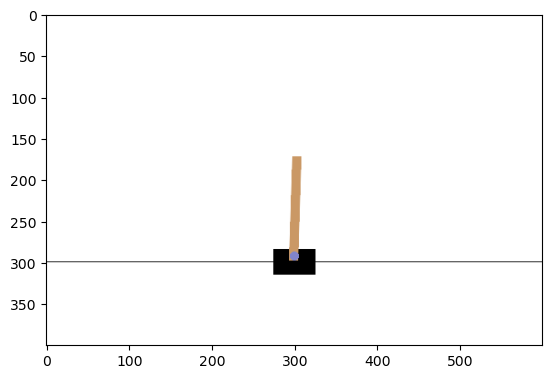

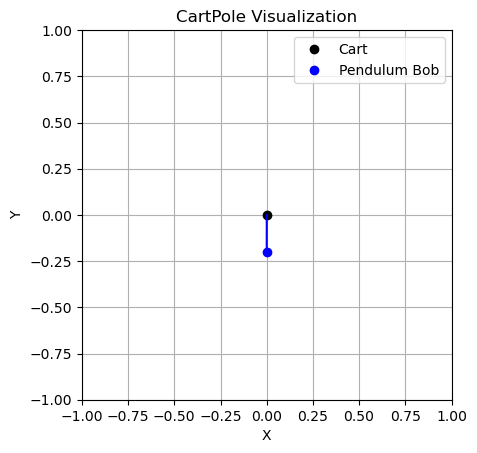


STEP:  3
CART POSITION:  0.0042434162
CART VELOCITY:  0.39072526
POLE ANGLE WRT CART:  0.020335602
VELOCITY AT TOP OF POLE:  -0.5940644
ACTION: Push cart to right


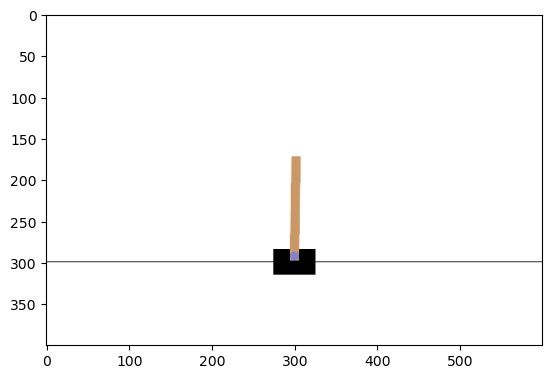

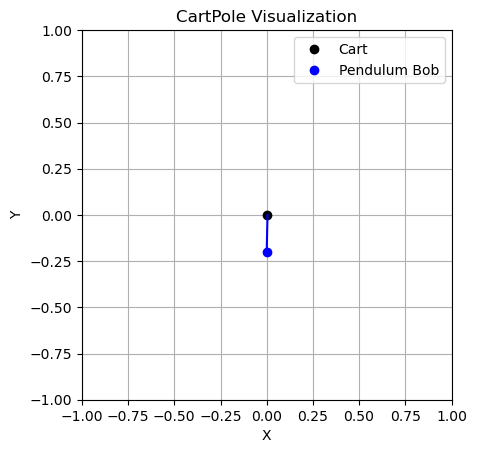


STEP:  4
CART POSITION:  0.012057921
CART VELOCITY:  0.58555675
POLE ANGLE WRT CART:  0.0084543135
VELOCITY AT TOP OF POLE:  -0.8802729
ACTION: Push cart to right


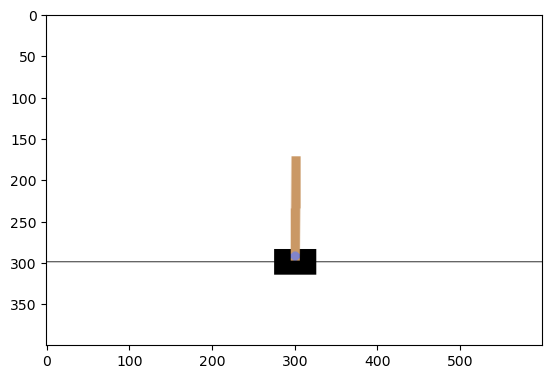

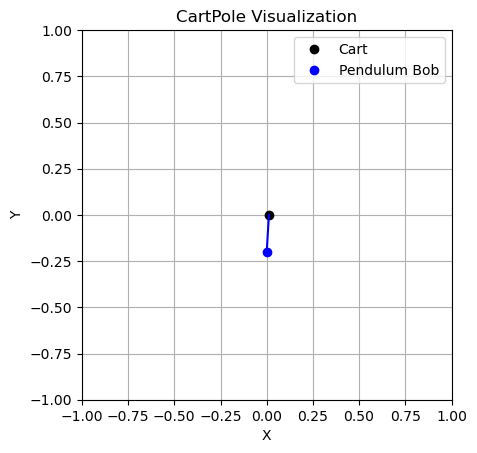


STEP:  5
CART POSITION:  0.023769056
CART VELOCITY:  0.7805628
POLE ANGLE WRT CART:  -0.009151146
VELOCITY AT TOP OF POLE:  -1.170286
ACTION: Push cart to right


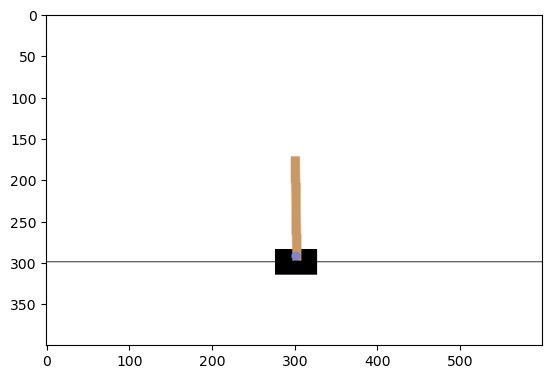

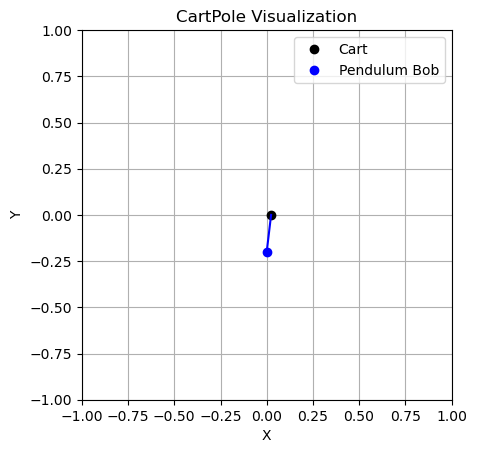


STEP:  6
CART POSITION:  0.039380312
CART VELOCITY:  0.9758026
POLE ANGLE WRT CART:  -0.03255687
VELOCITY AT TOP OF POLE:  -1.4658239
ACTION: Push cart to right


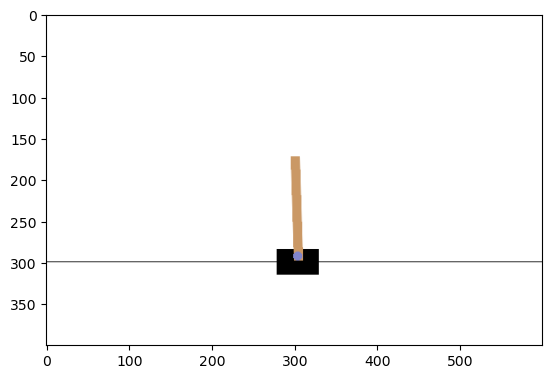

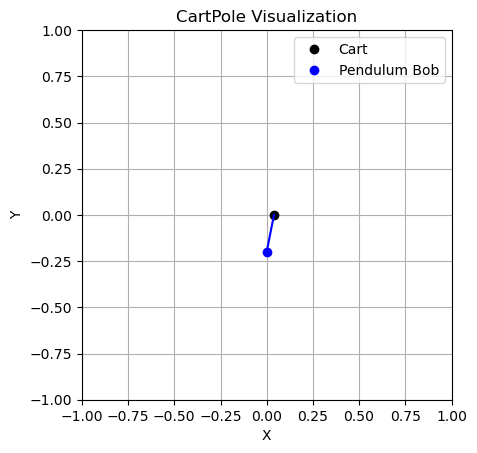


STEP:  7
CART POSITION:  0.058896367
CART VELOCITY:  1.1713077
POLE ANGLE WRT CART:  -0.061873343
VELOCITY AT TOP OF POLE:  -1.7684962
ACTION: Push cart to right


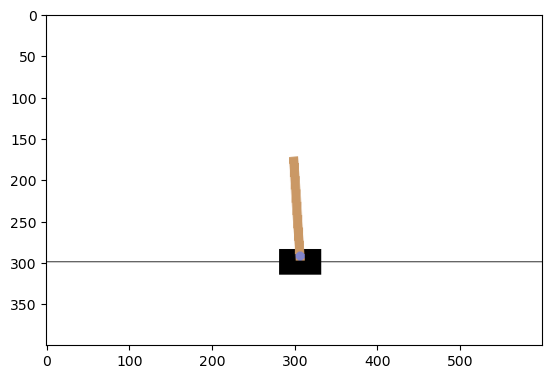

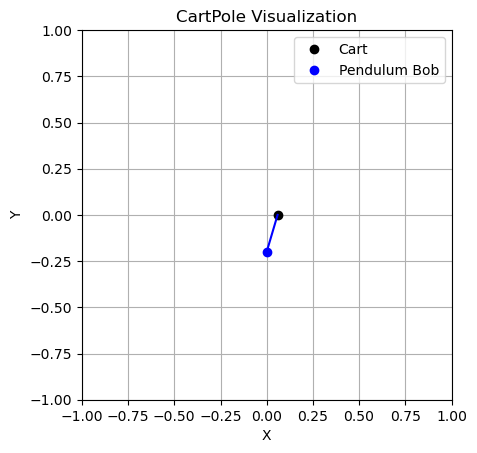


STEP:  8
CART POSITION:  0.08232252
CART VELOCITY:  1.3670714
POLE ANGLE WRT CART:  -0.09724327
VELOCITY AT TOP OF POLE:  -2.079759
ACTION: Push cart to right


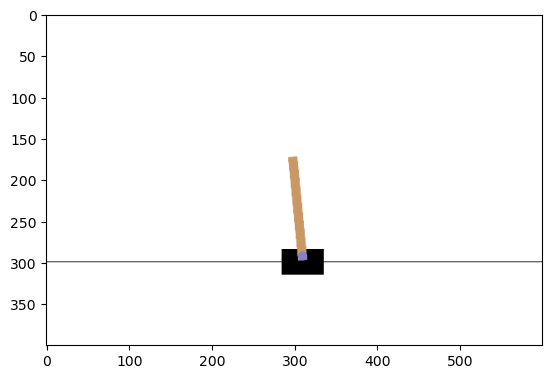

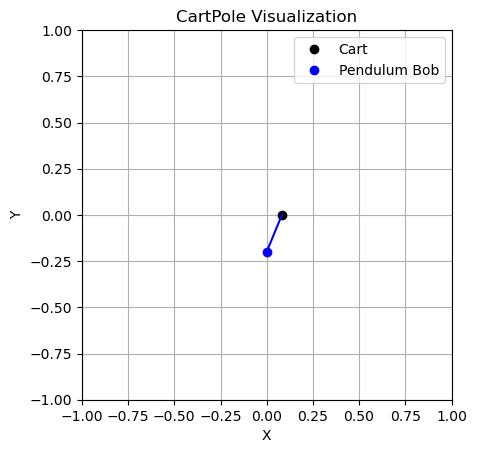


STEP:  9
CART POSITION:  0.10966395
CART VELOCITY:  1.5630343
POLE ANGLE WRT CART:  -0.13883844
VELOCITY AT TOP OF POLE:  -2.4008589
ACTION: Push cart to right


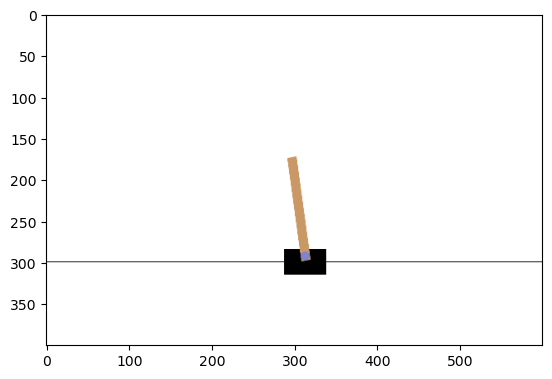

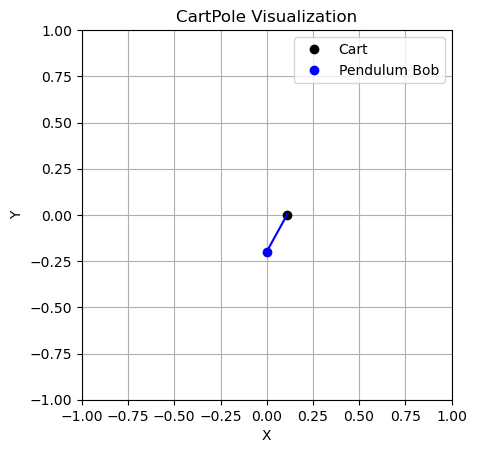


STEP:  10
CART POSITION:  0.14092463
CART VELOCITY:  1.7590688
POLE ANGLE WRT CART:  -0.18685563
VELOCITY AT TOP OF POLE:  -2.7327688
ACTION: Push cart to right


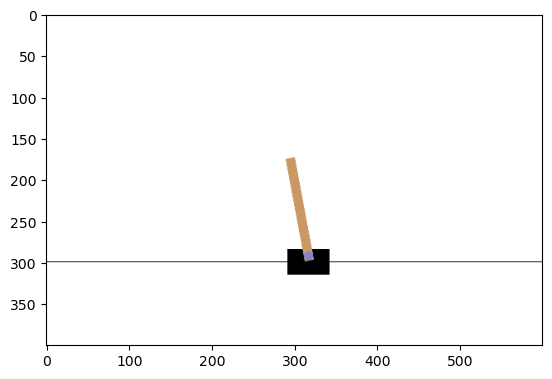

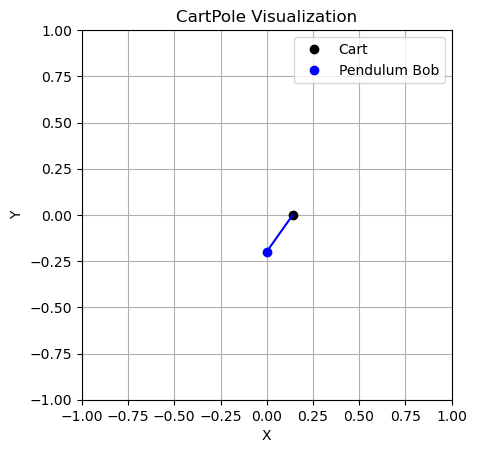


STEP:  1
CART POSITION:  -0.03702678
CART VELOCITY:  0.016253175
POLE ANGLE WRT CART:  0.007564224
VELOCITY AT TOP OF POLE:  -0.014717885
ACTION: Push cart to left


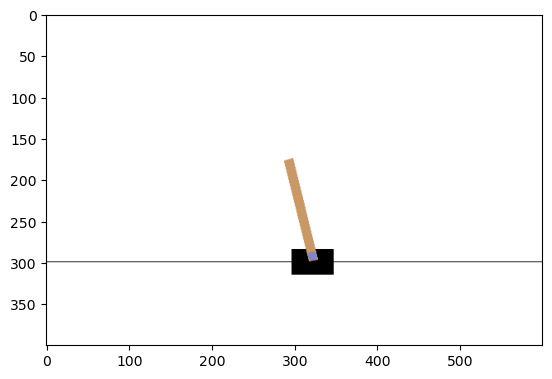

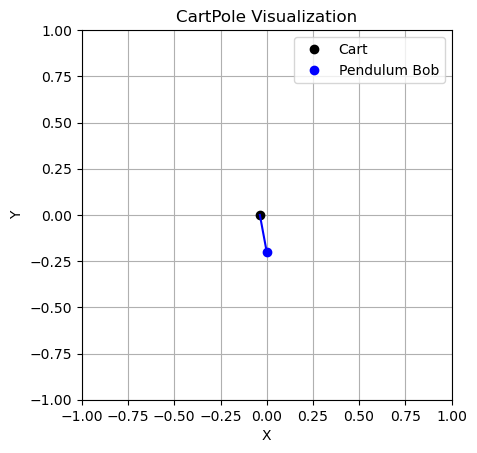


STEP:  2
CART POSITION:  -0.03670172
CART VELOCITY:  -0.17897643
POLE ANGLE WRT CART:  0.007269866
VELOCITY AT TOP OF POLE:  0.280342
ACTION: Push cart to left


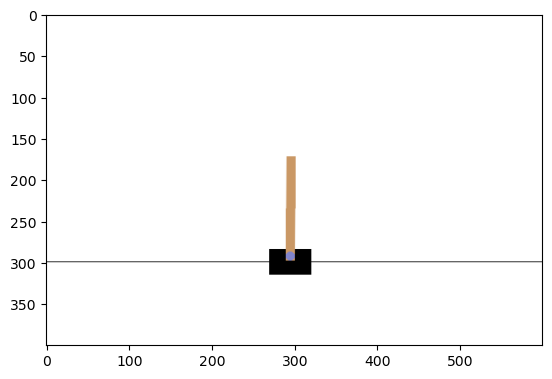

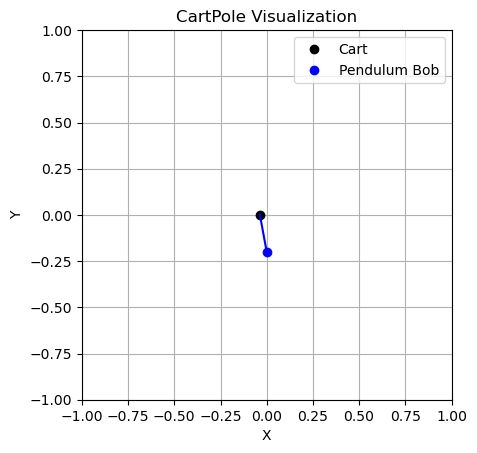


STEP:  3
CART POSITION:  -0.040281247
CART VELOCITY:  -0.37420133
POLE ANGLE WRT CART:  0.012876706
VELOCITY AT TOP OF POLE:  0.5753089
ACTION: Push cart to left


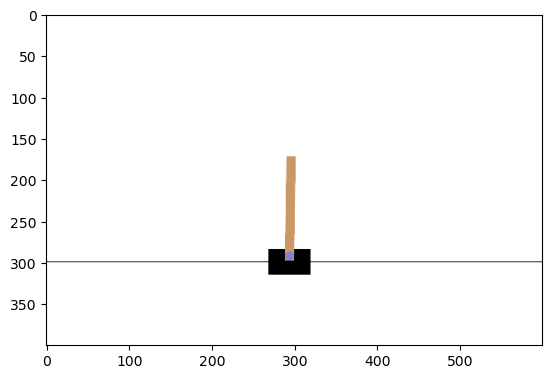

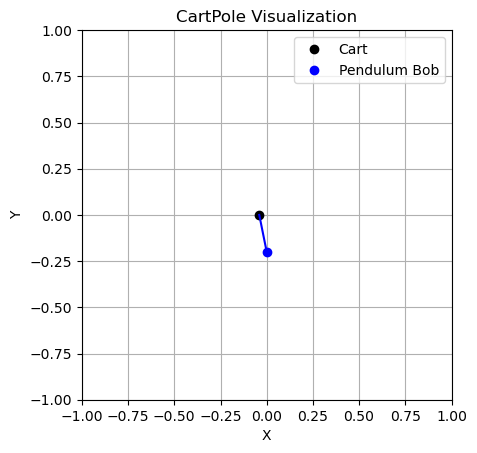


STEP:  4
CART POSITION:  -0.047765274
CART VELOCITY:  -0.5695014
POLE ANGLE WRT CART:  0.024382886
VELOCITY AT TOP OF POLE:  0.8720204
ACTION: Push cart to left


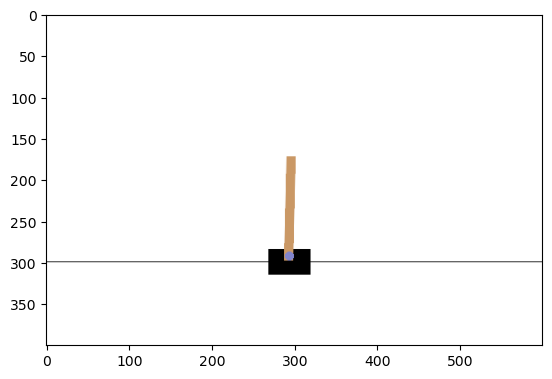

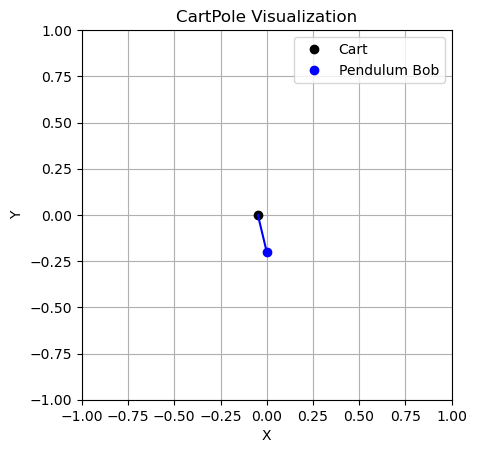


STEP:  5
CART POSITION:  -0.059155304
CART VELOCITY:  -0.76494634
POLE ANGLE WRT CART:  0.041823294
VELOCITY AT TOP OF POLE:  1.1722685
ACTION: Push cart to right


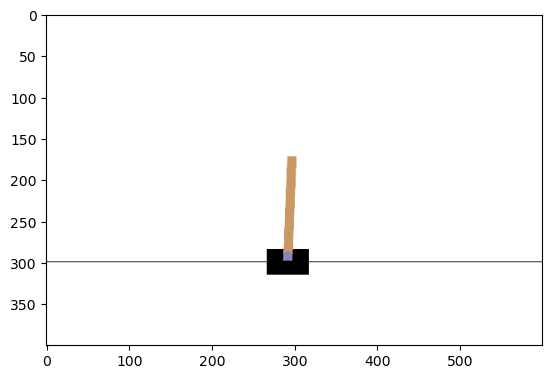

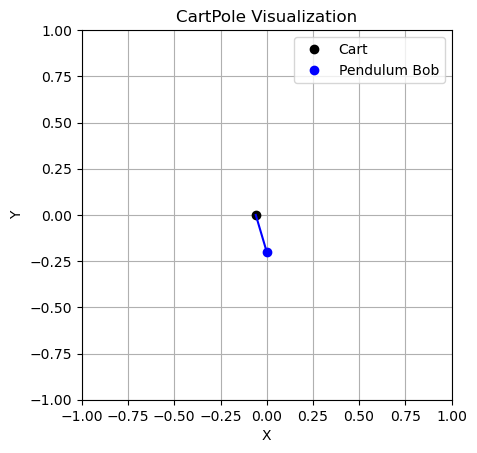


STEP:  6
CART POSITION:  -0.074454226
CART VELOCITY:  -0.5703923
POLE ANGLE WRT CART:  0.065268666
VELOCITY AT TOP OF POLE:  0.8929851
ACTION: Push cart to left


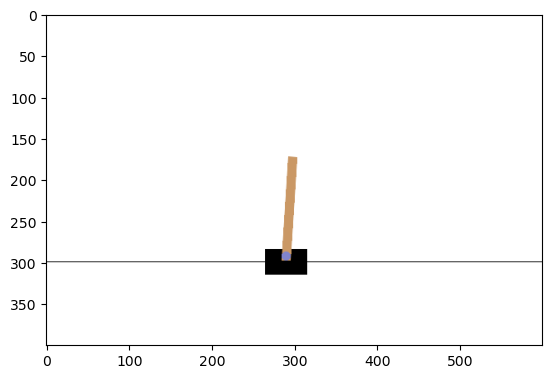

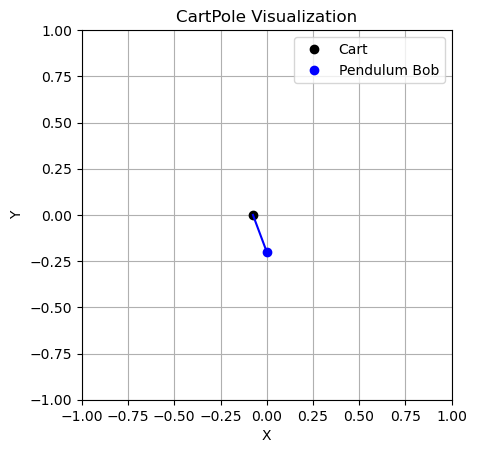


STEP:  7
CART POSITION:  -0.08586208
CART VELOCITY:  -0.7663359
POLE ANGLE WRT CART:  0.08312836
VELOCITY AT TOP OF POLE:  1.20545
ACTION: Push cart to left


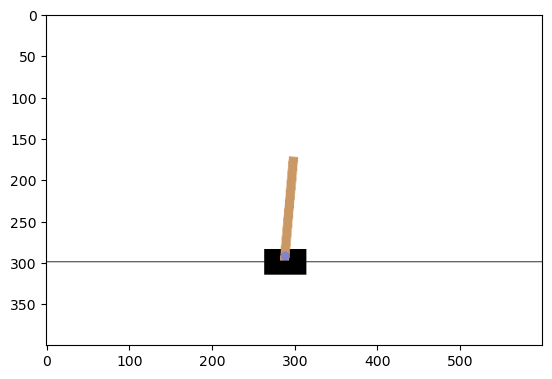

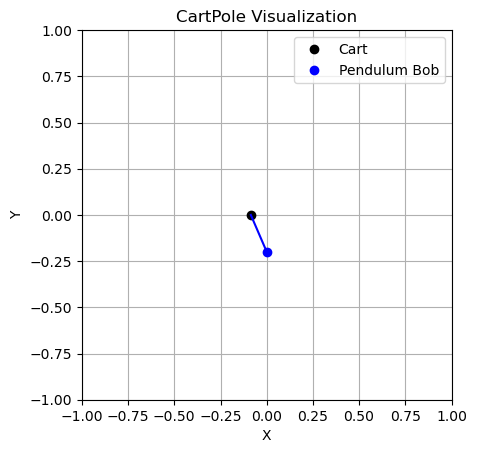


STEP:  8
CART POSITION:  -0.101188794
CART VELOCITY:  -0.9624279
POLE ANGLE WRT CART:  0.10723737
VELOCITY AT TOP OF POLE:  1.522984
ACTION: Push cart to left


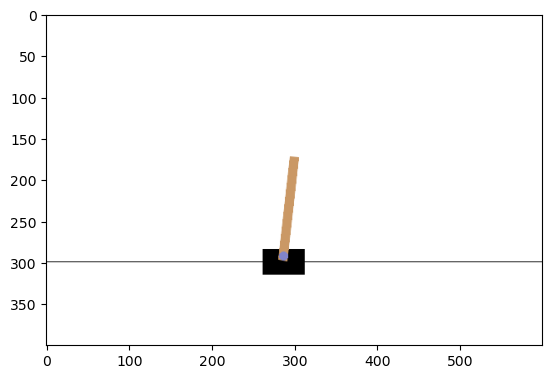

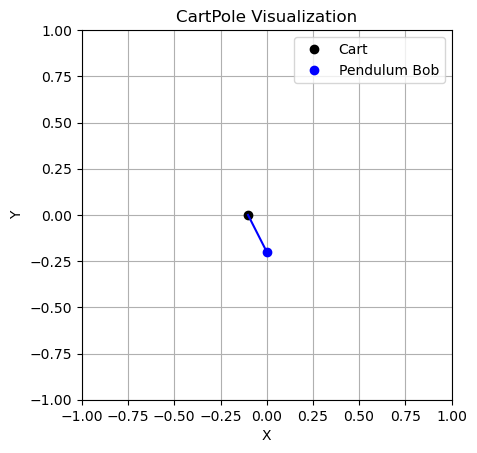


STEP:  9
CART POSITION:  -0.120437354
CART VELOCITY:  -1.1586694
POLE ANGLE WRT CART:  0.13769704
VELOCITY AT TOP OF POLE:  1.8471227
ACTION: Push cart to left


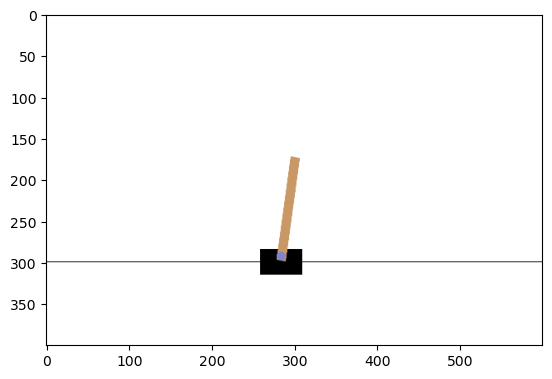

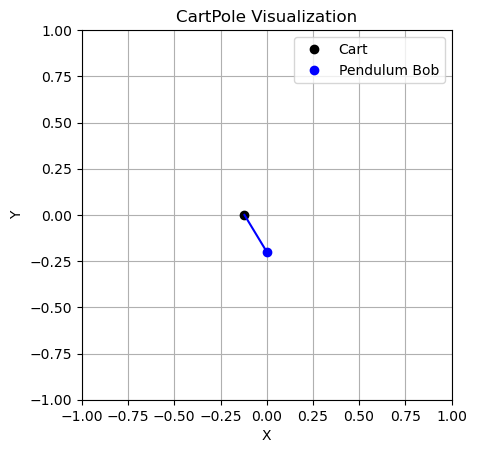


STEP:  10
CART POSITION:  -0.14361075
CART VELOCITY:  -1.3550136
POLE ANGLE WRT CART:  0.1746395
VELOCITY AT TOP OF POLE:  2.1792064
ACTION: Push cart to left


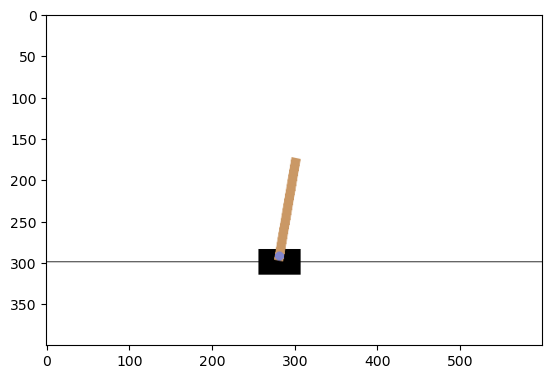

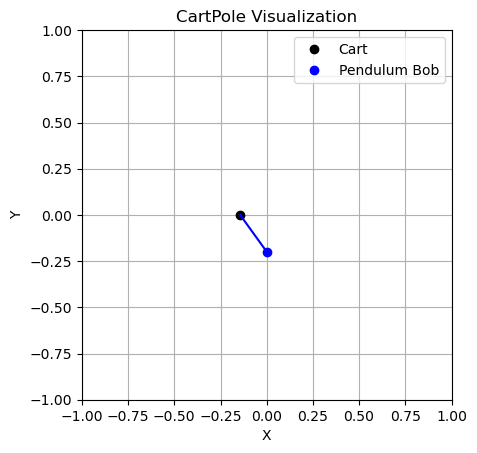


STEP:  1
CART POSITION:  0.0116006965
CART VELOCITY:  0.007562589
POLE ANGLE WRT CART:  -0.041171364
VELOCITY AT TOP OF POLE:  -0.031608924
ACTION: Push cart to right


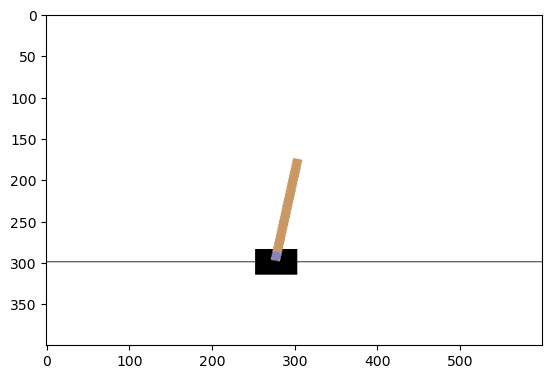

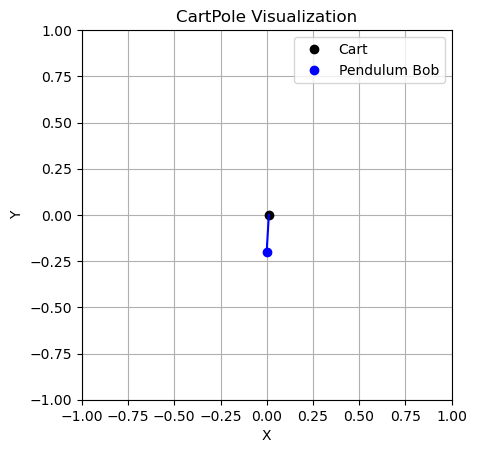


STEP:  2
CART POSITION:  0.011751948
CART VELOCITY:  0.20325004
POLE ANGLE WRT CART:  -0.041803543
VELOCITY AT TOP OF POLE:  -0.3369923
ACTION: Push cart to right


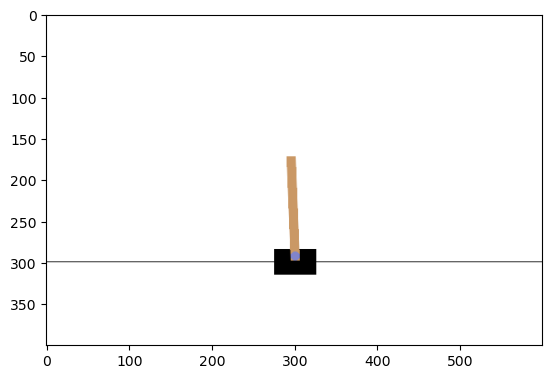

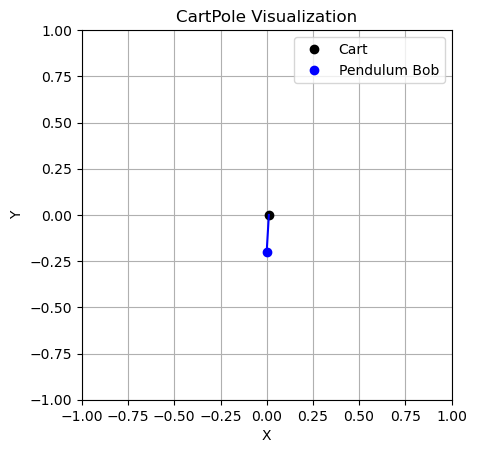


STEP:  3
CART POSITION:  0.01581695
CART VELOCITY:  0.39894116
POLE ANGLE WRT CART:  -0.048543386
VELOCITY AT TOP OF POLE:  -0.64255923
ACTION: Push cart to right


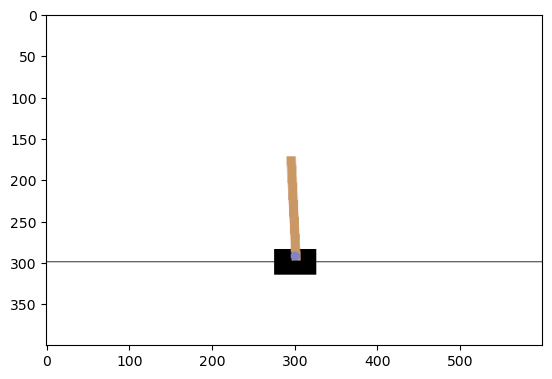

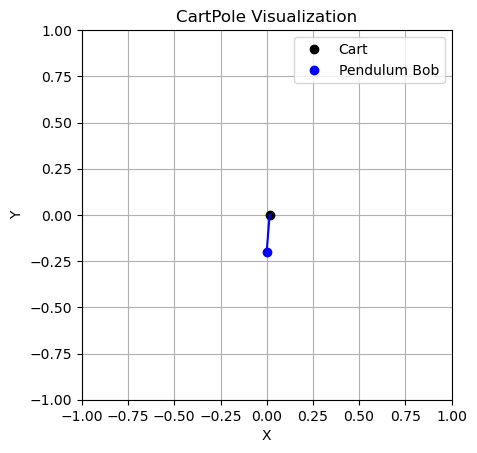


STEP:  4
CART POSITION:  0.023795772
CART VELOCITY:  0.5947049
POLE ANGLE WRT CART:  -0.061394572
VELOCITY AT TOP OF POLE:  -0.9501251
ACTION: Push cart to right


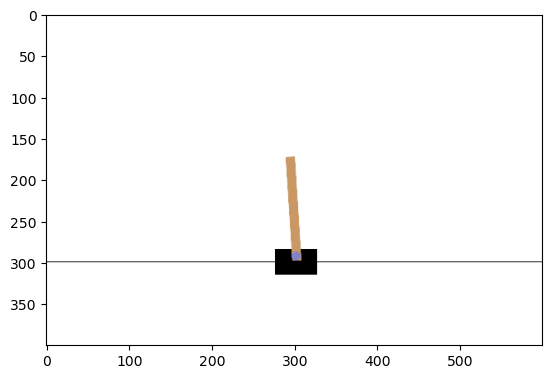

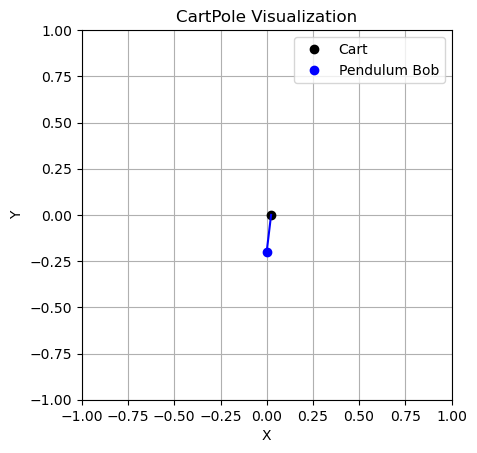


STEP:  5
CART POSITION:  0.03568987
CART VELOCITY:  0.79059714
POLE ANGLE WRT CART:  -0.08039708
VELOCITY AT TOP OF POLE:  -1.2614485
ACTION: Push cart to right


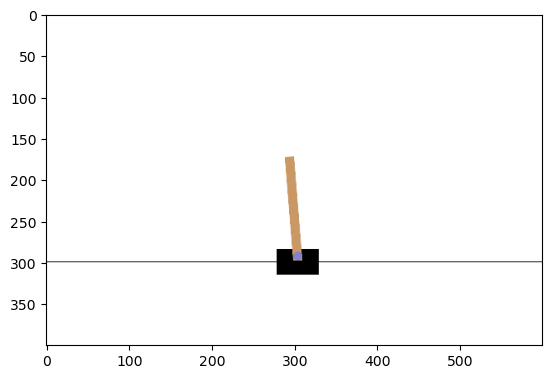

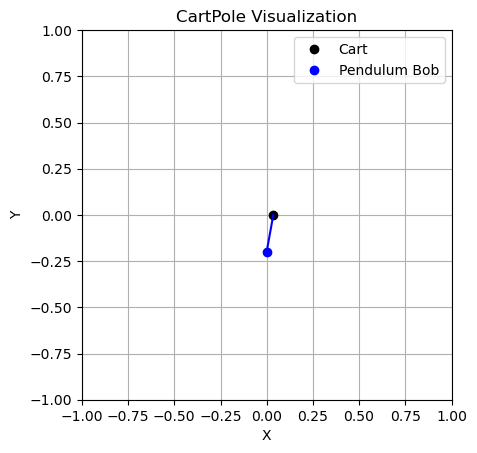


STEP:  6
CART POSITION:  0.051501814
CART VELOCITY:  0.98665
POLE ANGLE WRT CART:  -0.10562605
VELOCITY AT TOP OF POLE:  -1.5781891
ACTION: Push cart to right


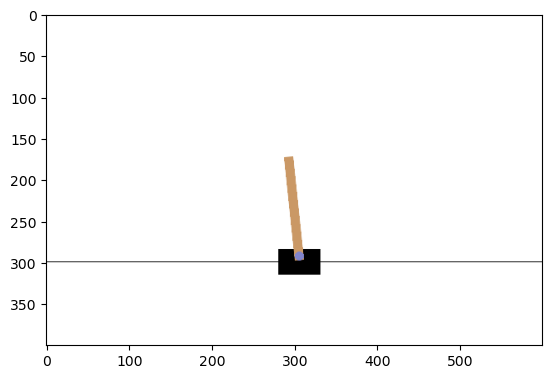

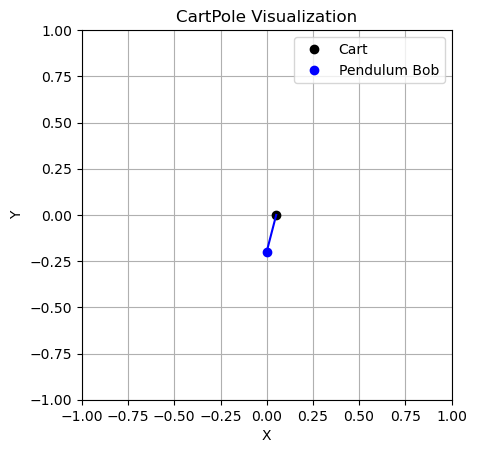


STEP:  7
CART POSITION:  0.071234815
CART VELOCITY:  1.1828598
POLE ANGLE WRT CART:  -0.13718982
VELOCITY AT TOP OF POLE:  -1.9018598
ACTION: Push cart to left


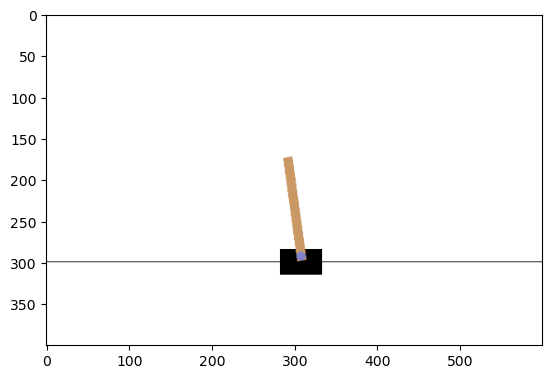

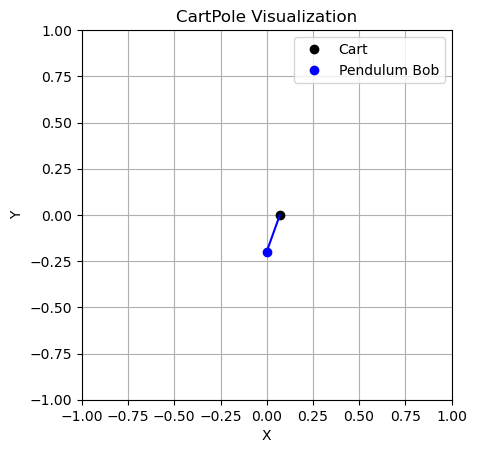


STEP:  8
CART POSITION:  0.09489201
CART VELOCITY:  0.9894628
POLE ANGLE WRT CART:  -0.17522702
VELOCITY AT TOP OF POLE:  -1.6546974
ACTION: Push cart to right


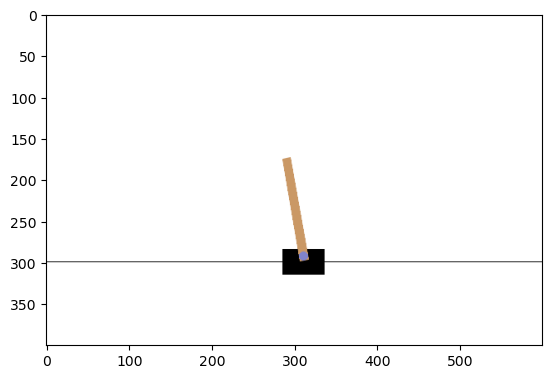

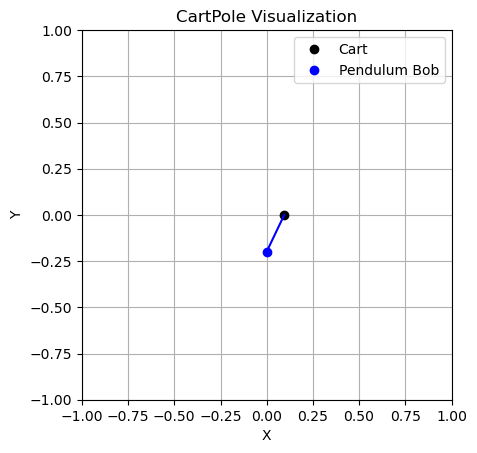


STEP:  9
CART POSITION:  0.114681266
CART VELOCITY:  1.1861435
POLE ANGLE WRT CART:  -0.20832098
VELOCITY AT TOP OF POLE:  -1.9964545
ACTION: Push cart to right


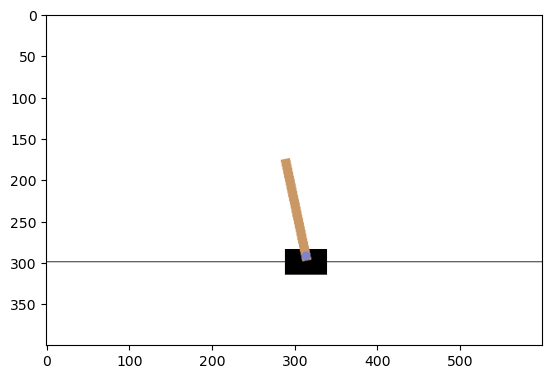

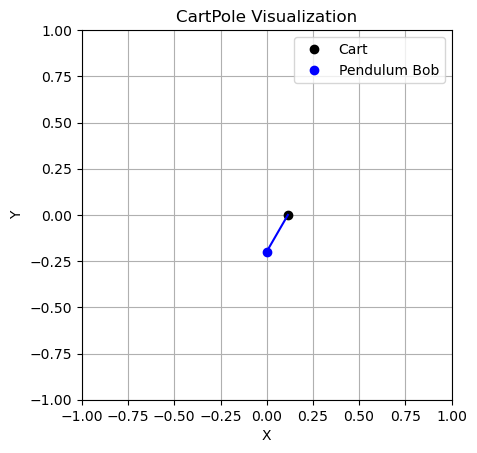


STEP:  1
CART POSITION:  0.0077062994
CART VELOCITY:  -0.036276225
POLE ANGLE WRT CART:  -0.012852108
VELOCITY AT TOP OF POLE:  0.024832234
ACTION: Push cart to right


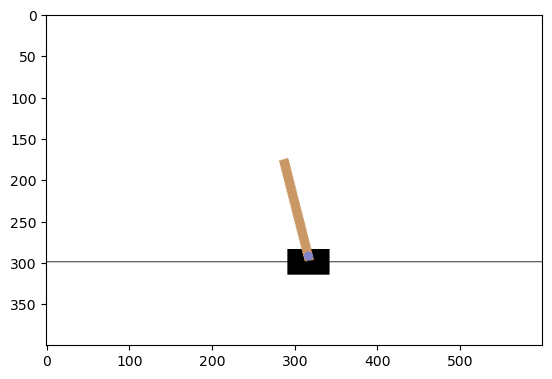

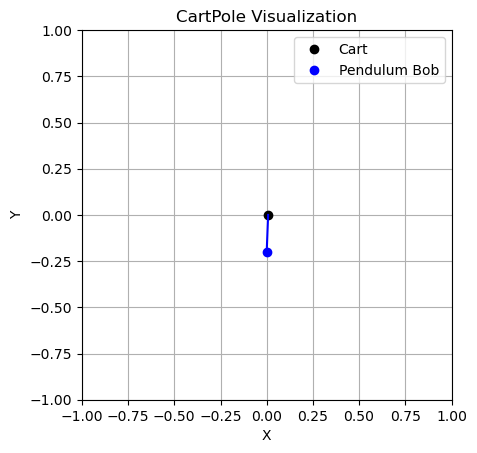


STEP:  2
CART POSITION:  0.006980775
CART VELOCITY:  0.15902765
POLE ANGLE WRT CART:  -0.012355464
VELOCITY AT TOP OF POLE:  -0.2718778
ACTION: Push cart to left


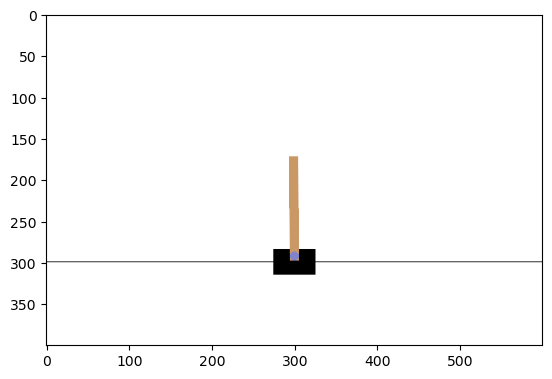

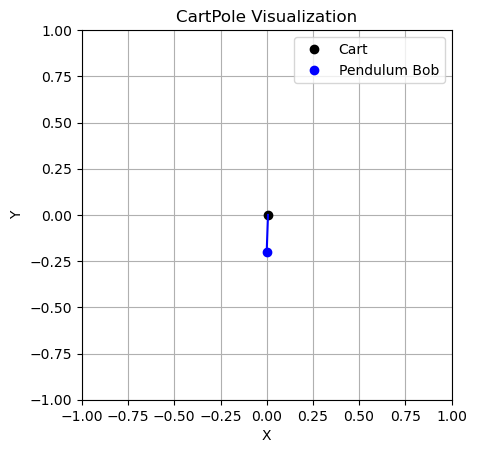


STEP:  3
CART POSITION:  0.010161328
CART VELOCITY:  -0.03591583
POLE ANGLE WRT CART:  -0.01779302
VELOCITY AT TOP OF POLE:  0.016882688
ACTION: Push cart to left


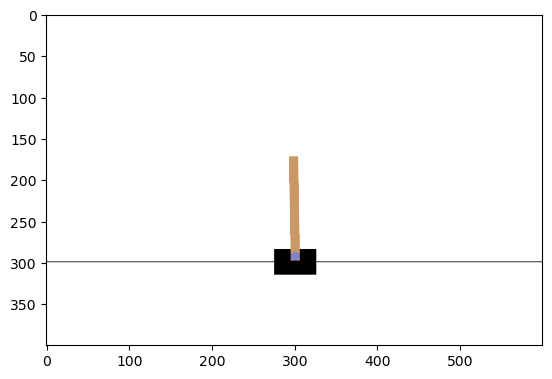

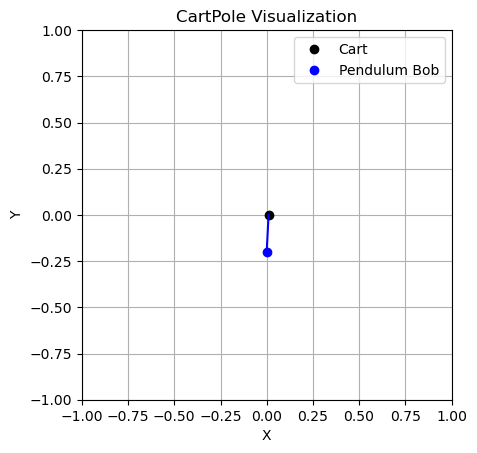


STEP:  4
CART POSITION:  0.009443011
CART VELOCITY:  -0.23077814
POLE ANGLE WRT CART:  -0.017455366
VELOCITY AT TOP OF POLE:  0.30389902
ACTION: Push cart to left


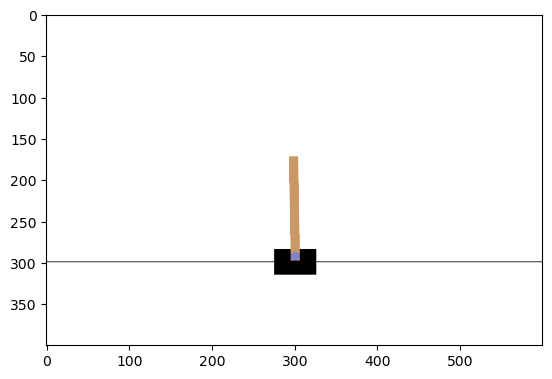

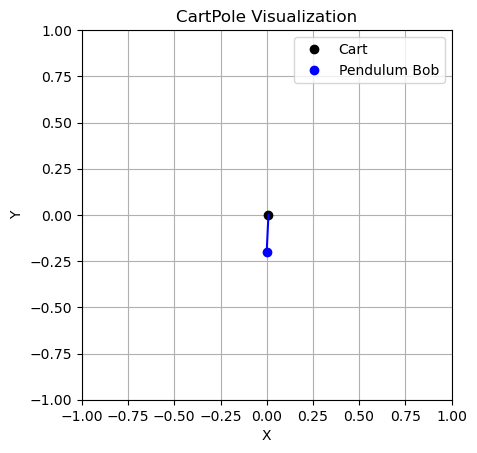


STEP:  5
CART POSITION:  0.0048274486
CART VELOCITY:  -0.42564705
POLE ANGLE WRT CART:  -0.011377385
VELOCITY AT TOP OF POLE:  0.59102625
ACTION: Push cart to right


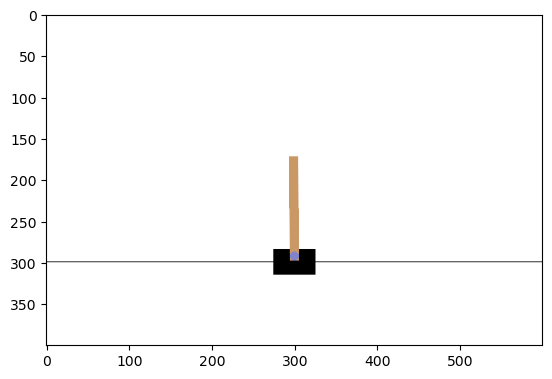

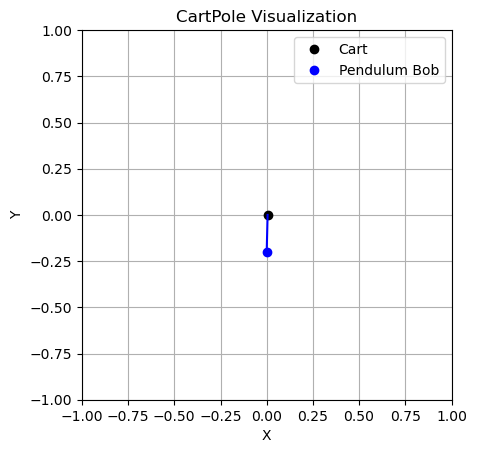


STEP:  6
CART POSITION:  -0.0036854923
CART VELOCITY:  -0.23036766
POLE ANGLE WRT CART:  0.0004431393
VELOCITY AT TOP OF POLE:  0.29478124
ACTION: Push cart to left


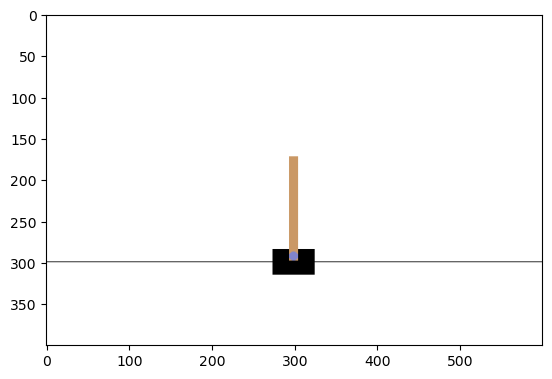

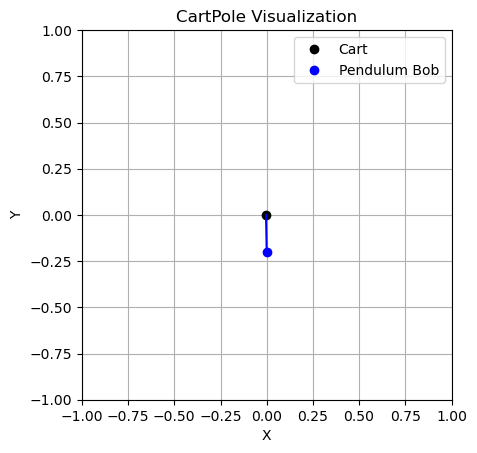


STEP:  7
CART POSITION:  -0.008292845
CART VELOCITY:  -0.42549592
POLE ANGLE WRT CART:  0.006338764
VELOCITY AT TOP OF POLE:  0.58760387
ACTION: Push cart to left


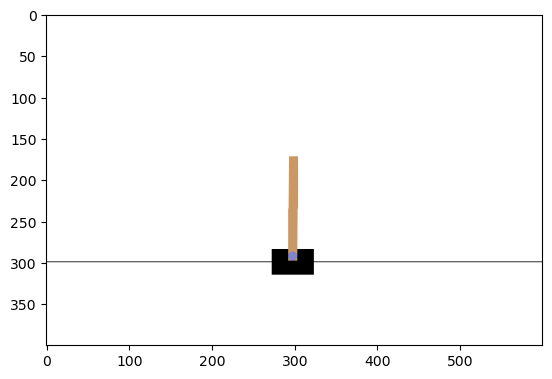

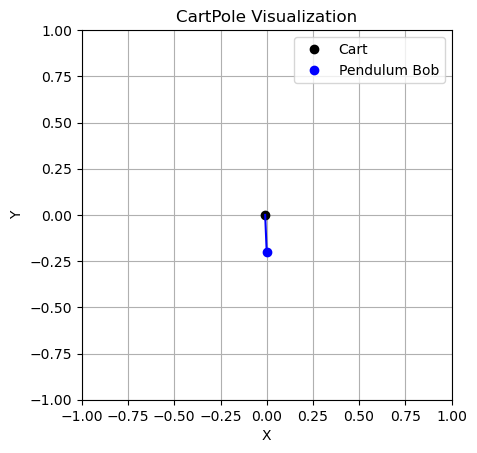


STEP:  8
CART POSITION:  -0.016802764
CART VELOCITY:  -0.6207061
POLE ANGLE WRT CART:  0.018090842
VELOCITY AT TOP OF POLE:  0.88227683
ACTION: Push cart to left


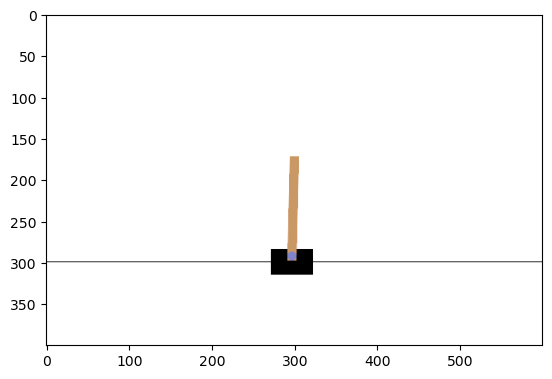

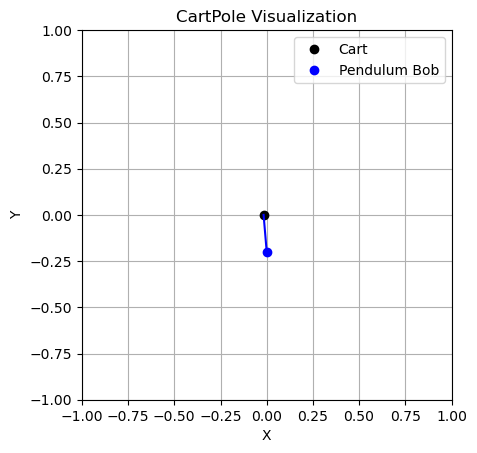


STEP:  9
CART POSITION:  -0.029216886
CART VELOCITY:  -0.816069
POLE ANGLE WRT CART:  0.03573638
VELOCITY AT TOP OF POLE:  1.1805917
ACTION: Push cart to right


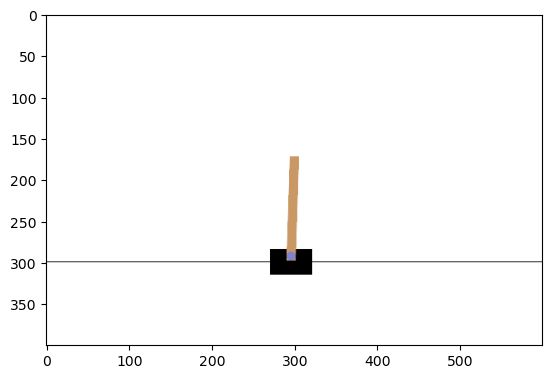

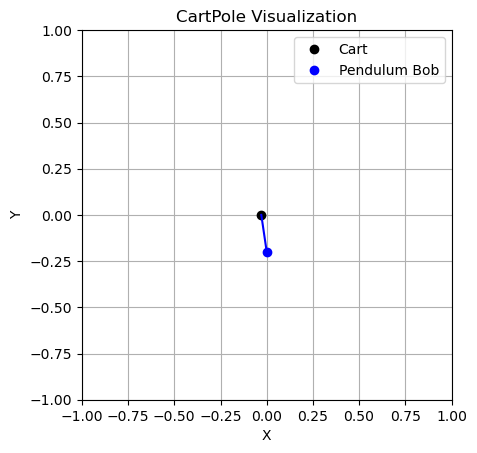


STEP:  10
CART POSITION:  -0.045538265
CART VELOCITY:  -0.6214287
POLE ANGLE WRT CART:  0.05934821
VELOCITY AT TOP OF POLE:  0.8993219
ACTION: Push cart to left


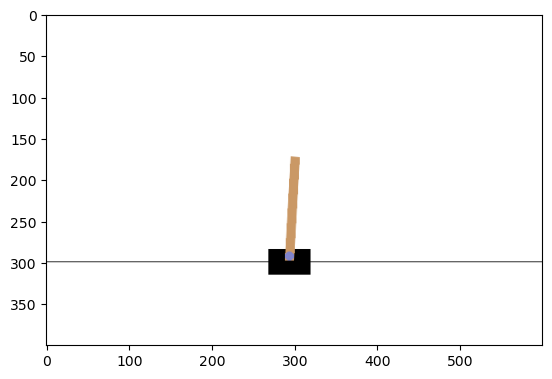

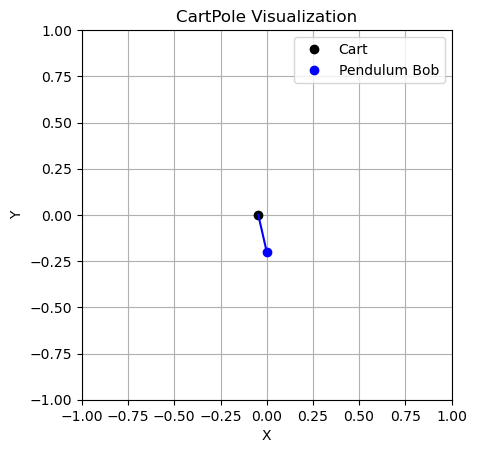


STEP:  11
CART POSITION:  -0.05796684
CART VELOCITY:  -0.8173026
POLE ANGLE WRT CART:  0.07733465
VELOCITY AT TOP OF POLE:  1.2100536
ACTION: Push cart to left


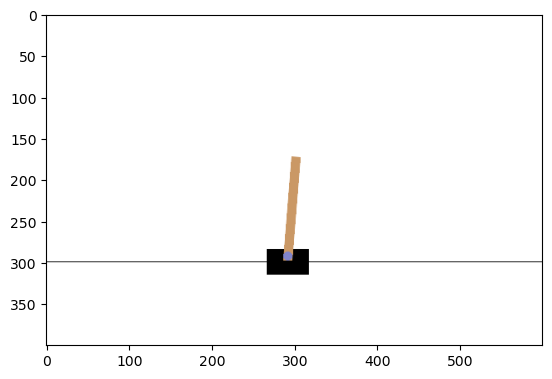

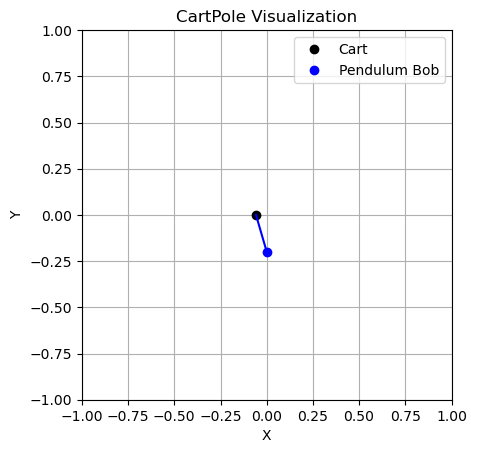


STEP:  12
CART POSITION:  -0.074312896
CART VELOCITY:  -1.0133332
POLE ANGLE WRT CART:  0.10153572
VELOCITY AT TOP OF POLE:  1.5259345
ACTION: Push cart to left


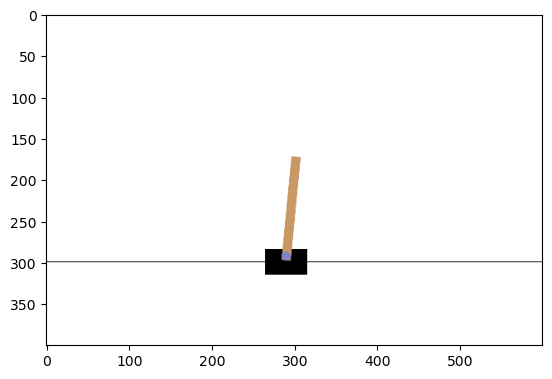

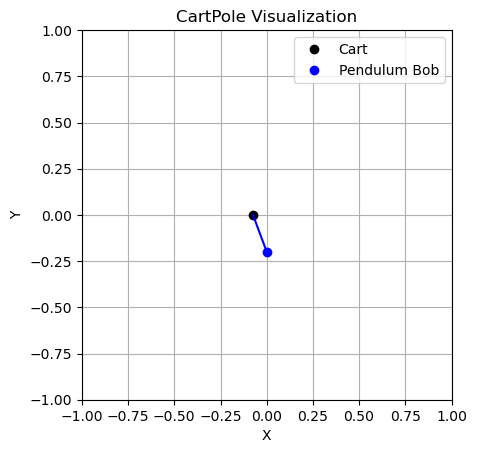


STEP:  13
CART POSITION:  -0.094579555
CART VELOCITY:  -1.2095237
POLE ANGLE WRT CART:  0.1320544
VELOCITY AT TOP OF POLE:  1.8485045
ACTION: Push cart to left


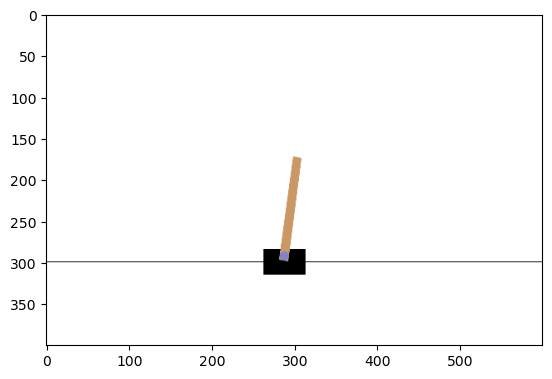

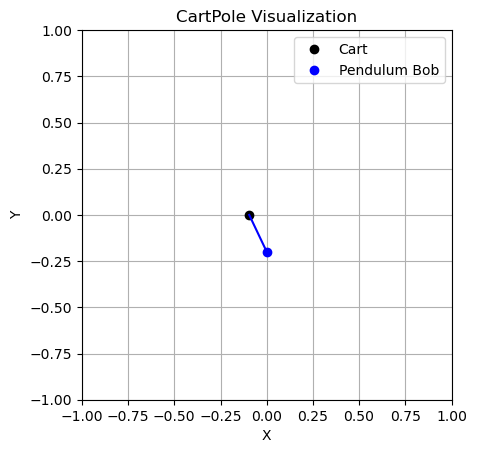


STEP:  14
CART POSITION:  -0.11877003
CART VELOCITY:  -1.4058295
POLE ANGLE WRT CART:  0.1690245
VELOCITY AT TOP OF POLE:  2.179111
ACTION: Push cart to left


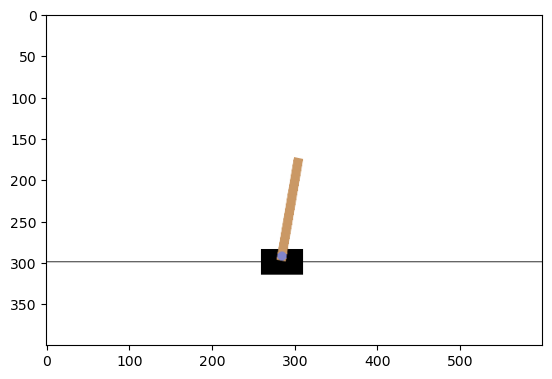

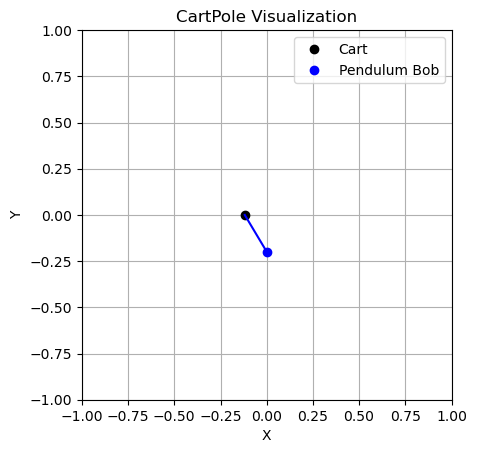


STEP:  1
CART POSITION:  0.014180404
CART VELOCITY:  -0.044889823
POLE ANGLE WRT CART:  -0.04429808
VELOCITY AT TOP OF POLE:  0.0028740321
ACTION: Push cart to left


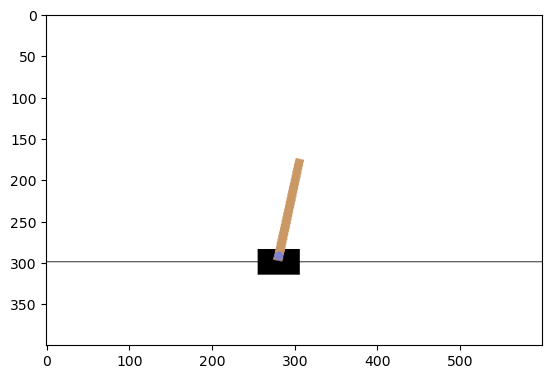

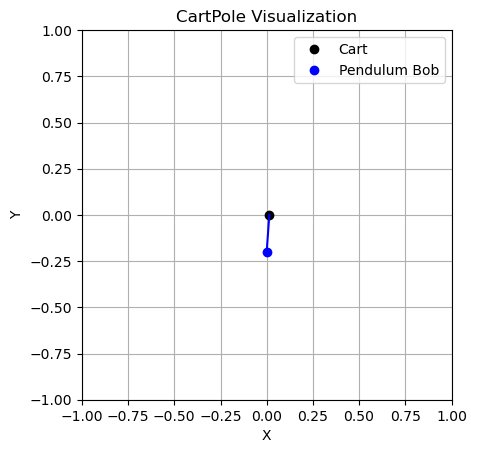


STEP:  2
CART POSITION:  0.013282607
CART VELOCITY:  -0.23934941
POLE ANGLE WRT CART:  -0.044240598
VELOCITY AT TOP OF POLE:  0.28125787
ACTION: Push cart to left


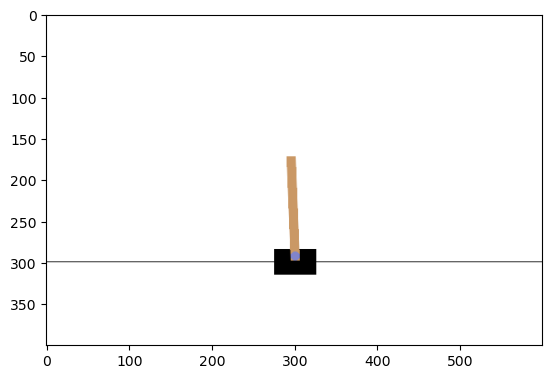

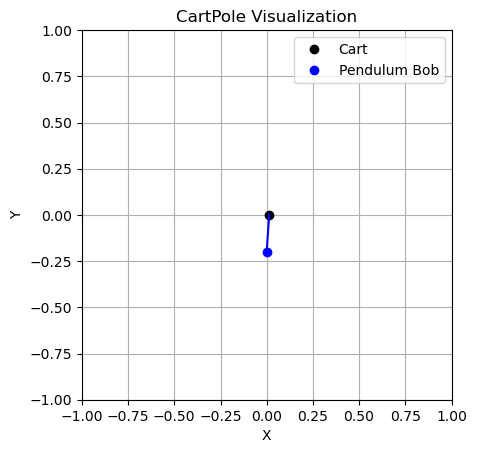


STEP:  3
CART POSITION:  0.0084956195
CART VELOCITY:  -0.4338133
POLE ANGLE WRT CART:  -0.03861544
VELOCITY AT TOP OF POLE:  0.5596658
ACTION: Push cart to left


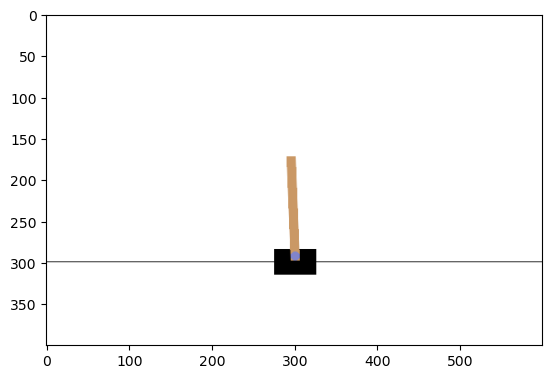

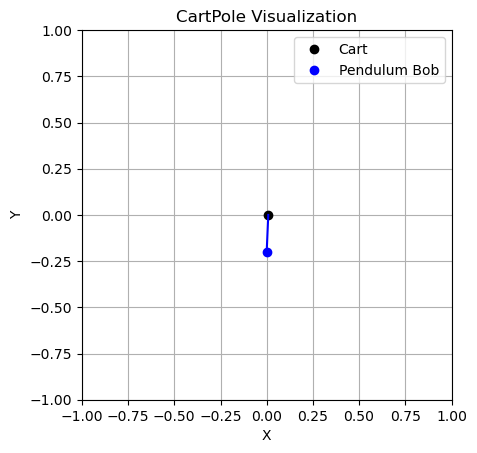


STEP:  4
CART POSITION:  -0.00018064644
CART VELOCITY:  -0.62837255
POLE ANGLE WRT CART:  -0.027422125
VELOCITY AT TOP OF POLE:  0.83993703
ACTION: Push cart to left


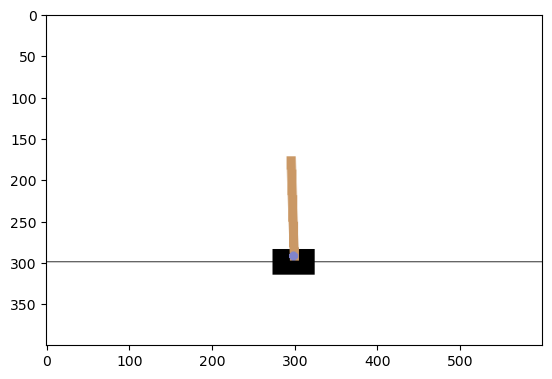

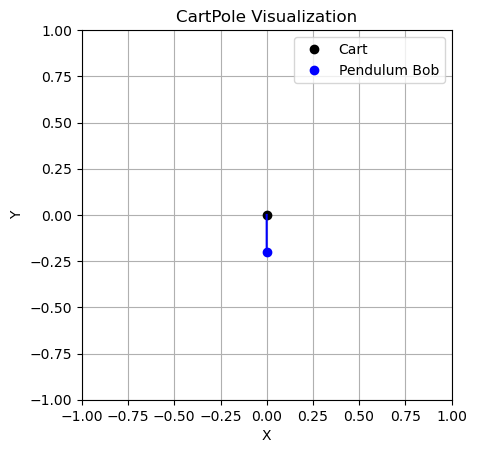


STEP:  5
CART POSITION:  -0.012748098
CART VELOCITY:  -0.8231096
POLE ANGLE WRT CART:  -0.010623383
VELOCITY AT TOP OF POLE:  1.1238717
ACTION: Push cart to left


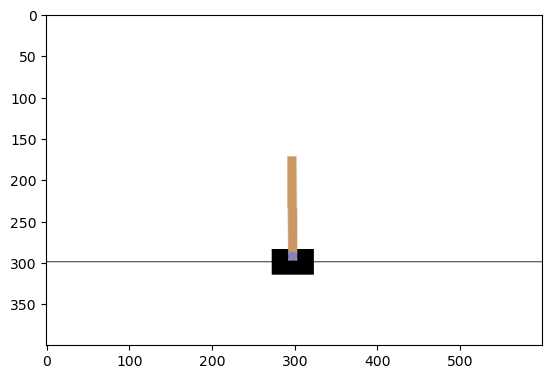

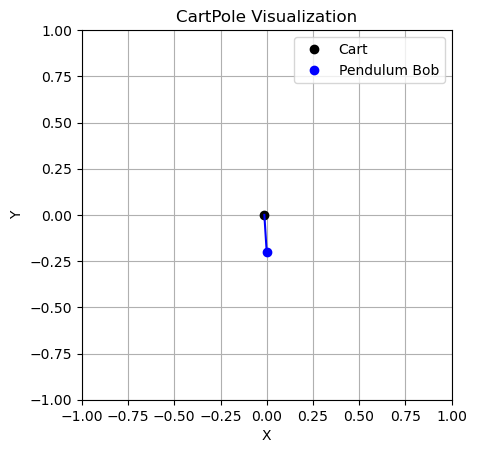


STEP:  6
CART POSITION:  -0.02921029
CART VELOCITY:  -1.0180907
POLE ANGLE WRT CART:  0.011854051
VELOCITY AT TOP OF POLE:  1.4132036
ACTION: Push cart to left


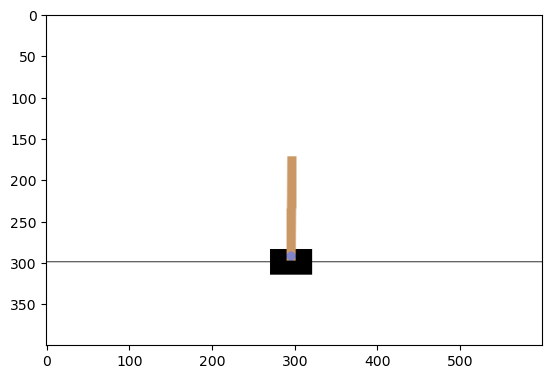

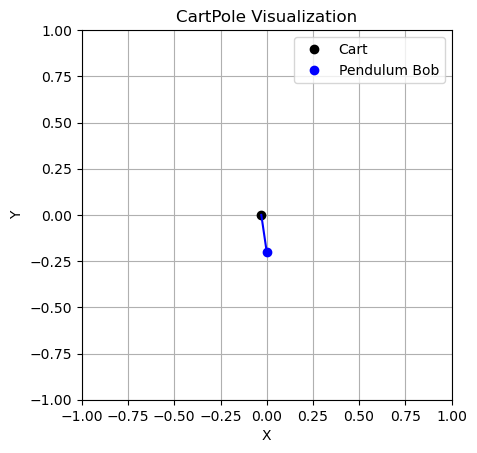


STEP:  7
CART POSITION:  -0.049572103
CART VELOCITY:  -1.2133576
POLE ANGLE WRT CART:  0.04011812
VELOCITY AT TOP OF POLE:  1.7095683
ACTION: Push cart to left


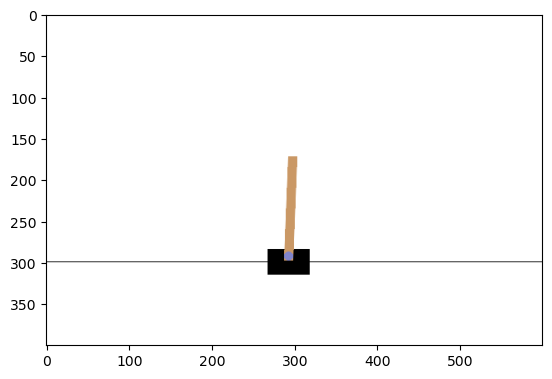

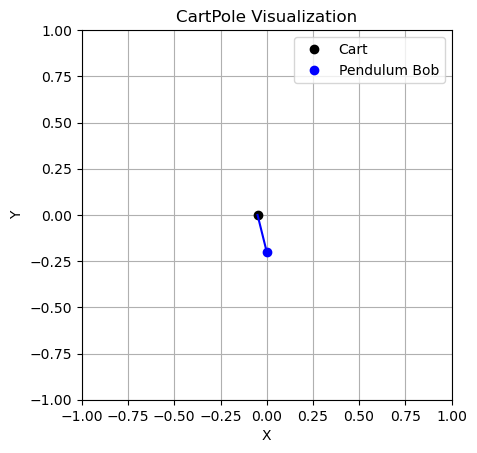


STEP:  8
CART POSITION:  -0.073839255
CART VELOCITY:  -1.4089168
POLE ANGLE WRT CART:  0.07430949
VELOCITY AT TOP OF POLE:  2.0144627
ACTION: Push cart to left


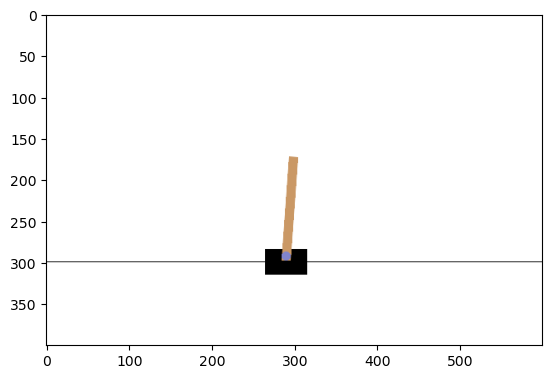

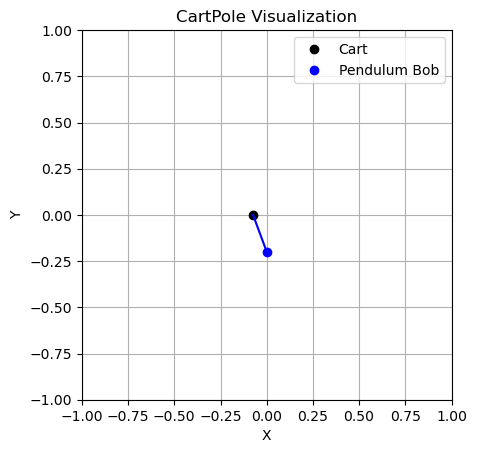


STEP:  9
CART POSITION:  -0.10201759
CART VELOCITY:  -1.6047276
POLE ANGLE WRT CART:  0.11459874
VELOCITY AT TOP OF POLE:  2.3291953
ACTION: Push cart to left


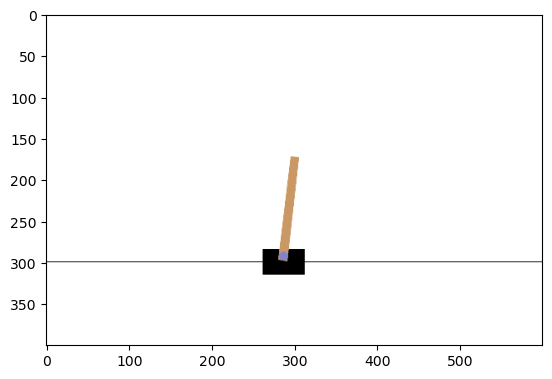

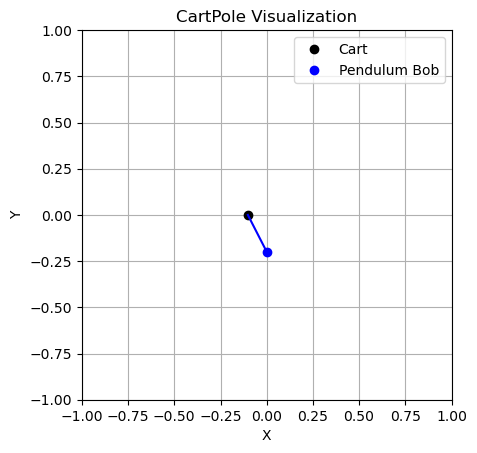


STEP:  10
CART POSITION:  -0.13411215
CART VELOCITY:  -1.8006861
POLE ANGLE WRT CART:  0.16118266
VELOCITY AT TOP OF POLE:  2.6548233
ACTION: Push cart to left


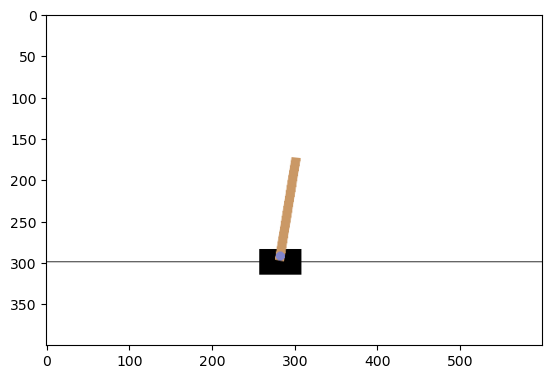

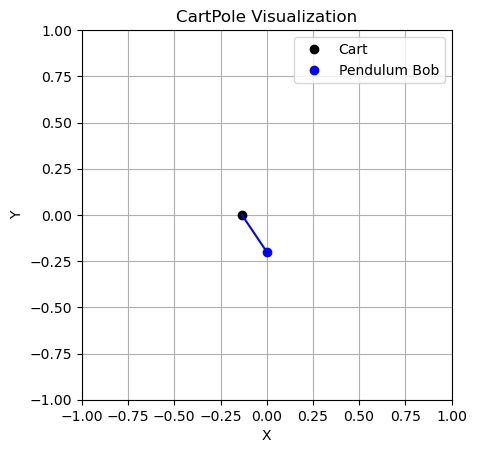


STEP:  1
CART POSITION:  0.023208523
CART VELOCITY:  0.042712662
POLE ANGLE WRT CART:  0.037027355
VELOCITY AT TOP OF POLE:  0.043007527
ACTION: Push cart to left


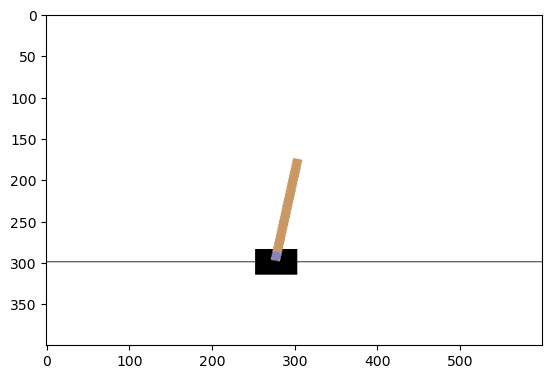

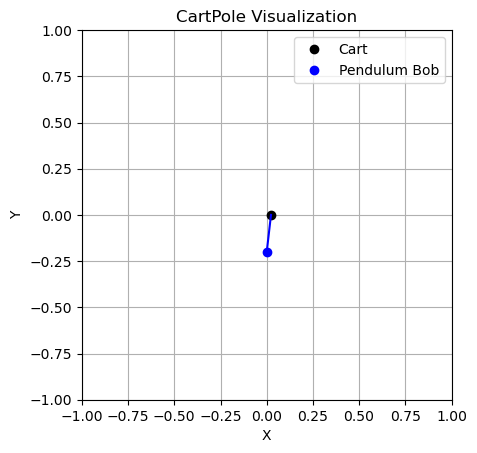


STEP:  2
CART POSITION:  0.024062777
CART VELOCITY:  -0.15292014
POLE ANGLE WRT CART:  0.037887506
VELOCITY AT TOP OF POLE:  0.34713915
ACTION: Push cart to right


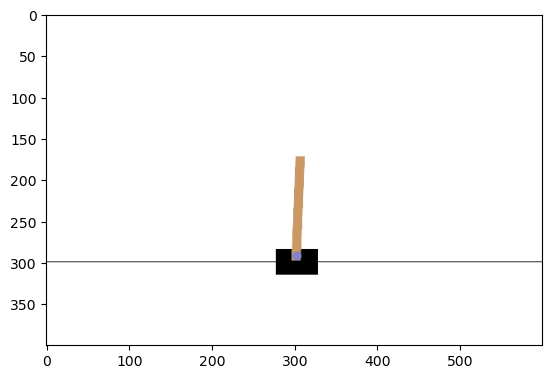

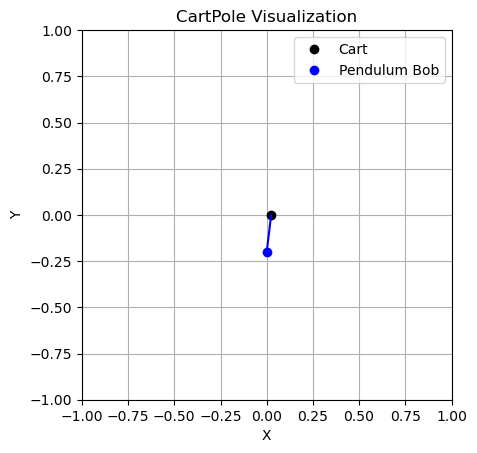


STEP:  3
CART POSITION:  0.021004373
CART VELOCITY:  0.04164299
POLE ANGLE WRT CART:  0.04483029
VELOCITY AT TOP OF POLE:  0.06664015
ACTION: Push cart to left


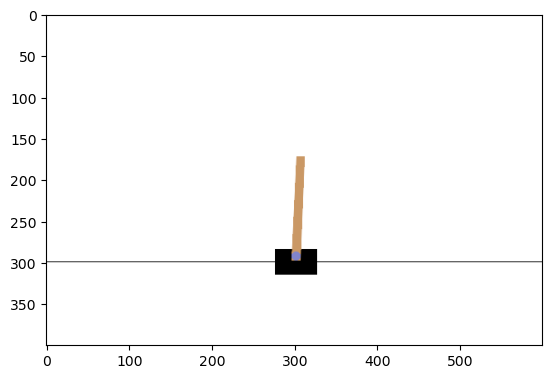

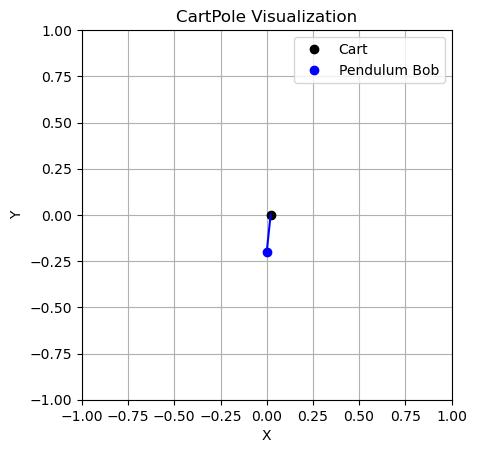


STEP:  4
CART POSITION:  0.021837233
CART VELOCITY:  -0.15409207
POLE ANGLE WRT CART:  0.046163093
VELOCITY AT TOP OF POLE:  0.37312347
ACTION: Push cart to left


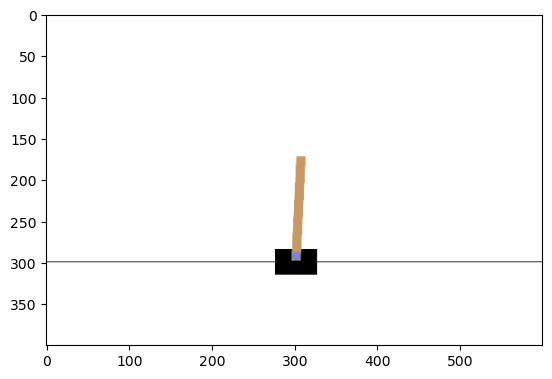

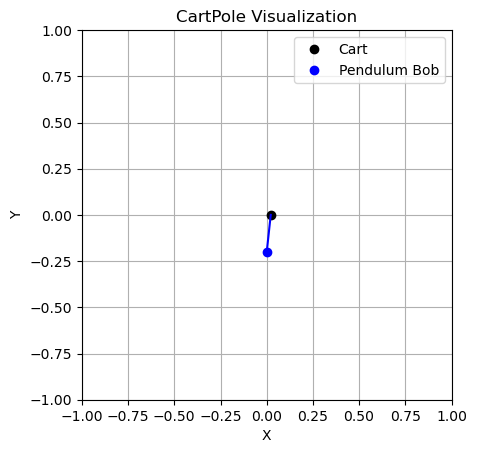


STEP:  5
CART POSITION:  0.018755391
CART VELOCITY:  -0.34983838
POLE ANGLE WRT CART:  0.05362556
VELOCITY AT TOP OF POLE:  0.6799972
ACTION: Push cart to left


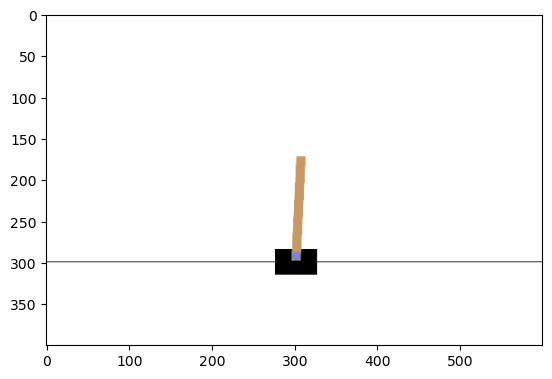

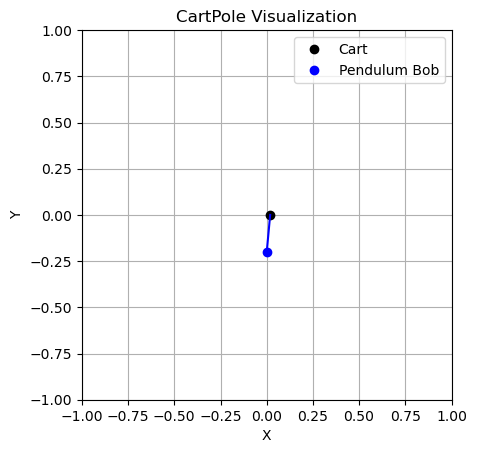


STEP:  6
CART POSITION:  0.011758625
CART VELOCITY:  -0.5456626
POLE ANGLE WRT CART:  0.06722551
VELOCITY AT TOP OF POLE:  0.98906964
ACTION: Push cart to left


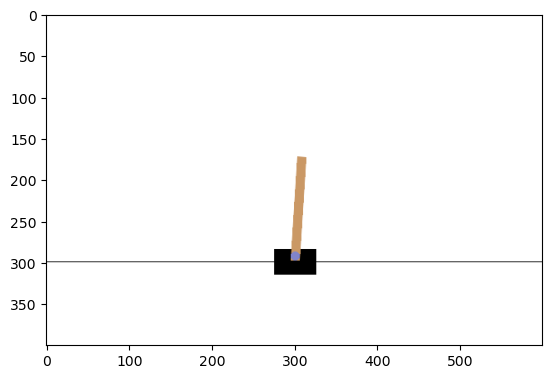

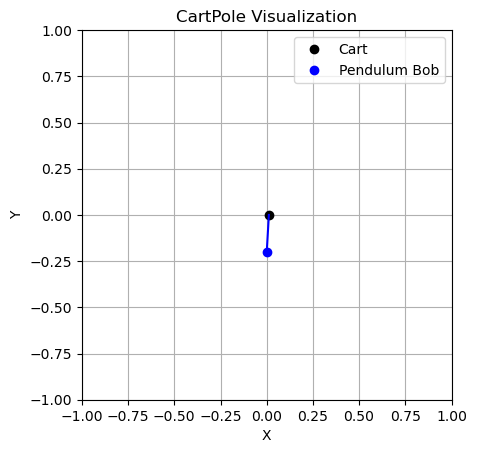


STEP:  7
CART POSITION:  0.00084537326
CART VELOCITY:  -0.7416169
POLE ANGLE WRT CART:  0.0870069
VELOCITY AT TOP OF POLE:  1.3020866
ACTION: Push cart to right


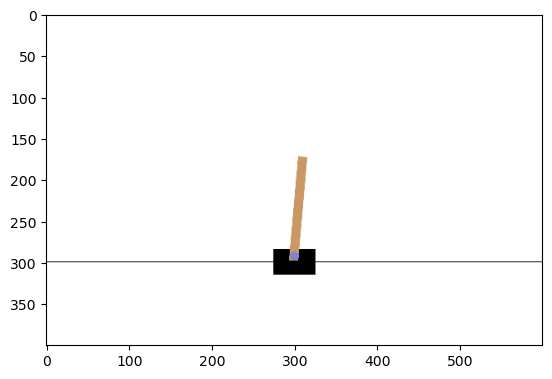

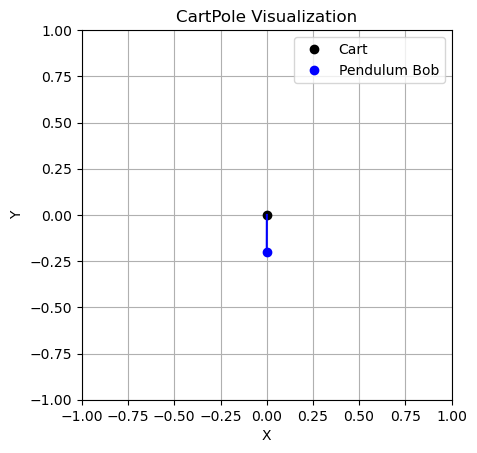


STEP:  8
CART POSITION:  -0.013986965
CART VELOCITY:  -0.54769987
POLE ANGLE WRT CART:  0.11304863
VELOCITY AT TOP OF POLE:  1.0378592
ACTION: Push cart to right


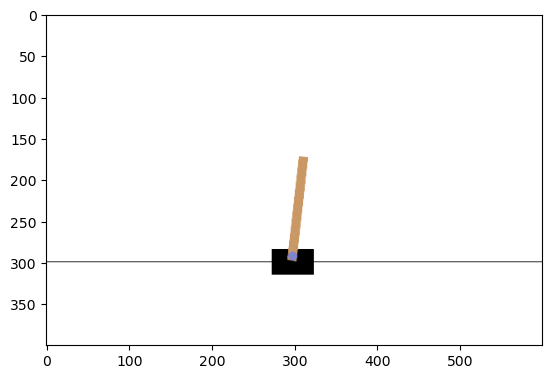

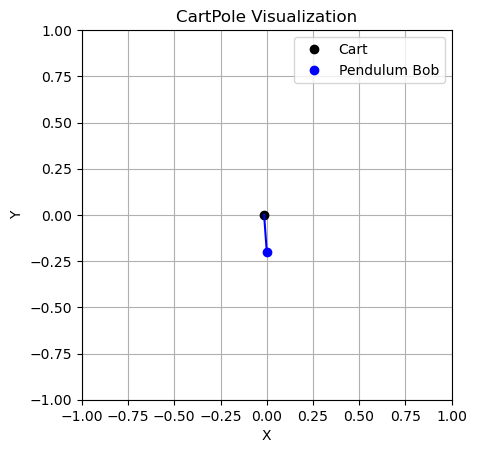


STEP:  9
CART POSITION:  -0.024940962
CART VELOCITY:  -0.35424703
POLE ANGLE WRT CART:  0.13380581
VELOCITY AT TOP OF POLE:  0.7826977
ACTION: Push cart to right


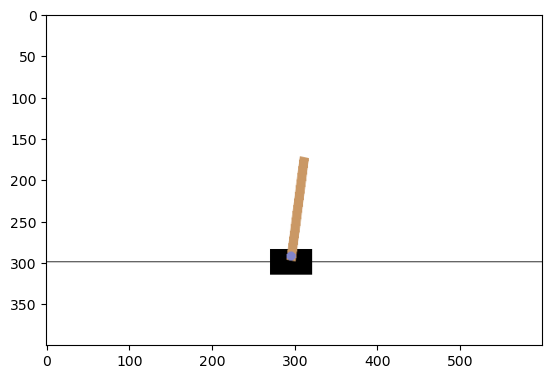

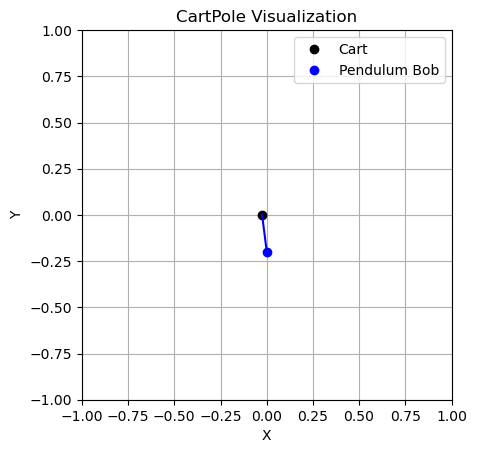


STEP:  10
CART POSITION:  -0.032025903
CART VELOCITY:  -0.1611929
POLE ANGLE WRT CART:  0.14945976
VELOCITY AT TOP OF POLE:  0.5349266
ACTION: Push cart to left


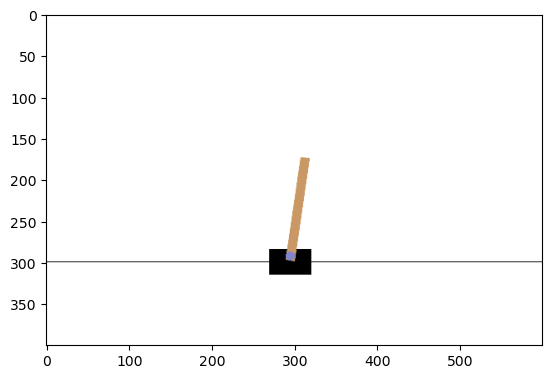

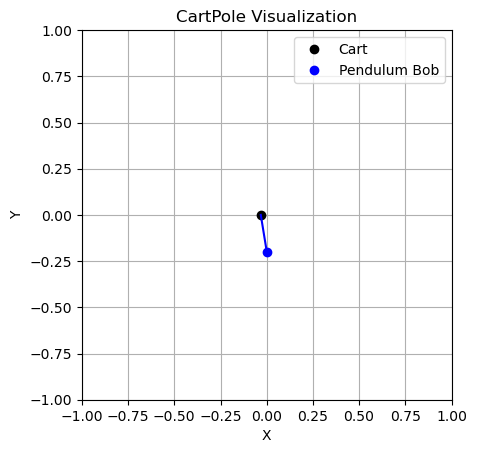


STEP:  11
CART POSITION:  -0.035249762
CART VELOCITY:  -0.35806558
POLE ANGLE WRT CART:  0.1601583
VELOCITY AT TOP OF POLE:  0.87072116
ACTION: Push cart to left


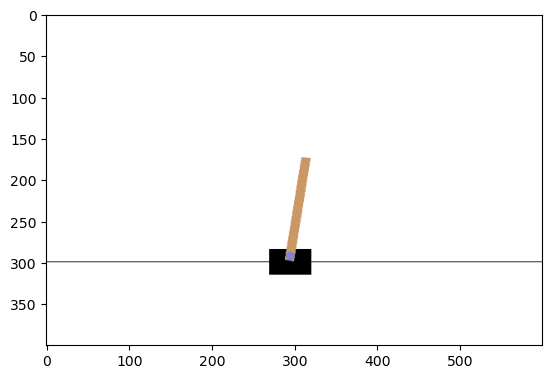

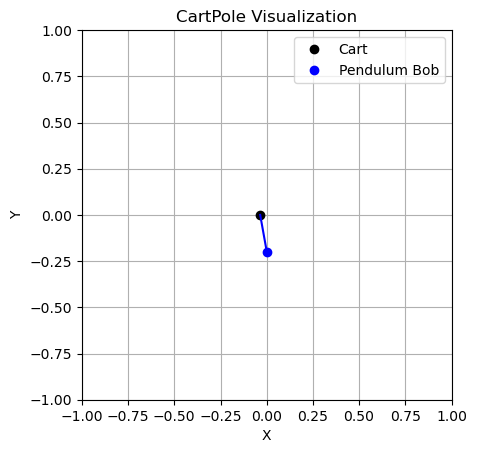


STEP:  12
CART POSITION:  -0.042411074
CART VELOCITY:  -0.55496097
POLE ANGLE WRT CART:  0.17757273
VELOCITY AT TOP OF POLE:  1.20917
ACTION: Push cart to left


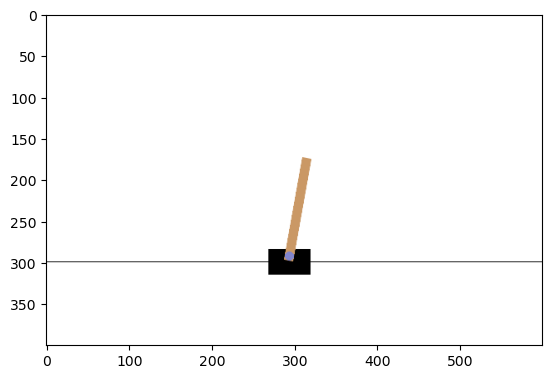

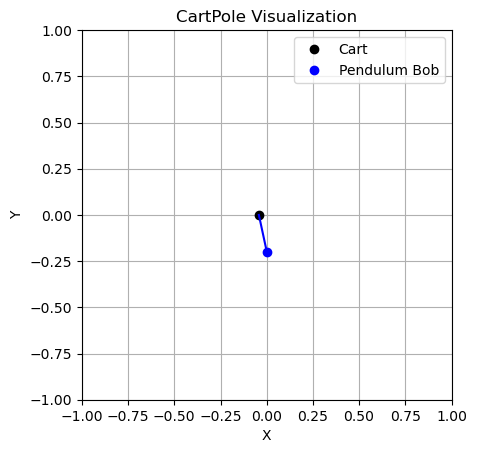


STEP:  13
CART POSITION:  -0.053510293
CART VELOCITY:  -0.75187486
POLE ANGLE WRT CART:  0.20175612
VELOCITY AT TOP OF POLE:  1.5518286
ACTION: Push cart to left


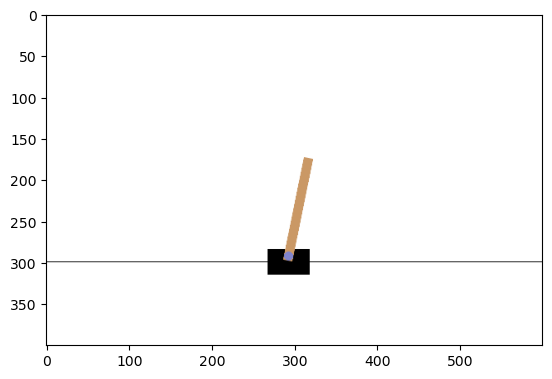

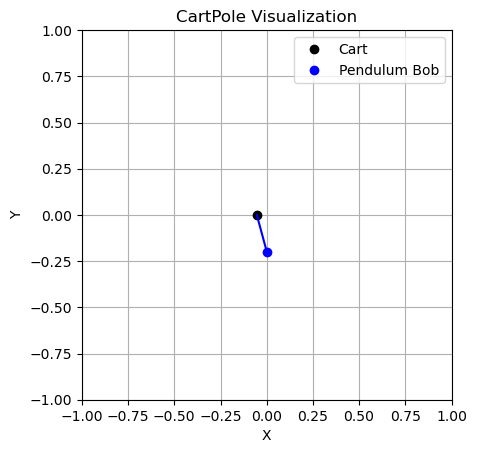


STEP:  1
CART POSITION:  -0.039799474
CART VELOCITY:  -0.0007557391
POLE ANGLE WRT CART:  -0.043534968
VELOCITY AT TOP OF POLE:  0.030885555
ACTION: Push cart to left


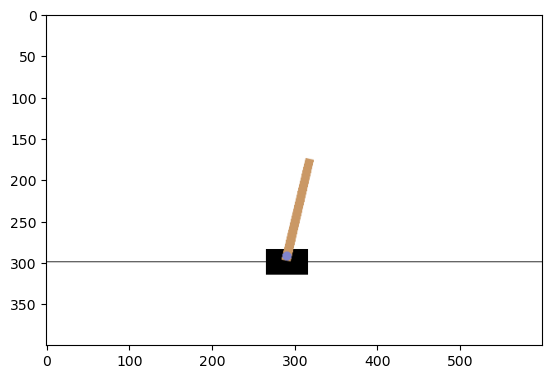

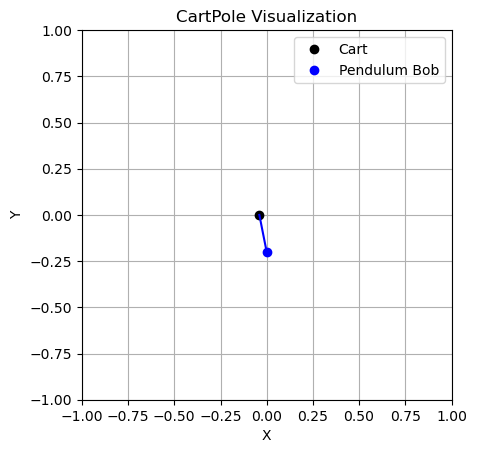


STEP:  2
CART POSITION:  -0.03981459
CART VELOCITY:  -0.1952272
POLE ANGLE WRT CART:  -0.04291726
VELOCITY AT TOP OF POLE:  0.30952114
ACTION: Push cart to right


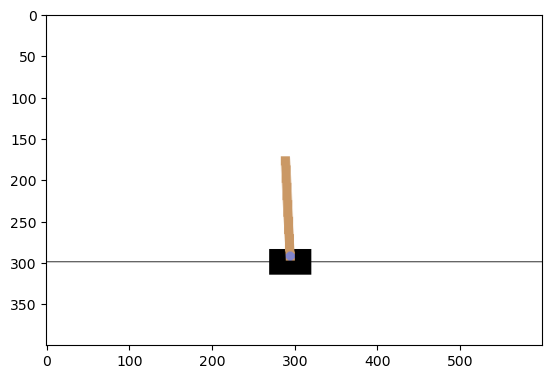

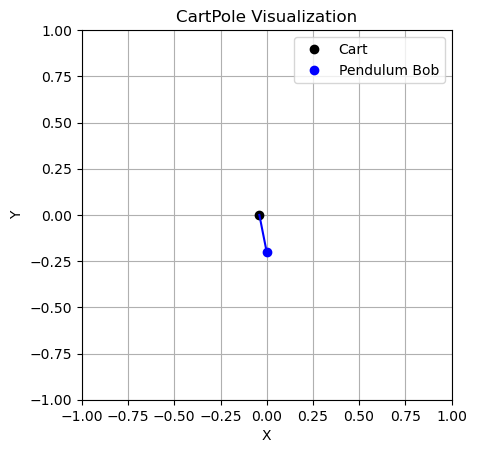


STEP:  3
CART POSITION:  -0.043719135
CART VELOCITY:  0.00047911025
POLE ANGLE WRT CART:  -0.036726836
VELOCITY AT TOP OF POLE:  0.00361816
ACTION: Push cart to right


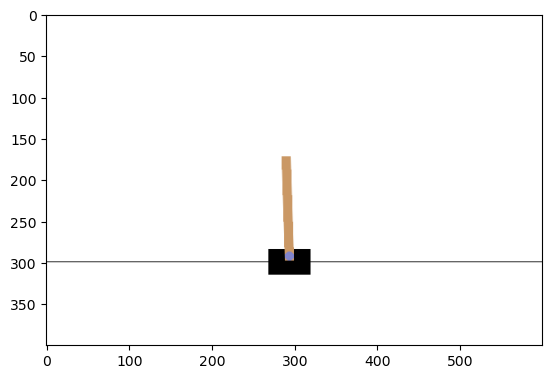

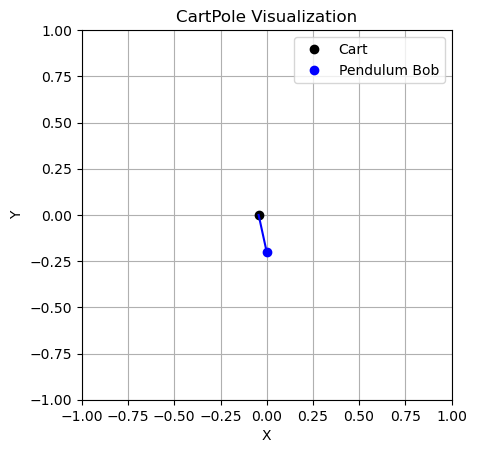


STEP:  4
CART POSITION:  -0.043709554
CART VELOCITY:  0.196108
POLE ANGLE WRT CART:  -0.036654472
VELOCITY AT TOP OF POLE:  -0.30042255
ACTION: Push cart to right


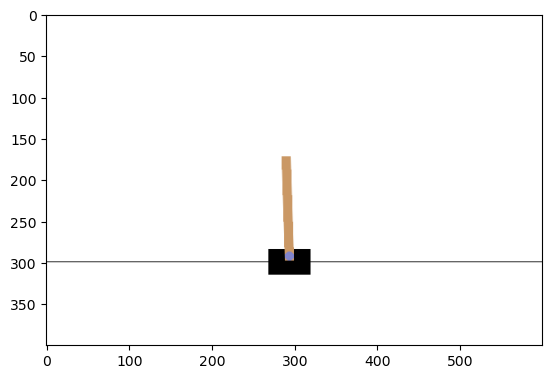

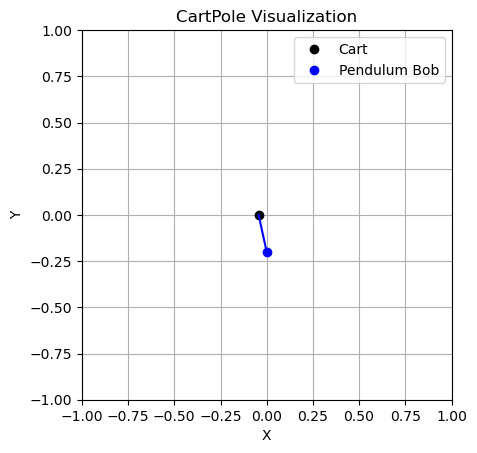


STEP:  5
CART POSITION:  -0.039787393
CART VELOCITY:  0.39173272
POLE ANGLE WRT CART:  -0.042662922
VELOCITY AT TOP OF POLE:  -0.6044365
ACTION: Push cart to right


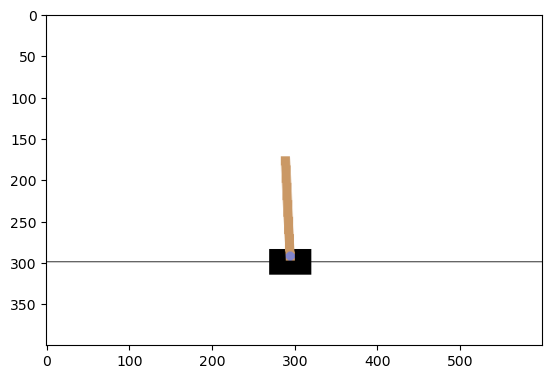

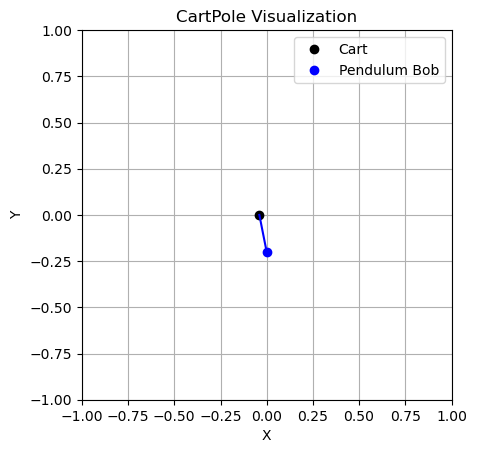


STEP:  6
CART POSITION:  -0.03195274
CART VELOCITY:  0.5874245
POLE ANGLE WRT CART:  -0.054751653
VELOCITY AT TOP OF POLE:  -0.91024625
ACTION: Push cart to right


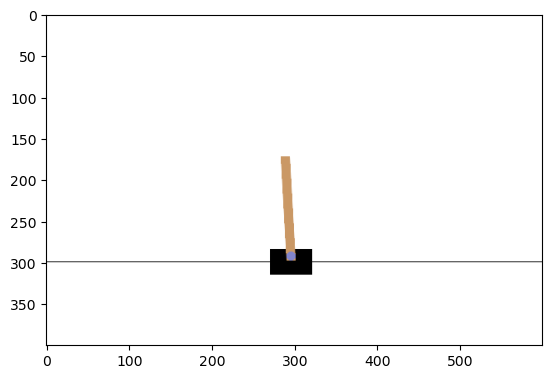

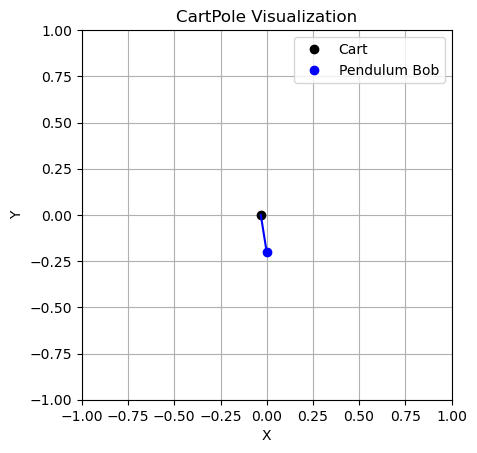


STEP:  7
CART POSITION:  -0.020204248
CART VELOCITY:  0.783243
POLE ANGLE WRT CART:  -0.07295658
VELOCITY AT TOP OF POLE:  -1.2196227
ACTION: Push cart to right


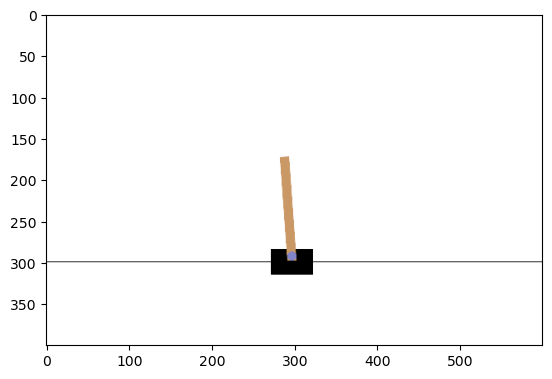

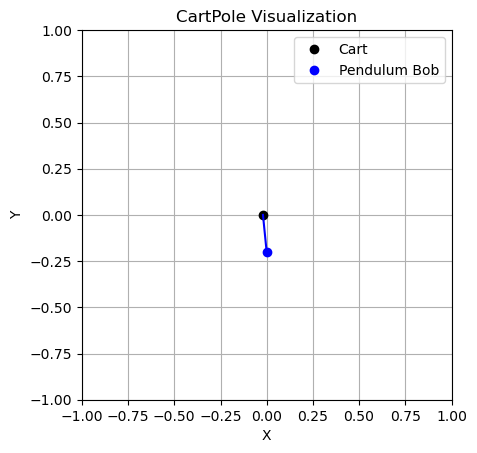


STEP:  8
CART POSITION:  -0.0045393878
CART VELOCITY:  0.9792256
POLE ANGLE WRT CART:  -0.09734903
VELOCITY AT TOP OF POLE:  -1.5342448
ACTION: Push cart to right


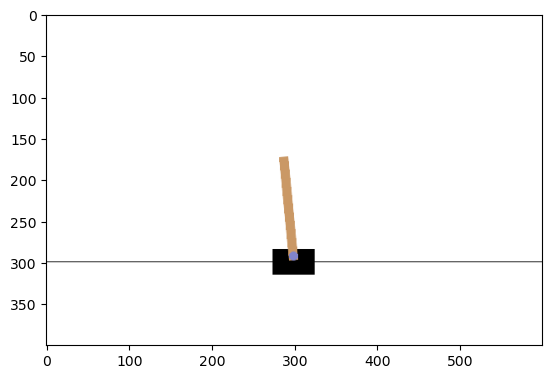

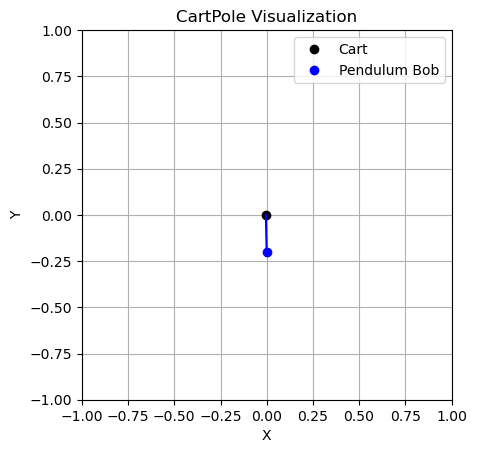


STEP:  9
CART POSITION:  0.015045123
CART VELOCITY:  1.175376
POLE ANGLE WRT CART:  -0.12803394
VELOCITY AT TOP OF POLE:  -1.8556528
ACTION: Push cart to right


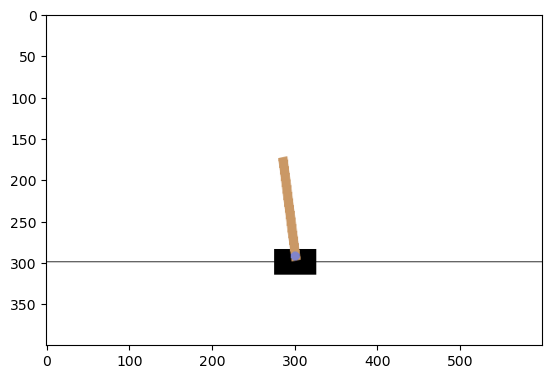

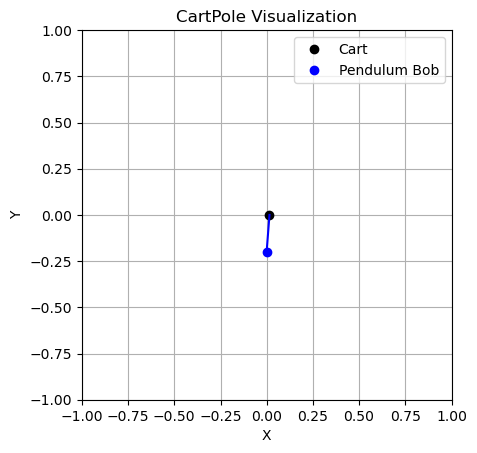


STEP:  10
CART POSITION:  0.038552646
CART VELOCITY:  1.371651
POLE ANGLE WRT CART:  -0.16514699
VELOCITY AT TOP OF POLE:  -2.1851947
ACTION: Push cart to right


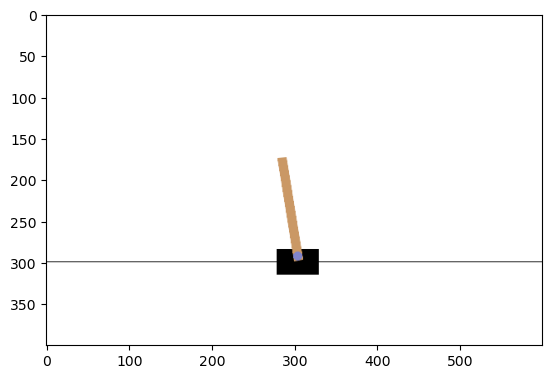

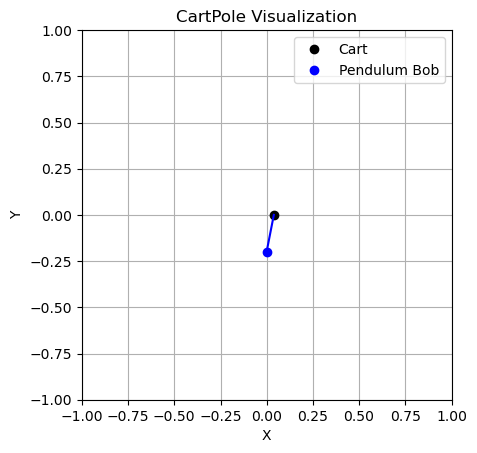


STEP:  11
CART POSITION:  0.065985665
CART VELOCITY:  1.5679446
POLE ANGLE WRT CART:  -0.20885088
VELOCITY AT TOP OF POLE:  -2.5239618
ACTION: Push cart to right


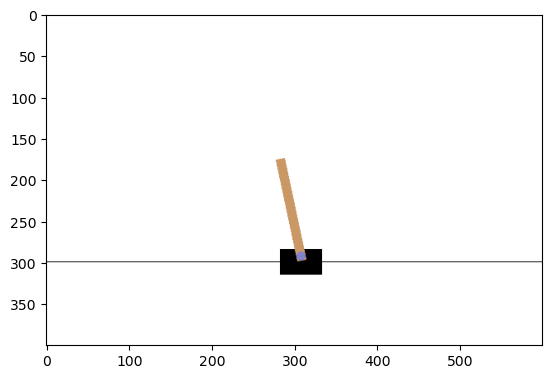

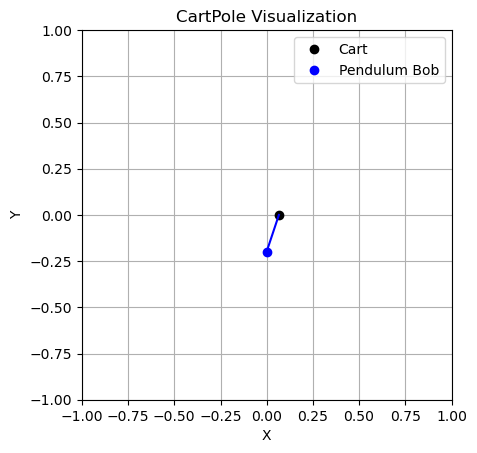


STEP:  1
CART POSITION:  0.041847955
CART VELOCITY:  -0.008574611
POLE ANGLE WRT CART:  0.004500468
VELOCITY AT TOP OF POLE:  0.03112438
ACTION: Push cart to left


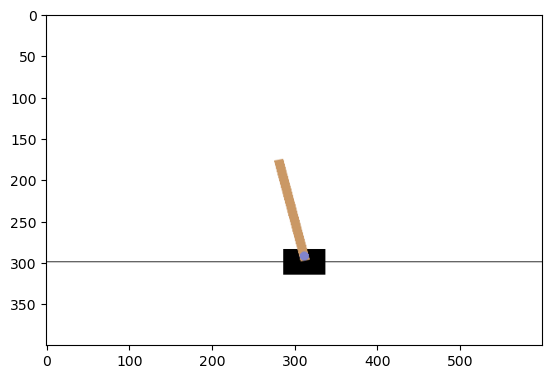

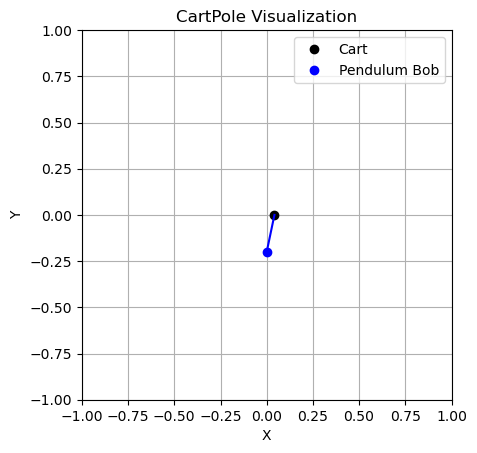


STEP:  2
CART POSITION:  0.04167646
CART VELOCITY:  -0.20376082
POLE ANGLE WRT CART:  0.0051229554
VELOCITY AT TOP OF POLE:  0.32522383
ACTION: Push cart to left


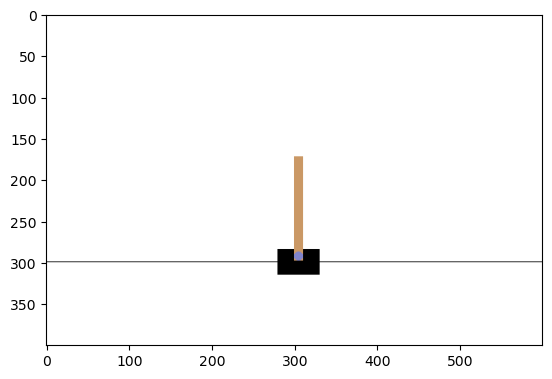

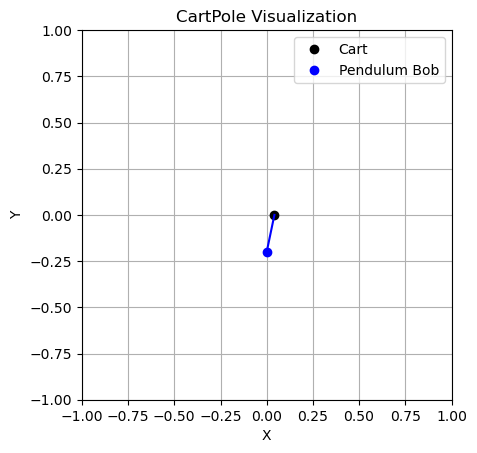


STEP:  3
CART POSITION:  0.037601247
CART VELOCITY:  -0.39895532
POLE ANGLE WRT CART:  0.011627432
VELOCITY AT TOP OF POLE:  0.6195179
ACTION: Push cart to left


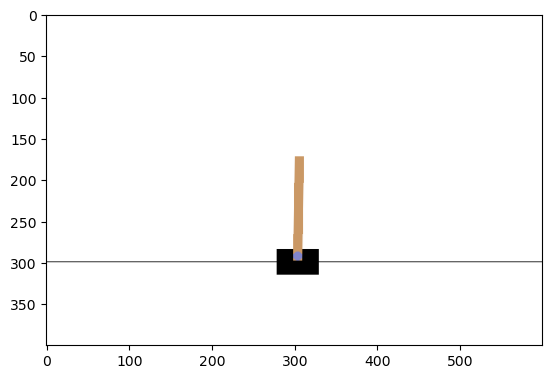

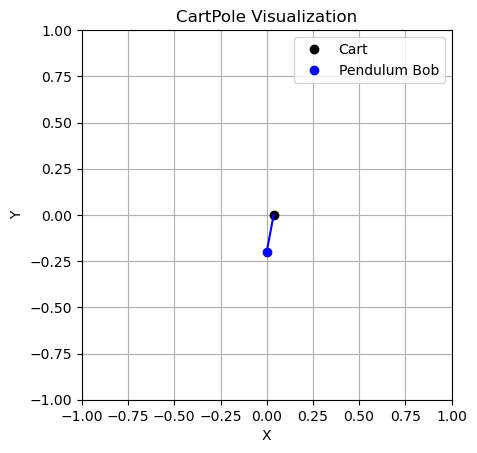


STEP:  4
CART POSITION:  0.02962214
CART VELOCITY:  -0.59423774
POLE ANGLE WRT CART:  0.02401779
VELOCITY AT TOP OF POLE:  0.9158401
ACTION: Push cart to left


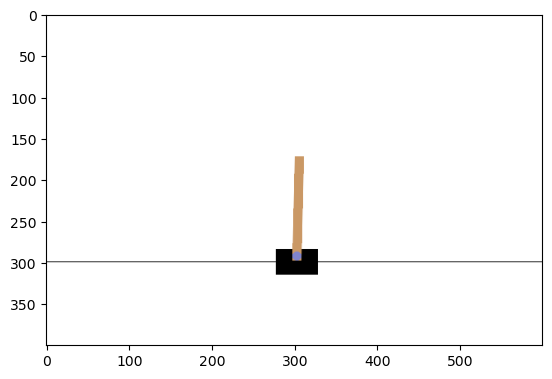

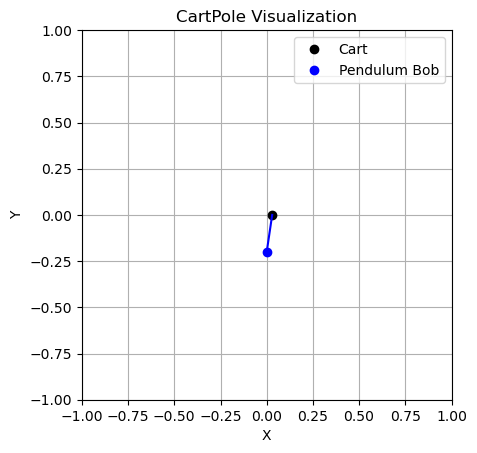


STEP:  5
CART POSITION:  0.017737385
CART VELOCITY:  -0.78967613
POLE ANGLE WRT CART:  0.042334594
VELOCITY AT TOP OF POLE:  1.2159736
ACTION: Push cart to left


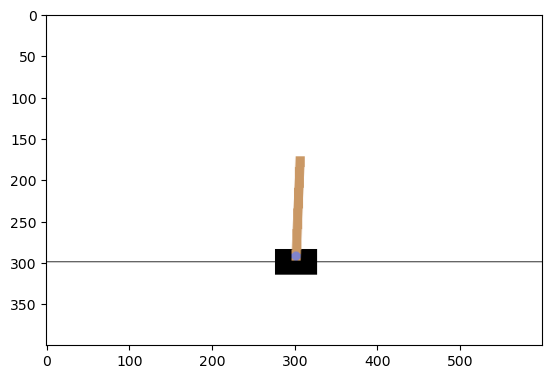

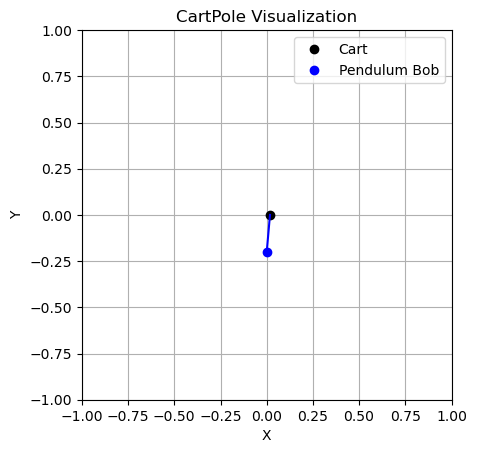


STEP:  6
CART POSITION:  0.0019438635
CART VELOCITY:  -0.98531777
POLE ANGLE WRT CART:  0.066654064
VELOCITY AT TOP OF POLE:  1.5216159
ACTION: Push cart to left


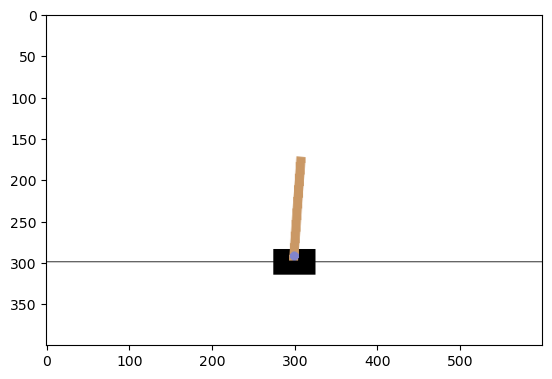

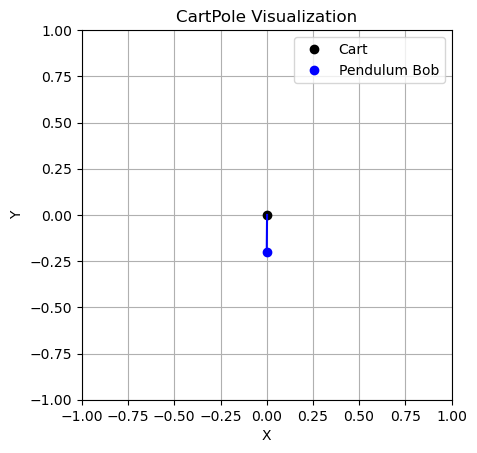


STEP:  7
CART POSITION:  -0.017762491
CART VELOCITY:  -1.1811788
POLE ANGLE WRT CART:  0.097086385
VELOCITY AT TOP OF POLE:  1.8343369
ACTION: Push cart to left


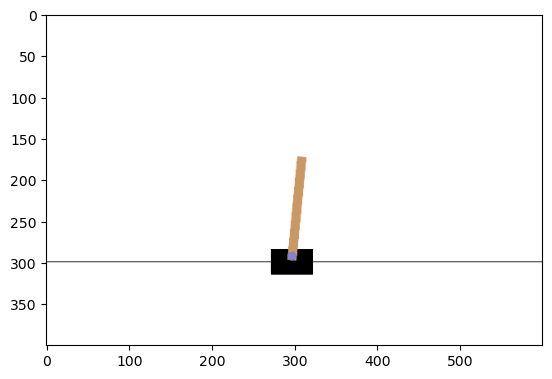

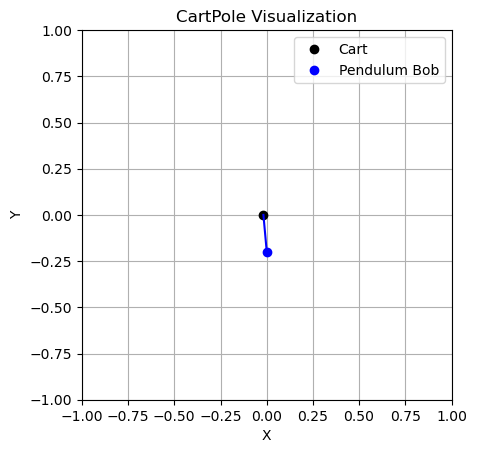


STEP:  8
CART POSITION:  -0.041386068
CART VELOCITY:  -1.3772314
POLE ANGLE WRT CART:  0.13377312
VELOCITY AT TOP OF POLE:  2.1555295
ACTION: Push cart to left


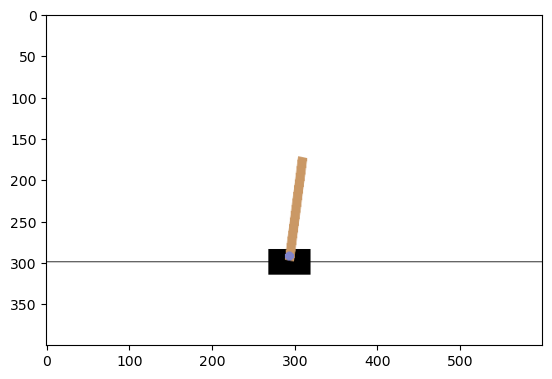

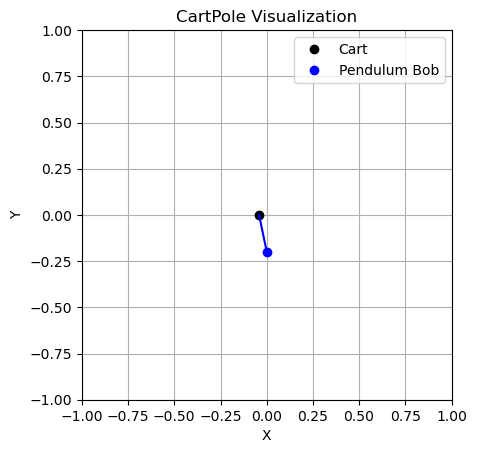


STEP:  9
CART POSITION:  -0.06893069
CART VELOCITY:  -1.573389
POLE ANGLE WRT CART:  0.17688371
VELOCITY AT TOP OF POLE:  2.4863493
ACTION: Push cart to left


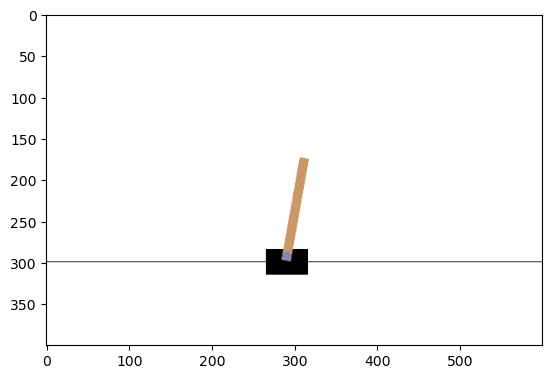

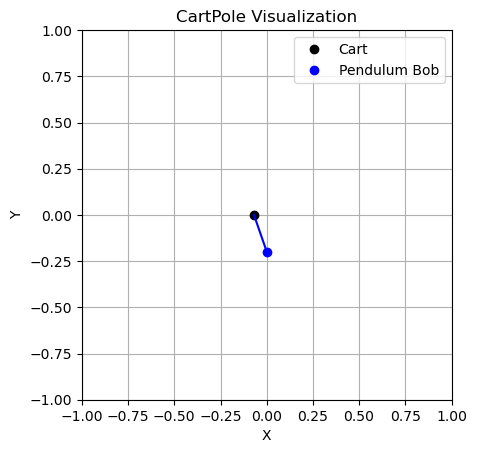


STEP:  1
CART POSITION:  -0.006158552
CART VELOCITY:  0.049969215
POLE ANGLE WRT CART:  0.034851257
VELOCITY AT TOP OF POLE:  0.04555232
ACTION: Push cart to left


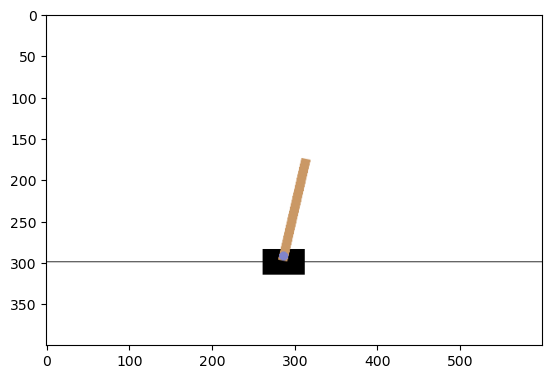

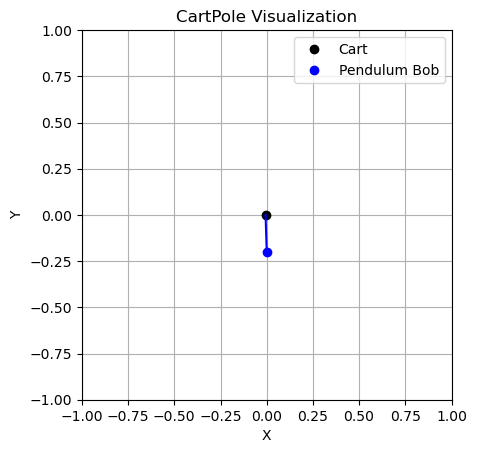


STEP:  2
CART POSITION:  -0.005159168
CART VELOCITY:  -0.1456347
POLE ANGLE WRT CART:  0.035762303
VELOCITY AT TOP OF POLE:  0.34902424
ACTION: Push cart to left


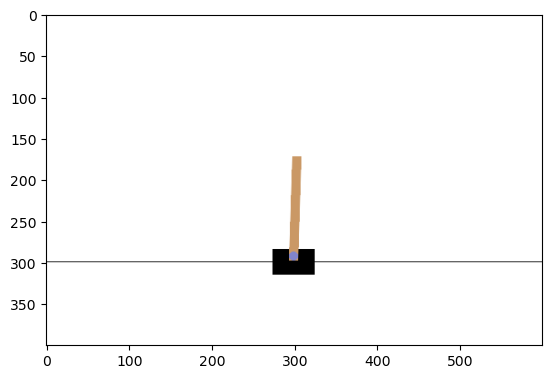

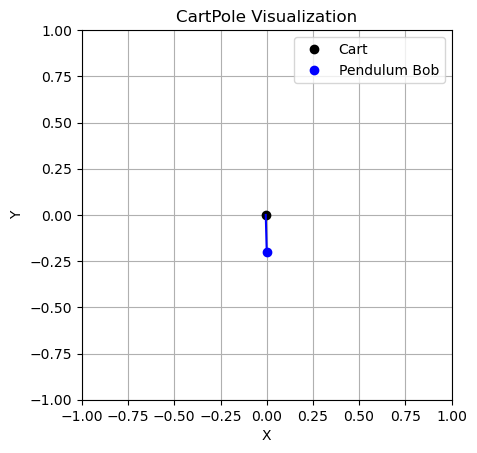


STEP:  3
CART POSITION:  -0.008071862
CART VELOCITY:  -0.34124655
POLE ANGLE WRT CART:  0.04274279
VELOCITY AT TOP OF POLE:  0.6527663
ACTION: Push cart to left


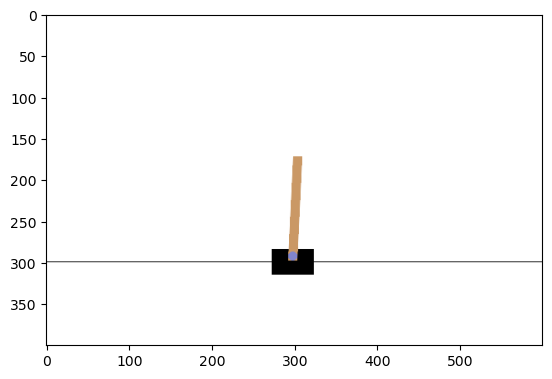

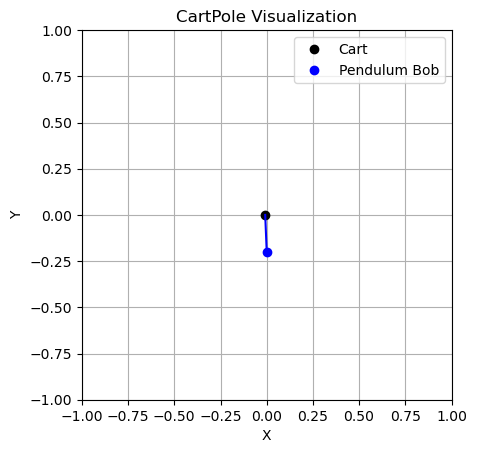


STEP:  4
CART POSITION:  -0.014896793
CART VELOCITY:  -0.5369368
POLE ANGLE WRT CART:  0.055798113
VELOCITY AT TOP OF POLE:  0.95859617
ACTION: Push cart to left


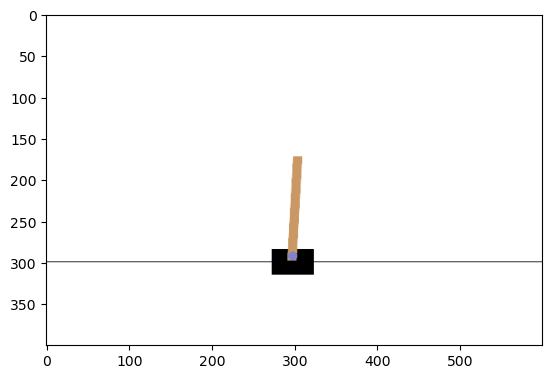

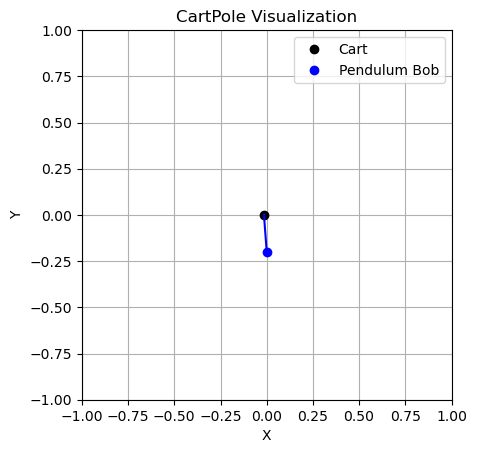


STEP:  5
CART POSITION:  -0.02563553
CART VELOCITY:  -0.7327628
POLE ANGLE WRT CART:  0.07497004
VELOCITY AT TOP OF POLE:  1.2682741
ACTION: Push cart to left


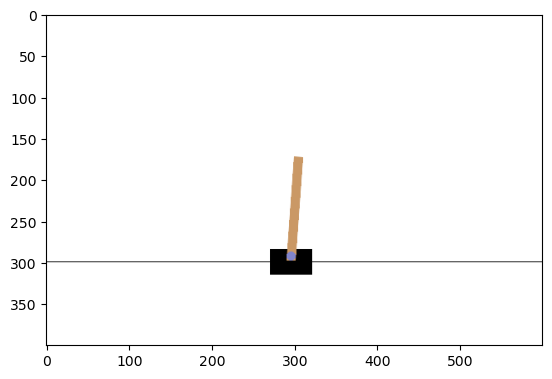

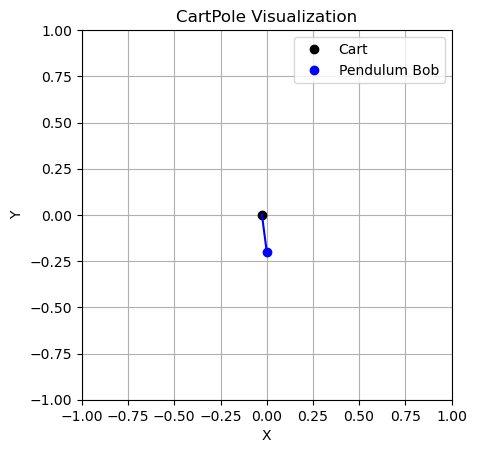


STEP:  6
CART POSITION:  -0.040290788
CART VELOCITY:  -0.9287579
POLE ANGLE WRT CART:  0.100335516
VELOCITY AT TOP OF POLE:  1.5834615
ACTION: Push cart to left


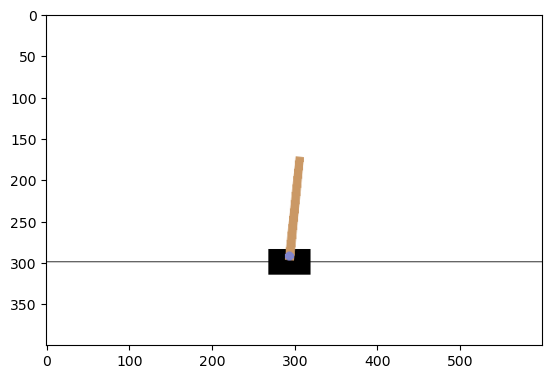

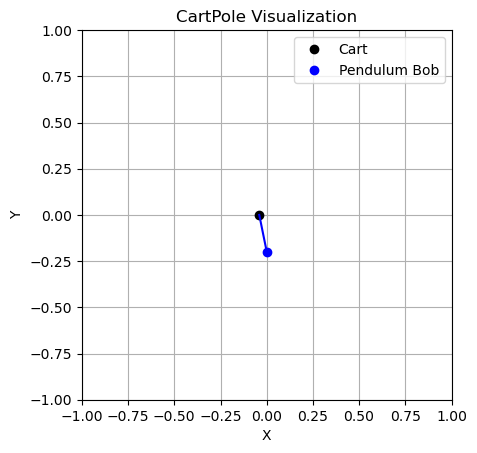


STEP:  7
CART POSITION:  -0.058865946
CART VELOCITY:  -1.1249201
POLE ANGLE WRT CART:  0.13200475
VELOCITY AT TOP OF POLE:  1.9056741
ACTION: Push cart to left


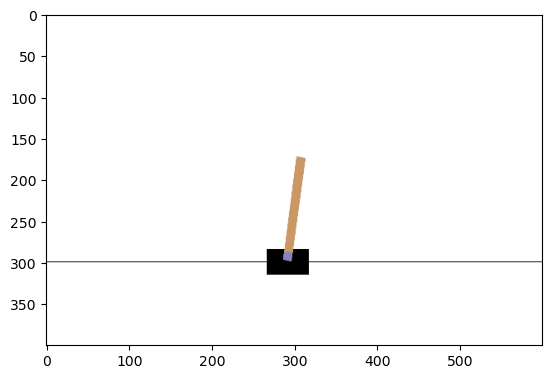

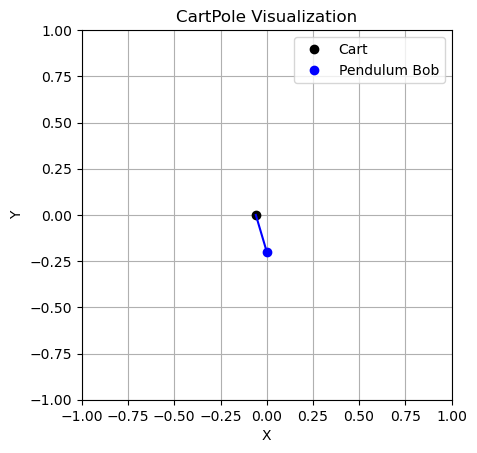


STEP:  8
CART POSITION:  -0.08136435
CART VELOCITY:  -1.3211982
POLE ANGLE WRT CART:  0.17011823
VELOCITY AT TOP OF POLE:  2.2362266
ACTION: Push cart to left


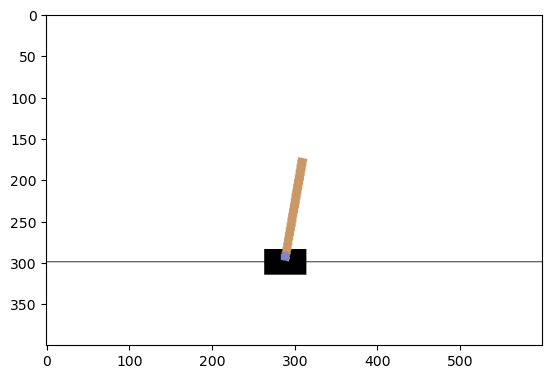

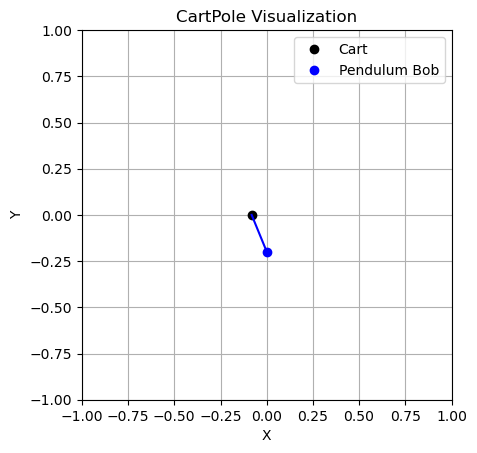


STEP:  1
CART POSITION:  -0.031982545
CART VELOCITY:  0.040764492
POLE ANGLE WRT CART:  -0.0043092356
VELOCITY AT TOP OF POLE:  -0.002375167
ACTION: Push cart to right


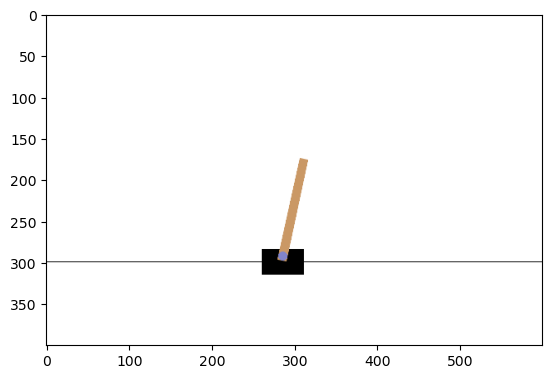

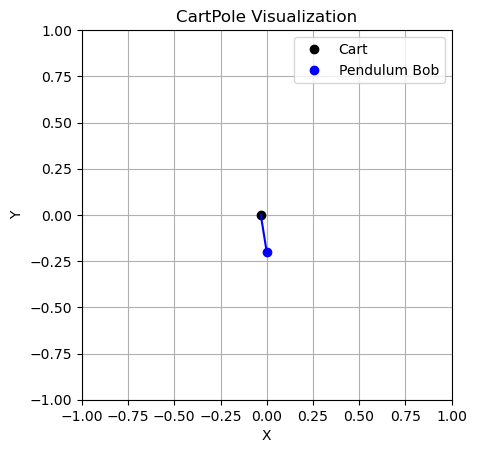


STEP:  2
CART POSITION:  -0.031167256
CART VELOCITY:  0.23594798
POLE ANGLE WRT CART:  -0.0043567386
VELOCITY AT TOP OF POLE:  -0.29641458
ACTION: Push cart to right


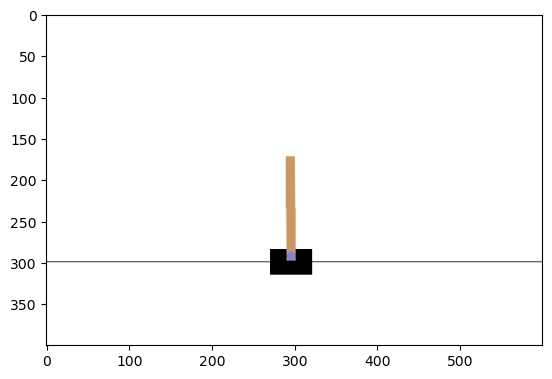

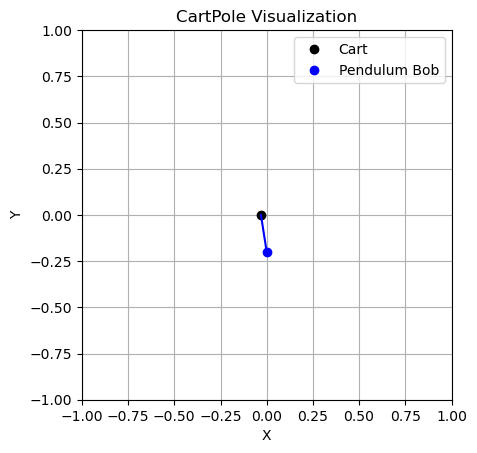


STEP:  3
CART POSITION:  -0.026448296
CART VELOCITY:  0.43113178
POLE ANGLE WRT CART:  -0.010285031
VELOCITY AT TOP OF POLE:  -0.59046835
ACTION: Push cart to right


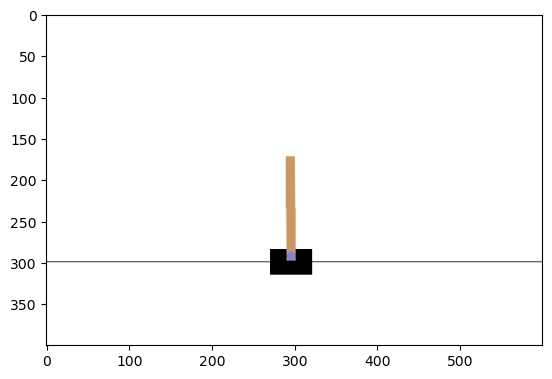

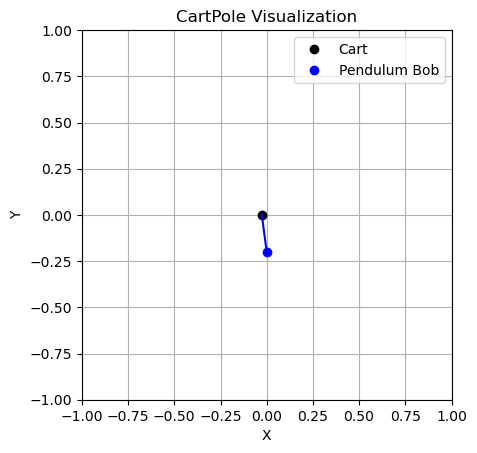


STEP:  4
CART POSITION:  -0.017825661
CART VELOCITY:  0.6263962
POLE ANGLE WRT CART:  -0.022094399
VELOCITY AT TOP OF POLE:  -0.8863733
ACTION: Push cart to right


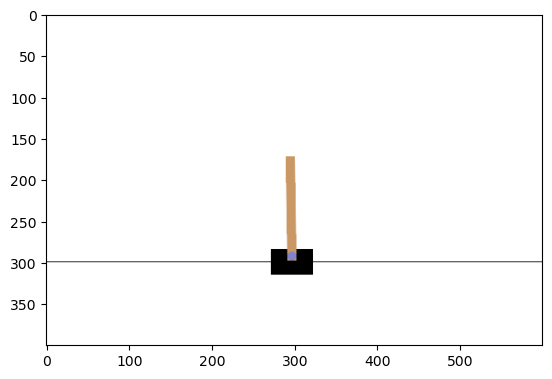

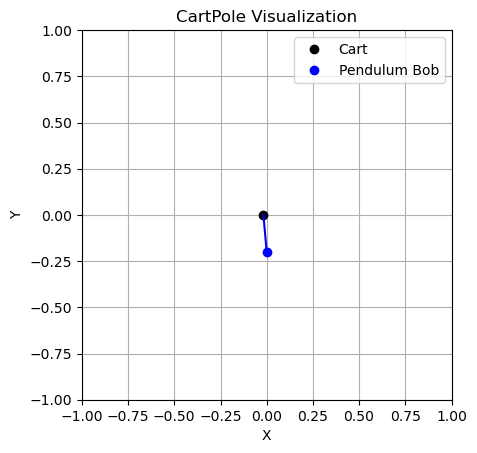


STEP:  5
CART POSITION:  -0.0052977377
CART VELOCITY:  0.821811
POLE ANGLE WRT CART:  -0.039821863
VELOCITY AT TOP OF POLE:  -1.1859192
ACTION: Push cart to right


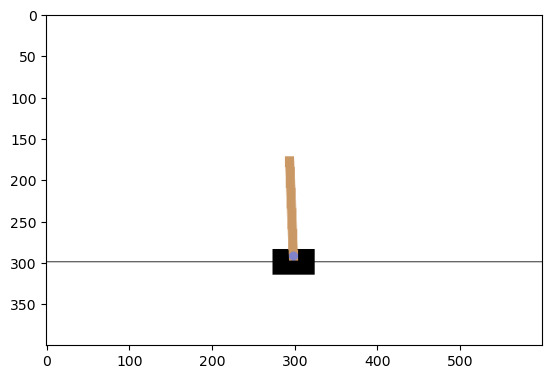

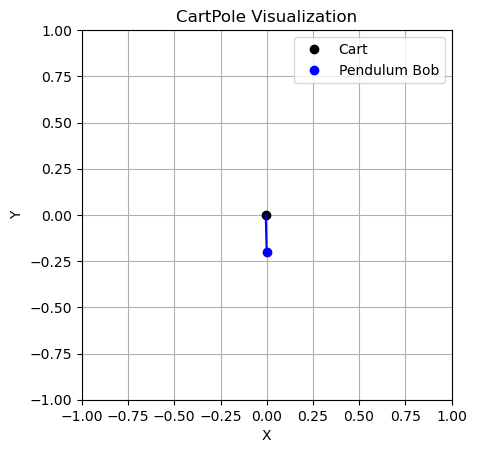


STEP:  6
CART POSITION:  0.011138483
CART VELOCITY:  1.0174261
POLE ANGLE WRT CART:  -0.06354025
VELOCITY AT TOP OF POLE:  -1.4908137
ACTION: Push cart to right


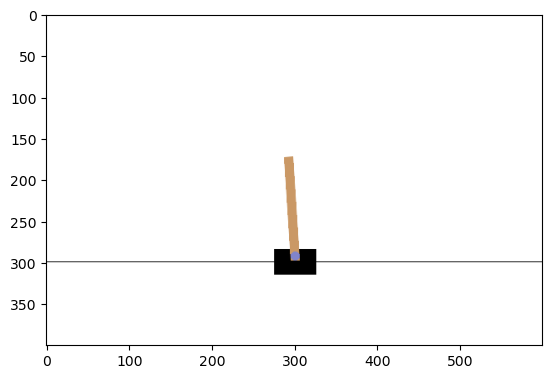

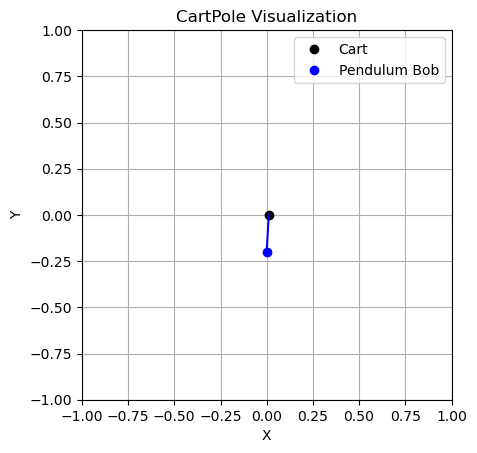


STEP:  7
CART POSITION:  0.031487007
CART VELOCITY:  1.2132615
POLE ANGLE WRT CART:  -0.09335652
VELOCITY AT TOP OF POLE:  -1.8026422
ACTION: Push cart to right


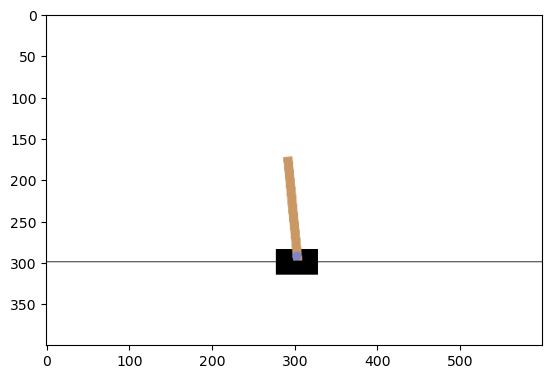

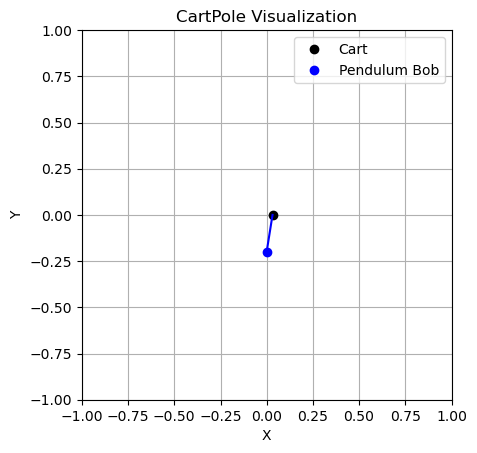


STEP:  8
CART POSITION:  0.055752233
CART VELOCITY:  1.4092944
POLE ANGLE WRT CART:  -0.12940937
VELOCITY AT TOP OF POLE:  -2.122818
ACTION: Push cart to right


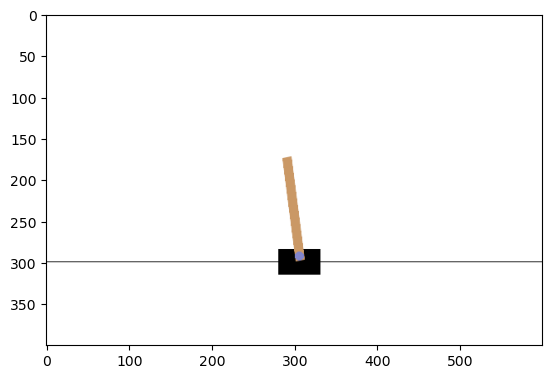

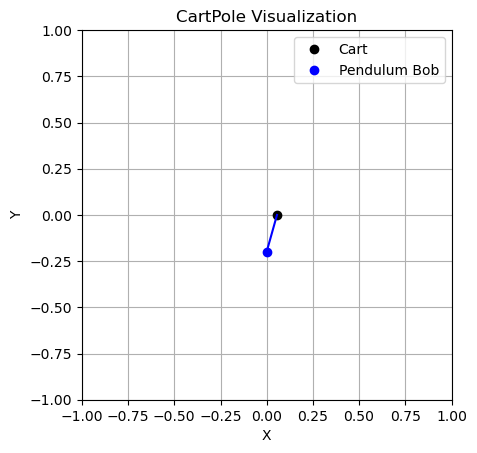


STEP:  9
CART POSITION:  0.08393812
CART VELOCITY:  1.6054451
POLE ANGLE WRT CART:  -0.17186573
VELOCITY AT TOP OF POLE:  -2.4525244
ACTION: Push cart to right


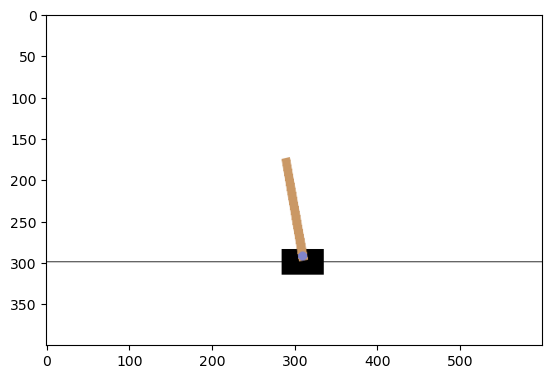

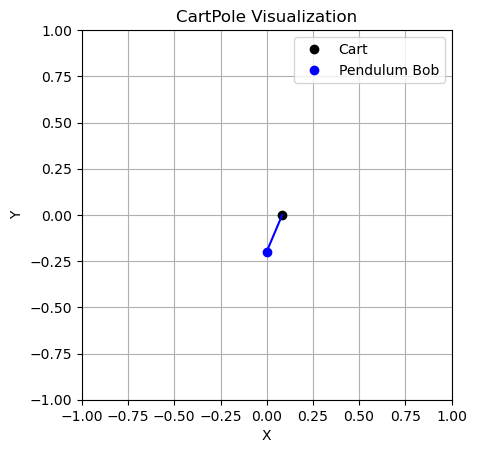


STEP:  1
CART POSITION:  0.01785424
CART VELOCITY:  -0.02794262
POLE ANGLE WRT CART:  -0.033013977
VELOCITY AT TOP OF POLE:  0.012589286
ACTION: Push cart to left


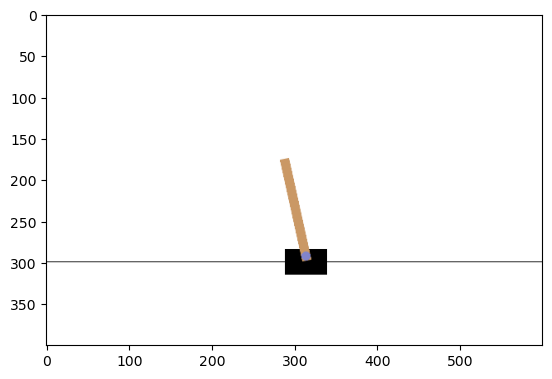

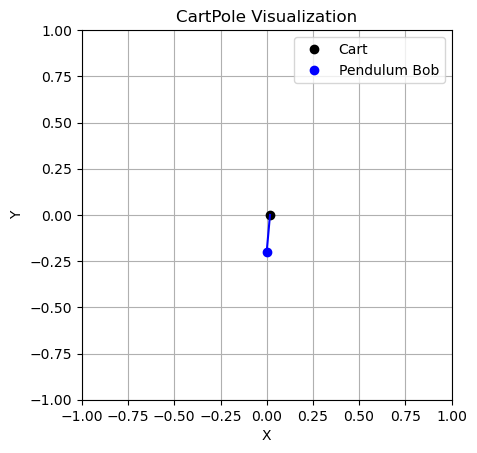


STEP:  2
CART POSITION:  0.017295389
CART VELOCITY:  -0.22257593
POLE ANGLE WRT CART:  -0.032762192
VELOCITY AT TOP OF POLE:  0.29467583
ACTION: Push cart to left


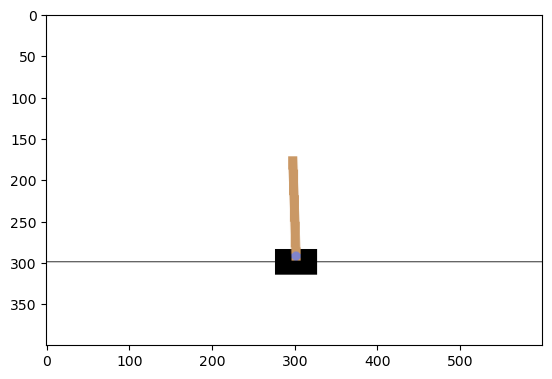

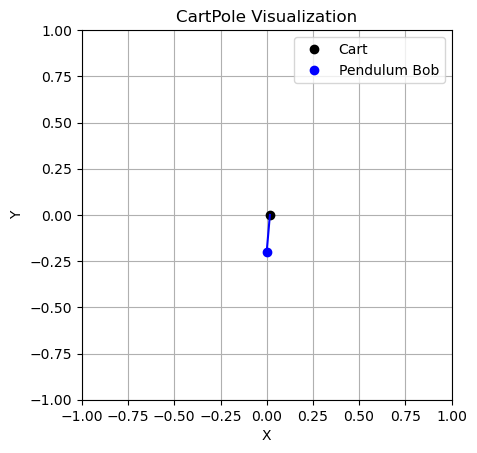


STEP:  3
CART POSITION:  0.01284387
CART VELOCITY:  -0.41721585
POLE ANGLE WRT CART:  -0.026868677
VELOCITY AT TOP OF POLE:  0.5768487
ACTION: Push cart to left


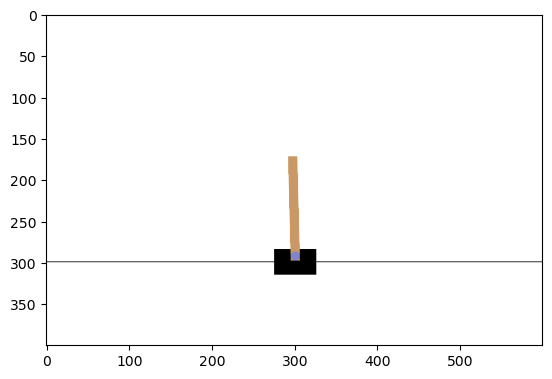

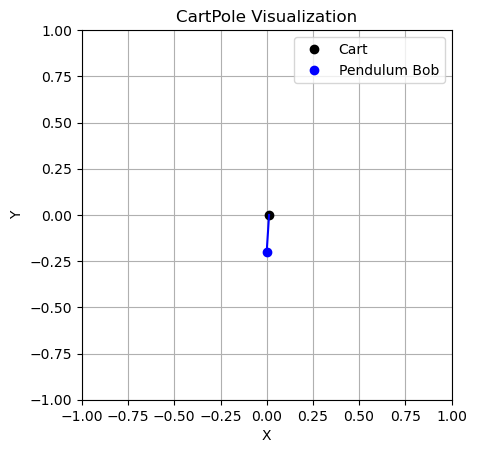


STEP:  4
CART POSITION:  0.0044995523
CART VELOCITY:  -0.6119511
POLE ANGLE WRT CART:  -0.015331703
VELOCITY AT TOP OF POLE:  0.86094767
ACTION: Push cart to left


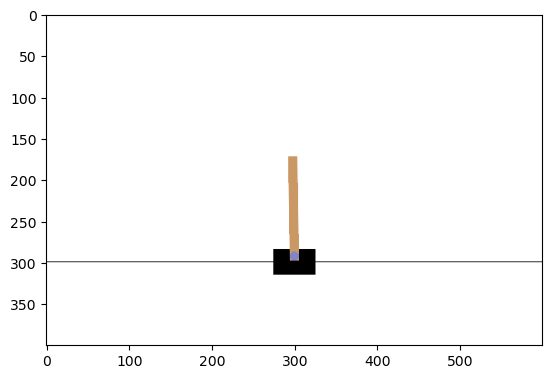

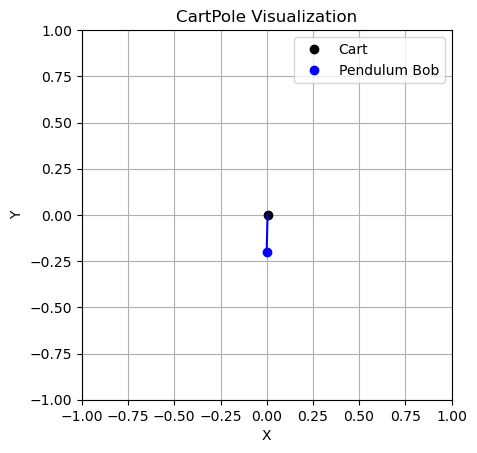


STEP:  5
CART POSITION:  -0.0077394694
CART VELOCITY:  -0.8068609
POLE ANGLE WRT CART:  0.00188725
VELOCITY AT TOP OF POLE:  1.1487707
ACTION: Push cart to left


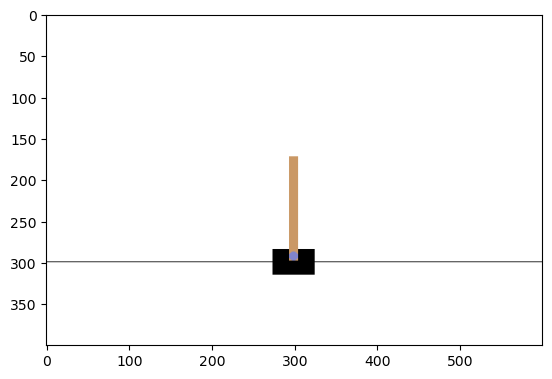

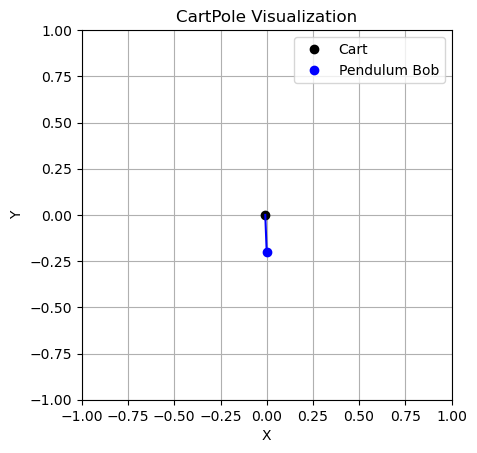


STEP:  6
CART POSITION:  -0.023876688
CART VELOCITY:  -1.0020075
POLE ANGLE WRT CART:  0.024862664
VELOCITY AT TOP OF POLE:  1.4420449
ACTION: Push cart to left


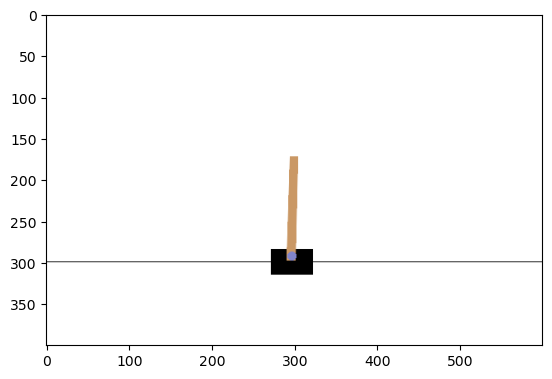

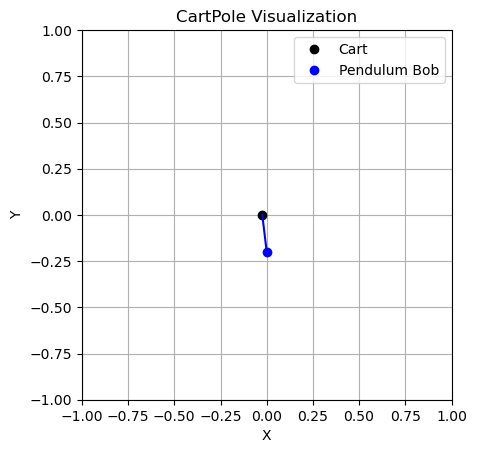


STEP:  7
CART POSITION:  -0.043916836
CART VELOCITY:  -1.1974266
POLE ANGLE WRT CART:  0.05370356
VELOCITY AT TOP OF POLE:  1.7423918
ACTION: Push cart to left


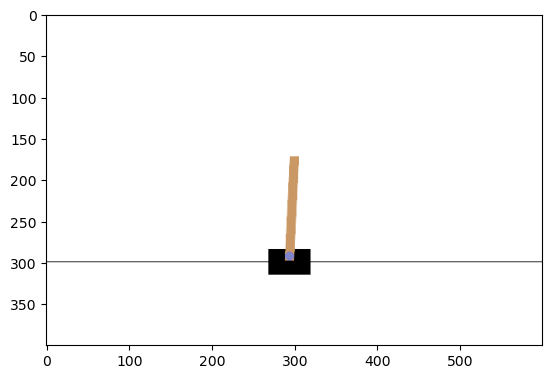

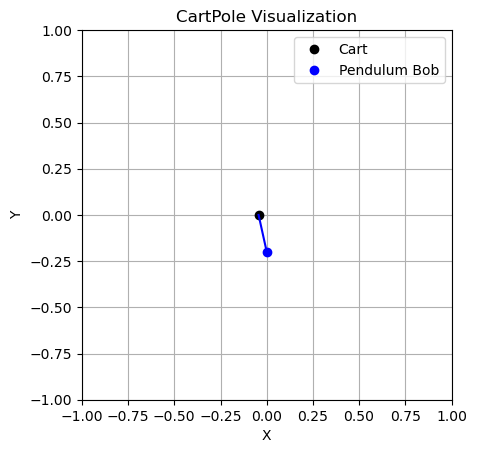


STEP:  8
CART POSITION:  -0.06786537
CART VELOCITY:  -1.393117
POLE ANGLE WRT CART:  0.088551395
VELOCITY AT TOP OF POLE:  2.0512855
ACTION: Push cart to left


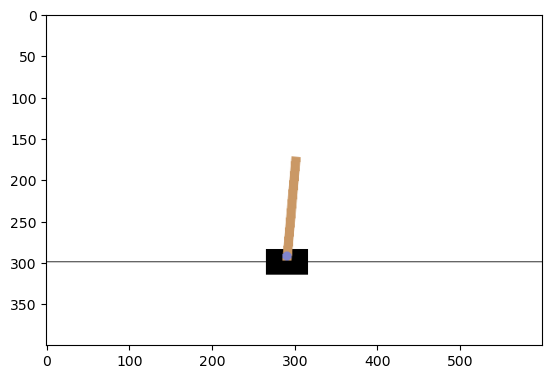

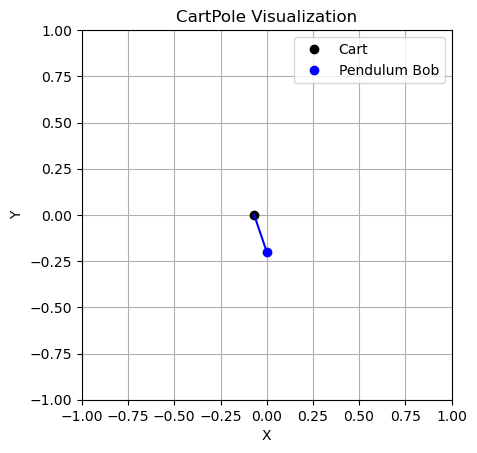


STEP:  9
CART POSITION:  -0.09572771
CART VELOCITY:  -1.5890272
POLE ANGLE WRT CART:  0.1295771
VELOCITY AT TOP OF POLE:  2.3699994
ACTION: Push cart to left


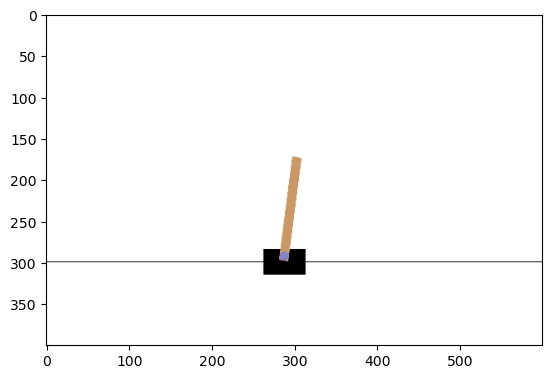

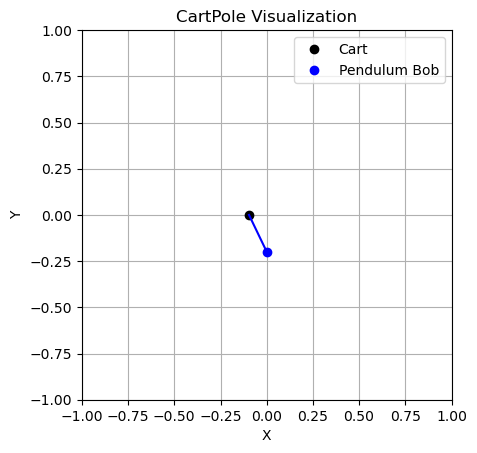


STEP:  10
CART POSITION:  -0.12750825
CART VELOCITY:  -1.7850391
POLE ANGLE WRT CART:  0.1769771
VELOCITY AT TOP OF POLE:  2.6995416
ACTION: Push cart to left


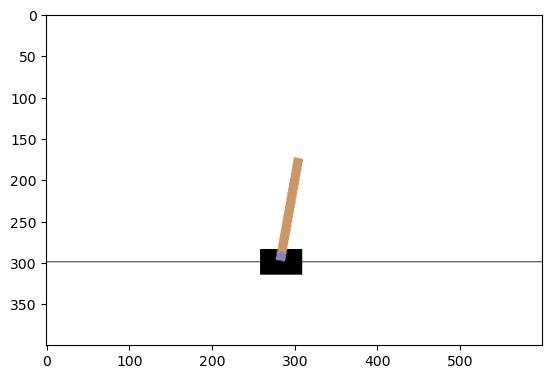

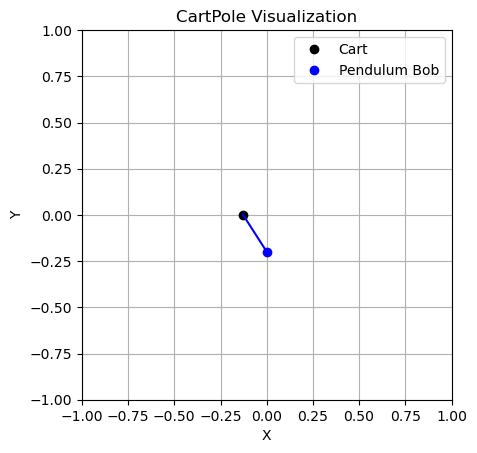


STEP:  1
CART POSITION:  0.0046223984
CART VELOCITY:  -0.02989359
POLE ANGLE WRT CART:  -0.023636768
VELOCITY AT TOP OF POLE:  0.014629866
ACTION: Push cart to right


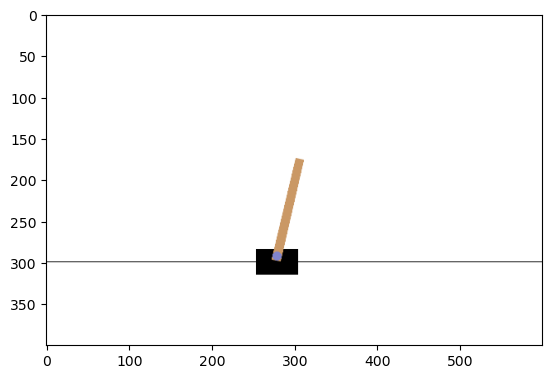

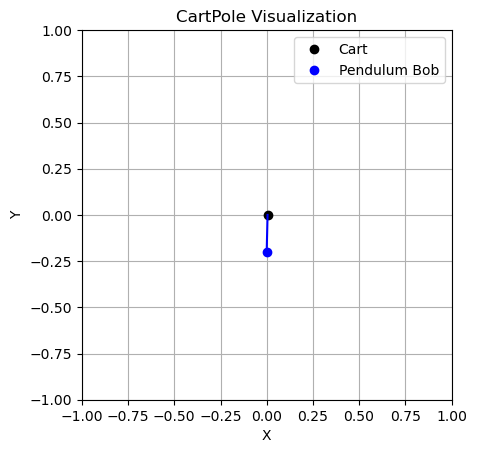


STEP:  2
CART POSITION:  0.0040245266
CART VELOCITY:  0.16555923
POLE ANGLE WRT CART:  -0.02334417
VELOCITY AT TOP OF POLE:  -0.28541604
ACTION: Push cart to right


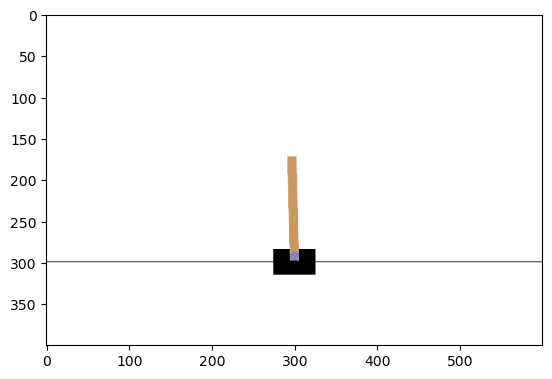

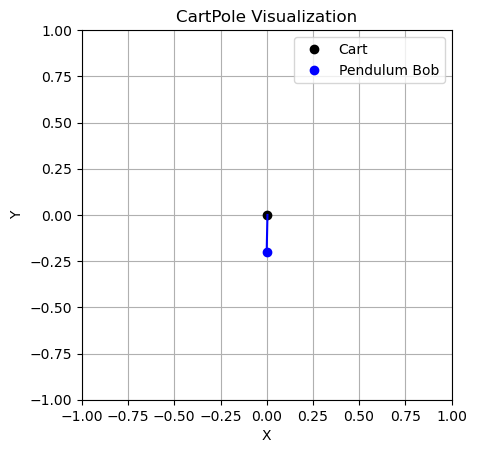


STEP:  3
CART POSITION:  0.007335711
CART VELOCITY:  0.3610062
POLE ANGLE WRT CART:  -0.02905249
VELOCITY AT TOP OF POLE:  -0.58536917
ACTION: Push cart to right


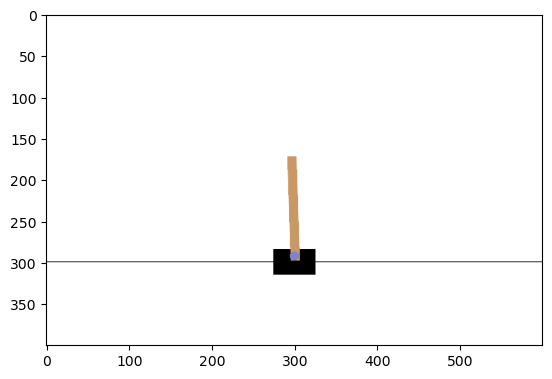

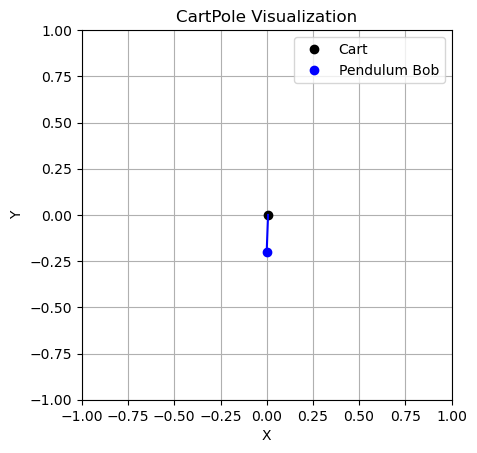


STEP:  4
CART POSITION:  0.014555835
CART VELOCITY:  0.5565228
POLE ANGLE WRT CART:  -0.040759873
VELOCITY AT TOP OF POLE:  -0.8870605
ACTION: Push cart to right


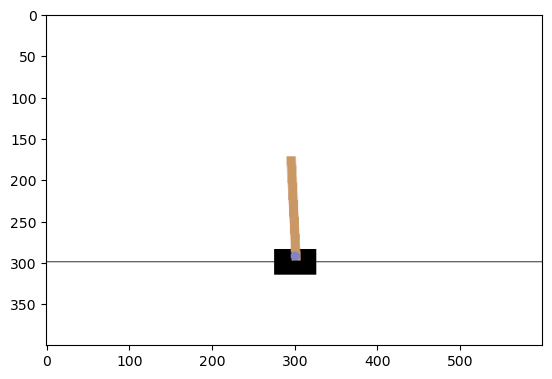

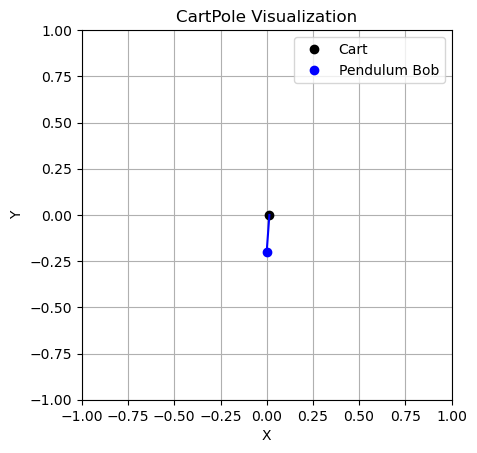


STEP:  5
CART POSITION:  0.02568629
CART VELOCITY:  0.7521736
POLE ANGLE WRT CART:  -0.058501083
VELOCITY AT TOP OF POLE:  -1.192273
ACTION: Push cart to right


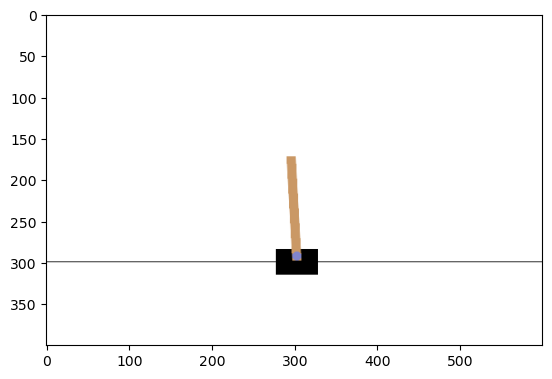

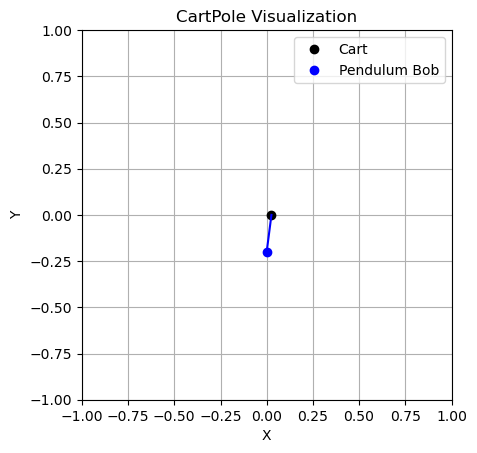


STEP:  6
CART POSITION:  0.04072976
CART VELOCITY:  0.9480026
POLE ANGLE WRT CART:  -0.08234654
VELOCITY AT TOP OF POLE:  -1.5027035
ACTION: Push cart to right


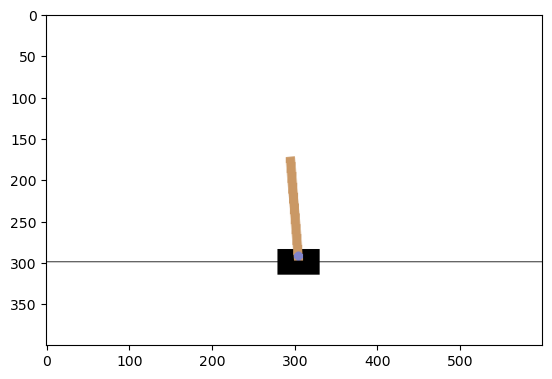

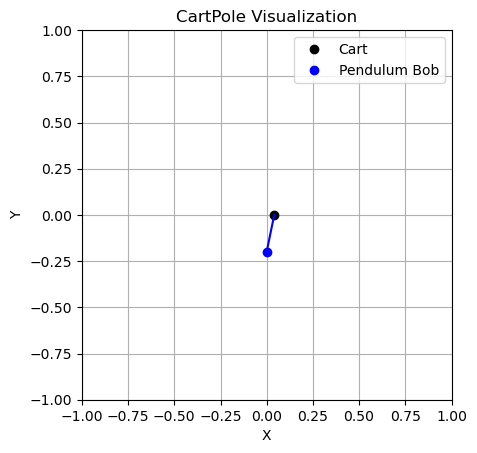


STEP:  7
CART POSITION:  0.059689812
CART VELOCITY:  1.1440219
POLE ANGLE WRT CART:  -0.11240061
VELOCITY AT TOP OF POLE:  -1.8199188
ACTION: Push cart to right


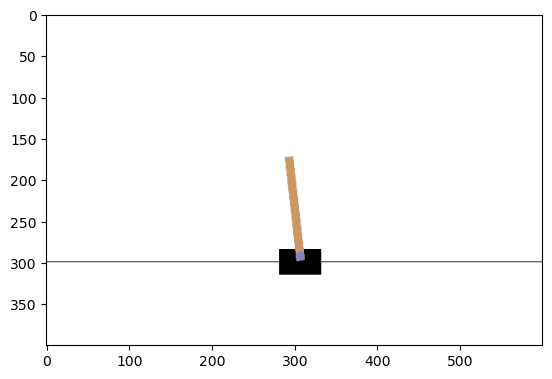

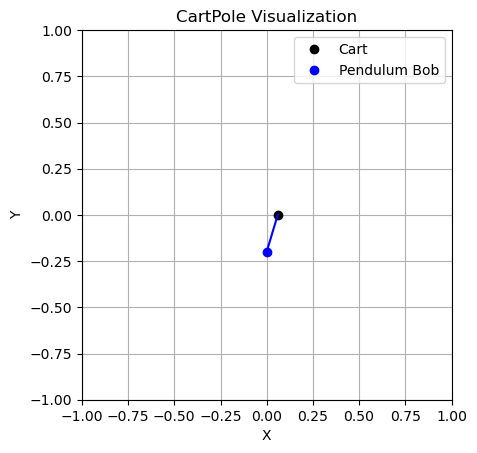


STEP:  8
CART POSITION:  0.082570255
CART VELOCITY:  1.3401992
POLE ANGLE WRT CART:  -0.14879899
VELOCITY AT TOP OF POLE:  -2.1453042
ACTION: Push cart to right


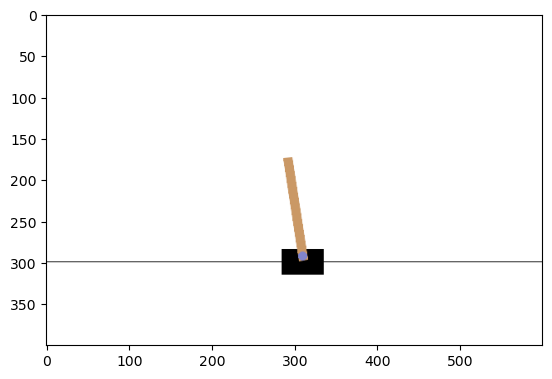

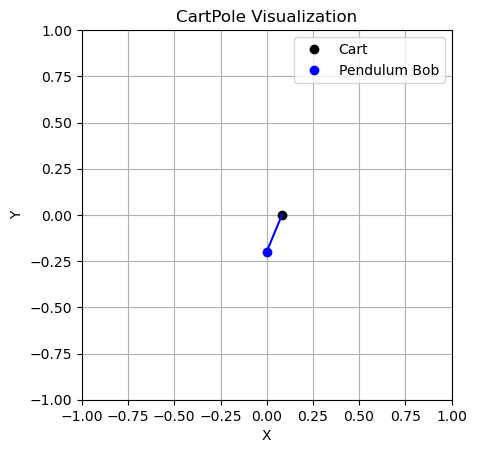


STEP:  9
CART POSITION:  0.10937424
CART VELOCITY:  1.5364426
POLE ANGLE WRT CART:  -0.19170508
VELOCITY AT TOP OF POLE:  -2.480002
ACTION: Push cart to right


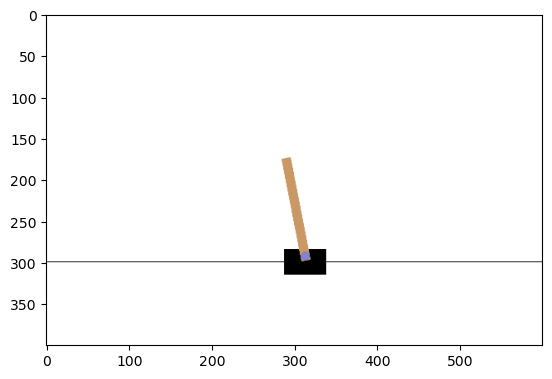

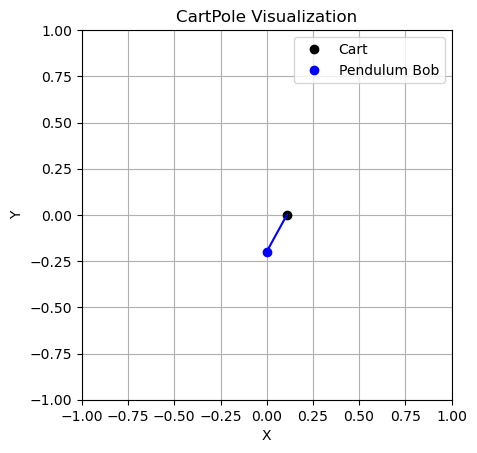


STEP:  1
CART POSITION:  -0.035619456
CART VELOCITY:  0.03261259
POLE ANGLE WRT CART:  0.038471855
VELOCITY AT TOP OF POLE:  0.043799084
ACTION: Push cart to left


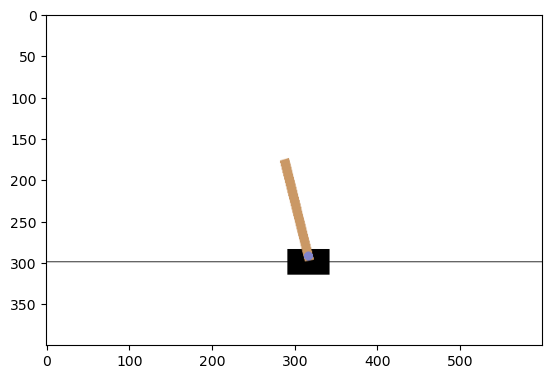

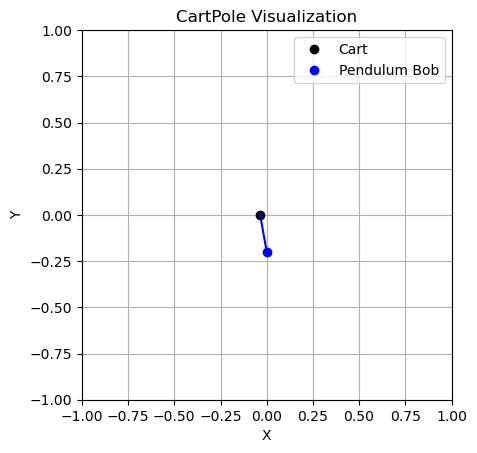


STEP:  2
CART POSITION:  -0.034967206
CART VELOCITY:  -0.16303931
POLE ANGLE WRT CART:  0.039347835
VELOCITY AT TOP OF POLE:  0.34836772
ACTION: Push cart to right


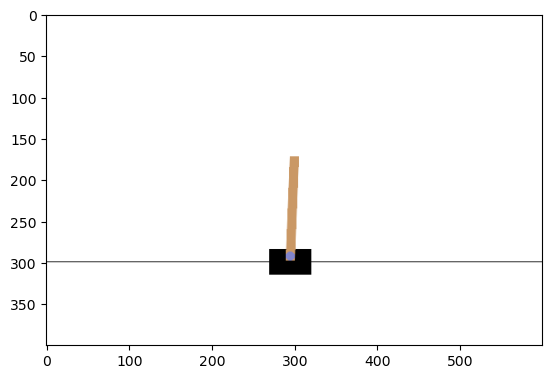

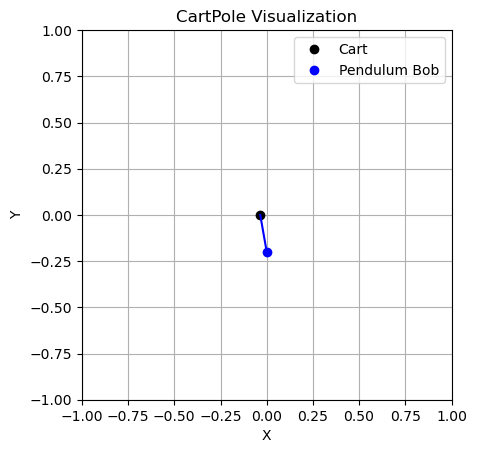


STEP:  3
CART POSITION:  -0.03822799
CART VELOCITY:  0.031501547
POLE ANGLE WRT CART:  0.04631519
VELOCITY AT TOP OF POLE:  0.068347566
ACTION: Push cart to left


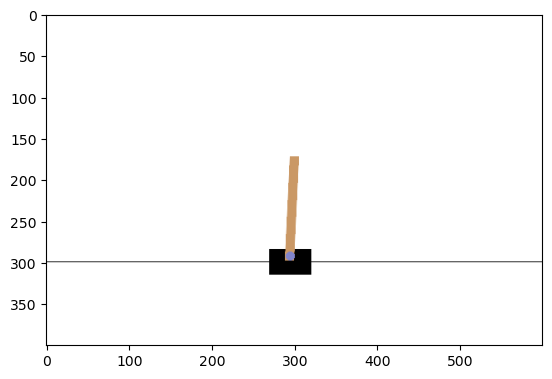

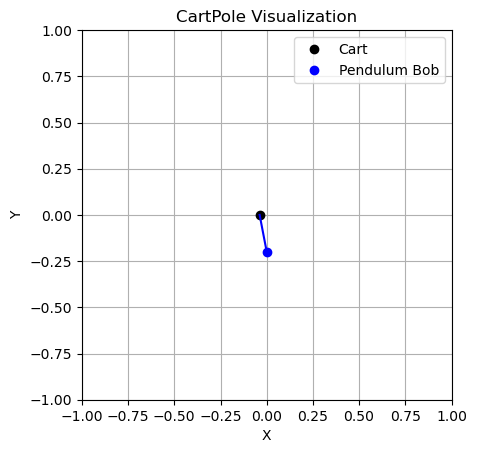


STEP:  4
CART POSITION:  -0.03759796
CART VELOCITY:  -0.16425277
POLE ANGLE WRT CART:  0.04768214
VELOCITY AT TOP OF POLE:  0.37527597
ACTION: Push cart to right


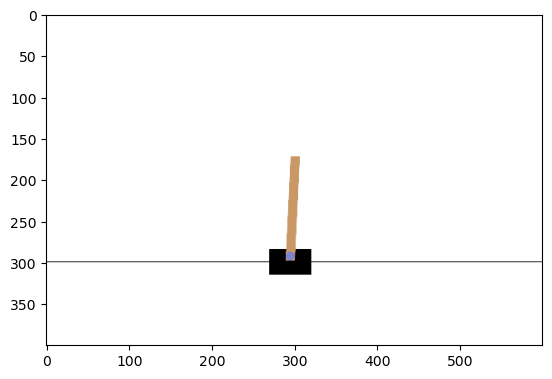

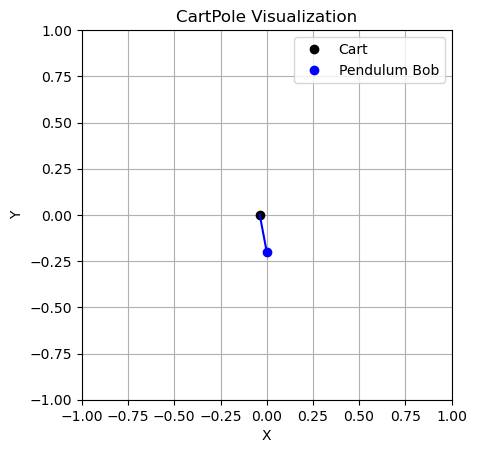


STEP:  5
CART POSITION:  -0.040883016
CART VELOCITY:  0.030160619
POLE ANGLE WRT CART:  0.05518766
VELOCITY AT TOP OF POLE:  0.09800057
ACTION: Push cart to left


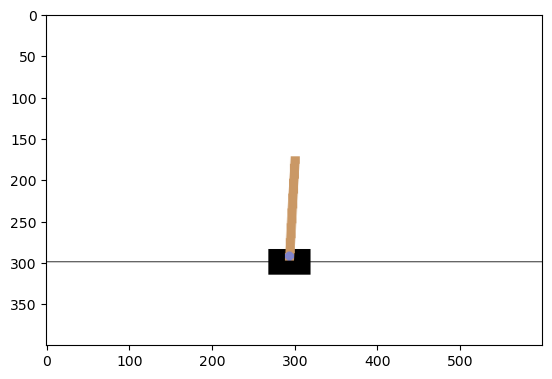

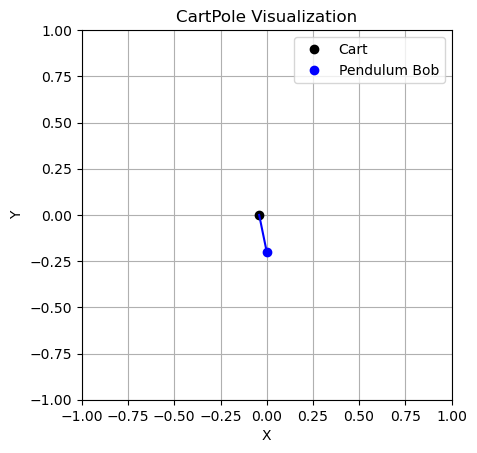


STEP:  6
CART POSITION:  -0.040279806
CART VELOCITY:  -0.16570708
POLE ANGLE WRT CART:  0.05714767
VELOCITY AT TOP OF POLE:  0.40757176
ACTION: Push cart to left


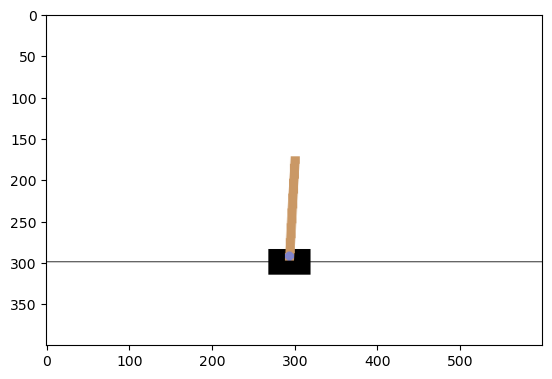

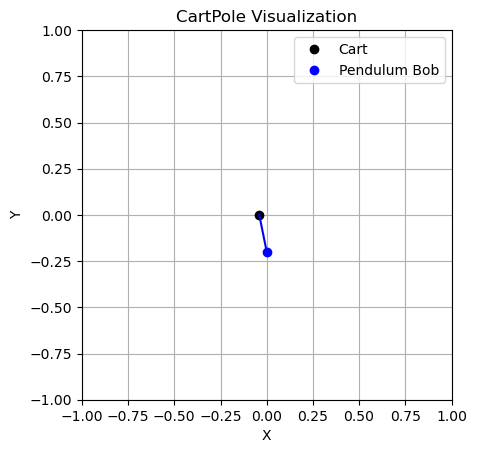


STEP:  7
CART POSITION:  -0.043593947
CART VELOCITY:  -0.3615908
POLE ANGLE WRT CART:  0.06529911
VELOCITY AT TOP OF POLE:  0.71770996
ACTION: Push cart to left


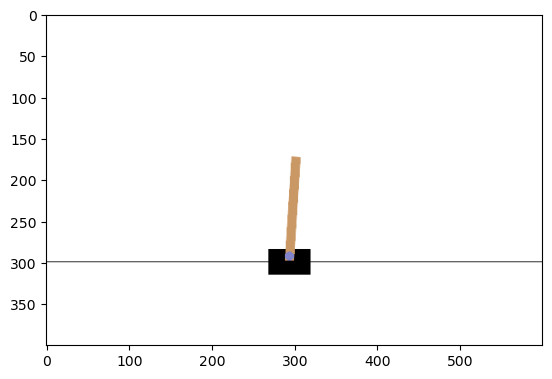

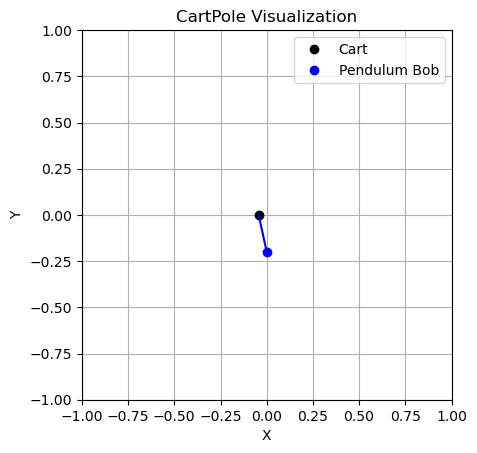


STEP:  8
CART POSITION:  -0.050825763
CART VELOCITY:  -0.55755275
POLE ANGLE WRT CART:  0.07965331
VELOCITY AT TOP OF POLE:  1.0302107
ACTION: Push cart to left


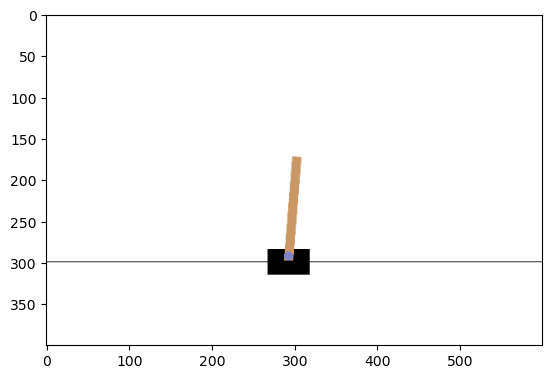

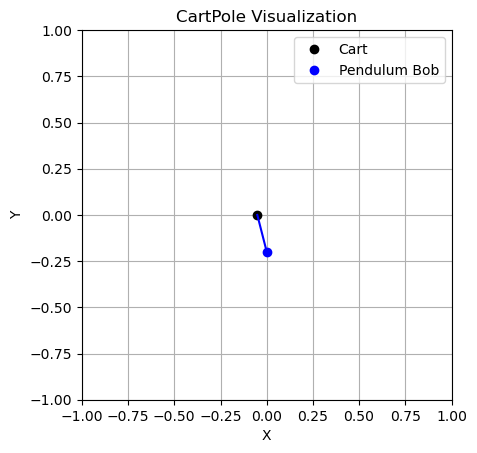


STEP:  9
CART POSITION:  -0.061976817
CART VELOCITY:  -0.753639
POLE ANGLE WRT CART:  0.10025752
VELOCITY AT TOP OF POLE:  1.3468008
ACTION: Push cart to left


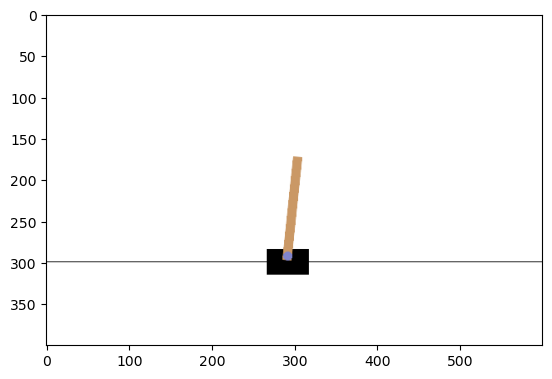

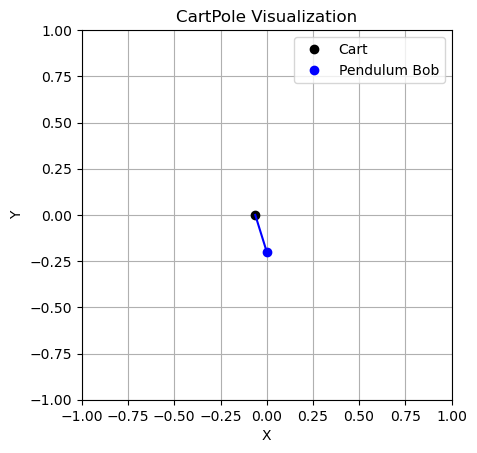


STEP:  10
CART POSITION:  -0.0770496
CART VELOCITY:  -0.9498682
POLE ANGLE WRT CART:  0.12719354
VELOCITY AT TOP OF POLE:  1.6690929
ACTION: Push cart to left


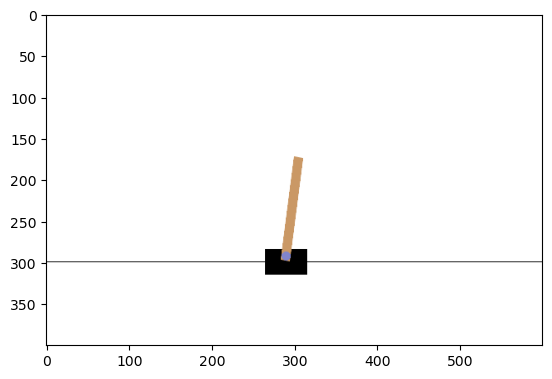

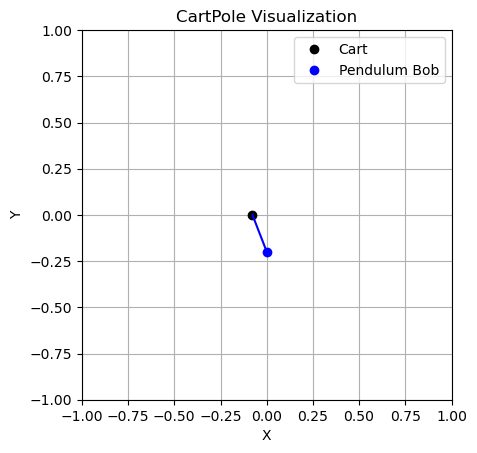


STEP:  11
CART POSITION:  -0.09604696
CART VELOCITY:  -1.1462188
POLE ANGLE WRT CART:  0.16057539
VELOCITY AT TOP OF POLE:  1.9985336
ACTION: Push cart to left


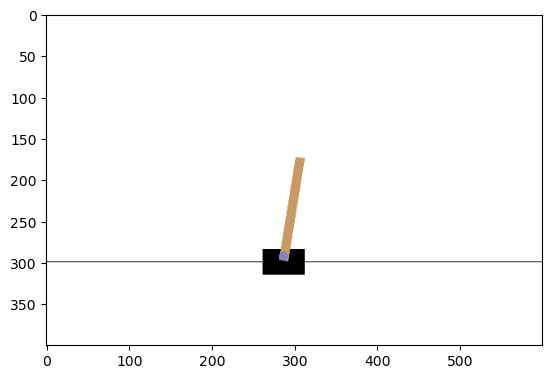

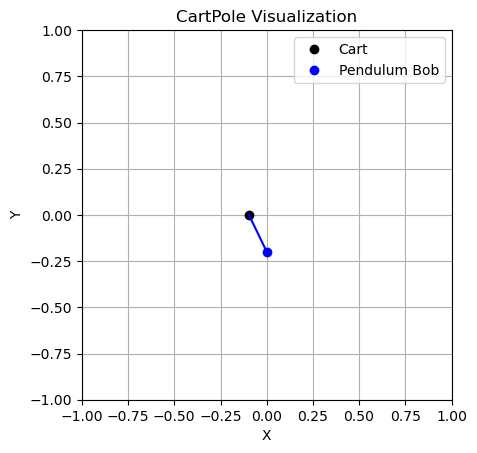


STEP:  12
CART POSITION:  -0.11897133
CART VELOCITY:  -1.3426138
POLE ANGLE WRT CART:  0.20054607
VELOCITY AT TOP OF POLE:  2.336343
ACTION: Push cart to left


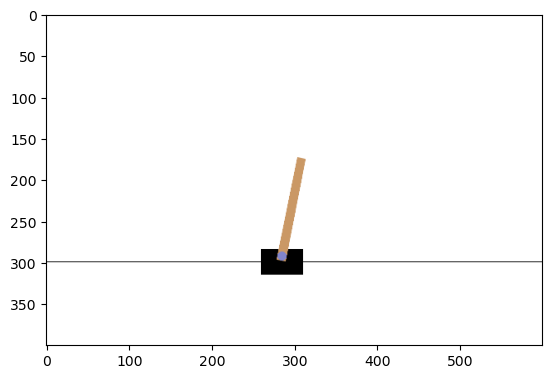

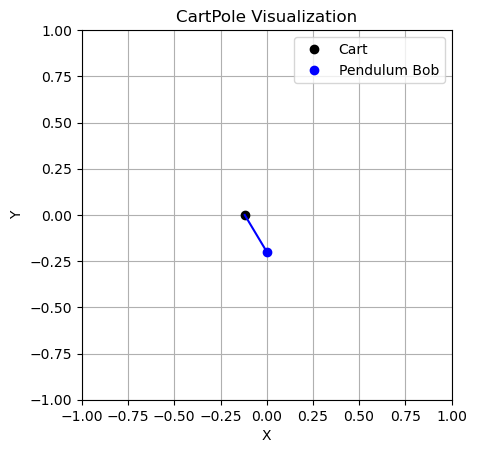


STEP:  1
CART POSITION:  0.045126785
CART VELOCITY:  0.012031911
POLE ANGLE WRT CART:  0.023466675
VELOCITY AT TOP OF POLE:  -0.045675687
ACTION: Push cart to left


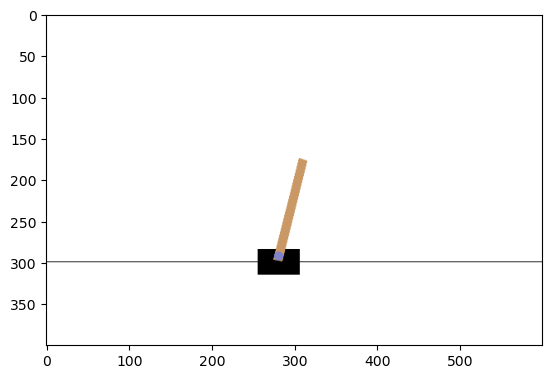

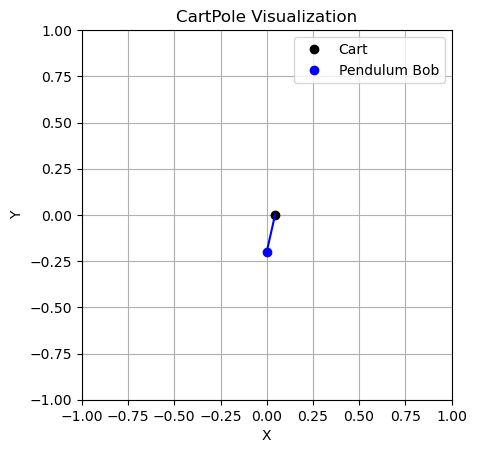


STEP:  2
CART POSITION:  0.045367423
CART VELOCITY:  -0.18341854
POLE ANGLE WRT CART:  0.02255316
VELOCITY AT TOP OF POLE:  0.25431785
ACTION: Push cart to left


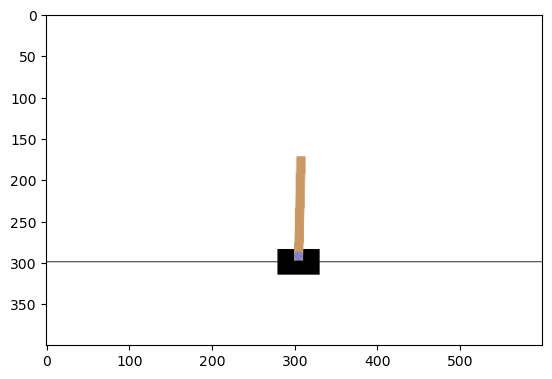

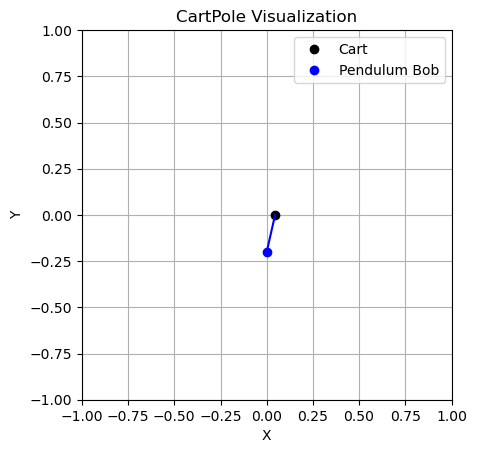


STEP:  3
CART POSITION:  0.04169905
CART VELOCITY:  -0.37885514
POLE ANGLE WRT CART:  0.027639518
VELOCITY AT TOP OF POLE:  0.5540282
ACTION: Push cart to left


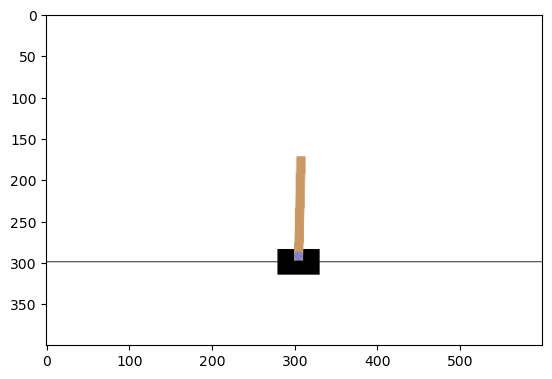

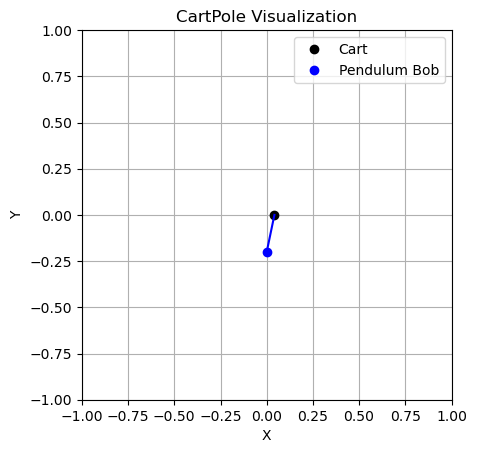


STEP:  4
CART POSITION:  0.03412195
CART VELOCITY:  -0.57435405
POLE ANGLE WRT CART:  0.038720082
VELOCITY AT TOP OF POLE:  0.85528964
ACTION: Push cart to left


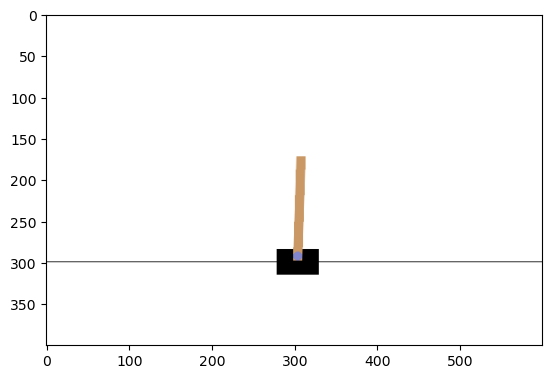

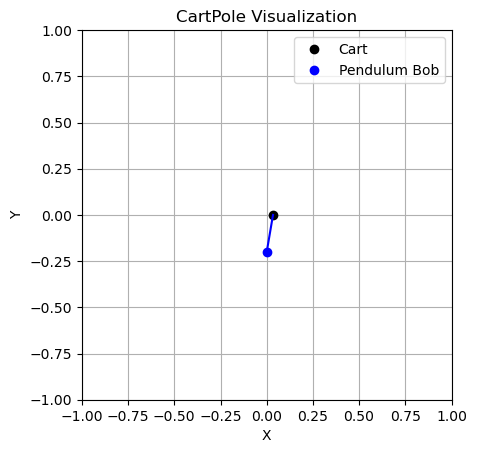


STEP:  5
CART POSITION:  0.02263487
CART VELOCITY:  -0.7699817
POLE ANGLE WRT CART:  0.055825874
VELOCITY AT TOP OF POLE:  1.159892
ACTION: Push cart to left


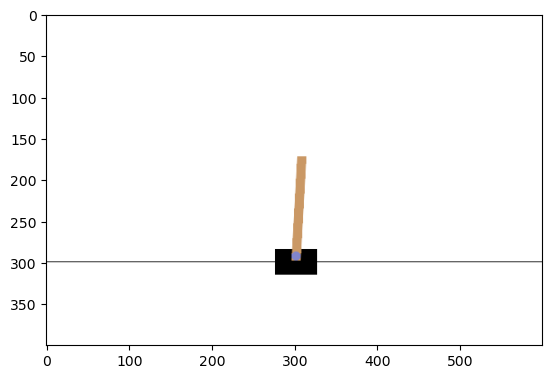

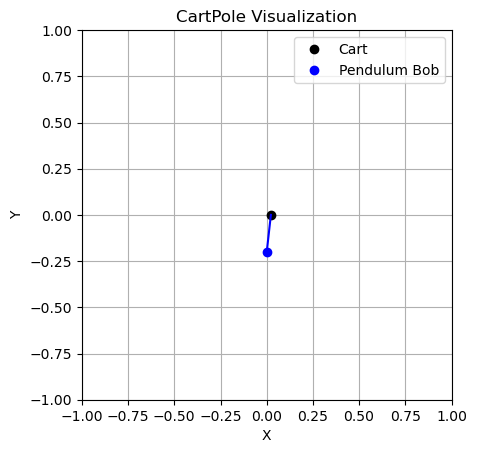


STEP:  6
CART POSITION:  0.007235235
CART VELOCITY:  -0.9657848
POLE ANGLE WRT CART:  0.07902371
VELOCITY AT TOP OF POLE:  1.4695433
ACTION: Push cart to left


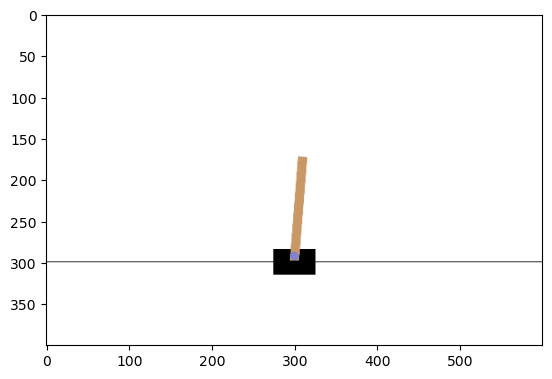

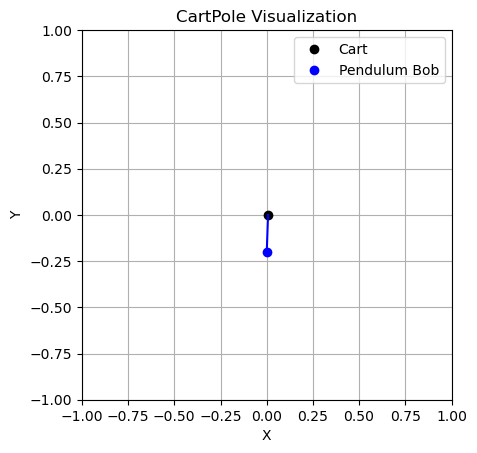


STEP:  7
CART POSITION:  -0.012080461
CART VELOCITY:  -1.1617796
POLE ANGLE WRT CART:  0.10841458
VELOCITY AT TOP OF POLE:  1.7858269
ACTION: Push cart to left


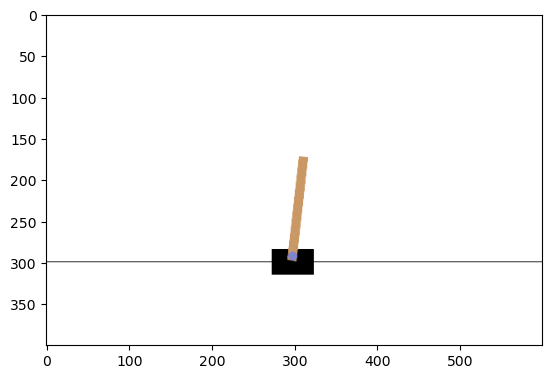

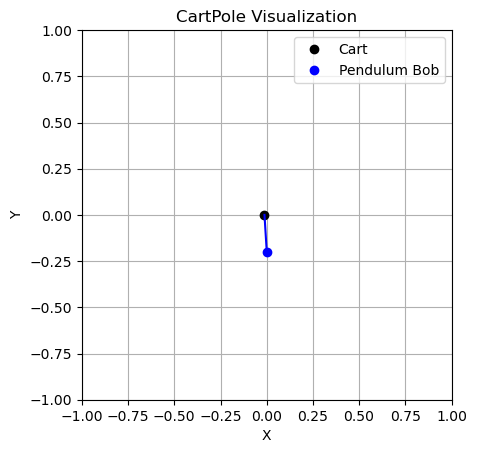


STEP:  8
CART POSITION:  -0.035316054
CART VELOCITY:  -1.3579396
POLE ANGLE WRT CART:  0.14413112
VELOCITY AT TOP OF POLE:  2.1101508
ACTION: Push cart to left


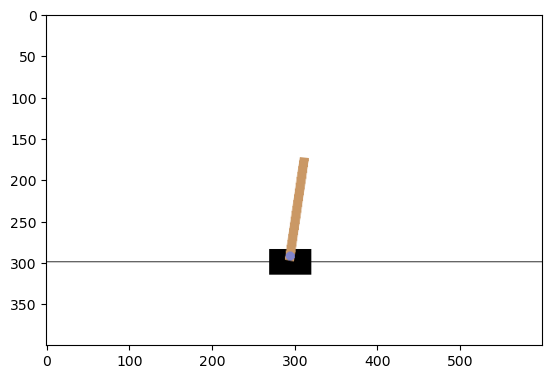

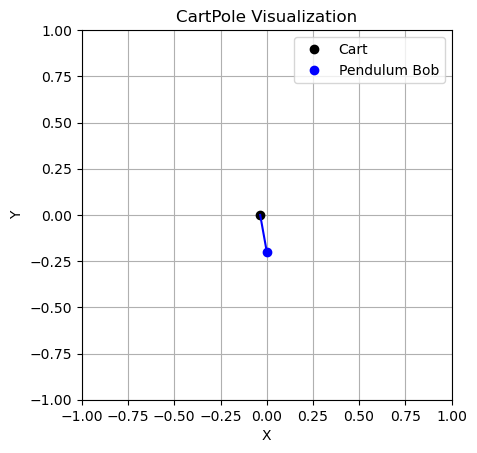


STEP:  9
CART POSITION:  -0.062474843
CART VELOCITY:  -1.5541799
POLE ANGLE WRT CART:  0.18633413
VELOCITY AT TOP OF POLE:  2.443687
ACTION: Push cart to left


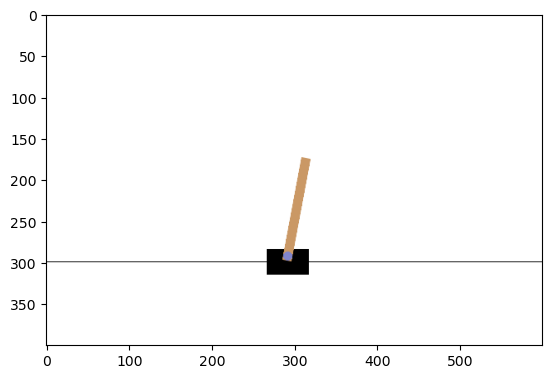

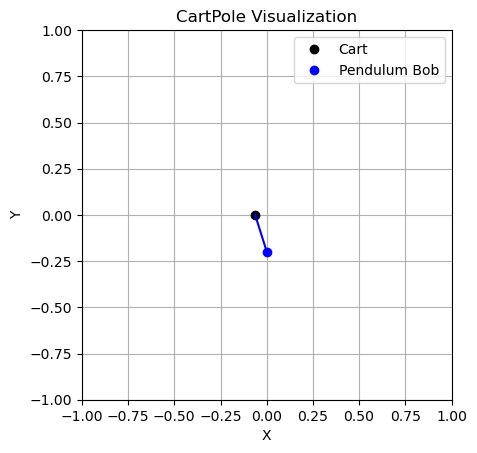


STEP:  1
CART POSITION:  -0.024872867
CART VELOCITY:  0.046316333
POLE ANGLE WRT CART:  0.018818047
VELOCITY AT TOP OF POLE:  -0.038452584
ACTION: Push cart to right


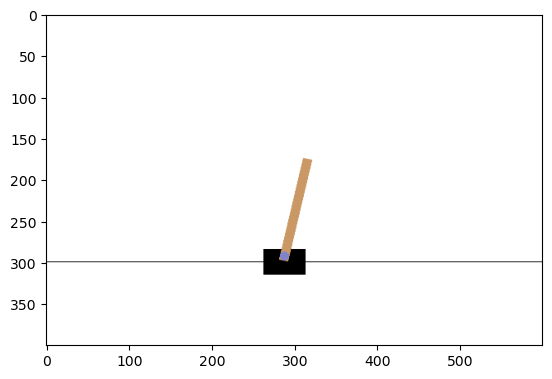

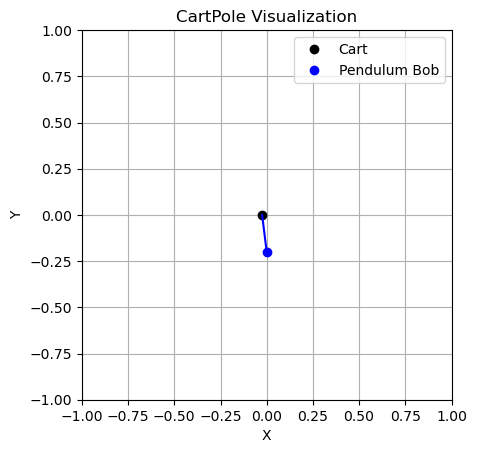


STEP:  2
CART POSITION:  -0.02394654
CART VELOCITY:  0.24116345
POLE ANGLE WRT CART:  0.018048996
VELOCITY AT TOP OF POLE:  -0.32513934
ACTION: Push cart to right


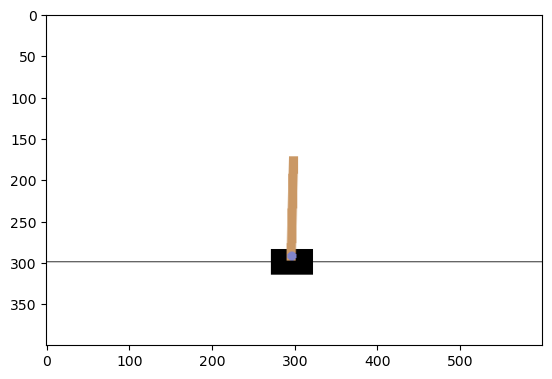

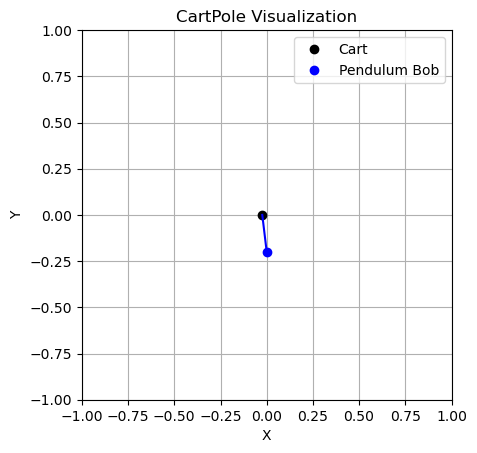


STEP:  3
CART POSITION:  -0.019123273
CART VELOCITY:  0.43602383
POLE ANGLE WRT CART:  0.011546209
VELOCITY AT TOP OF POLE:  -0.61207616
ACTION: Push cart to right


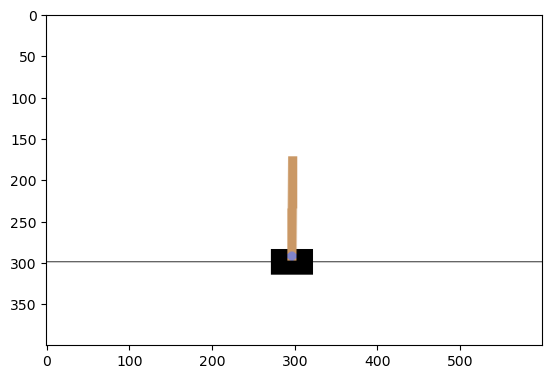

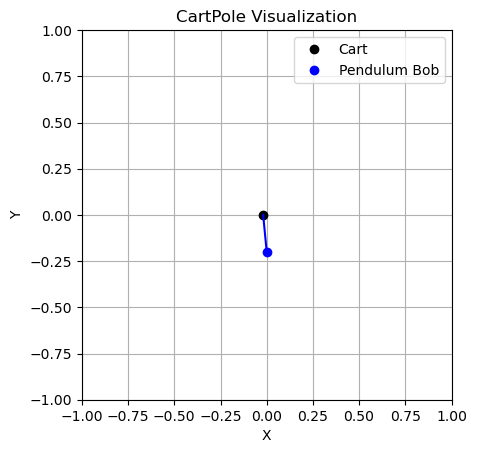


STEP:  4
CART POSITION:  -0.010402796
CART VELOCITY:  0.6309825
POLE ANGLE WRT CART:  -0.00069531414
VELOCITY AT TOP OF POLE:  -0.9011002
ACTION: Push cart to right


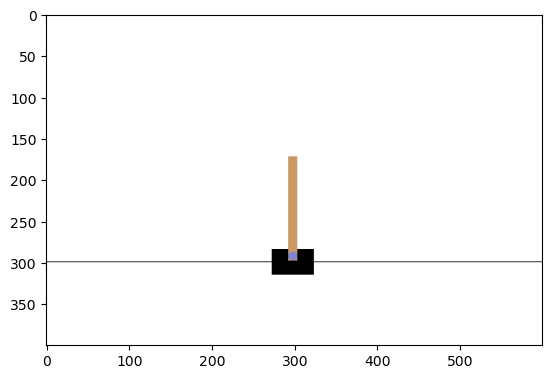

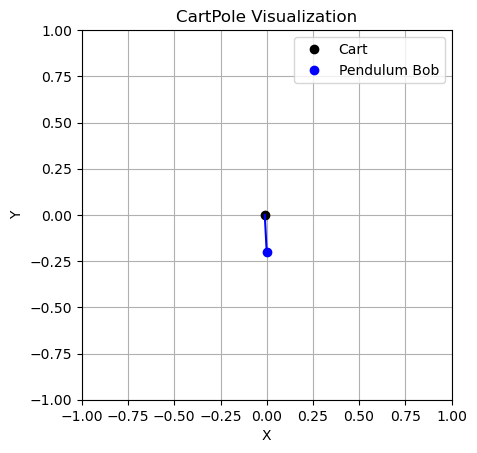


STEP:  5
CART POSITION:  0.0022168548
CART VELOCITY:  0.8261139
POLE ANGLE WRT CART:  -0.018717319
VELOCITY AT TOP OF POLE:  -1.1940016
ACTION: Push cart to right


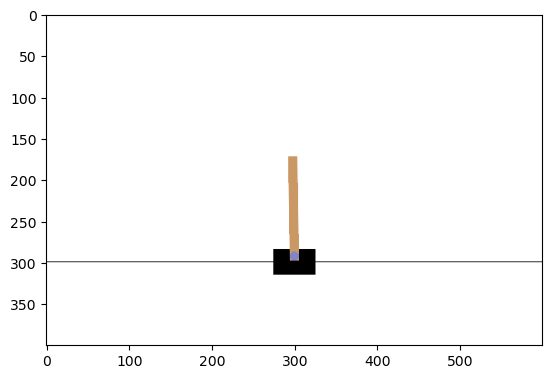

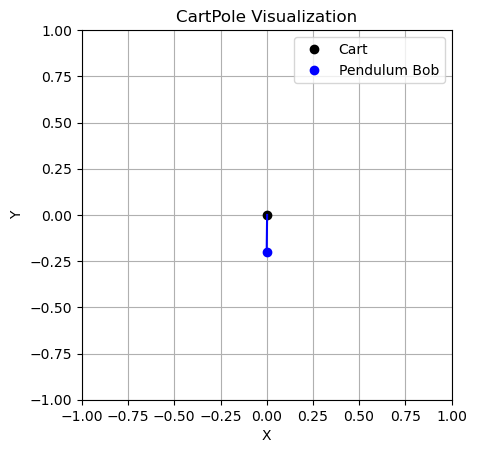


STEP:  6
CART POSITION:  0.018739132
CART VELOCITY:  1.0214732
POLE ANGLE WRT CART:  -0.04259735
VELOCITY AT TOP OF POLE:  -1.4924917
ACTION: Push cart to right


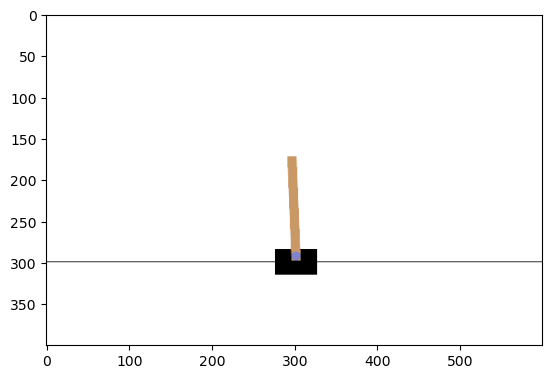

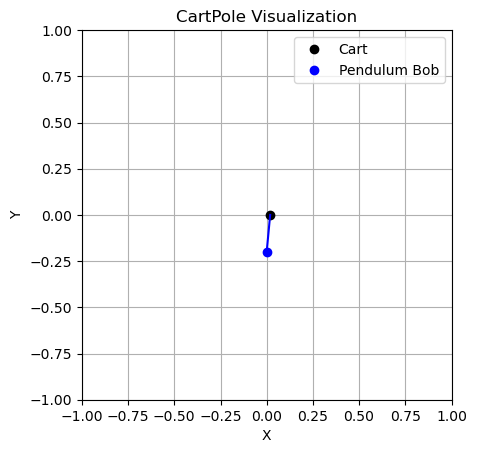


STEP:  7
CART POSITION:  0.039168596
CART VELOCITY:  1.2170868
POLE ANGLE WRT CART:  -0.07244719
VELOCITY AT TOP OF POLE:  -1.7981659
ACTION: Push cart to right


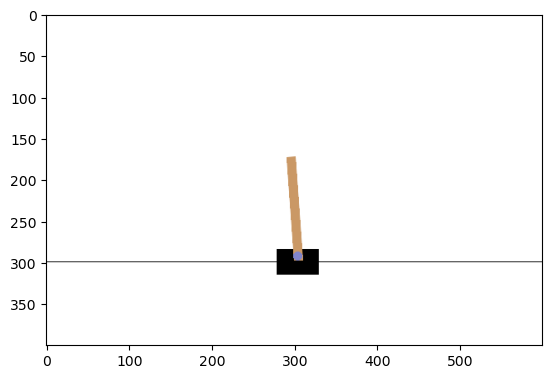

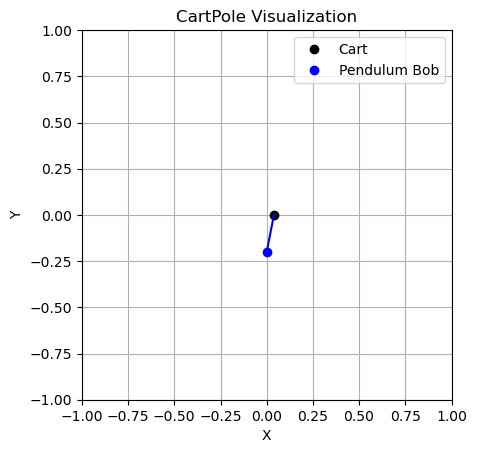


STEP:  8
CART POSITION:  0.06351033
CART VELOCITY:  1.4129407
POLE ANGLE WRT CART:  -0.1084105
VELOCITY AT TOP OF POLE:  -2.112457
ACTION: Push cart to right


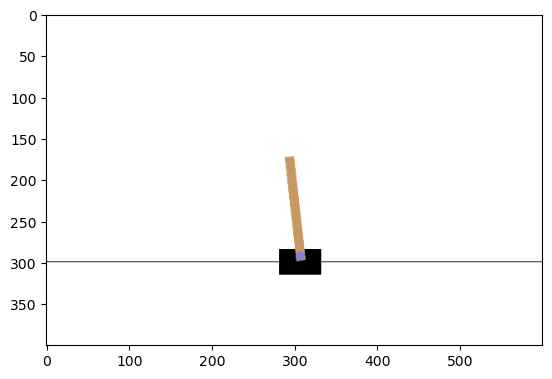

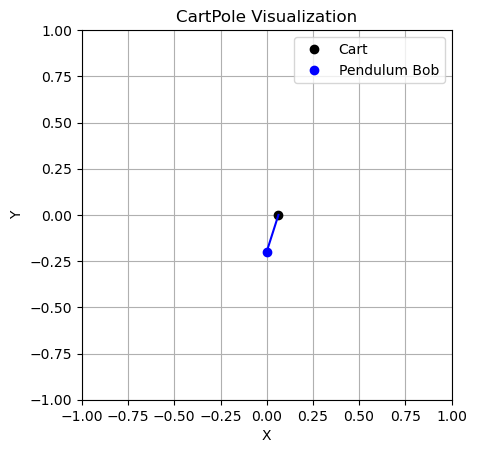


STEP:  9
CART POSITION:  0.091769144
CART VELOCITY:  1.6089662
POLE ANGLE WRT CART:  -0.15065964
VELOCITY AT TOP OF POLE:  -2.4365795
ACTION: Push cart to right


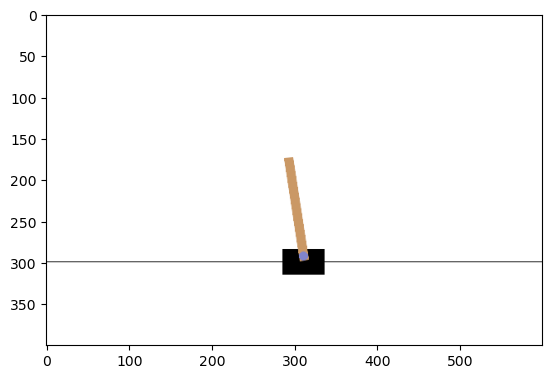

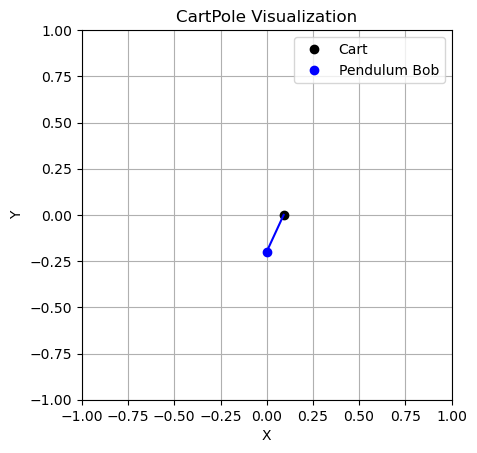


STEP:  10
CART POSITION:  0.12394847
CART VELOCITY:  1.8050239
POLE ANGLE WRT CART:  -0.19939123
VELOCITY AT TOP OF POLE:  -2.771461
ACTION: Push cart to right


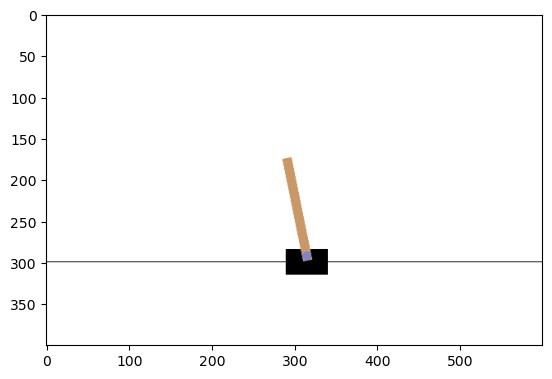

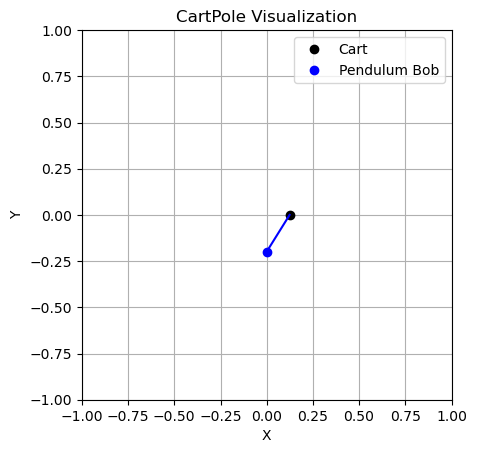


STEP:  1
CART POSITION:  -0.011678156
CART VELOCITY:  0.0062416326
POLE ANGLE WRT CART:  0.019909281
VELOCITY AT TOP OF POLE:  -0.028870309
ACTION: Push cart to right


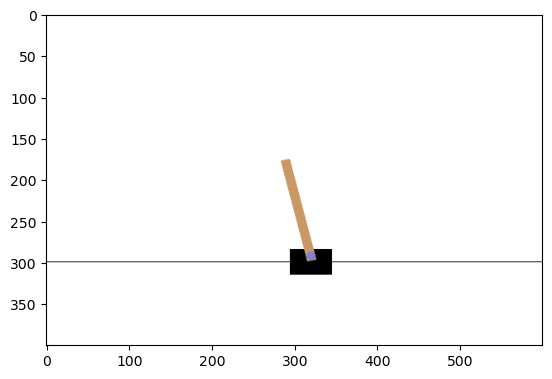

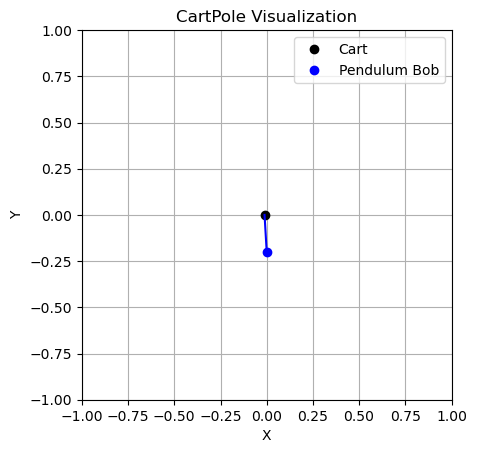


STEP:  2
CART POSITION:  -0.011553324
CART VELOCITY:  0.2010725
POLE ANGLE WRT CART:  0.019331874
VELOCITY AT TOP OF POLE:  -0.31520575
ACTION: Push cart to right


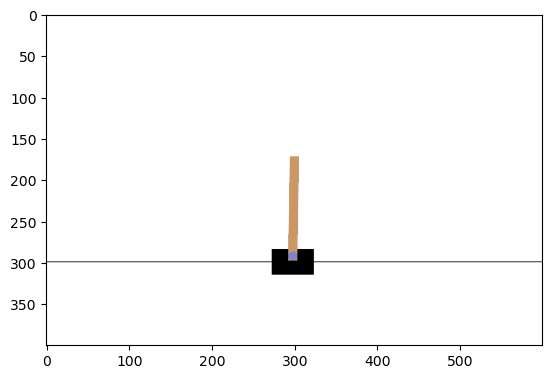

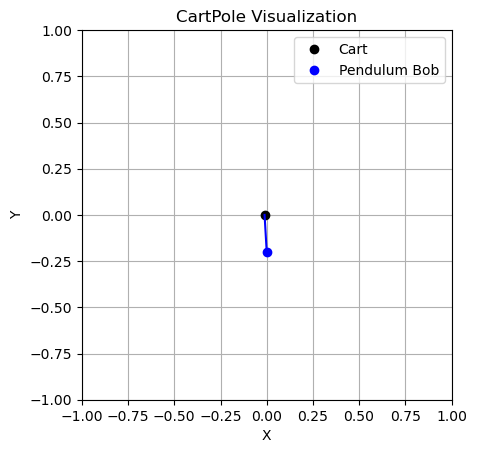


STEP:  3
CART POSITION:  -0.007531874
CART VELOCITY:  0.3959138
POLE ANGLE WRT CART:  0.013027759
VELOCITY AT TOP OF POLE:  -0.60172987
ACTION: Push cart to left


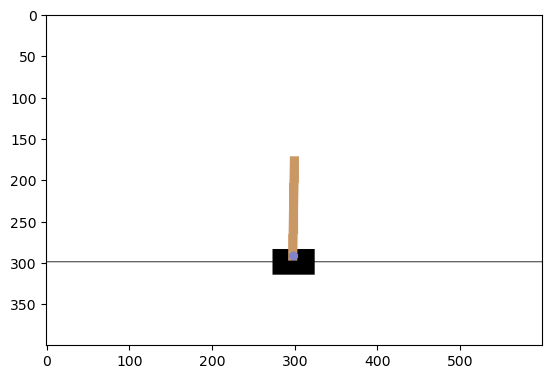

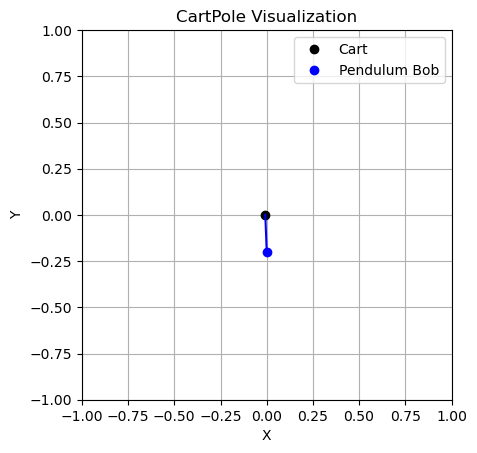


STEP:  4
CART POSITION:  0.00038640265
CART VELOCITY:  0.20061208
POLE ANGLE WRT CART:  0.0009931613
VELOCITY AT TOP OF POLE:  -0.30497208
ACTION: Push cart to right


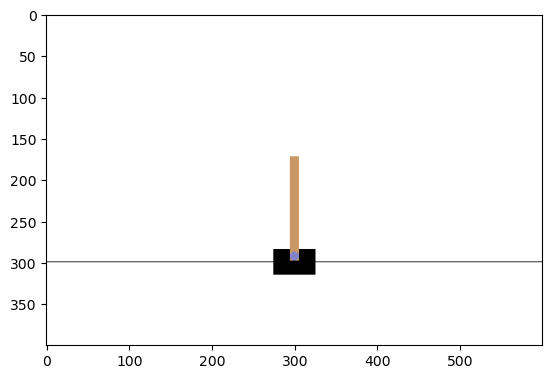

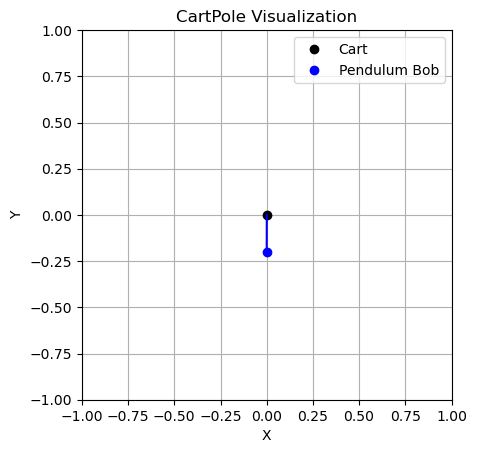


STEP:  5
CART POSITION:  0.004398644
CART VELOCITY:  0.39571986
POLE ANGLE WRT CART:  -0.0051062806
VELOCITY AT TOP OF POLE:  -0.59734166
ACTION: Push cart to right


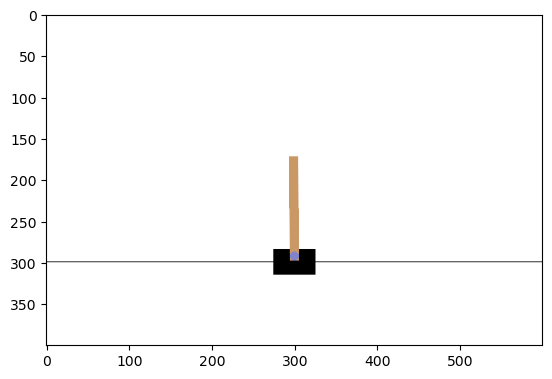

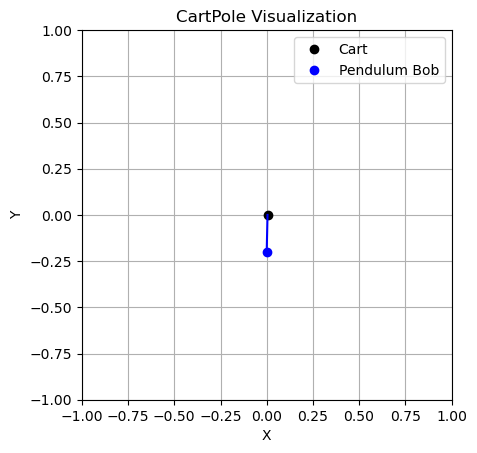


STEP:  6
CART POSITION:  0.012313042
CART VELOCITY:  0.5909129
POLE ANGLE WRT CART:  -0.017053112
VELOCITY AT TOP OF POLE:  -0.8916286
ACTION: Push cart to left


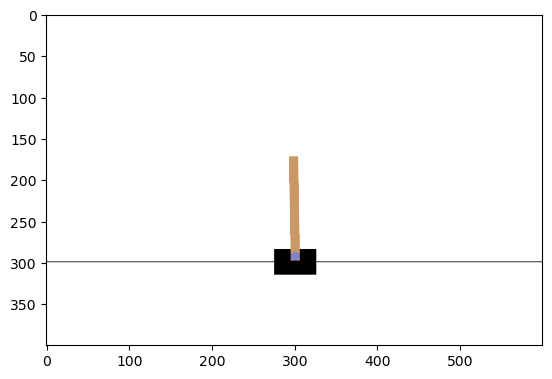

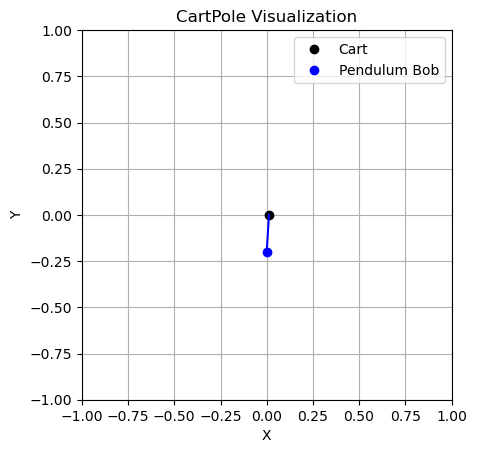


STEP:  7
CART POSITION:  0.0241313
CART VELOCITY:  0.39602637
POLE ANGLE WRT CART:  -0.034885686
VELOCITY AT TOP OF POLE:  -0.60435474
ACTION: Push cart to right


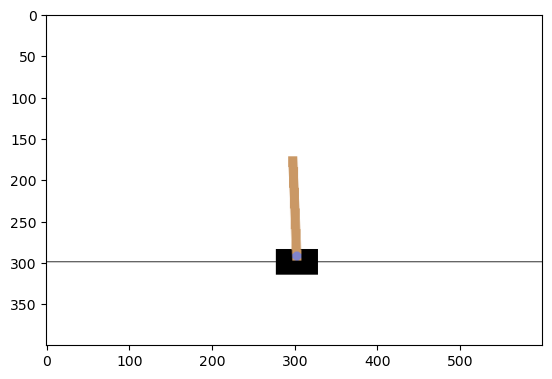

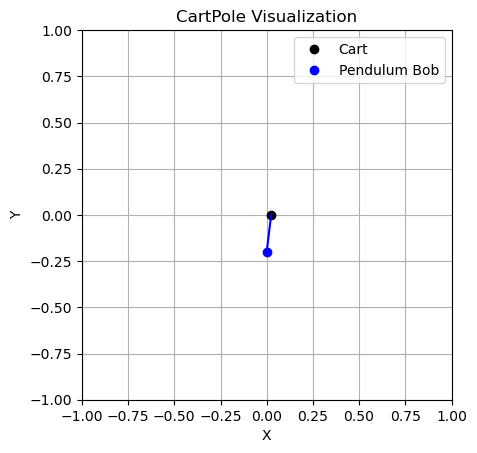


STEP:  8
CART POSITION:  0.032051828
CART VELOCITY:  0.5916184
POLE ANGLE WRT CART:  -0.04697278
VELOCITY AT TOP OF POLE:  -0.90781856
ACTION: Push cart to right


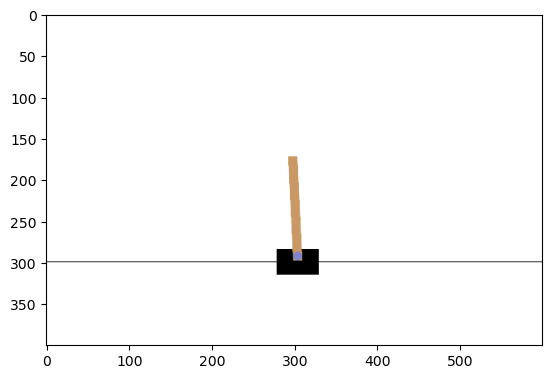

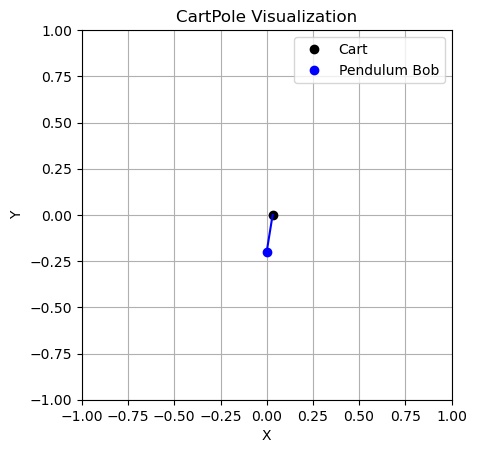


STEP:  9
CART POSITION:  0.043884195
CART VELOCITY:  0.7873437
POLE ANGLE WRT CART:  -0.06512915
VELOCITY AT TOP OF POLE:  -1.2148876
ACTION: Push cart to left


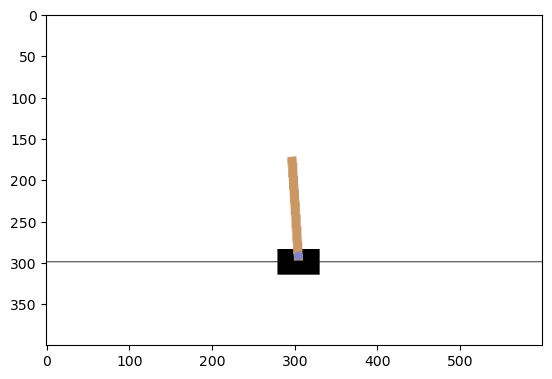

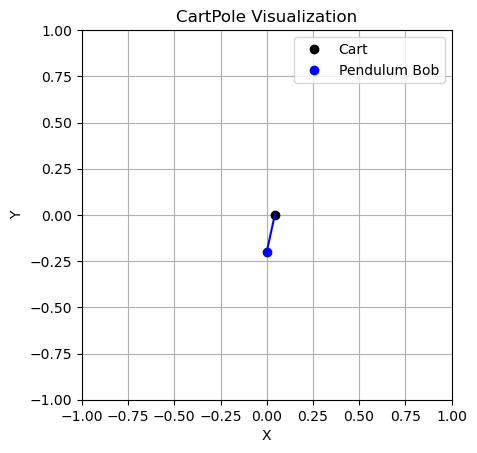


STEP:  10
CART POSITION:  0.05963107
CART VELOCITY:  0.5931196
POLE ANGLE WRT CART:  -0.089426905
VELOCITY AT TOP OF POLE:  -0.9433036
ACTION: Push cart to right


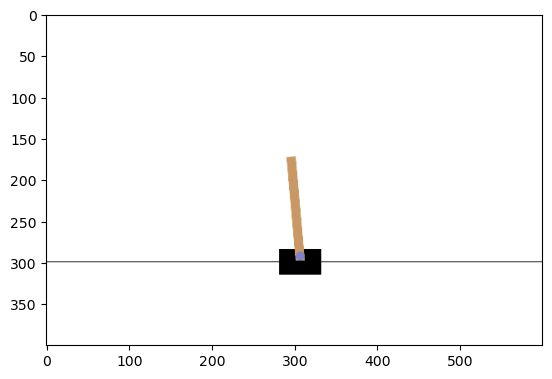

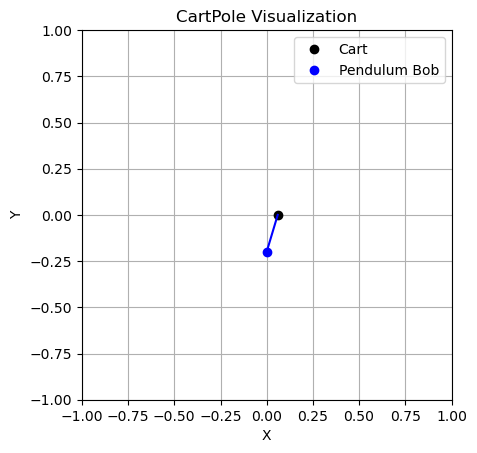


STEP:  11
CART POSITION:  0.07149346
CART VELOCITY:  0.78932524
POLE ANGLE WRT CART:  -0.108292975
VELOCITY AT TOP OF POLE:  -1.2626925
ACTION: Push cart to left


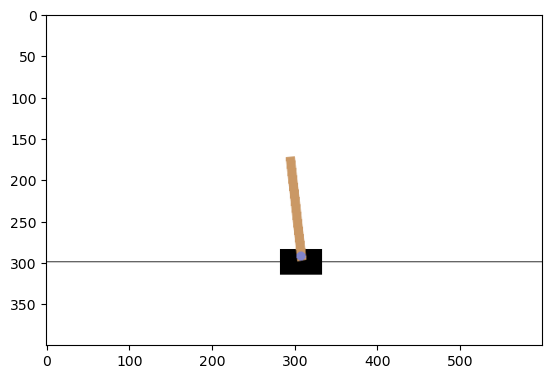

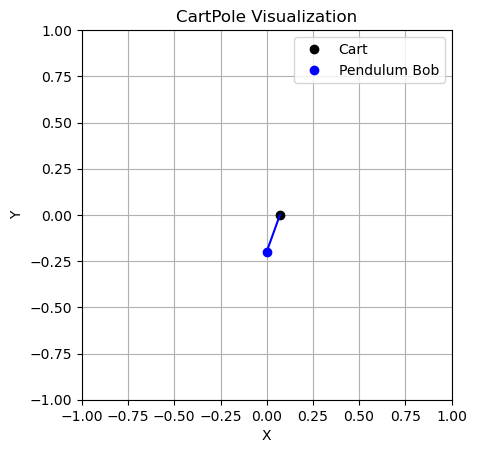


STEP:  12
CART POSITION:  0.08727997
CART VELOCITY:  0.59574157
POLE ANGLE WRT CART:  -0.13354683
VELOCITY AT TOP OF POLE:  -1.0057939
ACTION: Push cart to right


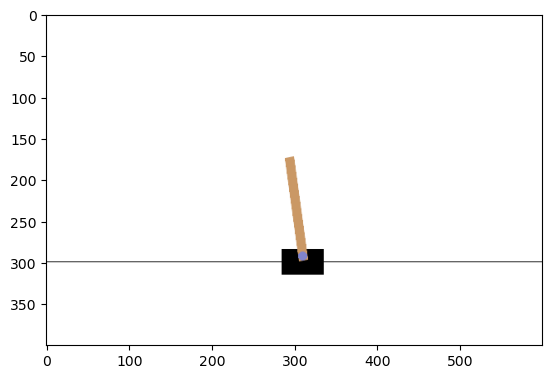

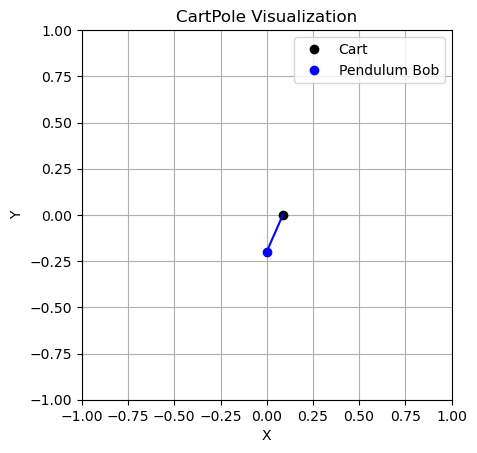


STEP:  13
CART POSITION:  0.099194795
CART VELOCITY:  0.7923696
POLE ANGLE WRT CART:  -0.1536627
VELOCITY AT TOP OF POLE:  -1.337256
ACTION: Push cart to right


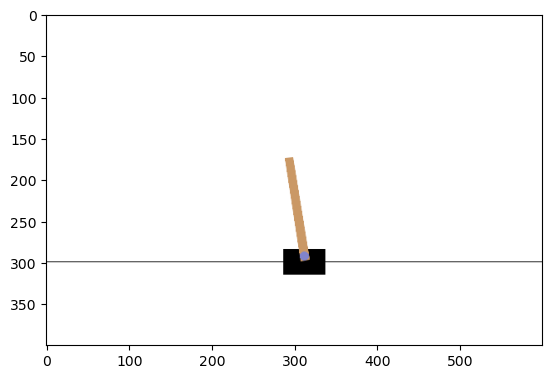

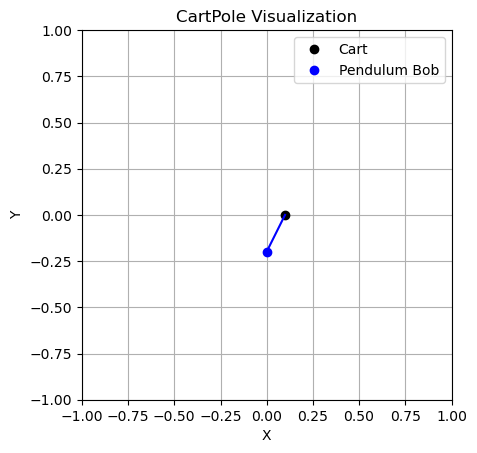


STEP:  14
CART POSITION:  0.11504219
CART VELOCITY:  0.9890566
POLE ANGLE WRT CART:  -0.18040782
VELOCITY AT TOP OF POLE:  -1.6738093
ACTION: Push cart to right


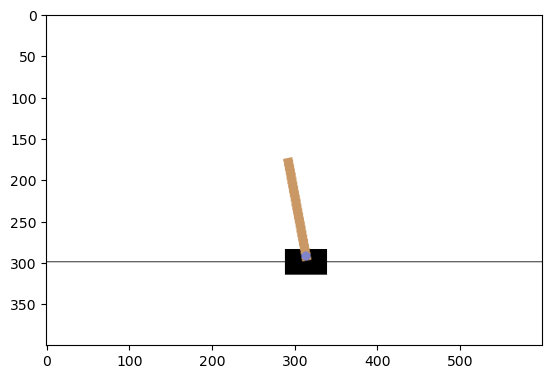

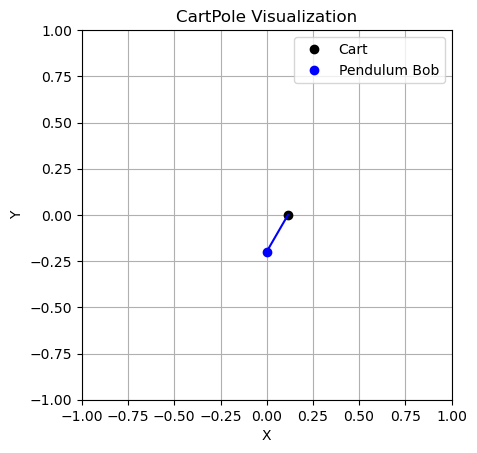


STEP:  1
CART POSITION:  0.049490593
CART VELOCITY:  -0.017492479
POLE ANGLE WRT CART:  0.04443669
VELOCITY AT TOP OF POLE:  -0.005403956
ACTION: Push cart to left


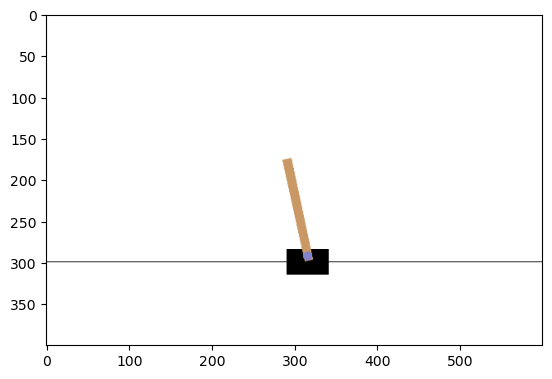

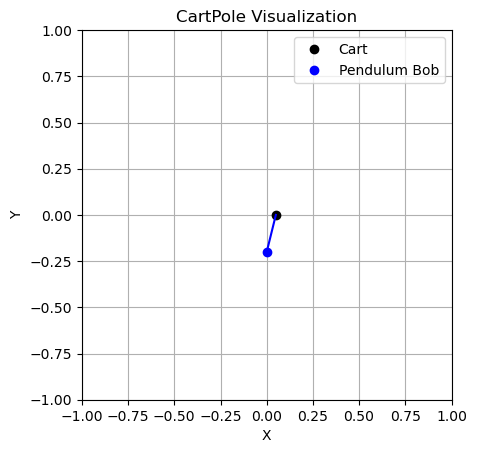


STEP:  2
CART POSITION:  0.049140744
CART VELOCITY:  -0.21322262
POLE ANGLE WRT CART:  0.04432861
VELOCITY AT TOP OF POLE:  0.30096152
ACTION: Push cart to right


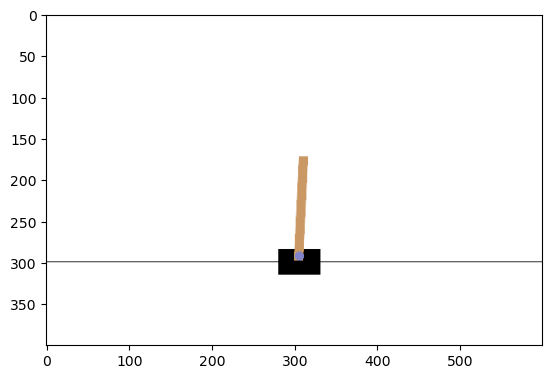

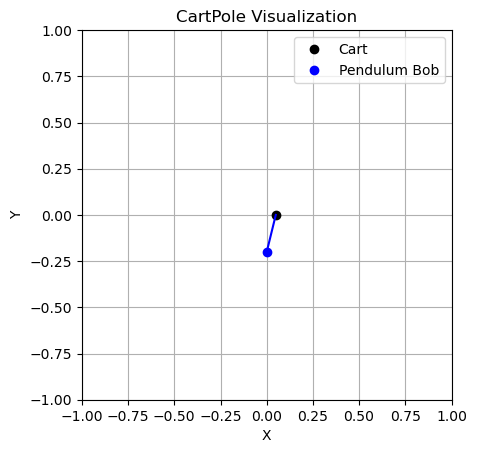


STEP:  3
CART POSITION:  0.044876292
CART VELOCITY:  -0.018759595
POLE ANGLE WRT CART:  0.05034784
VELOCITY AT TOP OF POLE:  0.022581875
ACTION: Push cart to left


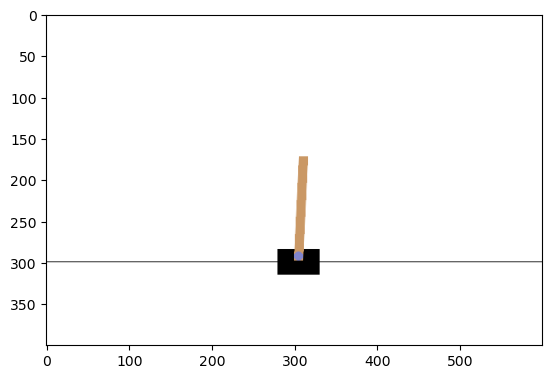

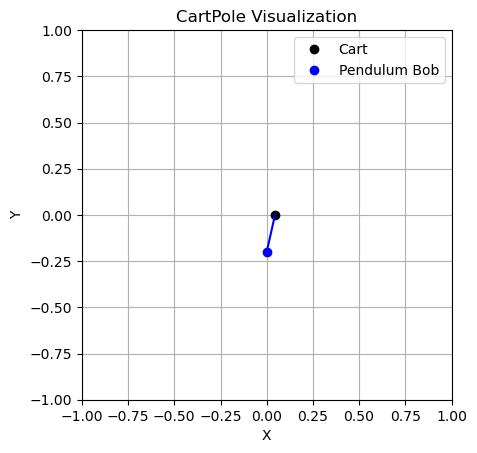


STEP:  4
CART POSITION:  0.0445011
CART VELOCITY:  -0.21456608
POLE ANGLE WRT CART:  0.050799478
VELOCITY AT TOP OF POLE:  0.33071542
ACTION: Push cart to left


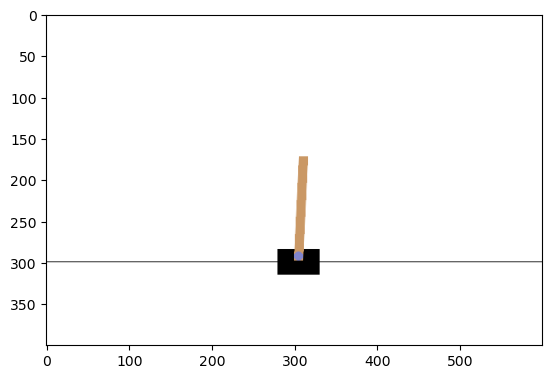

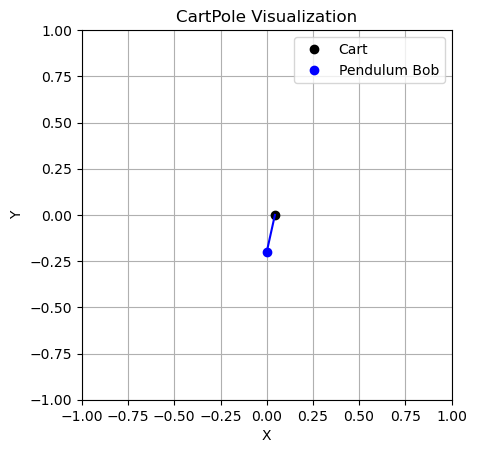


STEP:  5
CART POSITION:  0.040209778
CART VELOCITY:  -0.41037294
POLE ANGLE WRT CART:  0.057413787
VELOCITY AT TOP OF POLE:  0.6389755
ACTION: Push cart to left


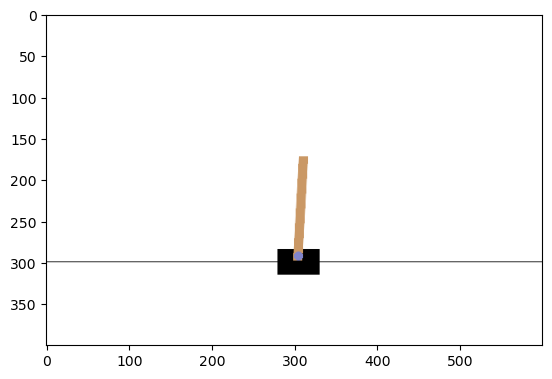

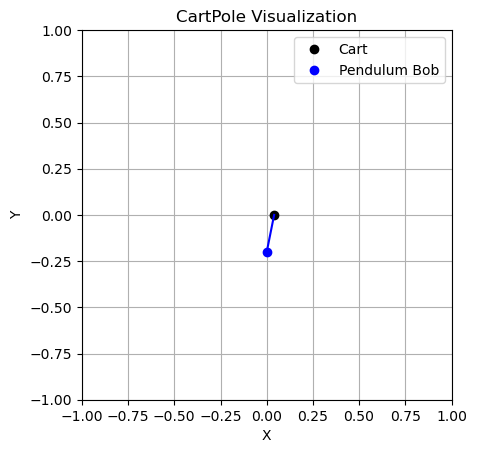


STEP:  6
CART POSITION:  0.03200232
CART VELOCITY:  -0.6062465
POLE ANGLE WRT CART:  0.0701933
VELOCITY AT TOP OF POLE:  0.94917196
ACTION: Push cart to left


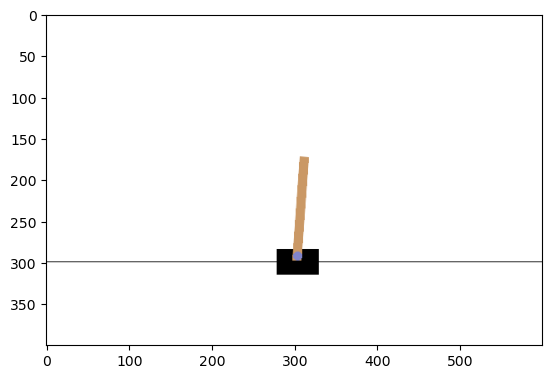

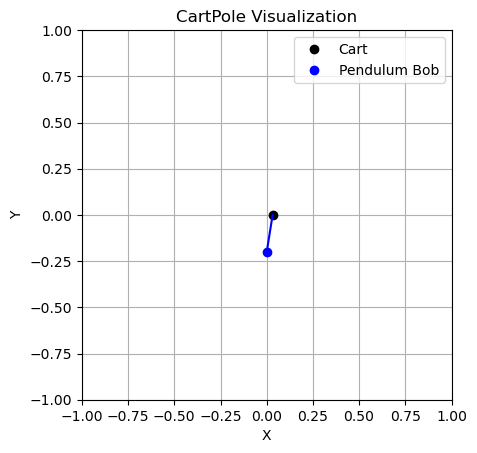


STEP:  7
CART POSITION:  0.01987739
CART VELOCITY:  -0.8022396
POLE ANGLE WRT CART:  0.08917674
VELOCITY AT TOP OF POLE:  1.2630576
ACTION: Push cart to left


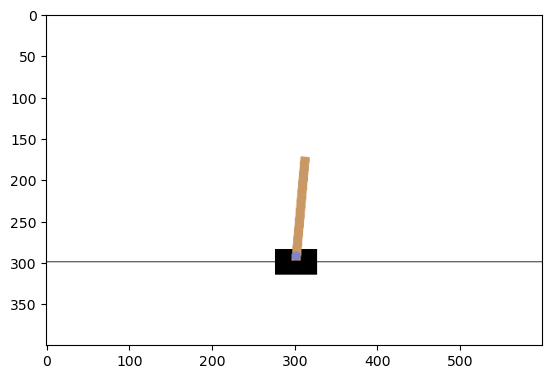

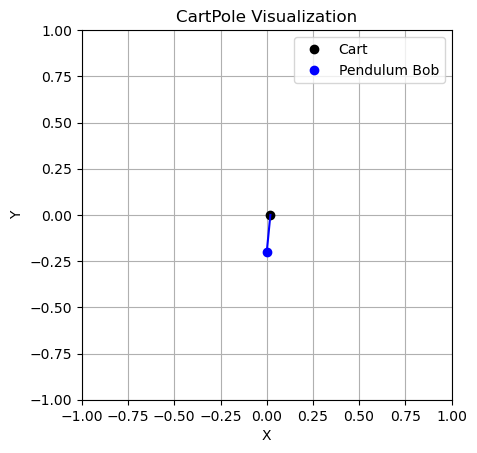


STEP:  8
CART POSITION:  0.003832598
CART VELOCITY:  -0.99838126
POLE ANGLE WRT CART:  0.114437886
VELOCITY AT TOP OF POLE:  1.5822842
ACTION: Push cart to left


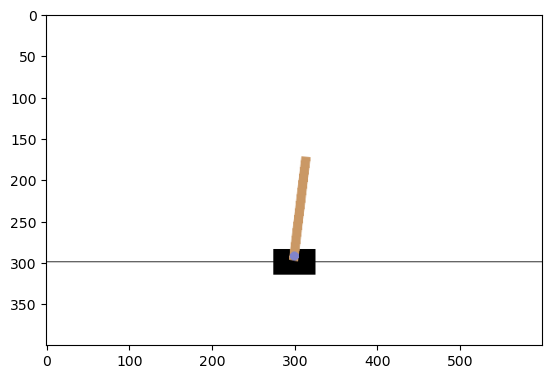

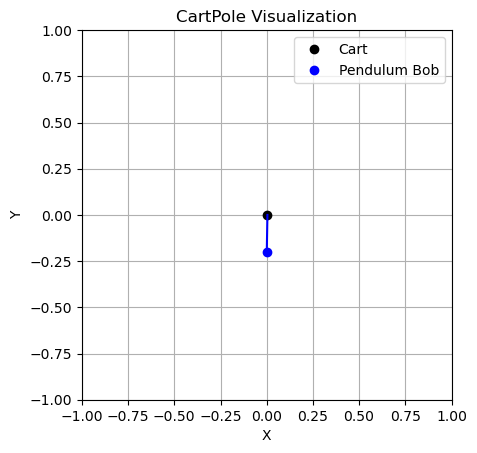


STEP:  9
CART POSITION:  -0.016135028
CART VELOCITY:  -1.1946639
POLE ANGLE WRT CART:  0.14608358
VELOCITY AT TOP OF POLE:  1.9083538
ACTION: Push cart to left


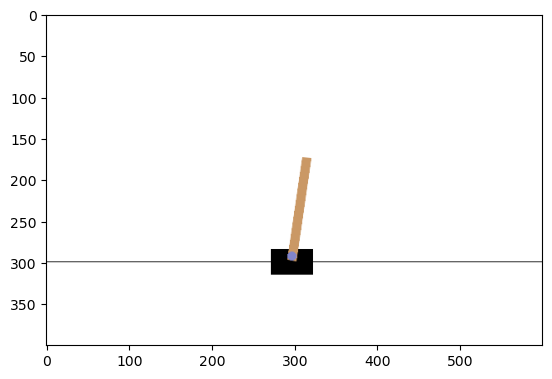

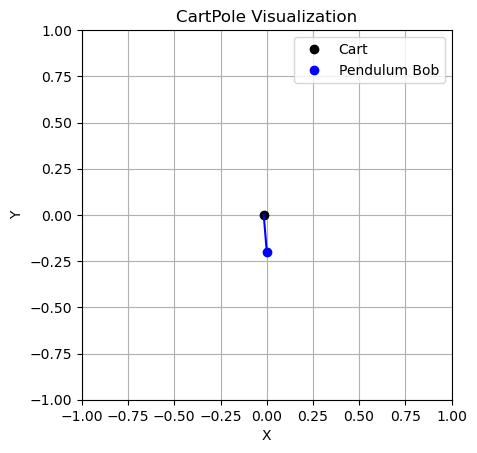


STEP:  10
CART POSITION:  -0.040028304
CART VELOCITY:  -1.3910296
POLE ANGLE WRT CART:  0.18425065
VELOCITY AT TOP OF POLE:  2.242561
ACTION: Push cart to left


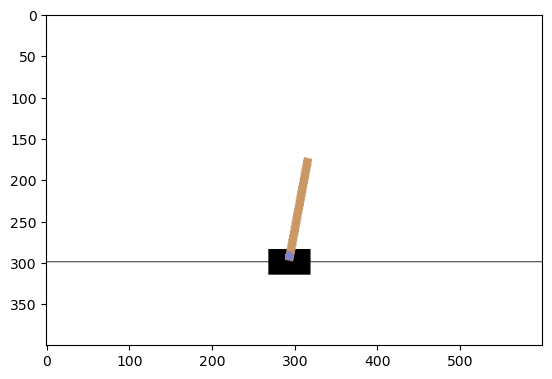

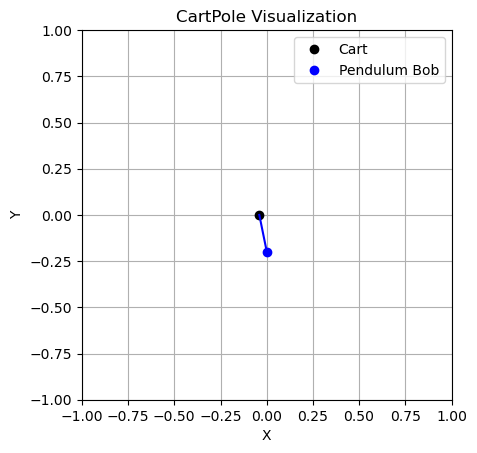


STEP:  1
CART POSITION:  0.045313917
CART VELOCITY:  -0.00976619
POLE ANGLE WRT CART:  0.048967447
VELOCITY AT TOP OF POLE:  -0.014305437
ACTION: Push cart to left


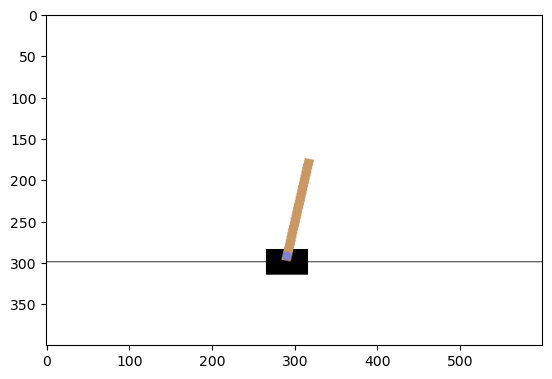

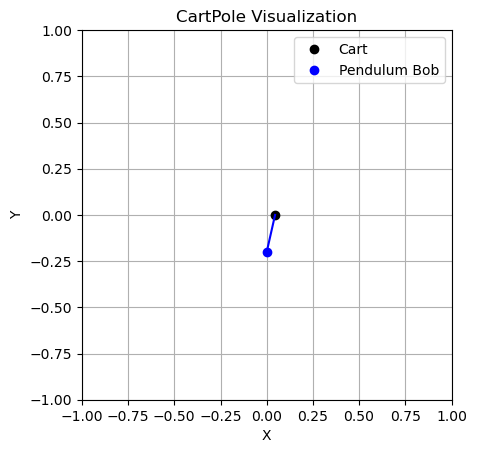


STEP:  2
CART POSITION:  0.045118593
CART VELOCITY:  -0.20555495
POLE ANGLE WRT CART:  0.048681337
VELOCITY AT TOP OF POLE:  0.29341635
ACTION: Push cart to left


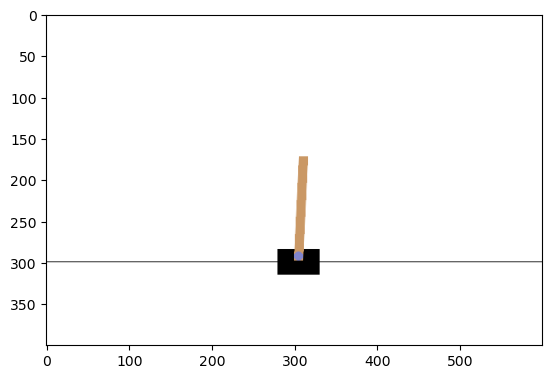

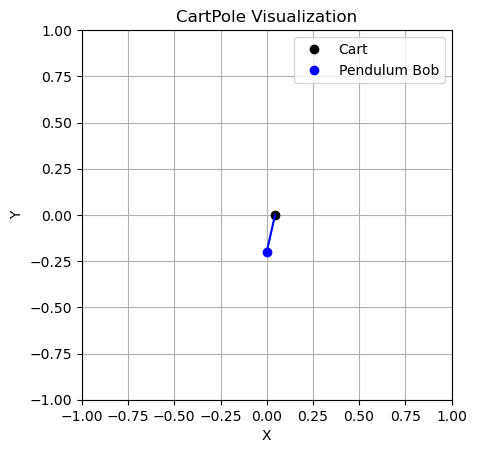


STEP:  3
CART POSITION:  0.041007493
CART VELOCITY:  -0.40133595
POLE ANGLE WRT CART:  0.054549664
VELOCITY AT TOP OF POLE:  0.6010466
ACTION: Push cart to left


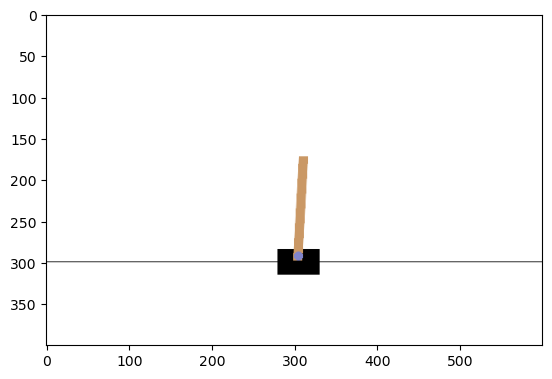

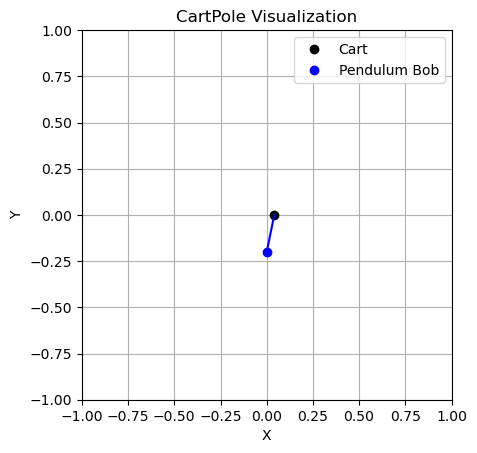


STEP:  4
CART POSITION:  0.032980774
CART VELOCITY:  -0.59717685
POLE ANGLE WRT CART:  0.066570595
VELOCITY AT TOP OF POLE:  0.9104006
ACTION: Push cart to left


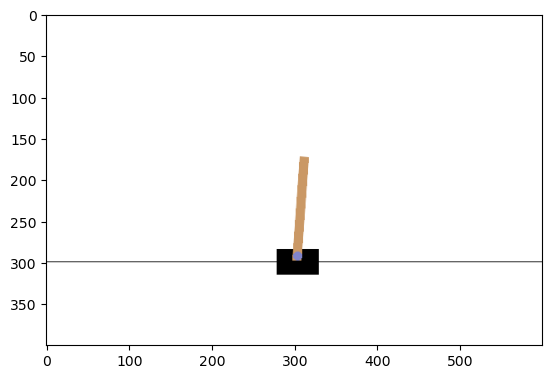

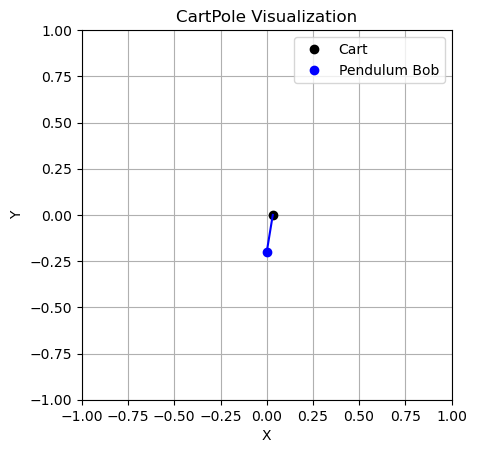


STEP:  5
CART POSITION:  0.021037238
CART VELOCITY:  -0.7931335
POLE ANGLE WRT CART:  0.08477861
VELOCITY AT TOP OF POLE:  1.2232418
ACTION: Push cart to left


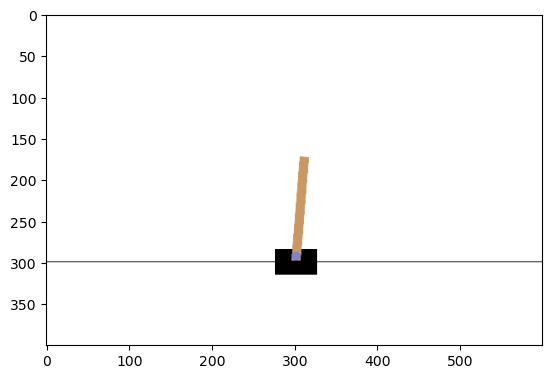

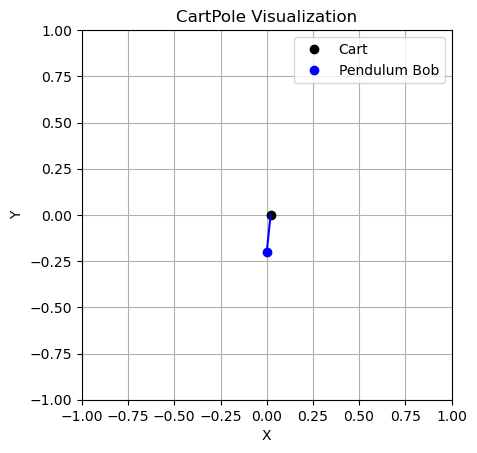


STEP:  6
CART POSITION:  0.005174569
CART VELOCITY:  -0.989239
POLE ANGLE WRT CART:  0.109243445
VELOCITY AT TOP OF POLE:  1.5412387
ACTION: Push cart to left


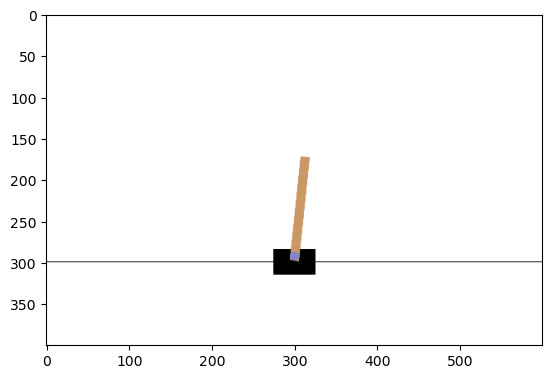

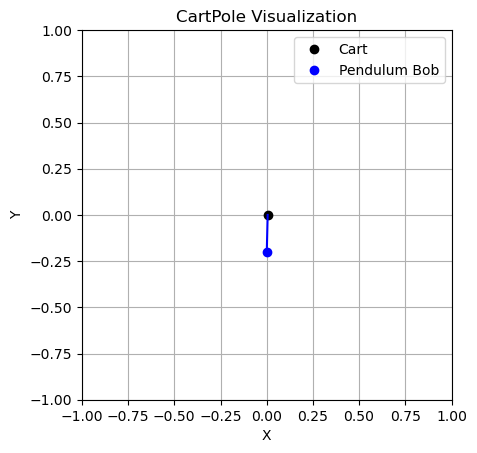


STEP:  7
CART POSITION:  -0.01461021
CART VELOCITY:  -1.1854918
POLE ANGLE WRT CART:  0.14006822
VELOCITY AT TOP OF POLE:  1.8659168
ACTION: Push cart to left


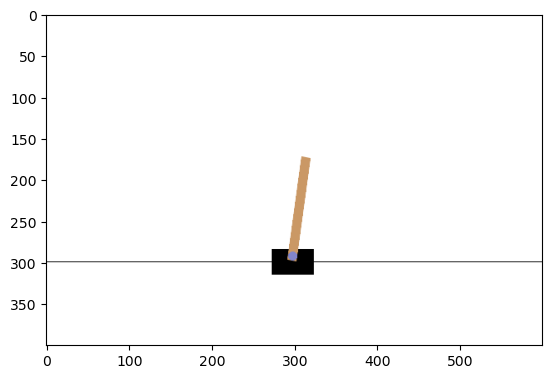

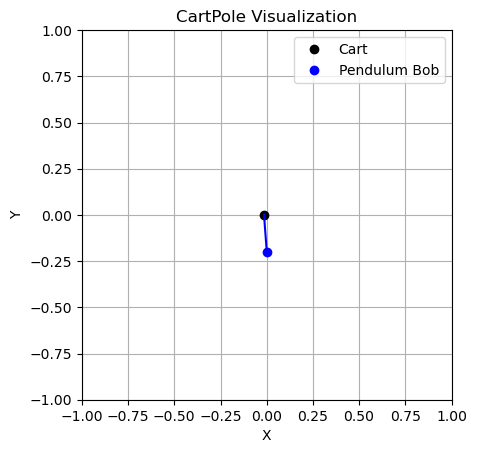


STEP:  8
CART POSITION:  -0.038320046
CART VELOCITY:  -1.3818421
POLE ANGLE WRT CART:  0.17738655
VELOCITY AT TOP OF POLE:  2.1986034
ACTION: Push cart to left


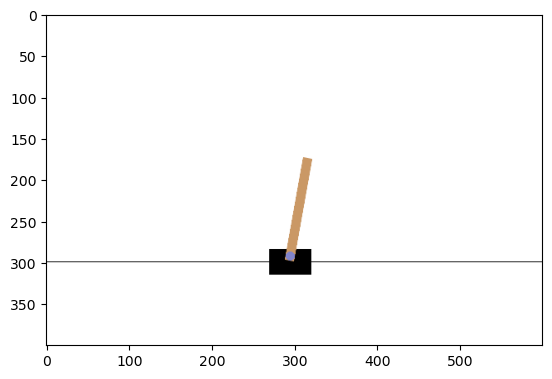

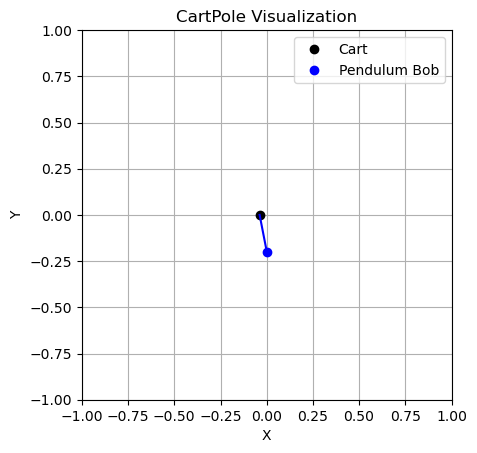


STEP:  1
CART POSITION:  -0.04801392
CART VELOCITY:  -0.03774158
POLE ANGLE WRT CART:  0.018939646
VELOCITY AT TOP OF POLE:  0.047686636
ACTION: Push cart to left


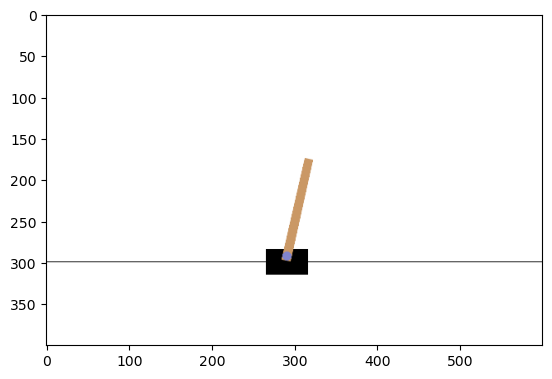

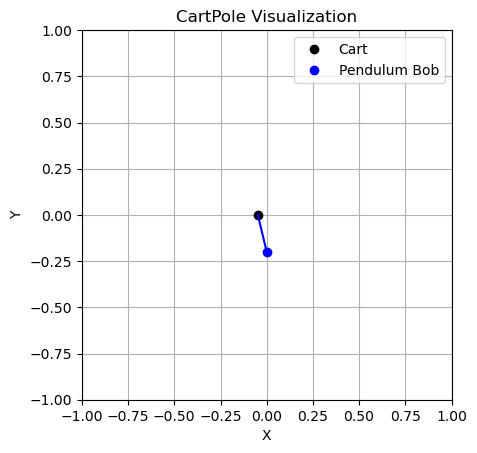


STEP:  2
CART POSITION:  -0.04876875
CART VELOCITY:  -0.23312992
POLE ANGLE WRT CART:  0.01989338
VELOCITY AT TOP OF POLE:  0.3462845
ACTION: Push cart to left


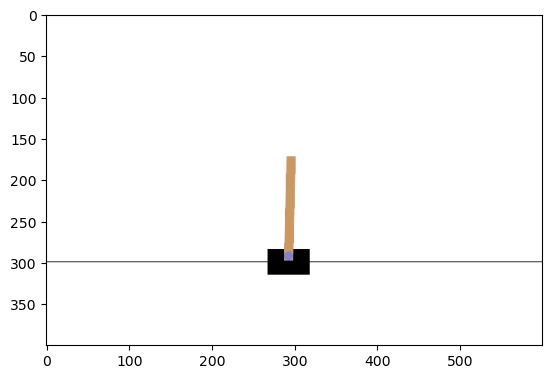

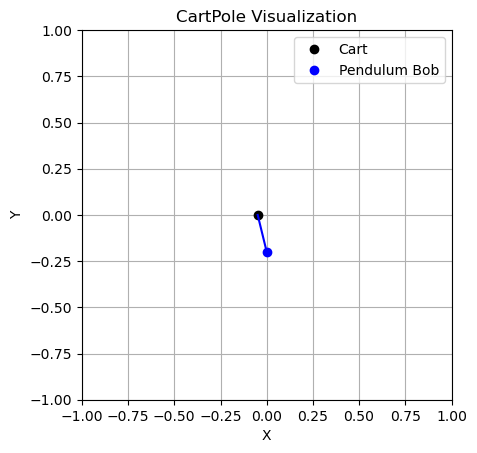


STEP:  3
CART POSITION:  -0.05343135
CART VELOCITY:  -0.4285291
POLE ANGLE WRT CART:  0.026819069
VELOCITY AT TOP OF POLE:  0.64517355
ACTION: Push cart to left


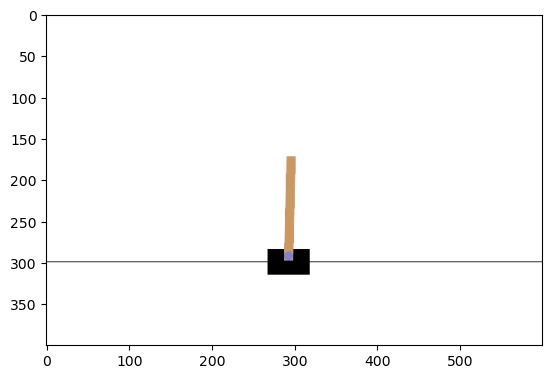

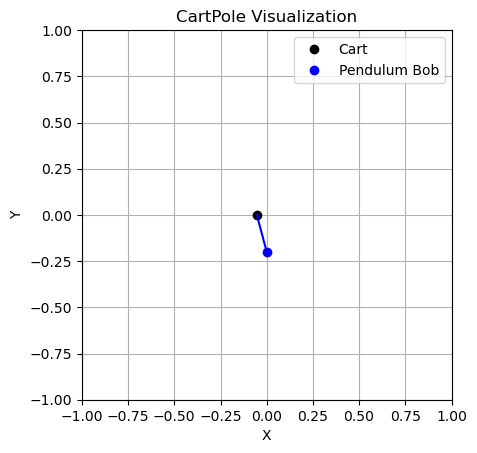


STEP:  4
CART POSITION:  -0.062001932
CART VELOCITY:  -0.6240143
POLE ANGLE WRT CART:  0.03972254
VELOCITY AT TOP OF POLE:  0.9461798
ACTION: Push cart to left


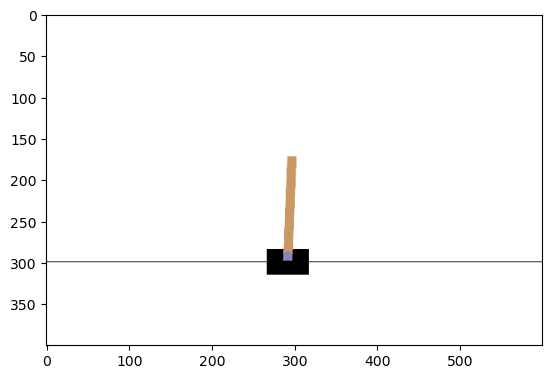

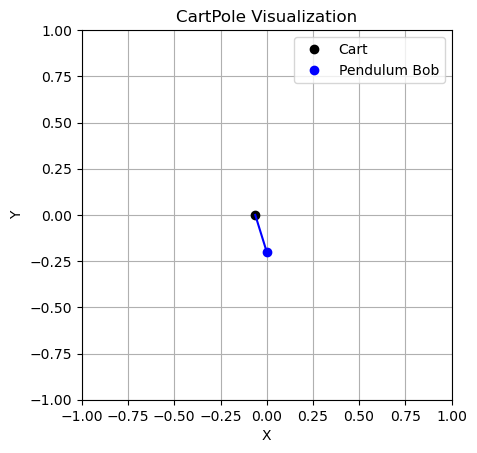


STEP:  5
CART POSITION:  -0.07448222
CART VELOCITY:  -0.8196481
POLE ANGLE WRT CART:  0.05864614
VELOCITY AT TOP OF POLE:  1.2510743
ACTION: Push cart to right


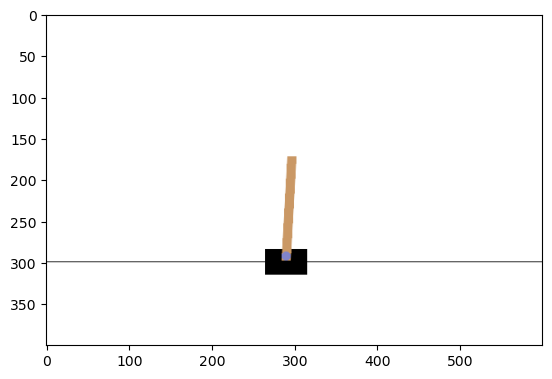

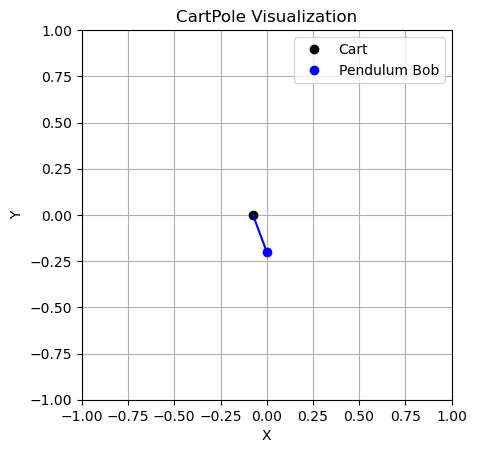


STEP:  6
CART POSITION:  -0.09087518
CART VELOCITY:  -0.6253246
POLE ANGLE WRT CART:  0.08366762
VELOCITY AT TOP OF POLE:  0.97732234
ACTION: Push cart to left


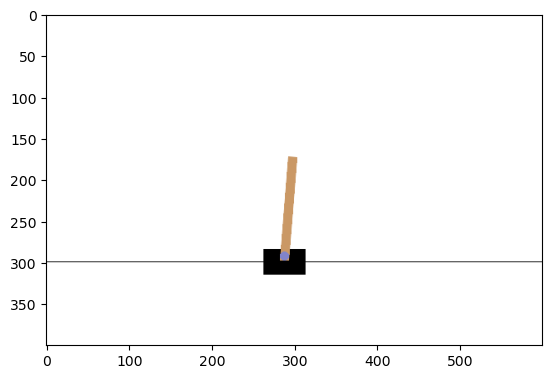

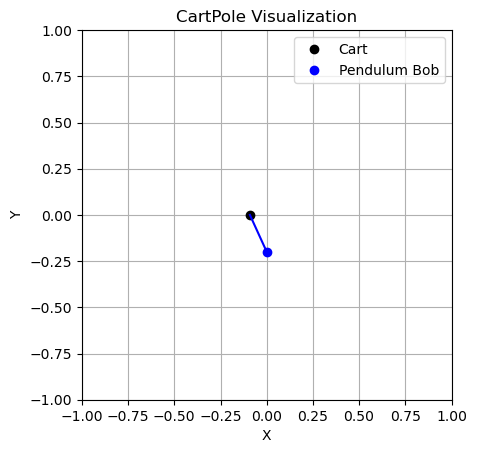


STEP:  7
CART POSITION:  -0.10338167
CART VELOCITY:  -0.8214628
POLE ANGLE WRT CART:  0.10321407
VELOCITY AT TOP OF POLE:  1.29507
ACTION: Push cart to left


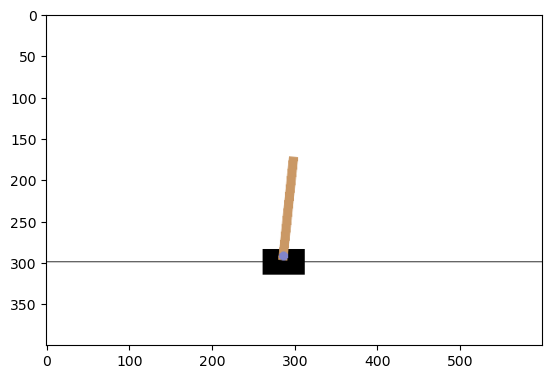

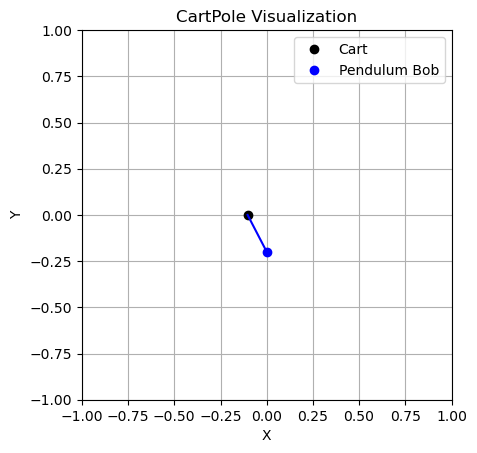


STEP:  8
CART POSITION:  -0.11981093
CART VELOCITY:  -1.0177335
POLE ANGLE WRT CART:  0.12911548
VELOCITY AT TOP OF POLE:  1.6182003
ACTION: Push cart to left


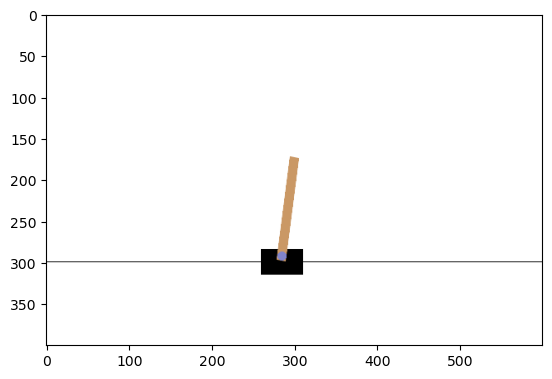

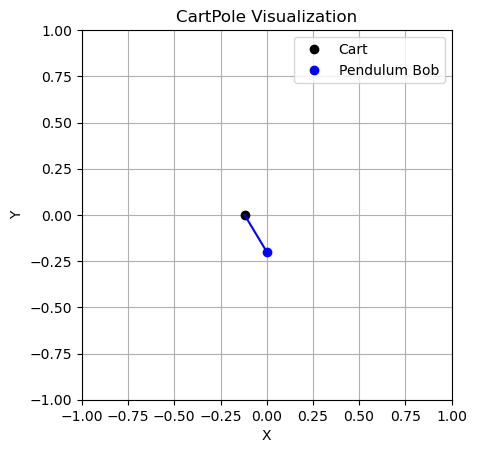


STEP:  9
CART POSITION:  -0.1401656
CART VELOCITY:  -1.2141194
POLE ANGLE WRT CART:  0.16147947
VELOCITY AT TOP OF POLE:  1.9481819
ACTION: Push cart to left


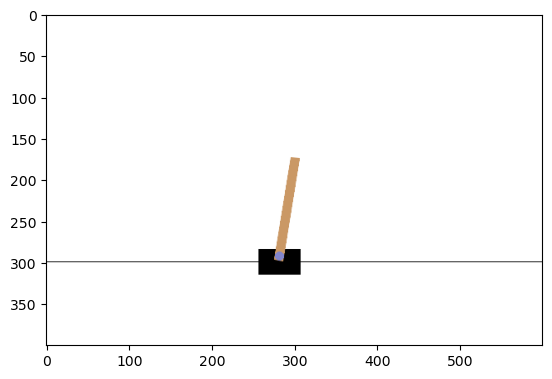

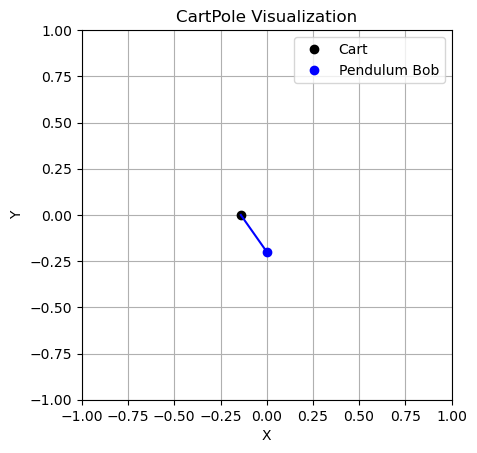


STEP:  10
CART POSITION:  -0.164448
CART VELOCITY:  -1.4105504
POLE ANGLE WRT CART:  0.20044312
VELOCITY AT TOP OF POLE:  2.286264
ACTION: Push cart to left


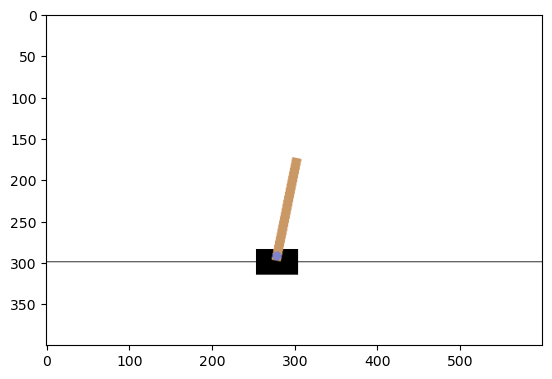

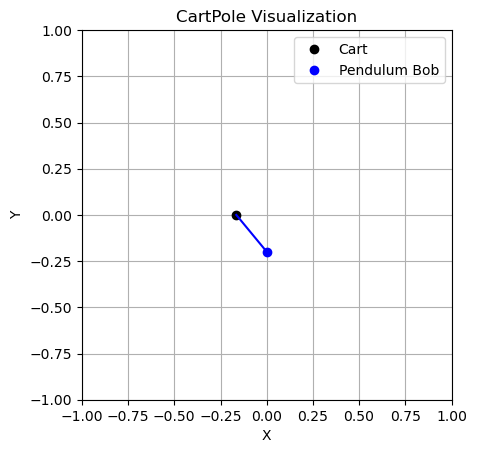


STEP:  1
CART POSITION:  -0.016029792
CART VELOCITY:  -0.019291602
POLE ANGLE WRT CART:  -0.017459083
VELOCITY AT TOP OF POLE:  -0.03873458
ACTION: Push cart to left


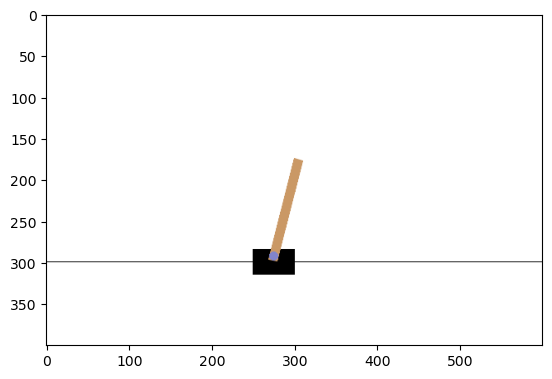

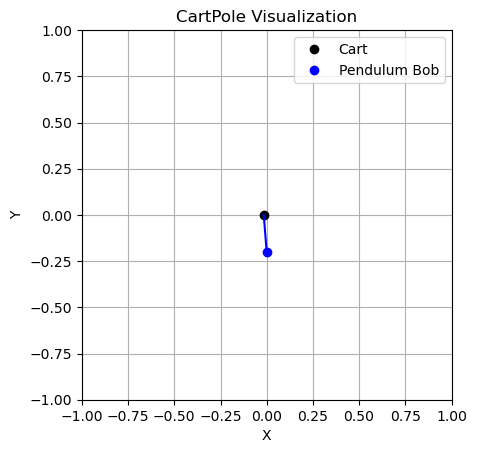


STEP:  2
CART POSITION:  -0.016415624
CART VELOCITY:  -0.2141589
POLE ANGLE WRT CART:  -0.018233776
VELOCITY AT TOP OF POLE:  0.2483891
ACTION: Push cart to left


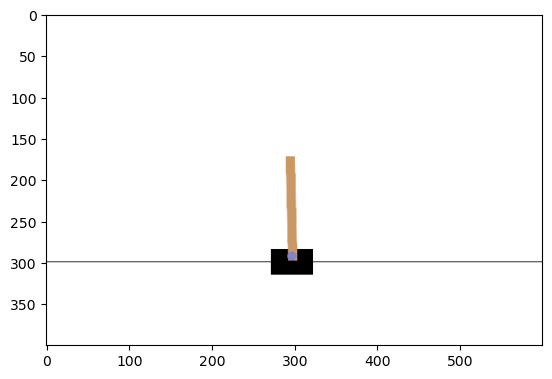

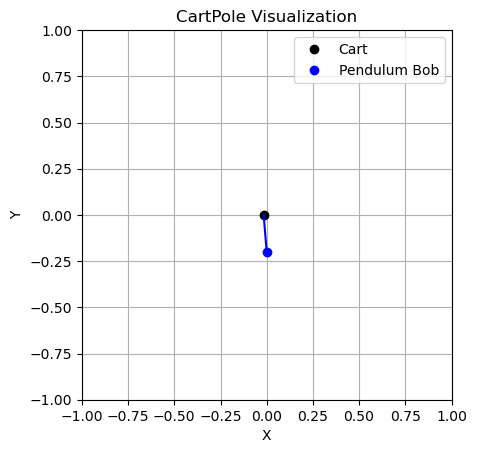


STEP:  3
CART POSITION:  -0.0206988
CART VELOCITY:  -0.40901577
POLE ANGLE WRT CART:  -0.013265993
VELOCITY AT TOP OF POLE:  0.5352654
ACTION: Push cart to left


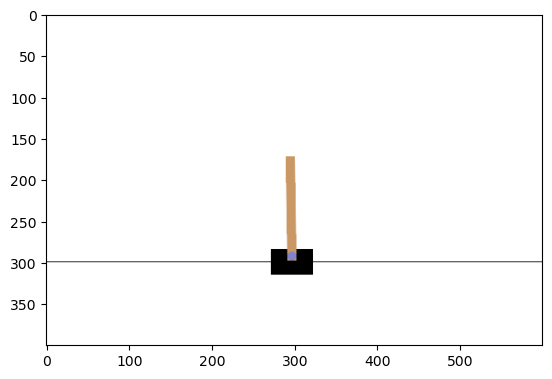

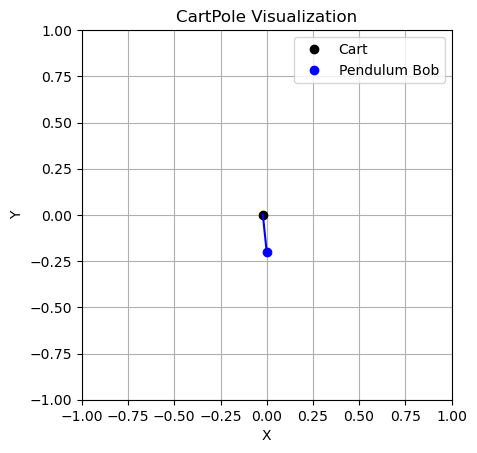


STEP:  4
CART POSITION:  -0.028879117
CART VELOCITY:  -0.60394865
POLE ANGLE WRT CART:  -0.0025606859
VELOCITY AT TOP OF POLE:  0.82373893
ACTION: Push cart to left


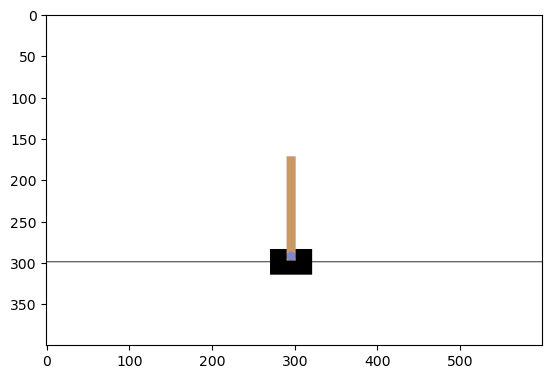

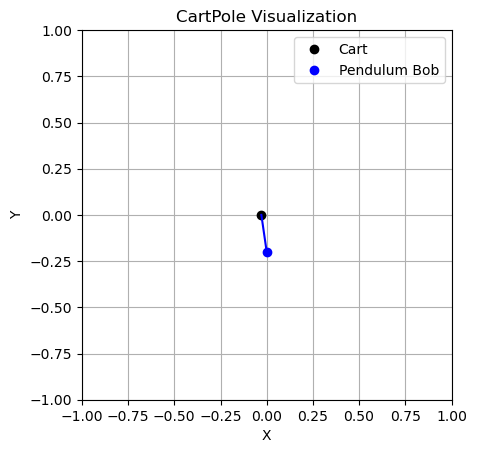


STEP:  5
CART POSITION:  -0.04095809
CART VELOCITY:  -0.7990355
POLE ANGLE WRT CART:  0.013914093
VELOCITY AT TOP OF POLE:  1.1156154
ACTION: Push cart to left


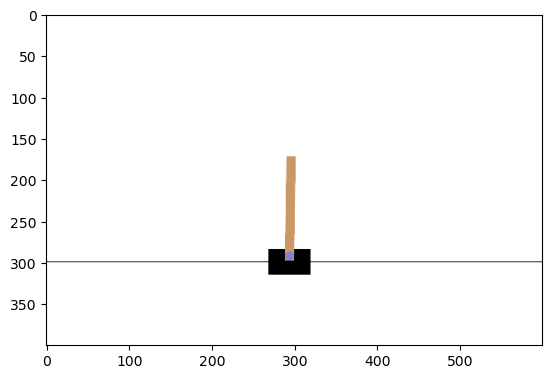

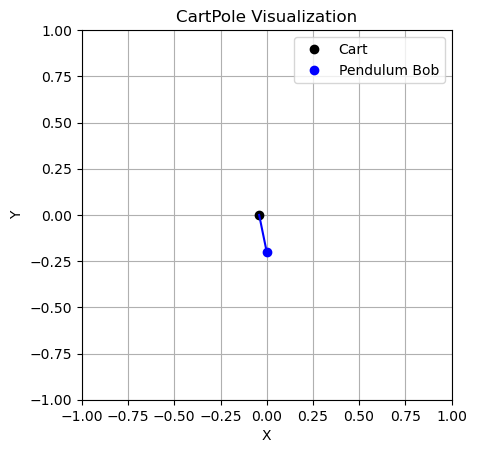


STEP:  6
CART POSITION:  -0.0569388
CART VELOCITY:  -0.9943373
POLE ANGLE WRT CART:  0.0362264
VELOCITY AT TOP OF POLE:  1.4126303
ACTION: Push cart to left


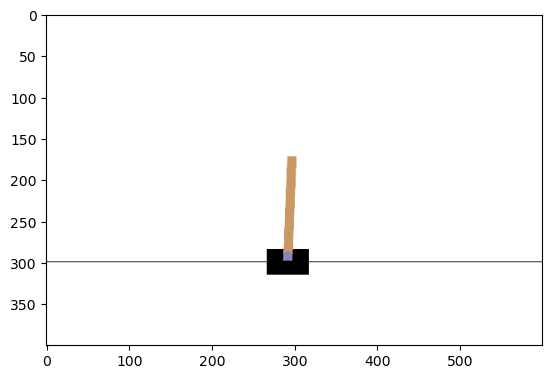

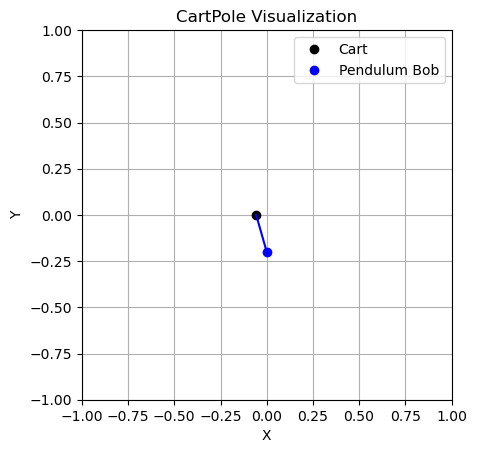


STEP:  7
CART POSITION:  -0.076825544
CART VELOCITY:  -1.1898891
POLE ANGLE WRT CART:  0.06447901
VELOCITY AT TOP OF POLE:  1.7164137
ACTION: Push cart to left


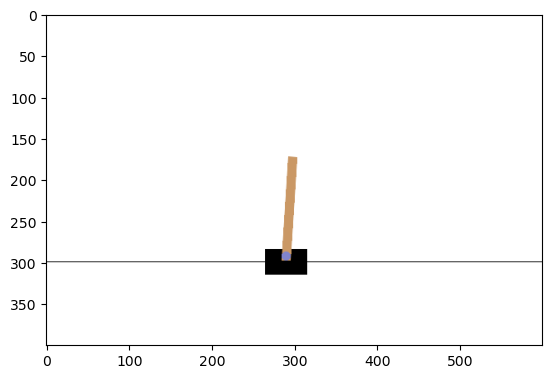

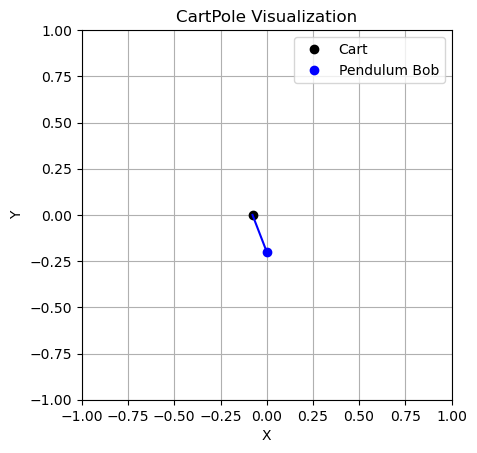


STEP:  8
CART POSITION:  -0.10062333
CART VELOCITY:  -1.3856885
POLE ANGLE WRT CART:  0.09880728
VELOCITY AT TOP OF POLE:  2.0284462
ACTION: Push cart to left


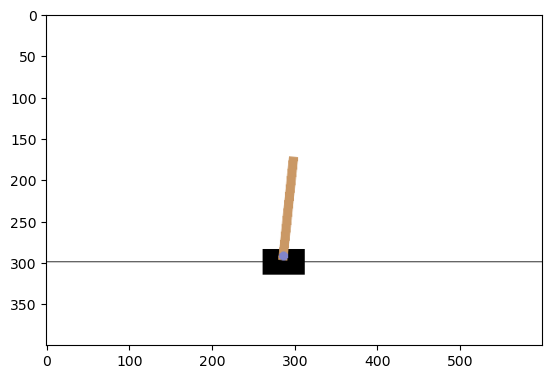

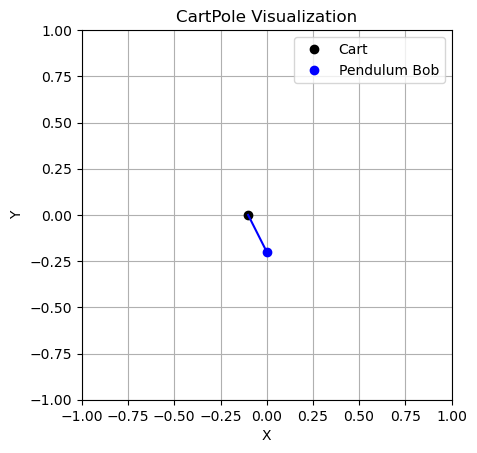


STEP:  9
CART POSITION:  -0.1283371
CART VELOCITY:  -1.5816828
POLE ANGLE WRT CART:  0.13937621
VELOCITY AT TOP OF POLE:  2.3500059
ACTION: Push cart to left


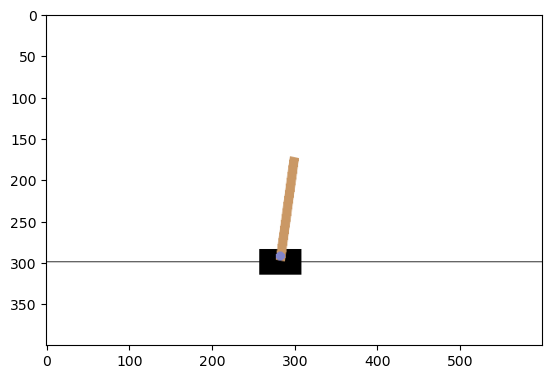

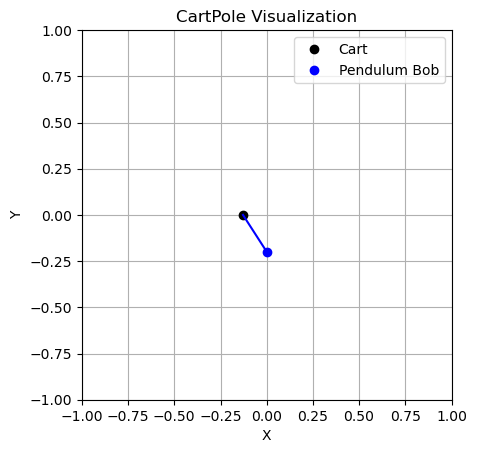


STEP:  10
CART POSITION:  -0.15997076
CART VELOCITY:  -1.7777524
POLE ANGLE WRT CART:  0.18637632
VELOCITY AT TOP OF POLE:  2.6821024
ACTION: Push cart to left


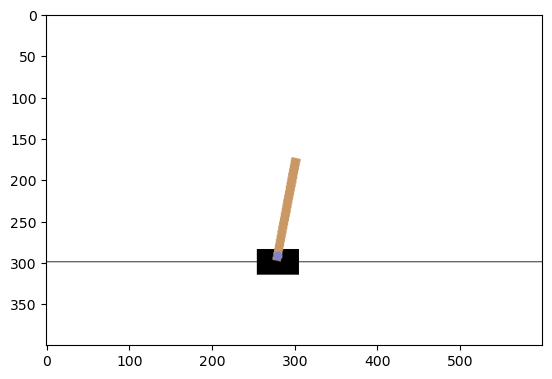

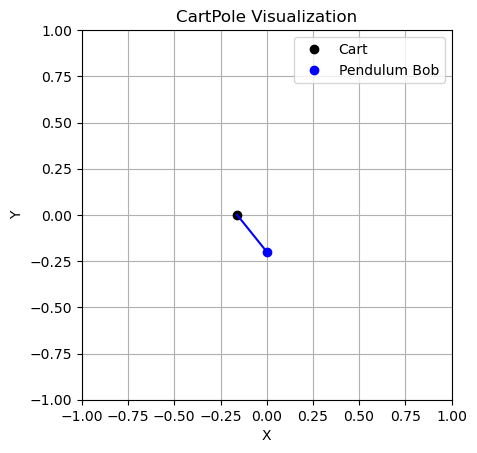


STEP:  1
CART POSITION:  0.03489782
CART VELOCITY:  0.022775836
POLE ANGLE WRT CART:  -0.043952845
VELOCITY AT TOP OF POLE:  -0.025349902
ACTION: Push cart to right


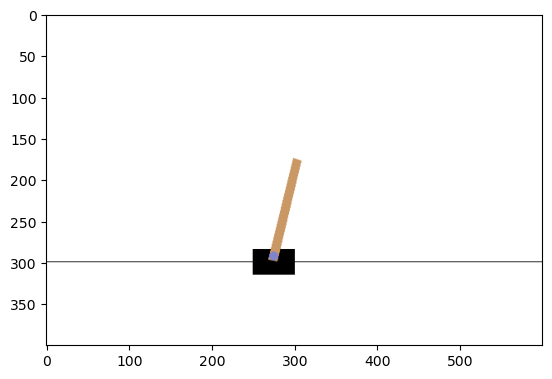

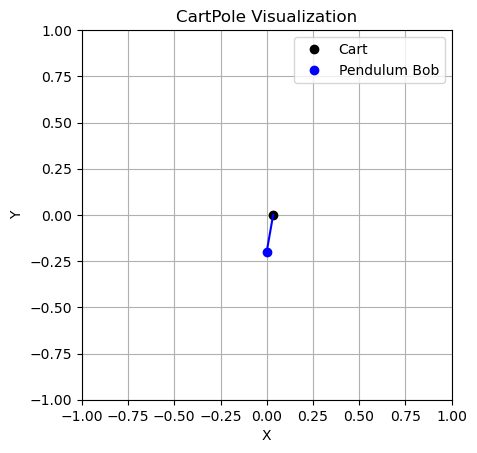


STEP:  2
CART POSITION:  0.035353336
CART VELOCITY:  0.21849965
POLE ANGLE WRT CART:  -0.044459842
VELOCITY AT TOP OF POLE:  -0.33157006
ACTION: Push cart to right


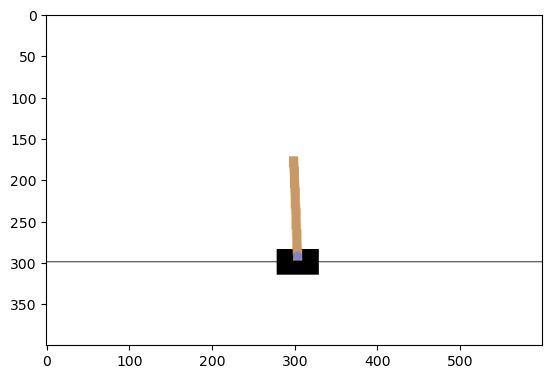

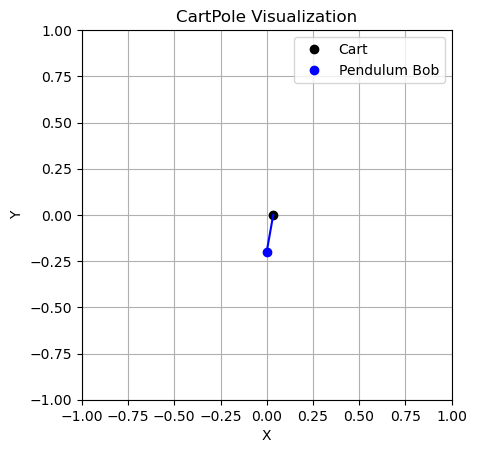


STEP:  3
CART POSITION:  0.03972333
CART VELOCITY:  0.4142253
POLE ANGLE WRT CART:  -0.051091243
VELOCITY AT TOP OF POLE:  -0.63793534
ACTION: Push cart to right


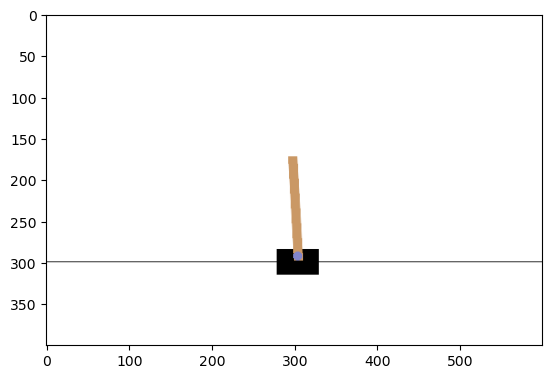

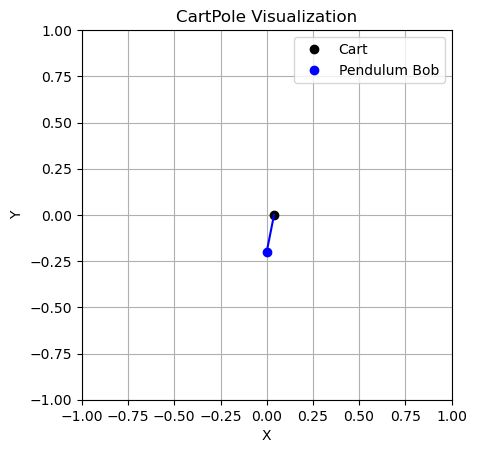


STEP:  4
CART POSITION:  0.048007835
CART VELOCITY:  0.61002105
POLE ANGLE WRT CART:  -0.06384995
VELOCITY AT TOP OF POLE:  -0.94626004
ACTION: Push cart to right


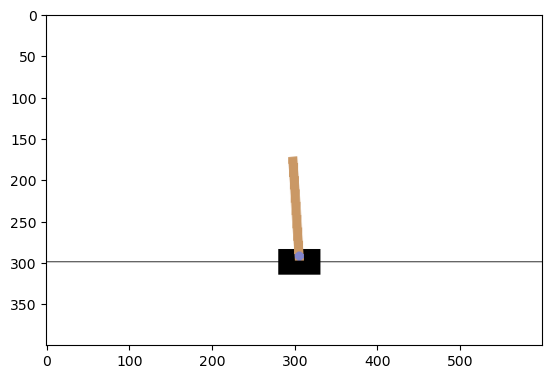

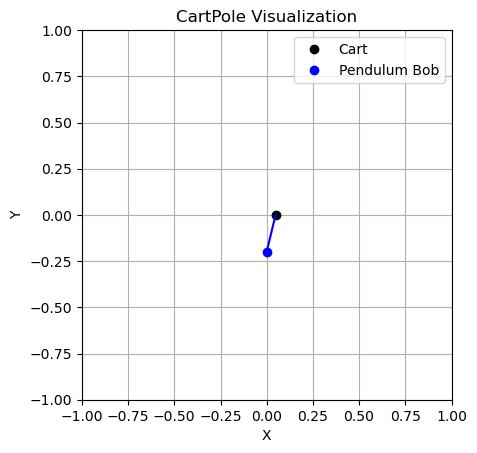


STEP:  5
CART POSITION:  0.060208257
CART VELOCITY:  0.8059421
POLE ANGLE WRT CART:  -0.08277515
VELOCITY AT TOP OF POLE:  -1.258302
ACTION: Push cart to right


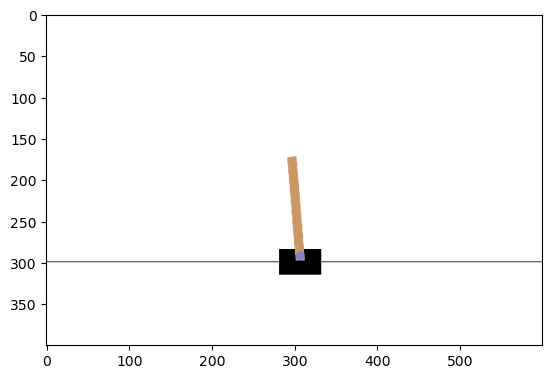

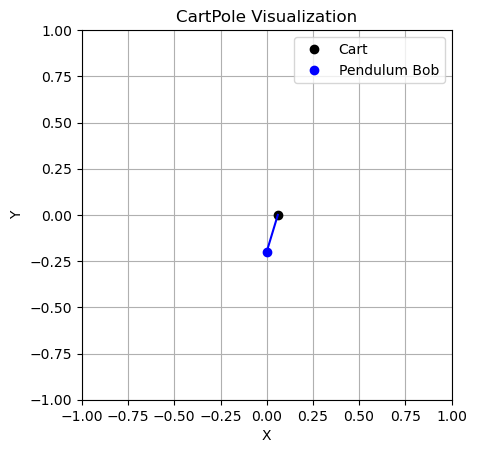


STEP:  6
CART POSITION:  0.0763271
CART VELOCITY:  1.00202
POLE ANGLE WRT CART:  -0.10794119
VELOCITY AT TOP OF POLE:  -1.5757198
ACTION: Push cart to right


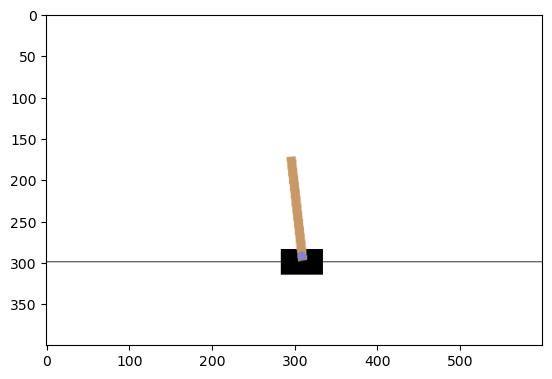

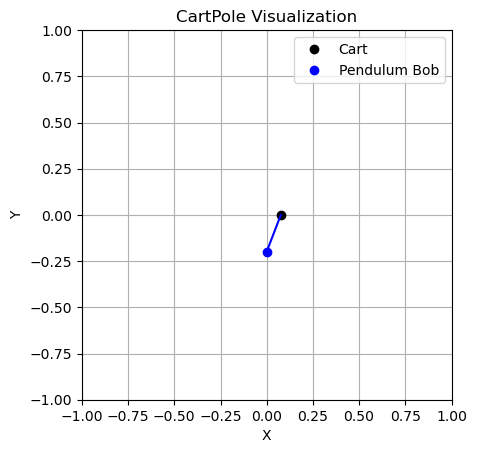


STEP:  7
CART POSITION:  0.0963675
CART VELOCITY:  1.1982504
POLE ANGLE WRT CART:  -0.13945559
VELOCITY AT TOP OF POLE:  -1.9000254
ACTION: Push cart to right


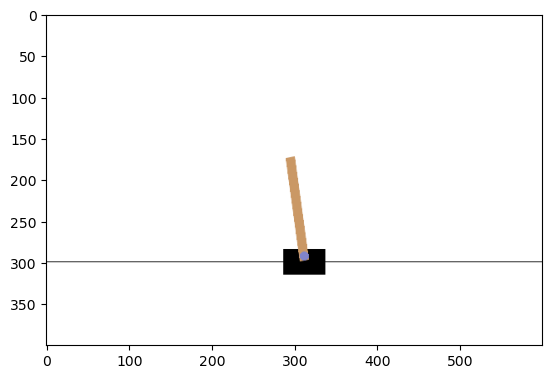

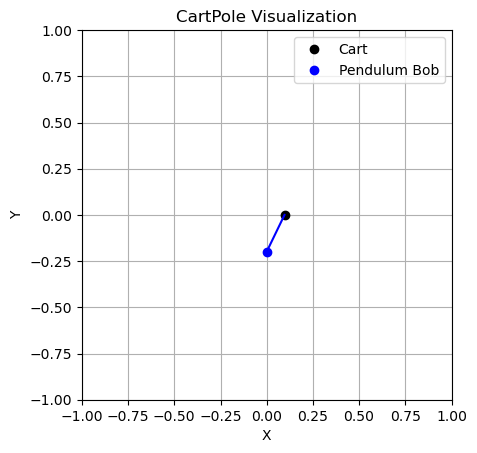


STEP:  8
CART POSITION:  0.12033251
CART VELOCITY:  1.3945793
POLE ANGLE WRT CART:  -0.1774561
VELOCITY AT TOP OF POLE:  -2.232527
ACTION: Push cart to right


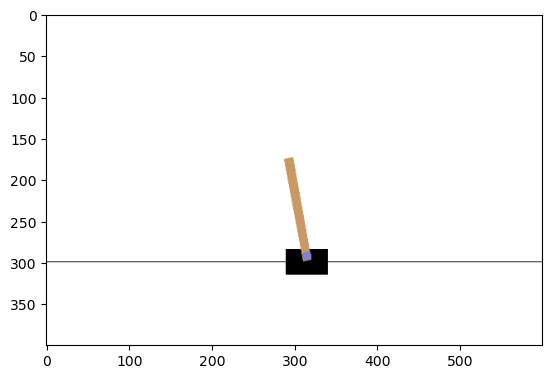

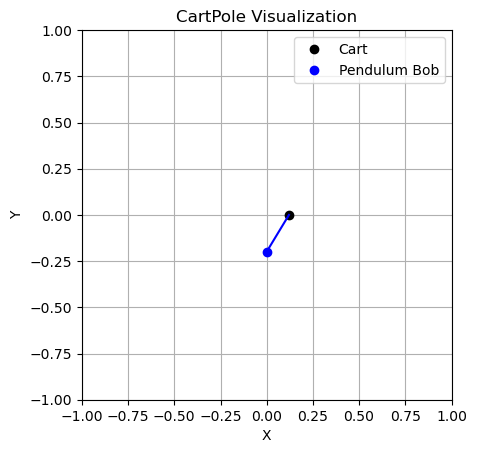


STEP:  1
CART POSITION:  0.025146004
CART VELOCITY:  -0.013410776
POLE ANGLE WRT CART:  0.0055100205
VELOCITY AT TOP OF POLE:  0.0051289797
ACTION: Push cart to right


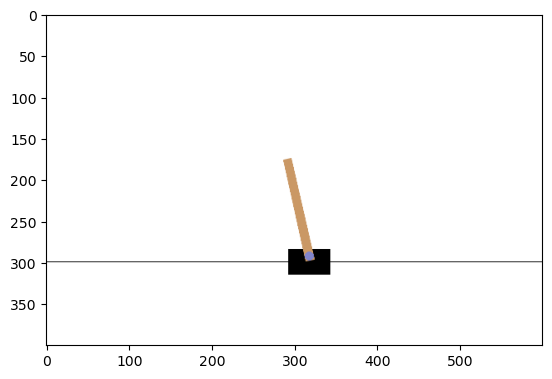

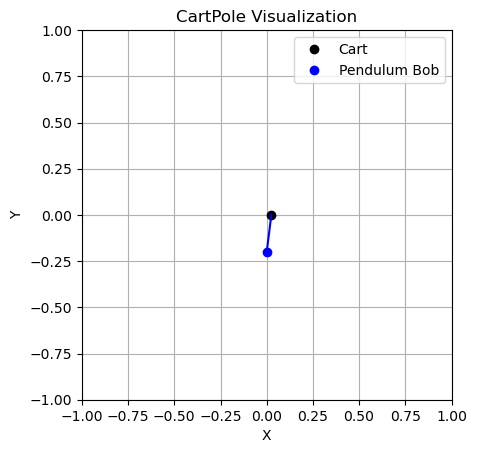


STEP:  2
CART POSITION:  0.024877787
CART VELOCITY:  0.18163173
POLE ANGLE WRT CART:  0.0056126
VELOCITY AT TOP OF POLE:  -0.28581038
ACTION: Push cart to left


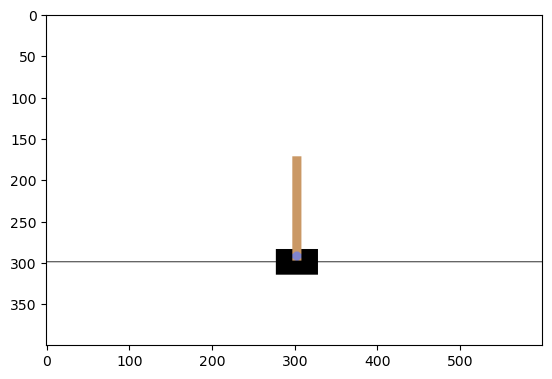

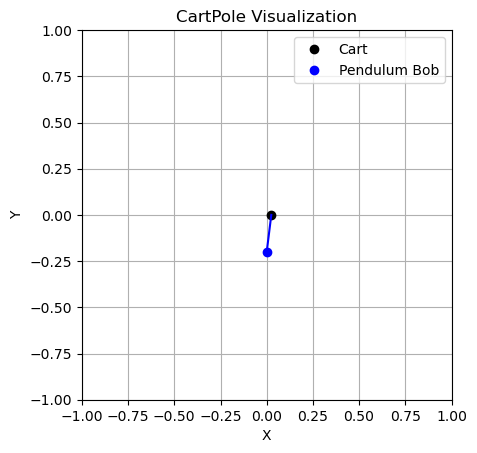


STEP:  3
CART POSITION:  0.028510422
CART VELOCITY:  -0.0135698235
POLE ANGLE WRT CART:  -0.00010360747
VELOCITY AT TOP OF POLE:  0.008637413
ACTION: Push cart to right


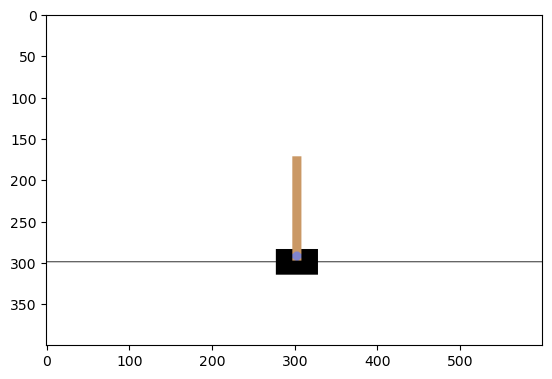

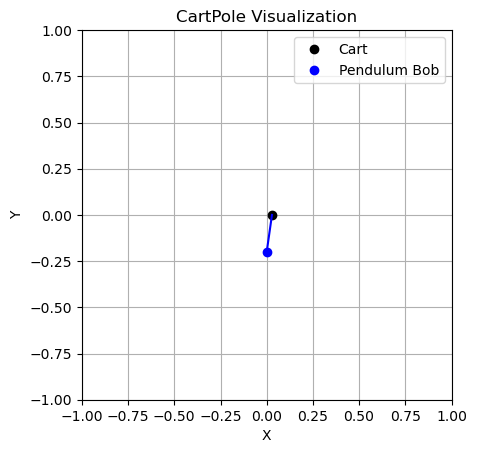


STEP:  4
CART POSITION:  0.028239025
CART VELOCITY:  0.18155362
POLE ANGLE WRT CART:  6.9140806e-05
VELOCITY AT TOP OF POLE:  -0.2840782
ACTION: Push cart to right


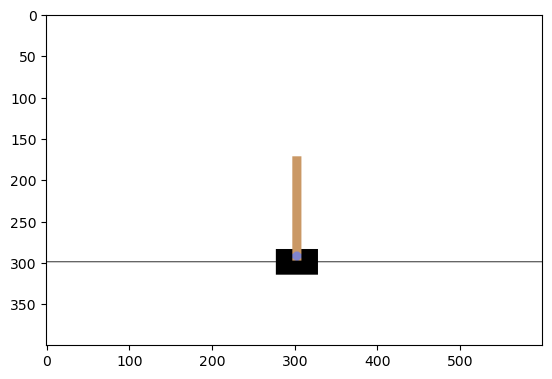

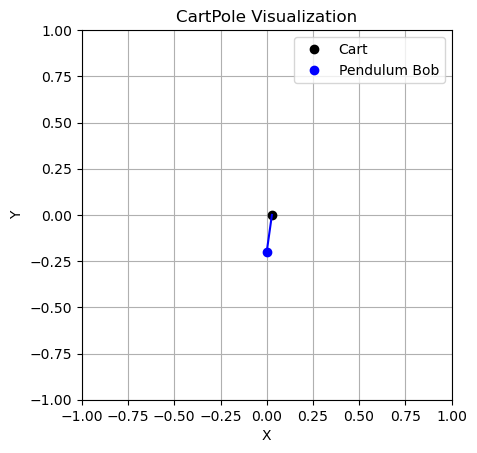


STEP:  5
CART POSITION:  0.031870097
CART VELOCITY:  0.3766746
POLE ANGLE WRT CART:  -0.005612423
VELOCITY AT TOP OF POLE:  -0.5767393
ACTION: Push cart to right


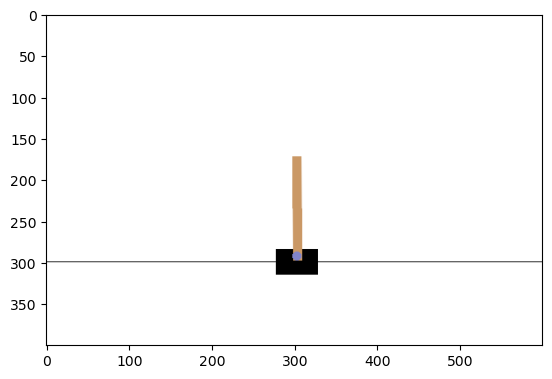

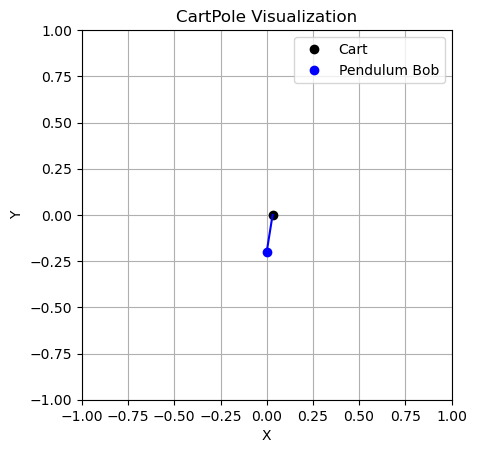


STEP:  6
CART POSITION:  0.039403588
CART VELOCITY:  0.57187474
POLE ANGLE WRT CART:  -0.01714721
VELOCITY AT TOP OF POLE:  -0.871185
ACTION: Push cart to right


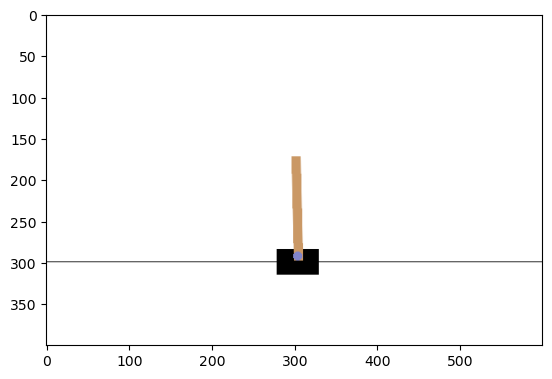

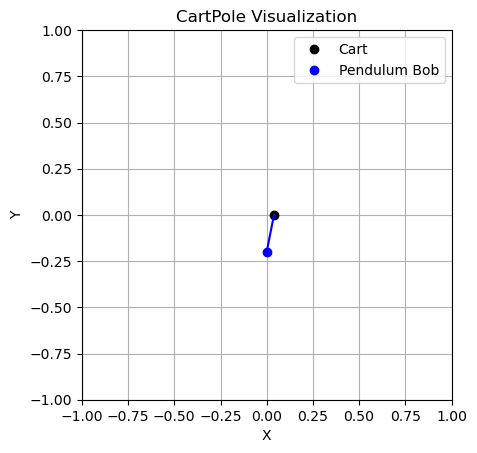


STEP:  7
CART POSITION:  0.050841086
CART VELOCITY:  0.7672257
POLE ANGLE WRT CART:  -0.03457091
VELOCITY AT TOP OF POLE:  -1.1692094
ACTION: Push cart to right


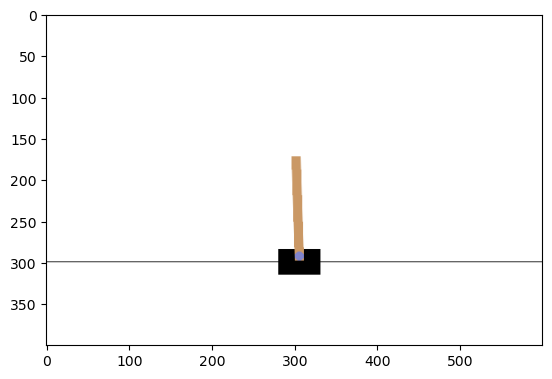

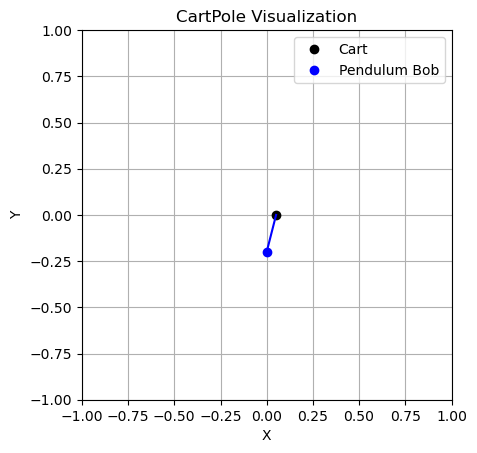


STEP:  8
CART POSITION:  0.0661856
CART VELOCITY:  0.9627798
POLE ANGLE WRT CART:  -0.057955097
VELOCITY AT TOP OF POLE:  -1.4725271
ACTION: Push cart to right


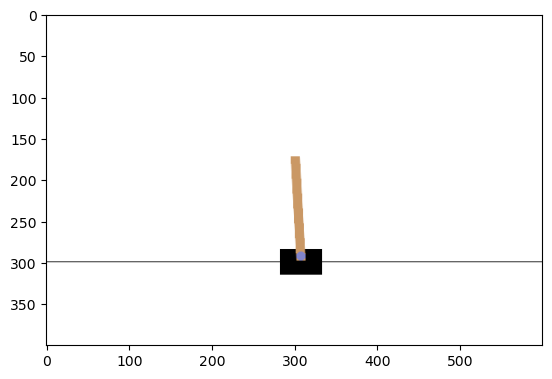

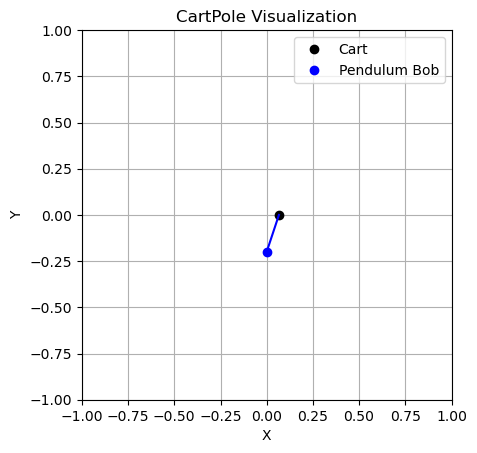


STEP:  9
CART POSITION:  0.085441194
CART VELOCITY:  1.1585605
POLE ANGLE WRT CART:  -0.08740564
VELOCITY AT TOP OF POLE:  -1.7827343
ACTION: Push cart to right


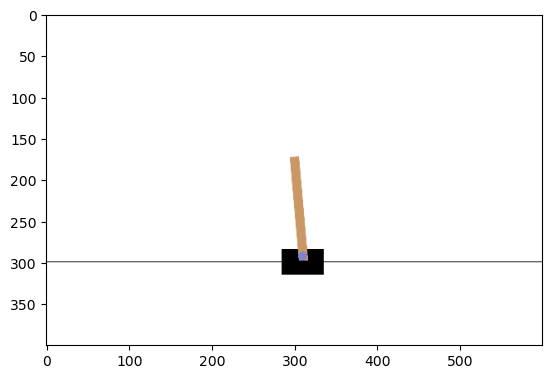

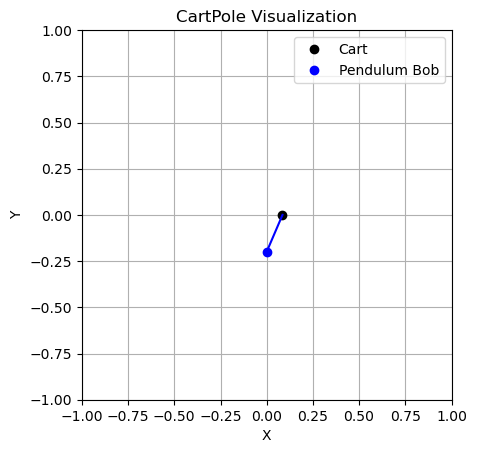


STEP:  10
CART POSITION:  0.1086124
CART VELOCITY:  1.3545496
POLE ANGLE WRT CART:  -0.12306032
VELOCITY AT TOP OF POLE:  -2.1012604
ACTION: Push cart to right


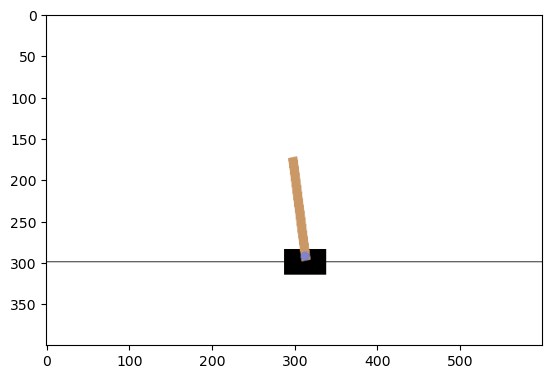

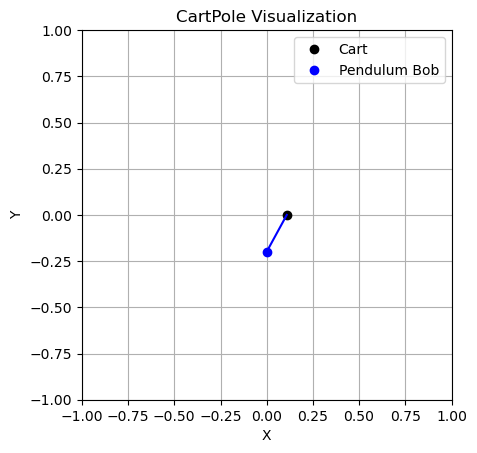


STEP:  11
CART POSITION:  0.1357034
CART VELOCITY:  1.5506737
POLE ANGLE WRT CART:  -0.16508554
VELOCITY AT TOP OF POLE:  -2.42931
ACTION: Push cart to right


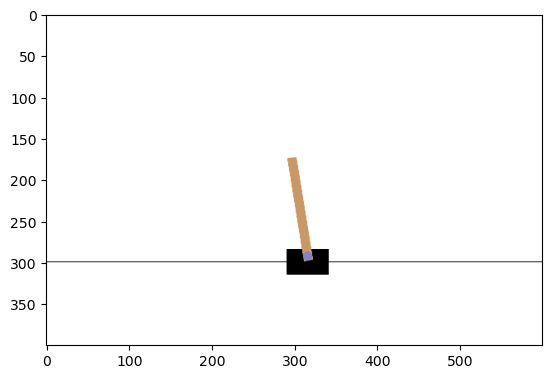

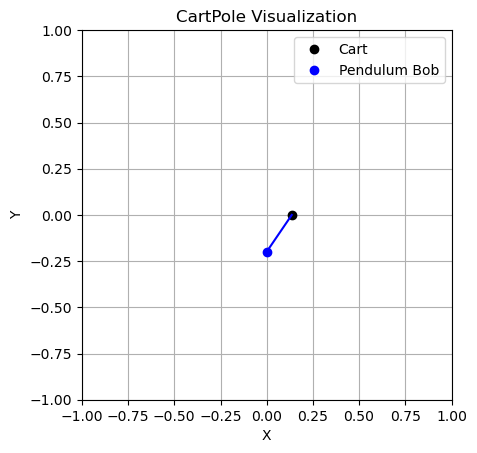


STEP:  1
CART POSITION:  0.011247367
CART VELOCITY:  -0.04904511
POLE ANGLE WRT CART:  -0.04964397
VELOCITY AT TOP OF POLE:  0.037106536
ACTION: Push cart to left


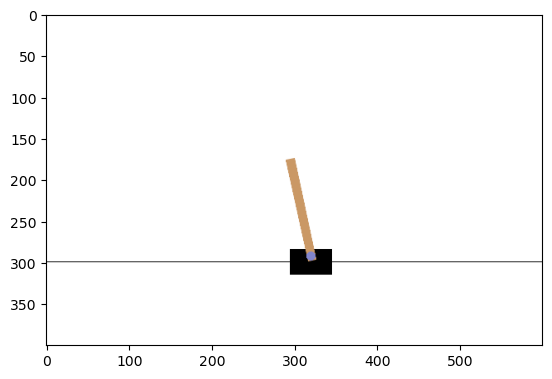

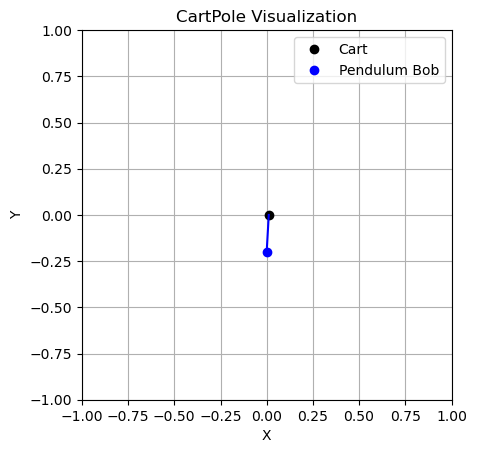


STEP:  2
CART POSITION:  0.010266464
CART VELOCITY:  -0.2434213
POLE ANGLE WRT CART:  -0.048901837
VELOCITY AT TOP OF POLE:  0.31372228
ACTION: Push cart to left


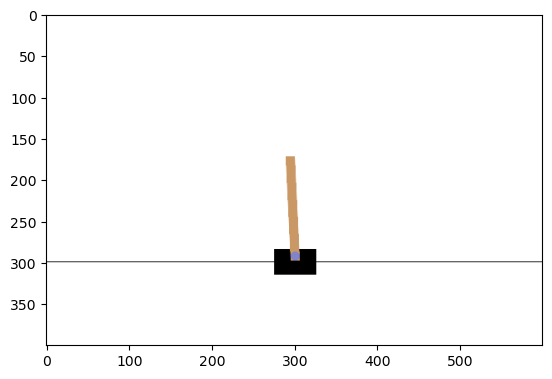

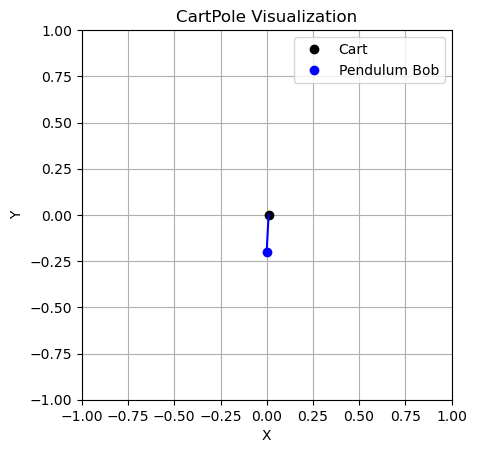


STEP:  3
CART POSITION:  0.0053980383
CART VELOCITY:  -0.43781376
POLE ANGLE WRT CART:  -0.042627394
VELOCITY AT TOP OF POLE:  0.59059095
ACTION: Push cart to left


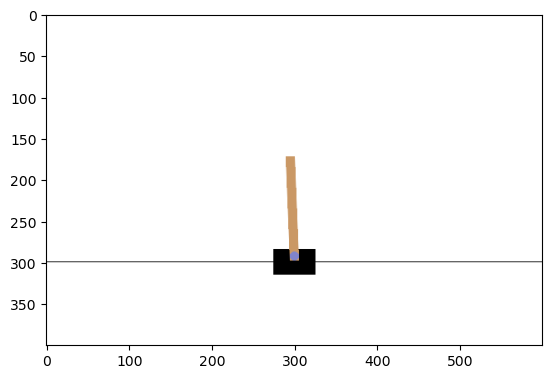

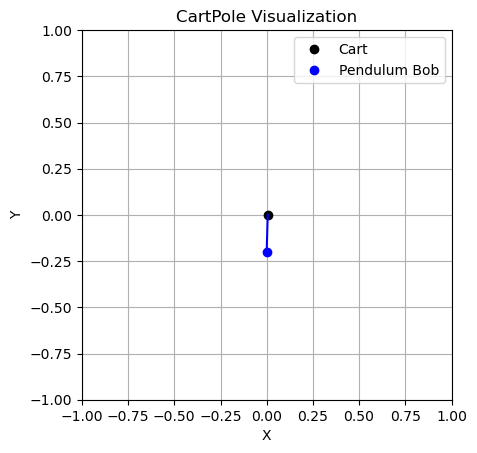


STEP:  4
CART POSITION:  -0.003358237
CART VELOCITY:  -0.6323138
POLE ANGLE WRT CART:  -0.030815573
VELOCITY AT TOP OF POLE:  0.8695473
ACTION: Push cart to left


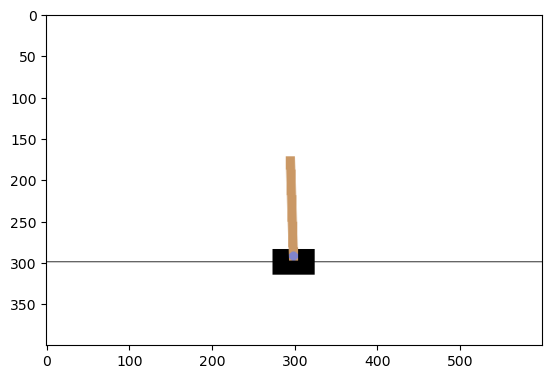

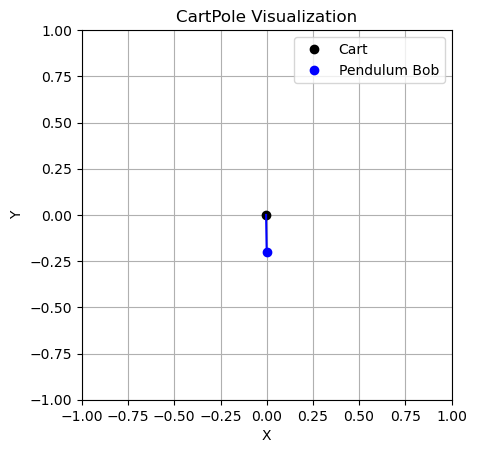


STEP:  5
CART POSITION:  -0.016004512
CART VELOCITY:  -0.82700324
POLE ANGLE WRT CART:  -0.0134246275
VELOCITY AT TOP OF POLE:  1.1523845
ACTION: Push cart to left


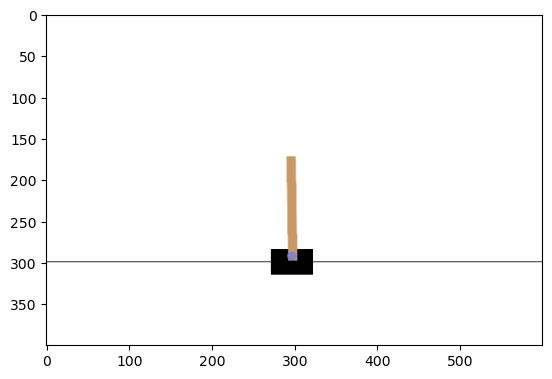

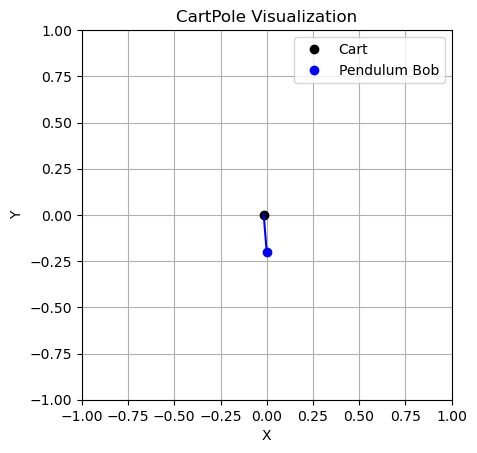


STEP:  6
CART POSITION:  -0.032544576
CART VELOCITY:  -1.0219475
POLE ANGLE WRT CART:  0.009623063
VELOCITY AT TOP OF POLE:  1.4408278
ACTION: Push cart to left


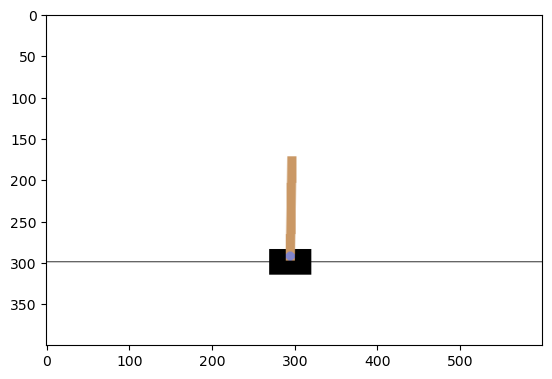

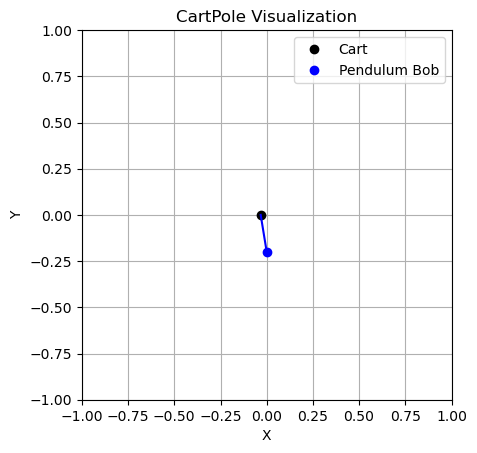


STEP:  7
CART POSITION:  -0.052983526
CART VELOCITY:  -1.2171867
POLE ANGLE WRT CART:  0.03843962
VELOCITY AT TOP OF POLE:  1.7365022
ACTION: Push cart to left


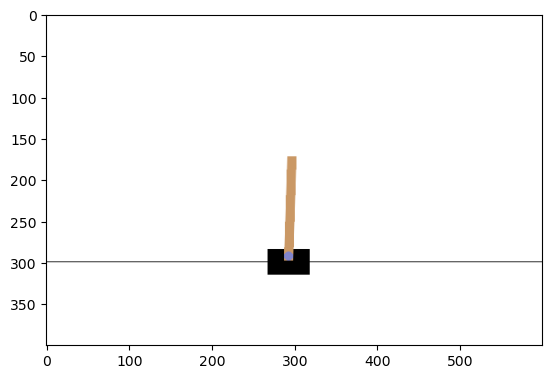

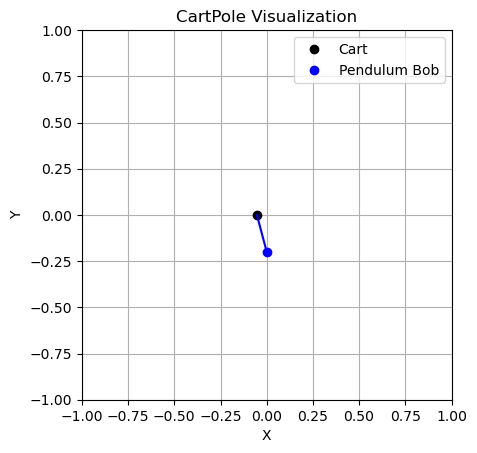


STEP:  8
CART POSITION:  -0.07732726
CART VELOCITY:  -1.4127252
POLE ANGLE WRT CART:  0.07316966
VELOCITY AT TOP OF POLE:  2.0408916
ACTION: Push cart to left


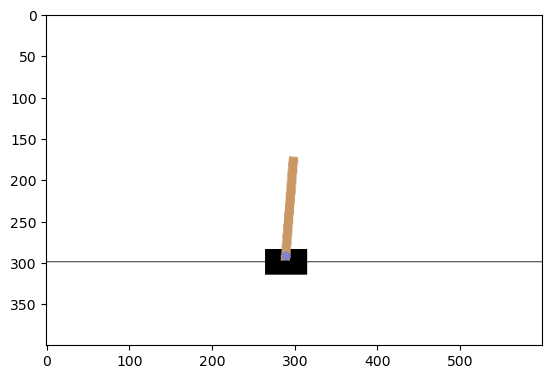

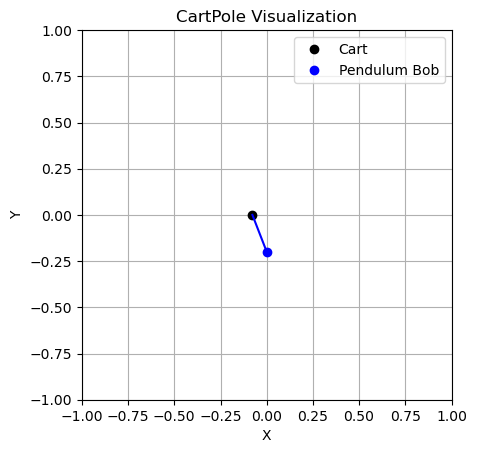


STEP:  9
CART POSITION:  -0.10558177
CART VELOCITY:  -1.6085191
POLE ANGLE WRT CART:  0.1139875
VELOCITY AT TOP OF POLE:  2.3552895
ACTION: Push cart to left


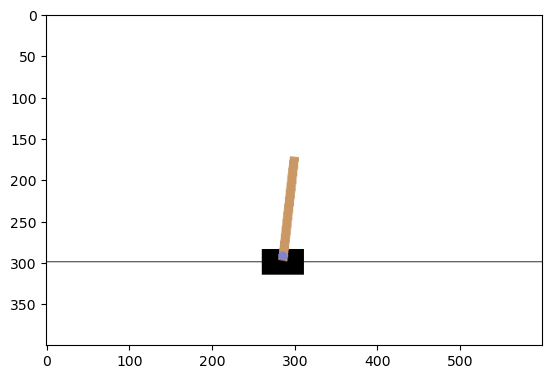

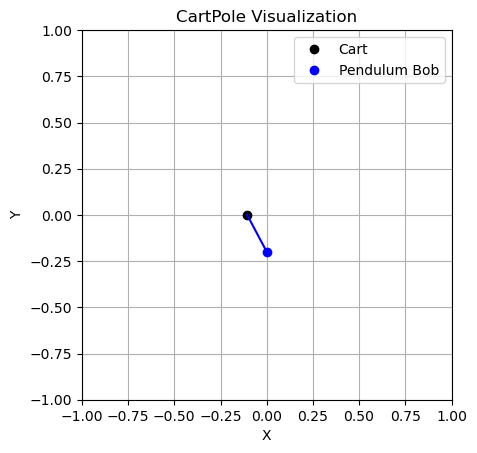


STEP:  10
CART POSITION:  -0.13775215
CART VELOCITY:  -1.8044606
POLE ANGLE WRT CART:  0.1610933
VELOCITY AT TOP OF POLE:  2.6807342
ACTION: Push cart to left


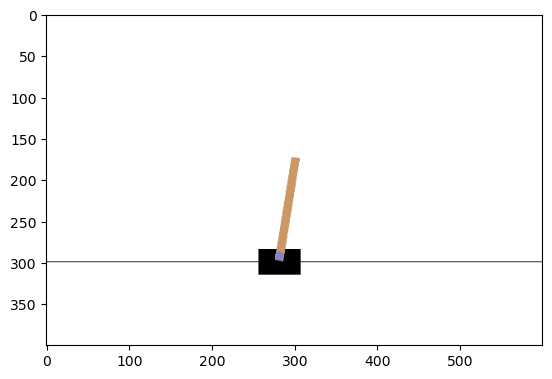

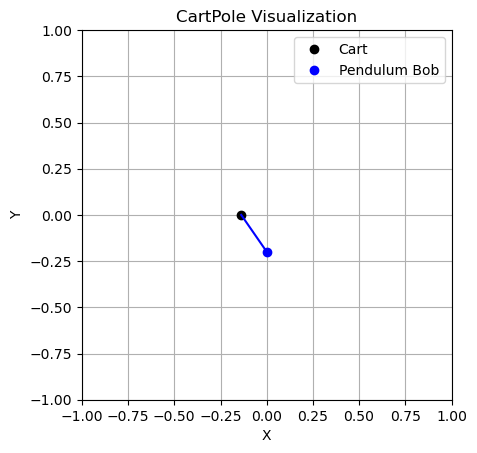


STEP:  1
CART POSITION:  0.02609248
CART VELOCITY:  -0.031978082
POLE ANGLE WRT CART:  0.0021331853
VELOCITY AT TOP OF POLE:  -0.019829627
ACTION: Push cart to left


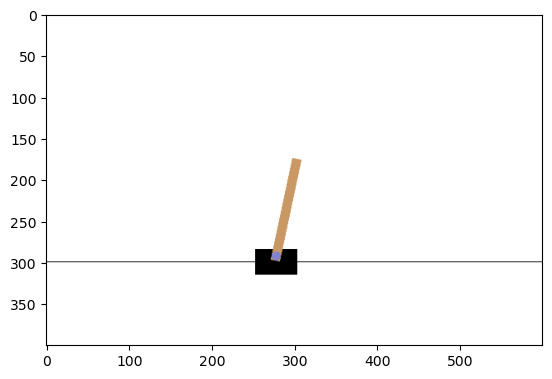

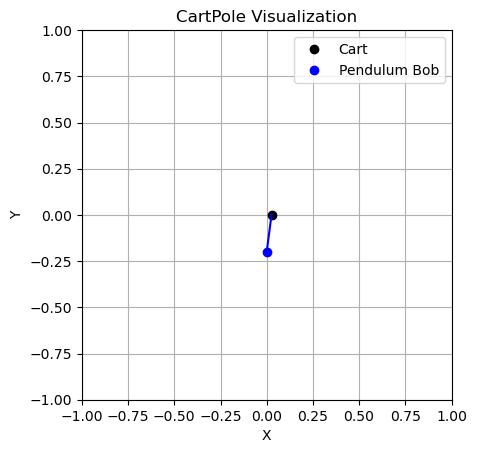


STEP:  2
CART POSITION:  0.02545292
CART VELOCITY:  -0.22713056
POLE ANGLE WRT CART:  0.0017365926
VELOCITY AT TOP OF POLE:  0.27352557
ACTION: Push cart to right


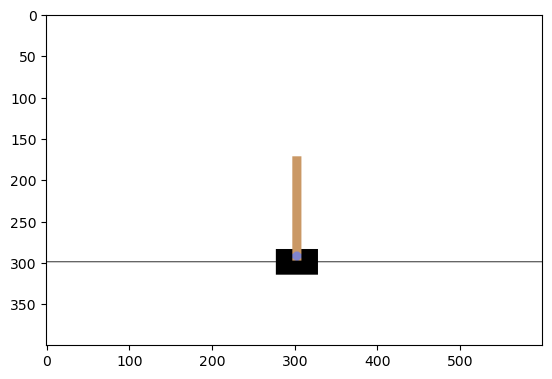

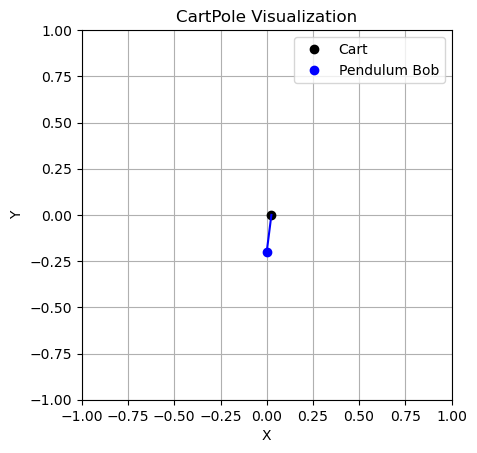


STEP:  3
CART POSITION:  0.020910308
CART VELOCITY:  -0.032033432
POLE ANGLE WRT CART:  0.0072071045
VELOCITY AT TOP OF POLE:  -0.018609116
ACTION: Push cart to right


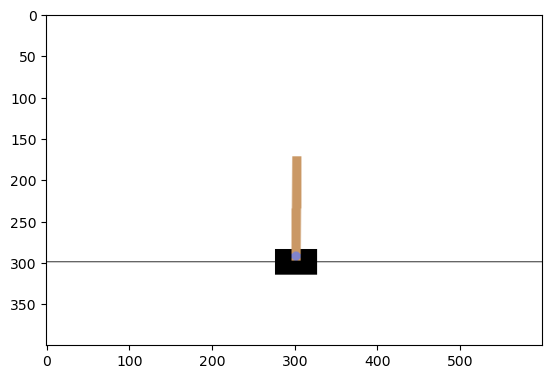

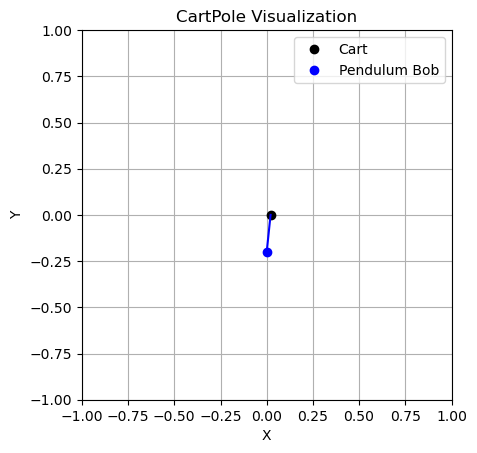


STEP:  4
CART POSITION:  0.02026964
CART VELOCITY:  0.16298443
POLE ANGLE WRT CART:  0.006834922
VELOCITY AT TOP OF POLE:  -0.30900943
ACTION: Push cart to right


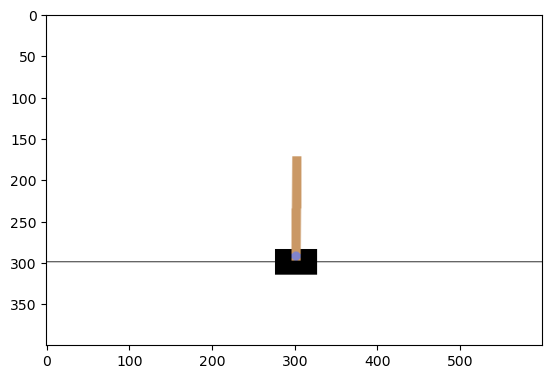

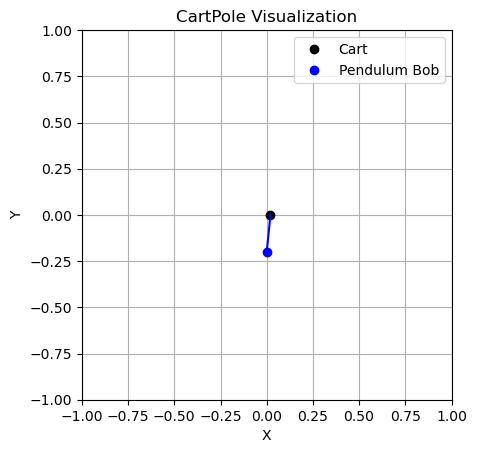


STEP:  5
CART POSITION:  0.023529328
CART VELOCITY:  0.35800833
POLE ANGLE WRT CART:  0.00065473333
VELOCITY AT TOP OF POLE:  -0.599529
ACTION: Push cart to right


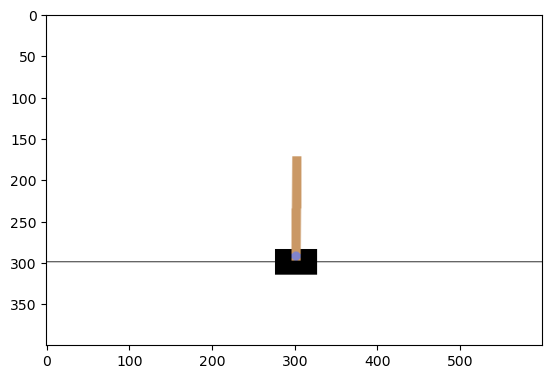

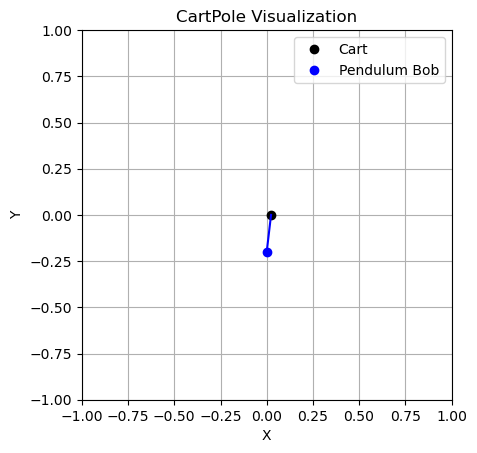


STEP:  6
CART POSITION:  0.030689495
CART VELOCITY:  0.5531211
POLE ANGLE WRT CART:  -0.011335847
VELOCITY AT TOP OF POLE:  -0.8920056
ACTION: Push cart to right


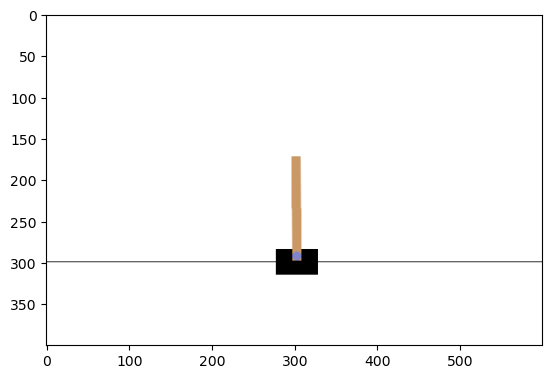

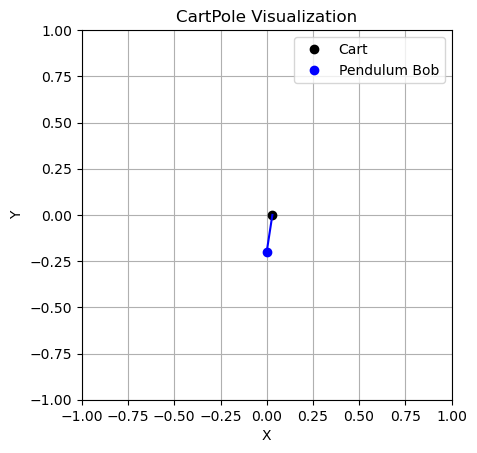


STEP:  7
CART POSITION:  0.041751917
CART VELOCITY:  0.74839497
POLE ANGLE WRT CART:  -0.02917596
VELOCITY AT TOP OF POLE:  -1.1882303
ACTION: Push cart to right


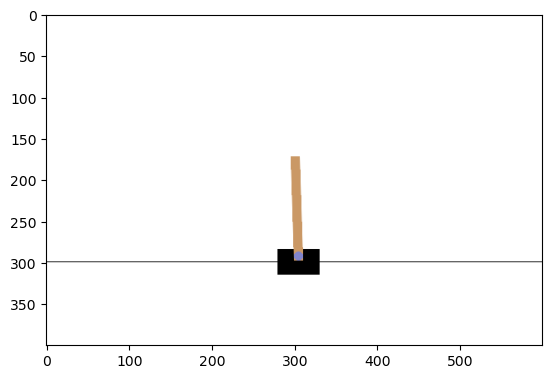

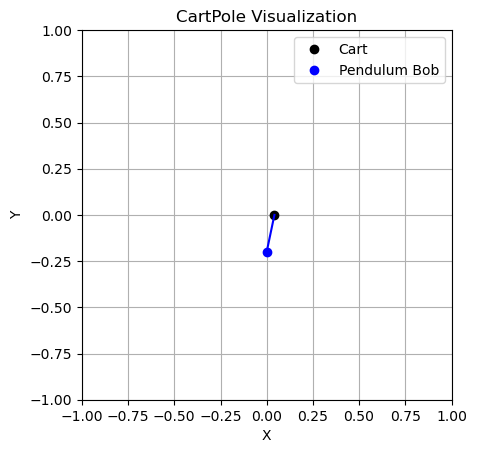


STEP:  8
CART POSITION:  0.056719817
CART VELOCITY:  0.94388276
POLE ANGLE WRT CART:  -0.052940566
VELOCITY AT TOP OF POLE:  -1.4899137
ACTION: Push cart to right


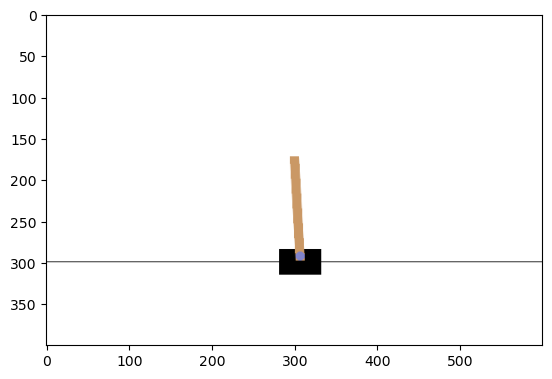

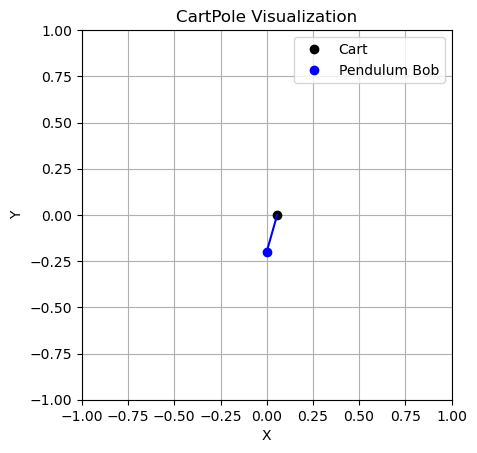


STEP:  9
CART POSITION:  0.07559747
CART VELOCITY:  1.1396079
POLE ANGLE WRT CART:  -0.08273884
VELOCITY AT TOP OF POLE:  -1.7986473
ACTION: Push cart to right


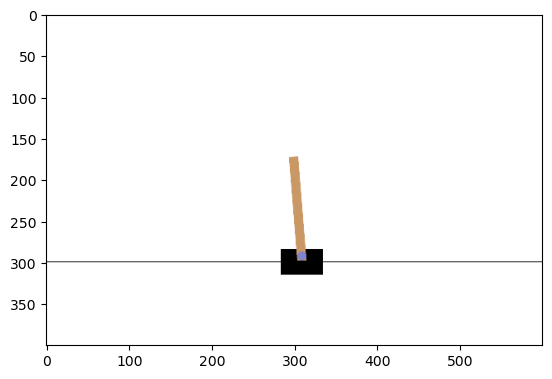

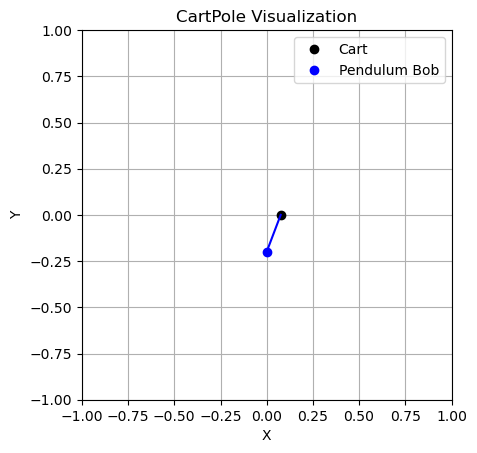


STEP:  10
CART POSITION:  0.098389626
CART VELOCITY:  1.3355522
POLE ANGLE WRT CART:  -0.118711784
VELOCITY AT TOP OF POLE:  -2.1158557
ACTION: Push cart to right


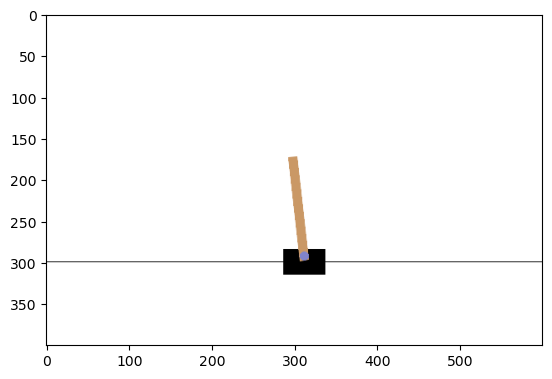

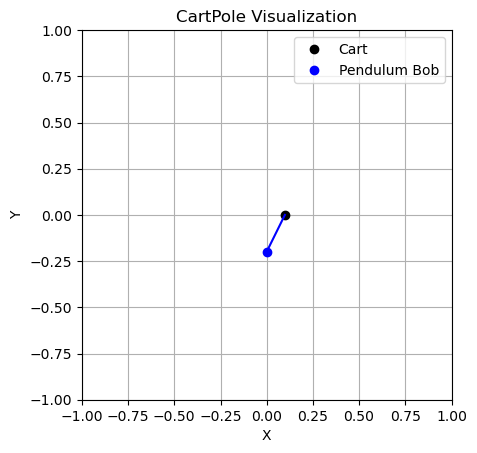


STEP:  11
CART POSITION:  0.12510067
CART VELOCITY:  1.5316422
POLE ANGLE WRT CART:  -0.16102889
VELOCITY AT TOP OF POLE:  -2.44274
ACTION: Push cart to right


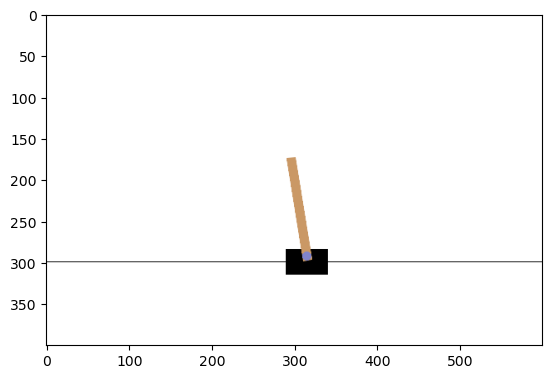

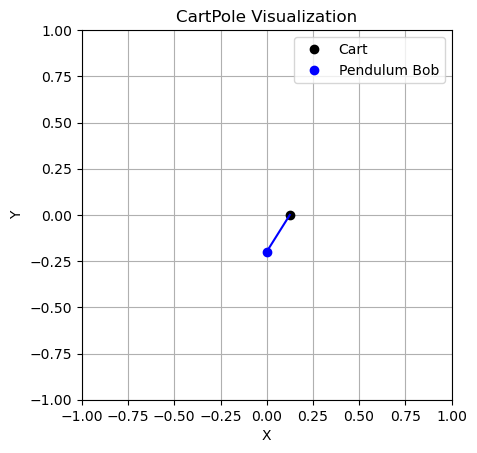


STEP:  1
CART POSITION:  0.030447276
CART VELOCITY:  0.00011695409
POLE ANGLE WRT CART:  -0.04322448
VELOCITY AT TOP OF POLE:  -0.00643014
ACTION: Push cart to left


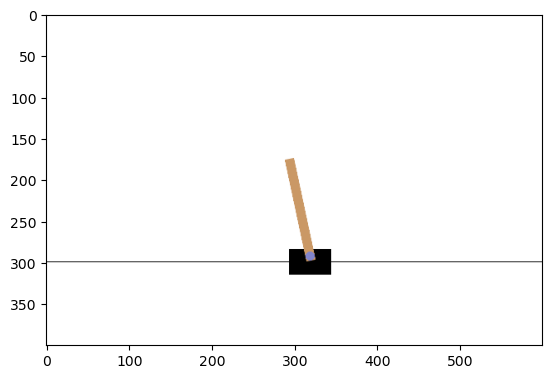

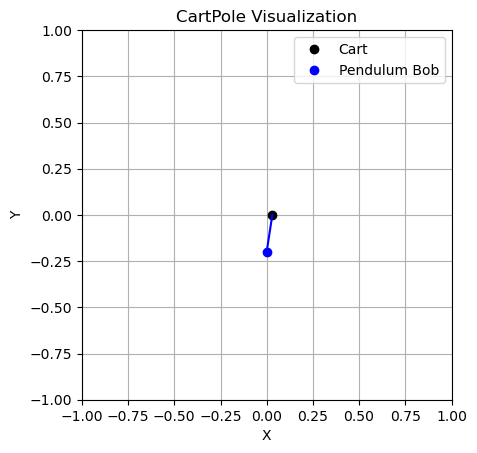


STEP:  2
CART POSITION:  0.030449614
CART VELOCITY:  -0.1943593
POLE ANGLE WRT CART:  -0.043353084
VELOCITY AT TOP OF POLE:  0.27230772
ACTION: Push cart to left


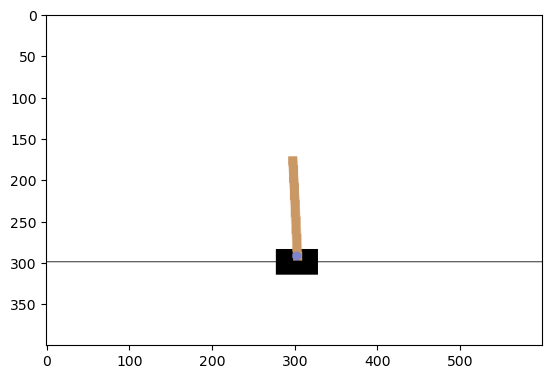

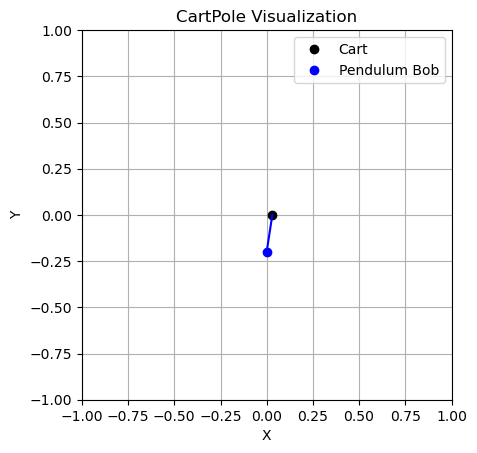


STEP:  3
CART POSITION:  0.026562428
CART VELOCITY:  -0.38883668
POLE ANGLE WRT CART:  -0.03790693
VELOCITY AT TOP OF POLE:  0.5510079
ACTION: Push cart to left


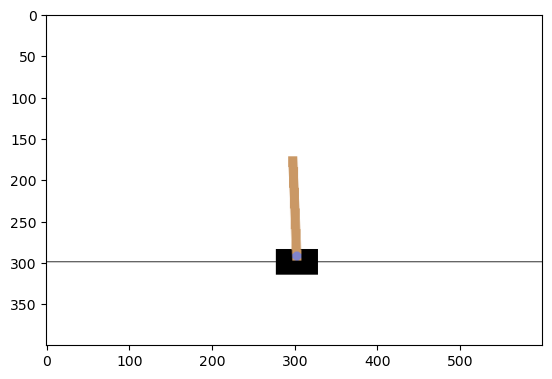

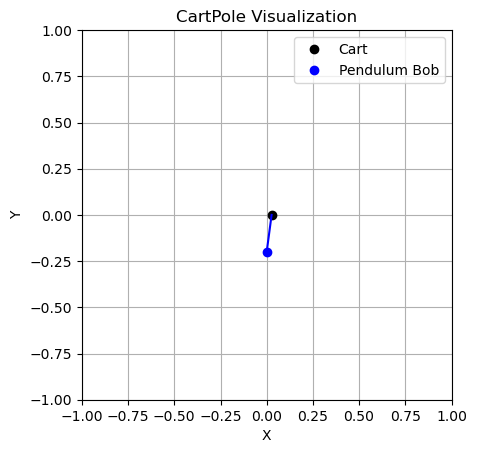


STEP:  4
CART POSITION:  0.018785695
CART VELOCITY:  -0.58340627
POLE ANGLE WRT CART:  -0.02688677
VELOCITY AT TOP OF POLE:  0.83151066
ACTION: Push cart to left


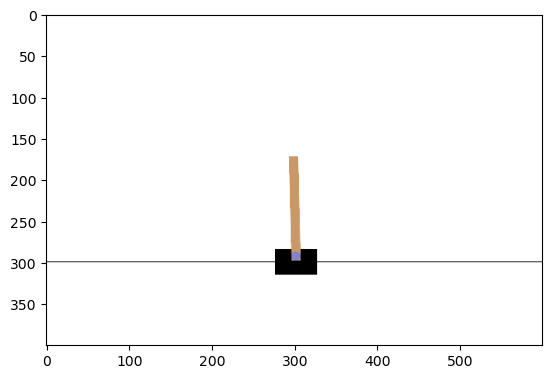

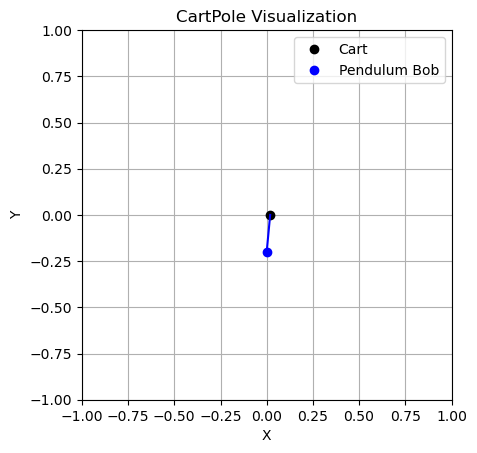


STEP:  5
CART POSITION:  0.007117569
CART VELOCITY:  -0.7781507
POLE ANGLE WRT CART:  -0.010256557
VELOCITY AT TOP OF POLE:  1.1156179
ACTION: Push cart to left


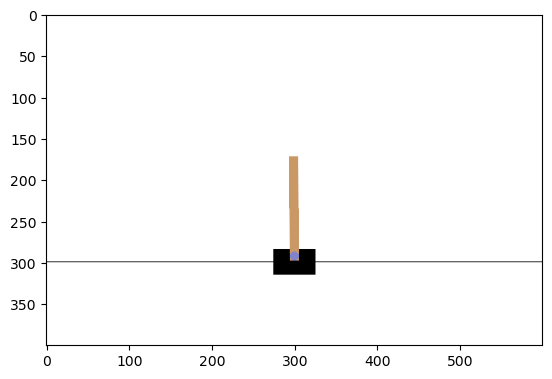

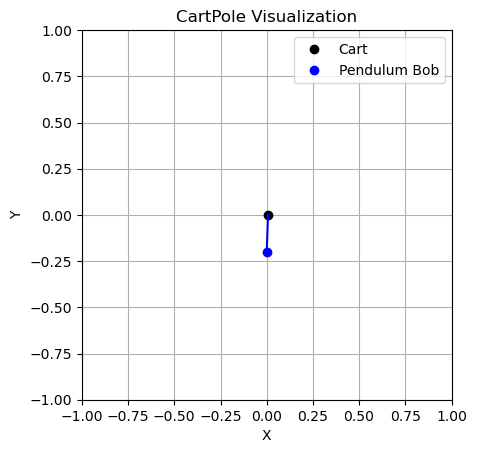


STEP:  6
CART POSITION:  -0.0084454445
CART VELOCITY:  -0.9731365
POLE ANGLE WRT CART:  0.012055801
VELOCITY AT TOP OF POLE:  1.4050659
ACTION: Push cart to left


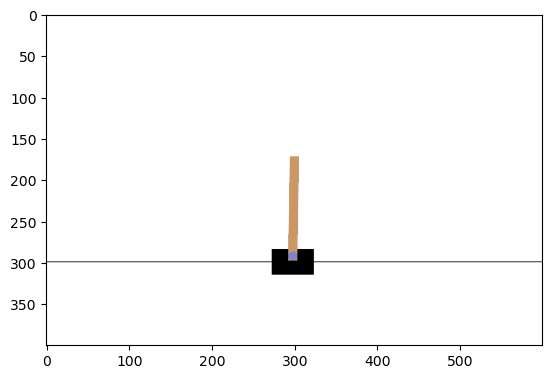

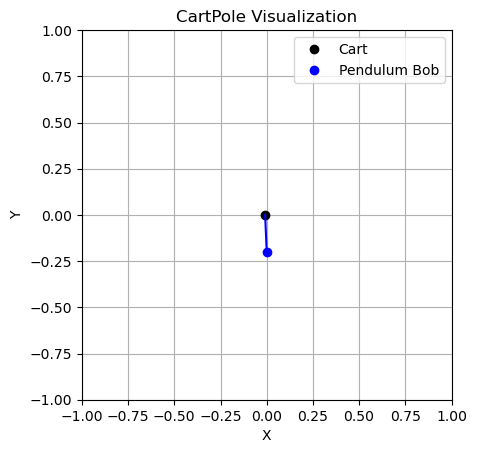


STEP:  7
CART POSITION:  -0.027908174
CART VELOCITY:  -1.168406
POLE ANGLE WRT CART:  0.04015712
VELOCITY AT TOP OF POLE:  1.7014933
ACTION: Push cart to left


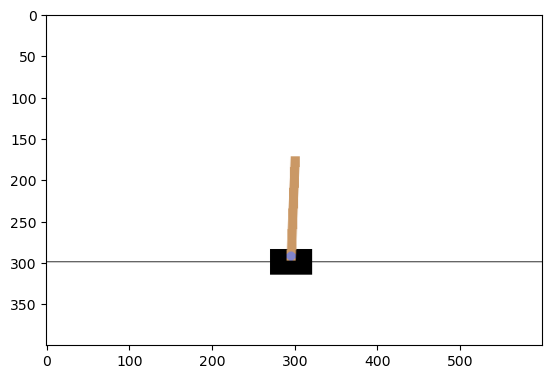

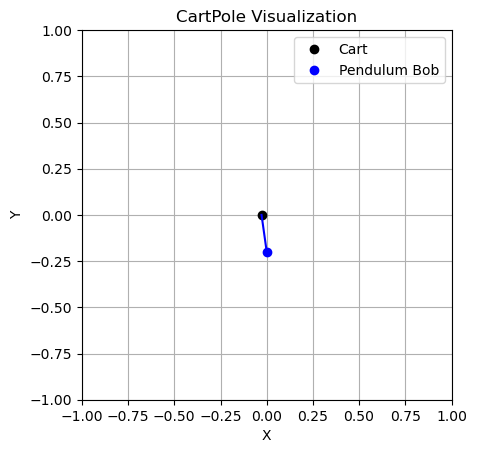


STEP:  8
CART POSITION:  -0.051276296
CART VELOCITY:  -1.3639668
POLE ANGLE WRT CART:  0.07418698
VELOCITY AT TOP OF POLE:  2.0064008
ACTION: Push cart to left


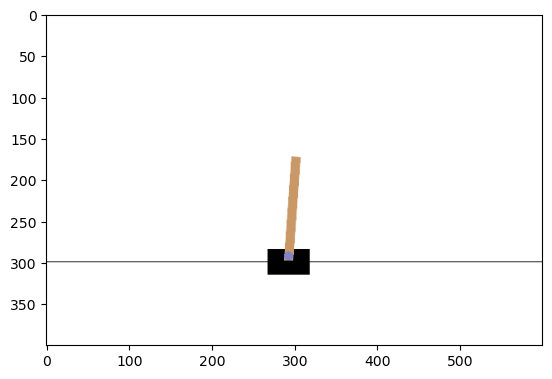

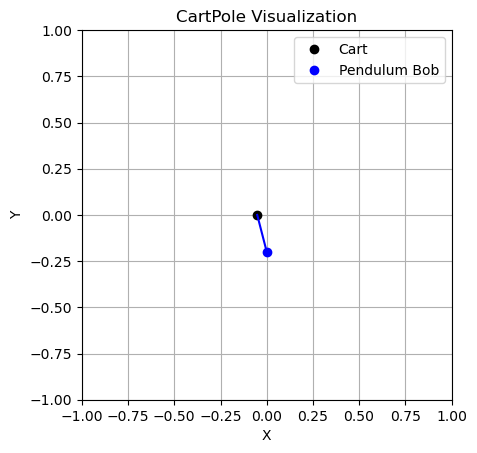


STEP:  9
CART POSITION:  -0.07855563
CART VELOCITY:  -1.559779
POLE ANGLE WRT CART:  0.114315
VELOCITY AT TOP OF POLE:  2.3211024
ACTION: Push cart to left


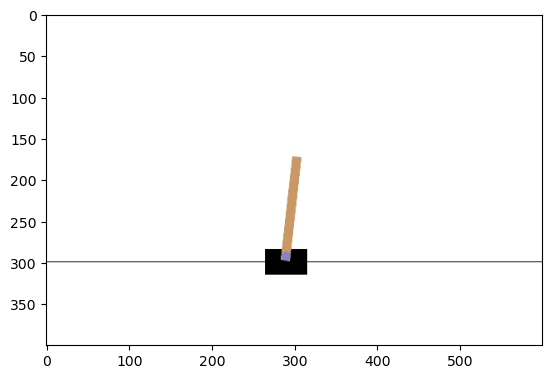

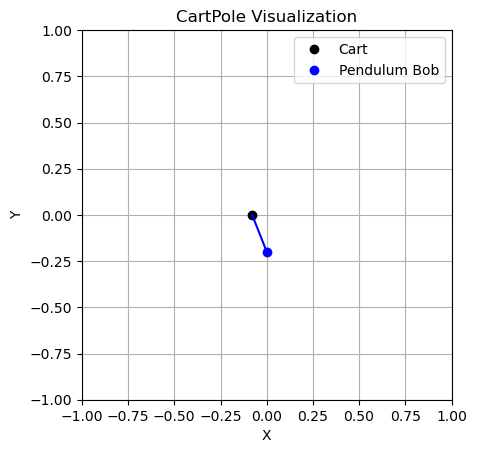


STEP:  10
CART POSITION:  -0.10975121
CART VELOCITY:  -1.75574
POLE ANGLE WRT CART:  0.16073705
VELOCITY AT TOP OF POLE:  2.6466608
ACTION: Push cart to left


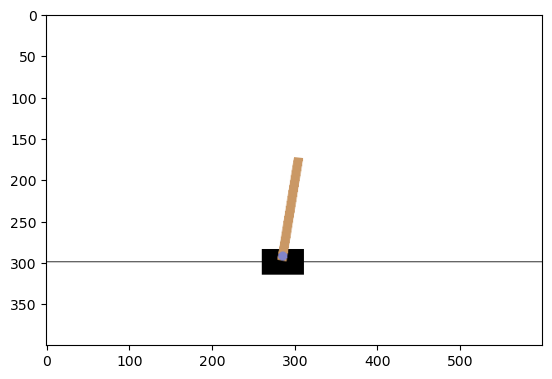

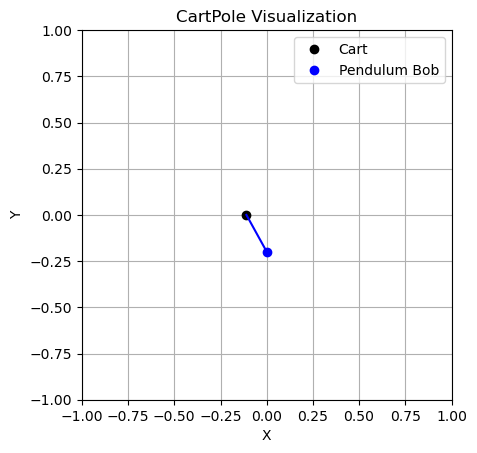


STEP:  1
CART POSITION:  0.017518952
CART VELOCITY:  0.04667496
POLE ANGLE WRT CART:  0.03448799
VELOCITY AT TOP OF POLE:  -0.02256431
ACTION: Push cart to left


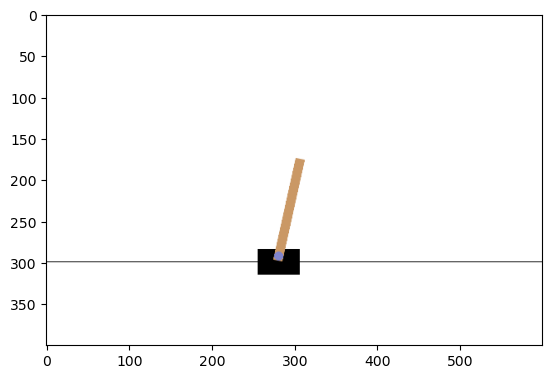

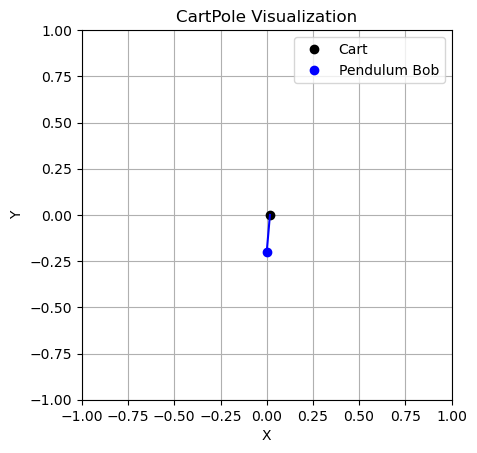


STEP:  2
CART POSITION:  0.018452452
CART VELOCITY:  -0.14892417
POLE ANGLE WRT CART:  0.034036703
VELOCITY AT TOP OF POLE:  0.2807974
ACTION: Push cart to left


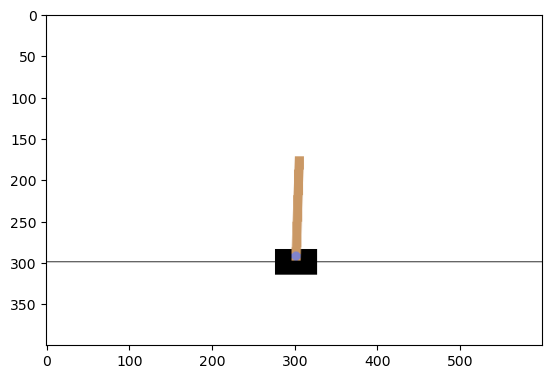

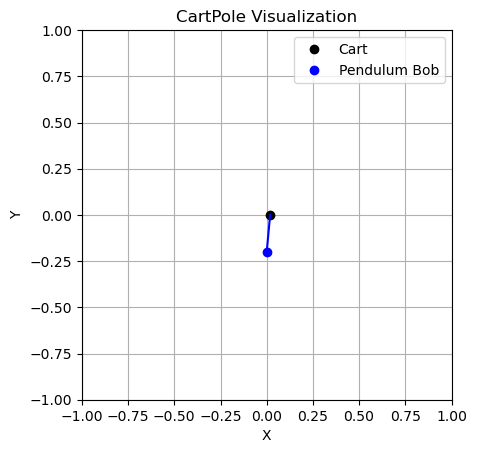


STEP:  3
CART POSITION:  0.015473968
CART VELOCITY:  -0.3445147
POLE ANGLE WRT CART:  0.03965265
VELOCITY AT TOP OF POLE:  0.5840181
ACTION: Push cart to left


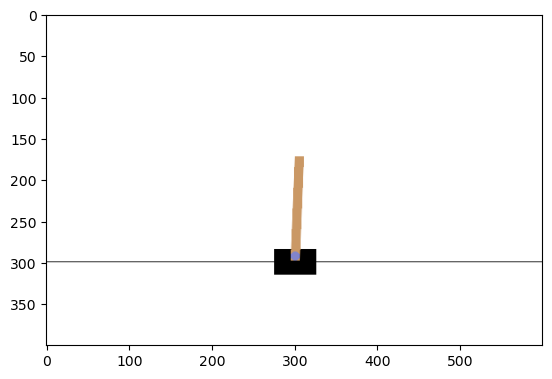

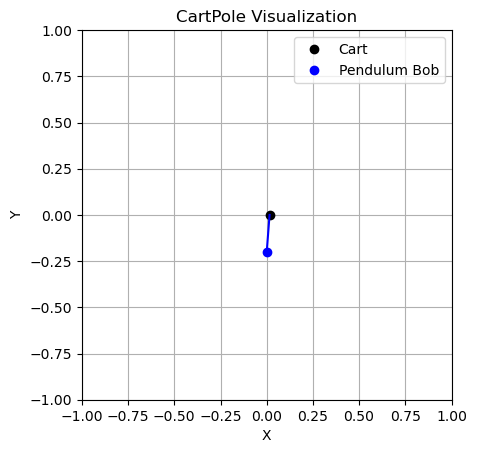


STEP:  4
CART POSITION:  0.008583674
CART VELOCITY:  -0.54016906
POLE ANGLE WRT CART:  0.05133301
VELOCITY AT TOP OF POLE:  0.8889237
ACTION: Push cart to left


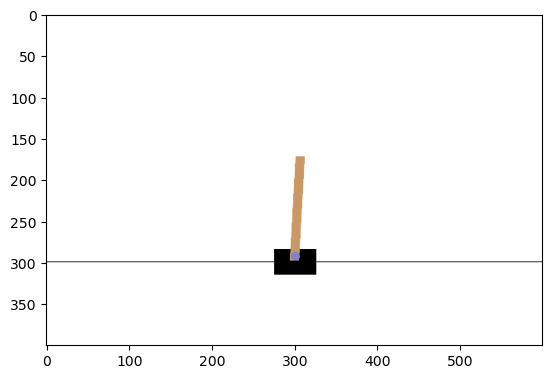

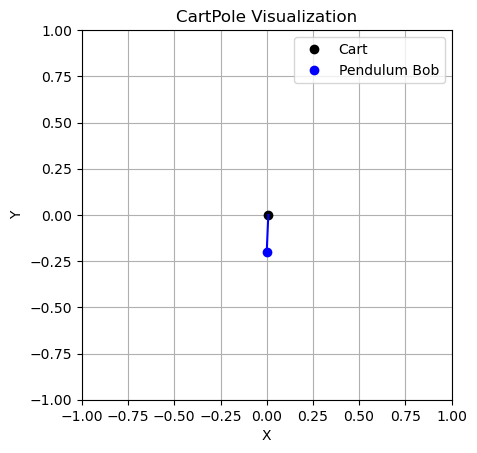


STEP:  5
CART POSITION:  -0.0022197063
CART VELOCITY:  -0.7359486
POLE ANGLE WRT CART:  0.06911149
VELOCITY AT TOP OF POLE:  1.1972915
ACTION: Push cart to left


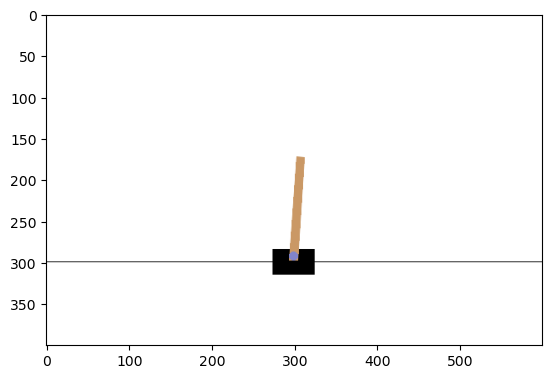

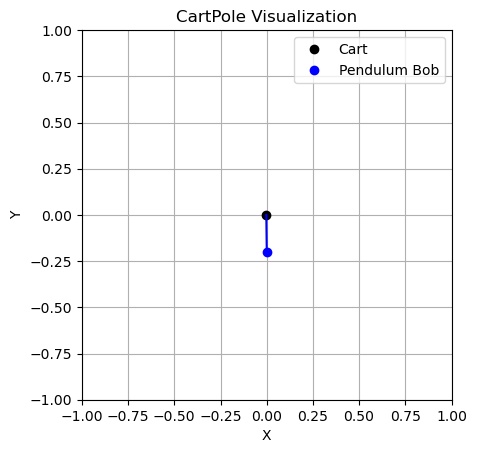


STEP:  6
CART POSITION:  -0.016938679
CART VELOCITY:  -0.93189365
POLE ANGLE WRT CART:  0.09305732
VELOCITY AT TOP OF POLE:  1.51081
ACTION: Push cart to left


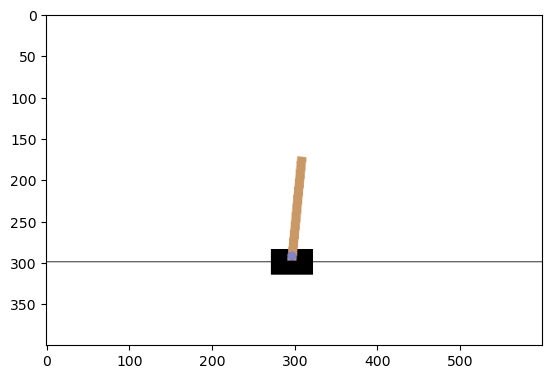

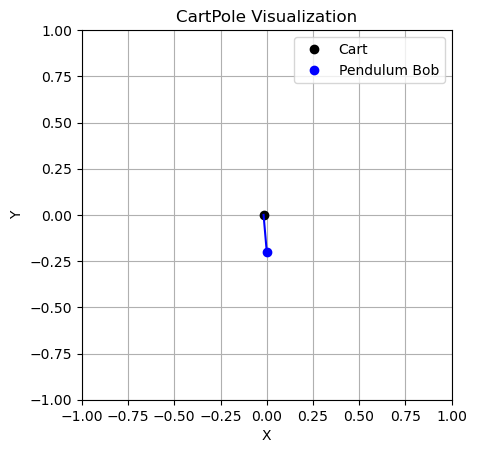


STEP:  7
CART POSITION:  -0.035576552
CART VELOCITY:  -1.1280116
POLE ANGLE WRT CART:  0.123273514
VELOCITY AT TOP OF POLE:  1.8310336
ACTION: Push cart to left


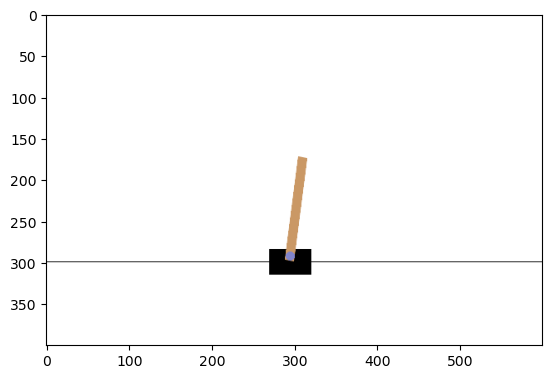

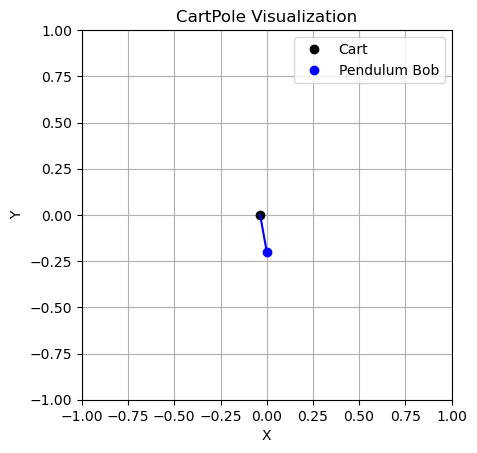


STEP:  8
CART POSITION:  -0.058136784
CART VELOCITY:  -1.3242643
POLE ANGLE WRT CART:  0.15989418
VELOCITY AT TOP OF POLE:  2.1593294
ACTION: Push cart to left


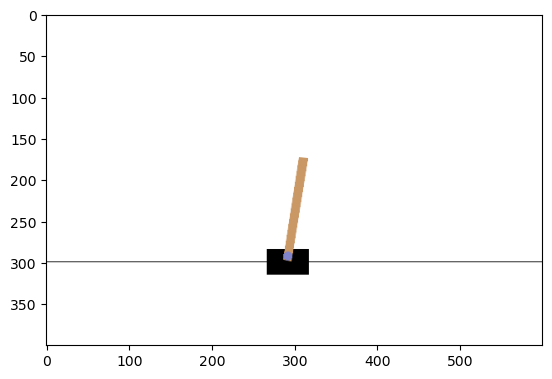

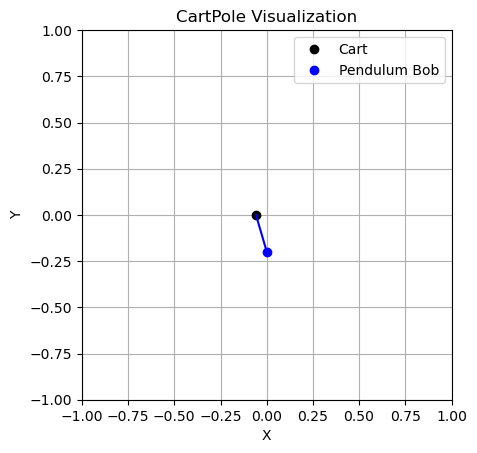


STEP:  9
CART POSITION:  -0.08462207
CART VELOCITY:  -1.5205522
POLE ANGLE WRT CART:  0.20308077
VELOCITY AT TOP OF POLE:  2.4968143
ACTION: Push cart to left


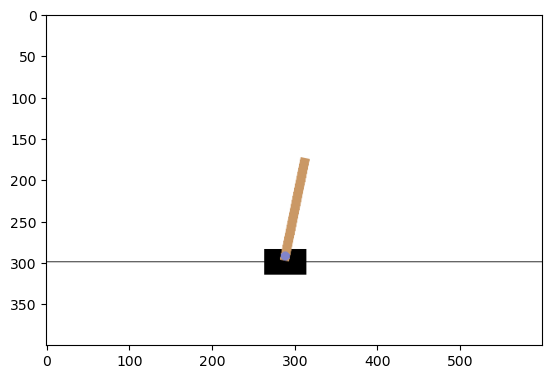

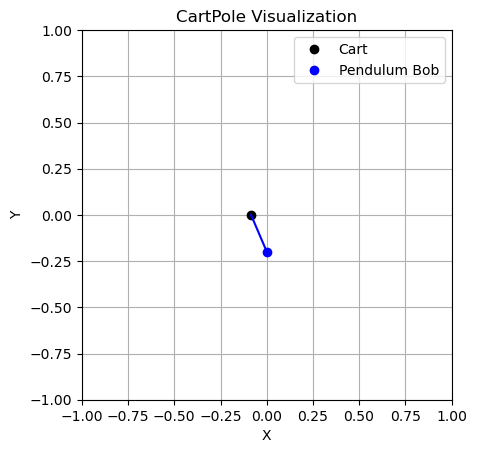


STEP:  1
CART POSITION:  0.028532965
CART VELOCITY:  0.03556832
POLE ANGLE WRT CART:  -0.027788026
VELOCITY AT TOP OF POLE:  0.03264566
ACTION: Push cart to right


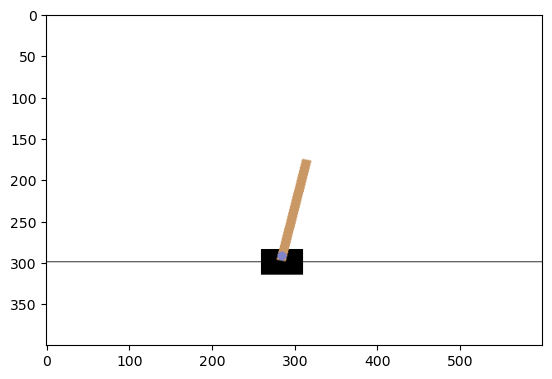

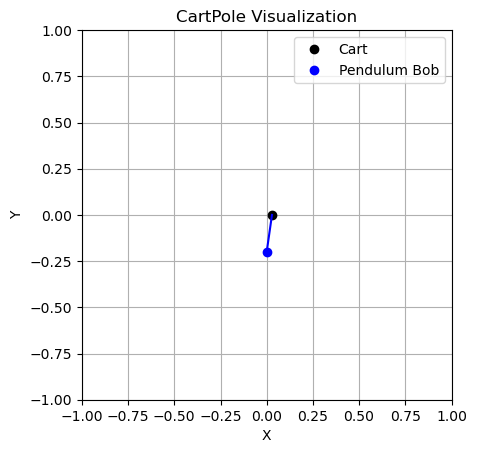


STEP:  2
CART POSITION:  0.029244332
CART VELOCITY:  0.23107752
POLE ANGLE WRT CART:  -0.027135113
VELOCITY AT TOP OF POLE:  -0.26867354
ACTION: Push cart to right


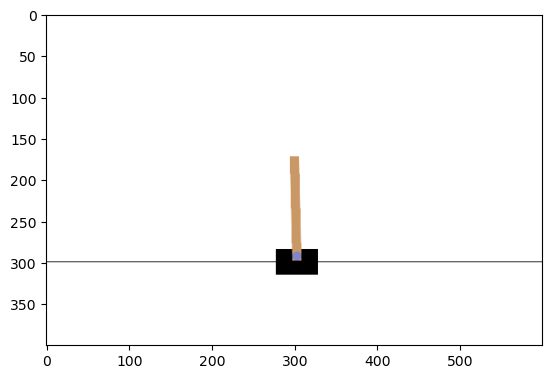

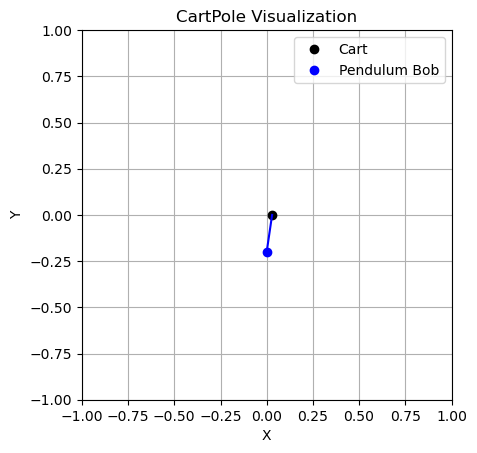


STEP:  3
CART POSITION:  0.03386588
CART VELOCITY:  0.426576
POLE ANGLE WRT CART:  -0.032508586
VELOCITY AT TOP OF POLE:  -0.56979007
ACTION: Push cart to right


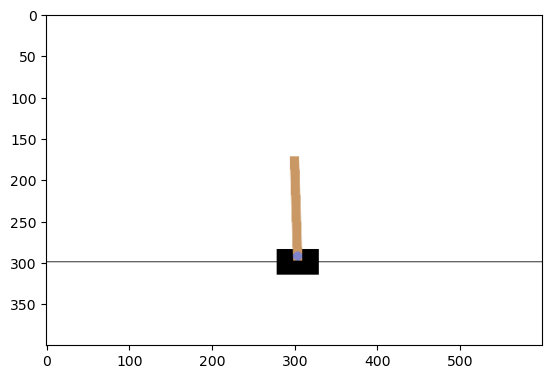

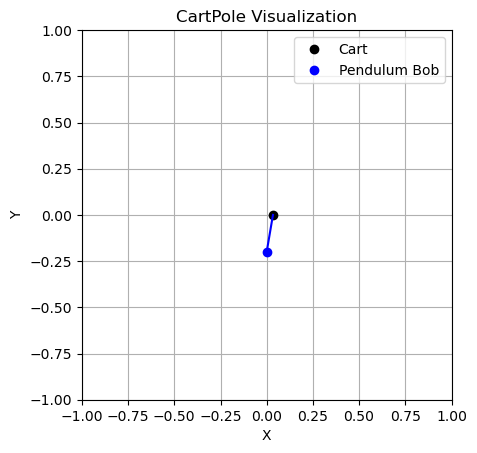


STEP:  4
CART POSITION:  0.042397402
CART VELOCITY:  0.62213844
POLE ANGLE WRT CART:  -0.043904386
VELOCITY AT TOP OF POLE:  -0.8725345
ACTION: Push cart to right


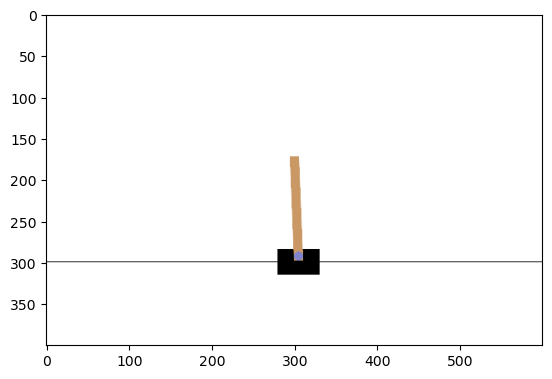

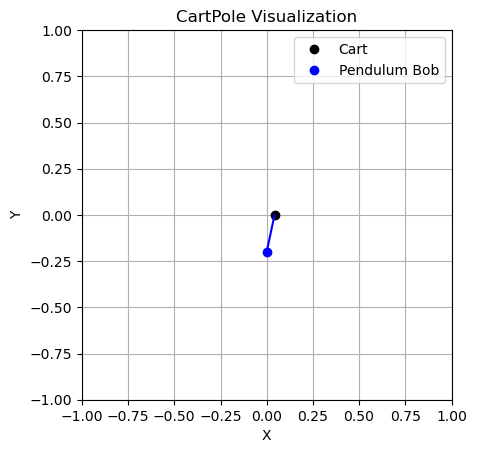


STEP:  5
CART POSITION:  0.05484017
CART VELOCITY:  0.817829
POLE ANGLE WRT CART:  -0.061355077
VELOCITY AT TOP OF POLE:  -1.1786914
ACTION: Push cart to right


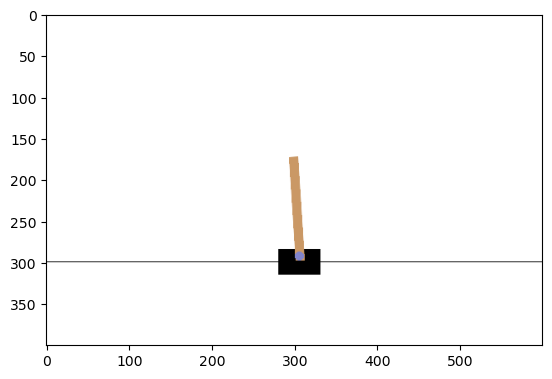

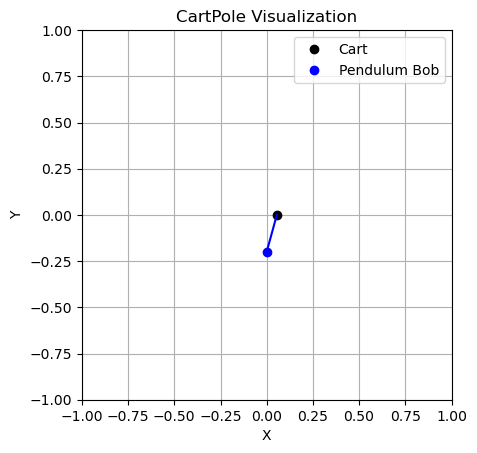


STEP:  6
CART POSITION:  0.07119675
CART VELOCITY:  1.0136917
POLE ANGLE WRT CART:  -0.0849289
VELOCITY AT TOP OF POLE:  -1.4899596
ACTION: Push cart to right


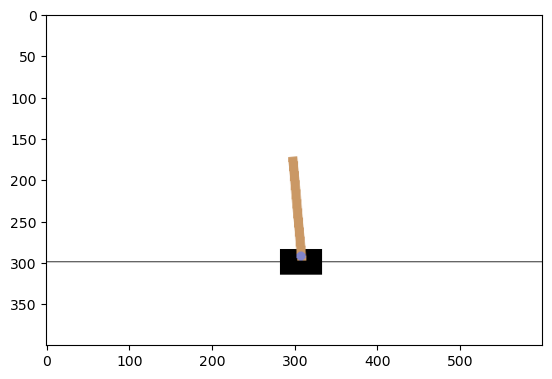

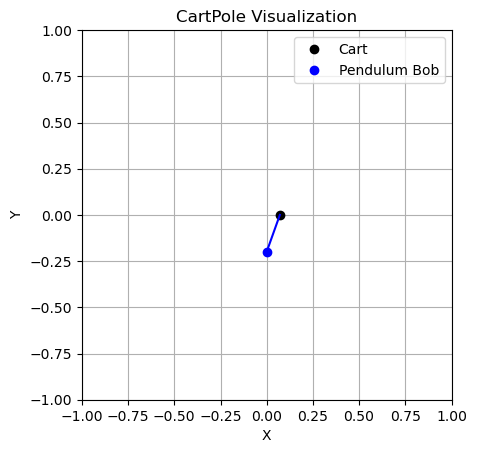


STEP:  7
CART POSITION:  0.091470584
CART VELOCITY:  1.2097389
POLE ANGLE WRT CART:  -0.11472809
VELOCITY AT TOP OF POLE:  -1.8079095
ACTION: Push cart to right


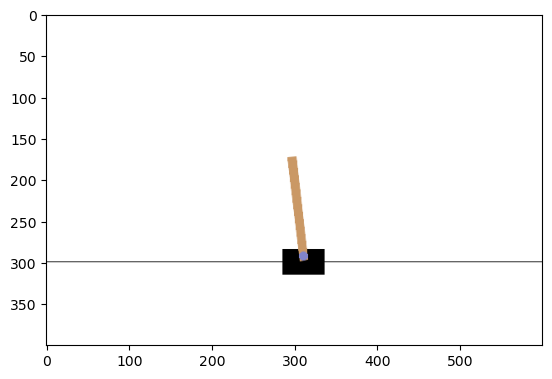

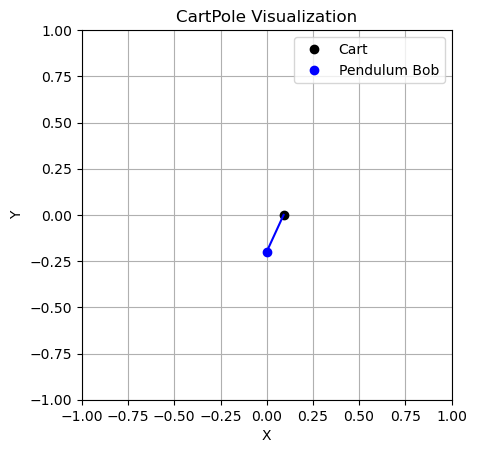


STEP:  8
CART POSITION:  0.11566536
CART VELOCITY:  1.4059386
POLE ANGLE WRT CART:  -0.15088628
VELOCITY AT TOP OF POLE:  -2.1339304
ACTION: Push cart to right


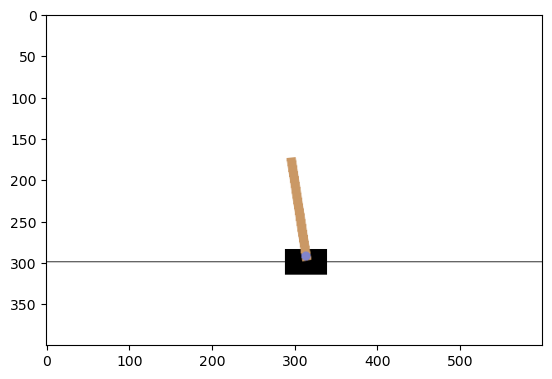

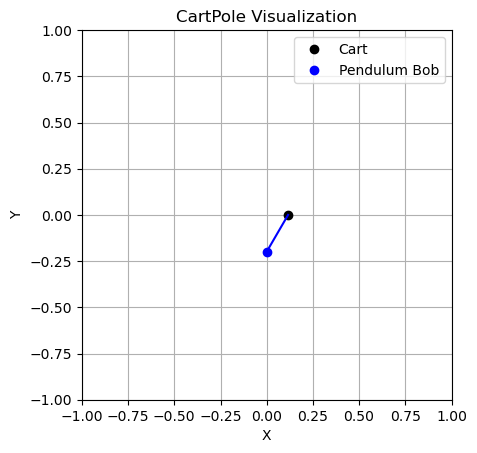


STEP:  9
CART POSITION:  0.14378414
CART VELOCITY:  1.6021996
POLE ANGLE WRT CART:  -0.19356489
VELOCITY AT TOP OF POLE:  -2.4691696
ACTION: Push cart to right


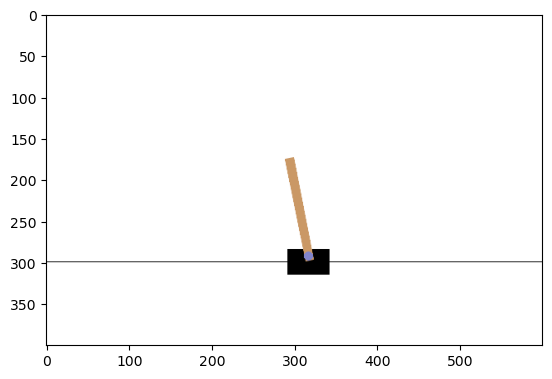

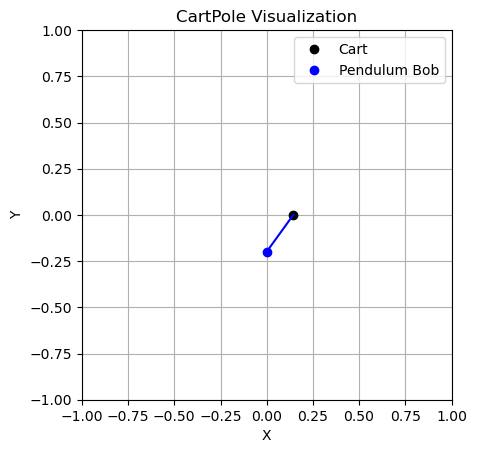


STEP:  1
CART POSITION:  0.013893538
CART VELOCITY:  -0.0047951075
POLE ANGLE WRT CART:  -0.037316114
VELOCITY AT TOP OF POLE:  0.015856449
ACTION: Push cart to right


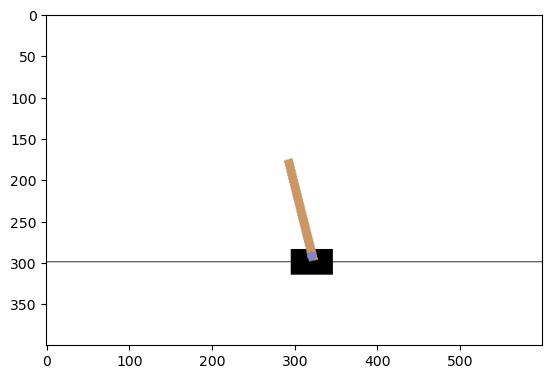

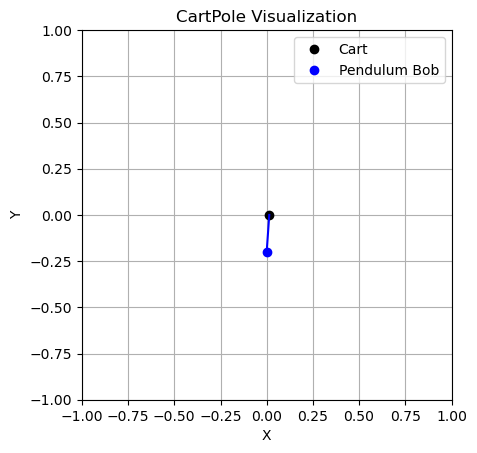


STEP:  2
CART POSITION:  0.013797635
CART VELOCITY:  0.19084159
POLE ANGLE WRT CART:  -0.036998983
VELOCITY AT TOP OF POLE:  -0.28836268
ACTION: Push cart to right


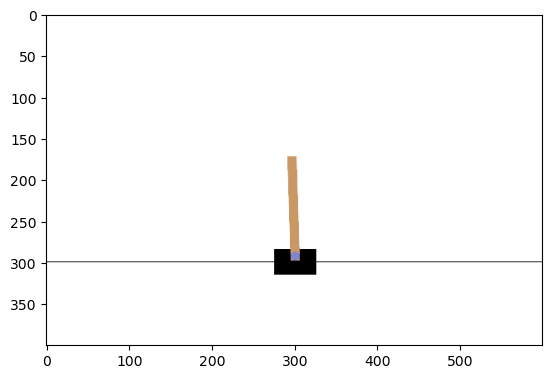

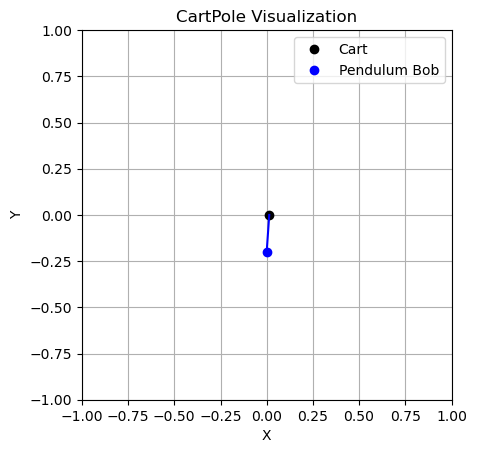


STEP:  3
CART POSITION:  0.017614467
CART VELOCITY:  0.3864711
POLE ANGLE WRT CART:  -0.042766236
VELOCITY AT TOP OF POLE:  -0.5924813
ACTION: Push cart to left


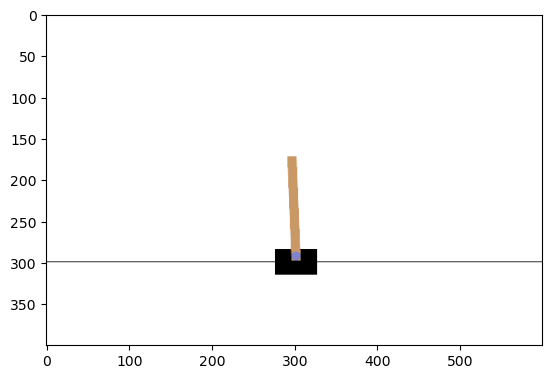

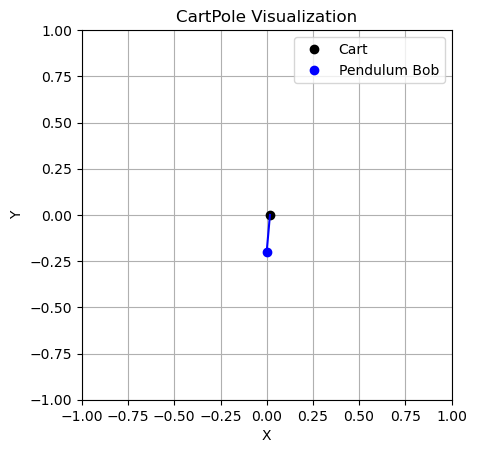


STEP:  4
CART POSITION:  0.02534389
CART VELOCITY:  0.19197309
POLE ANGLE WRT CART:  -0.054615863
VELOCITY AT TOP OF POLE:  -0.31357053
ACTION: Push cart to right


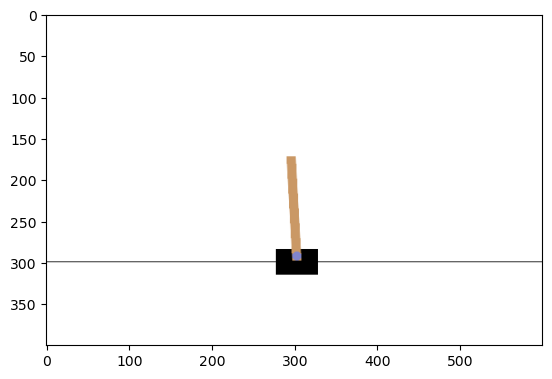

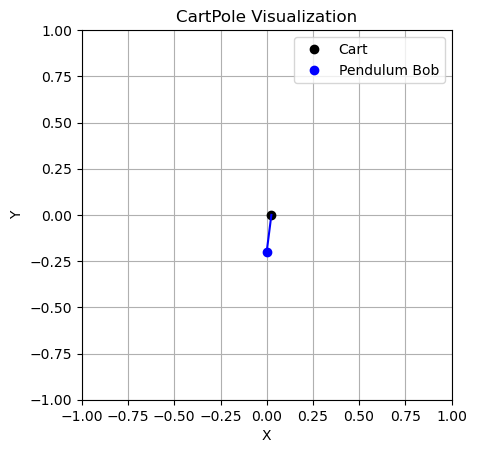


STEP:  5
CART POSITION:  0.02918335
CART VELOCITY:  0.3878288
POLE ANGLE WRT CART:  -0.060887273
VELOCITY AT TOP OF POLE:  -0.62296516
ACTION: Push cart to right


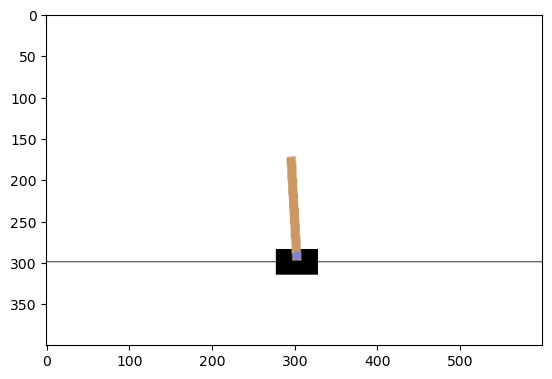

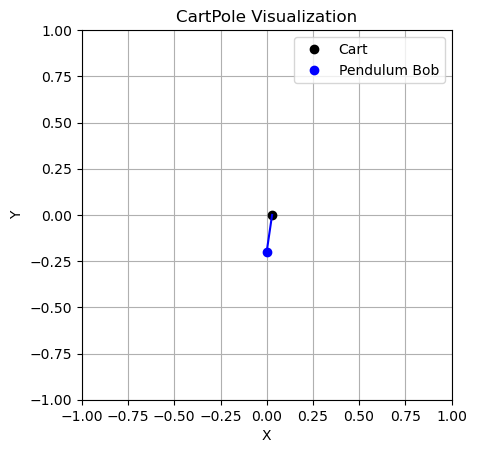


STEP:  6
CART POSITION:  0.036939926
CART VELOCITY:  0.5837457
POLE ANGLE WRT CART:  -0.07334658
VELOCITY AT TOP OF POLE:  -0.9341857
ACTION: Push cart to right


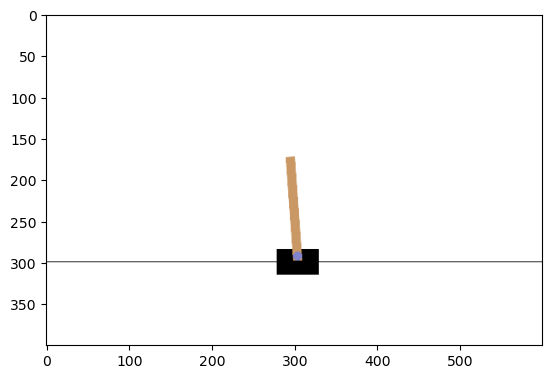

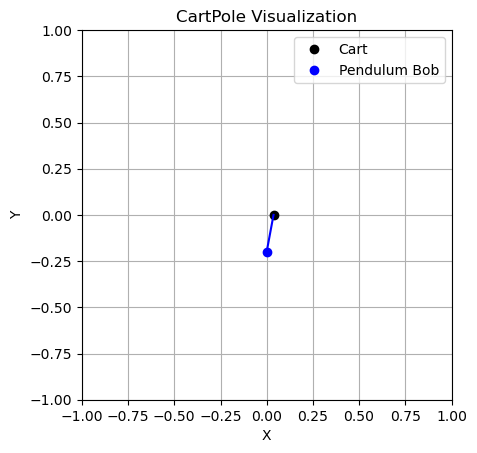


STEP:  7
CART POSITION:  0.04861484
CART VELOCITY:  0.77977633
POLE ANGLE WRT CART:  -0.092030294
VELOCITY AT TOP OF POLE:  -1.2489856
ACTION: Push cart to right


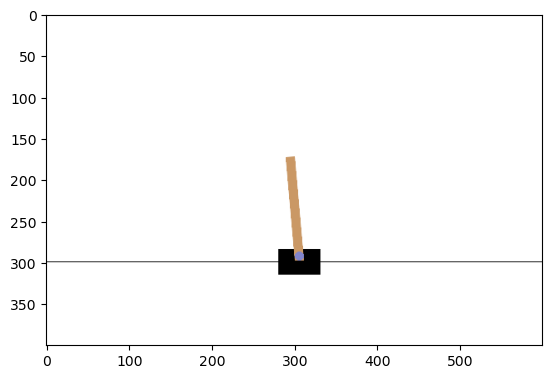

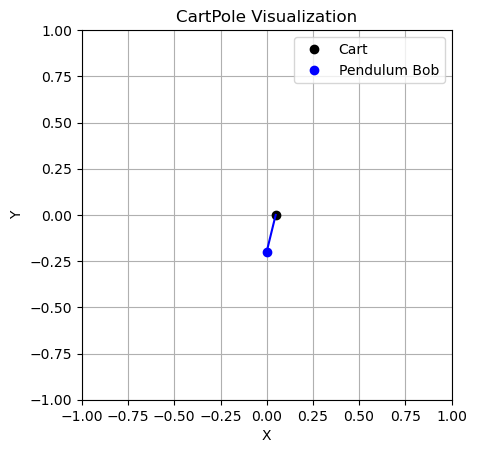


STEP:  8
CART POSITION:  0.06421037
CART VELOCITY:  0.97594965
POLE ANGLE WRT CART:  -0.117010005
VELOCITY AT TOP OF POLE:  -1.5690191
ACTION: Push cart to right


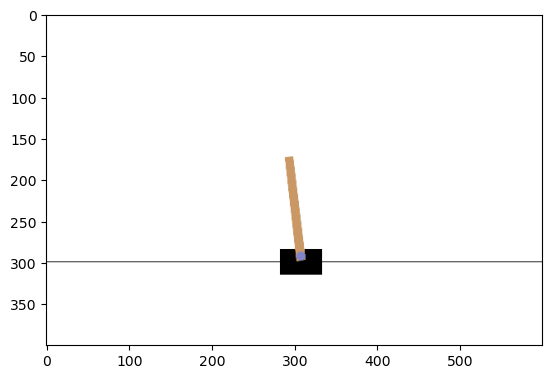

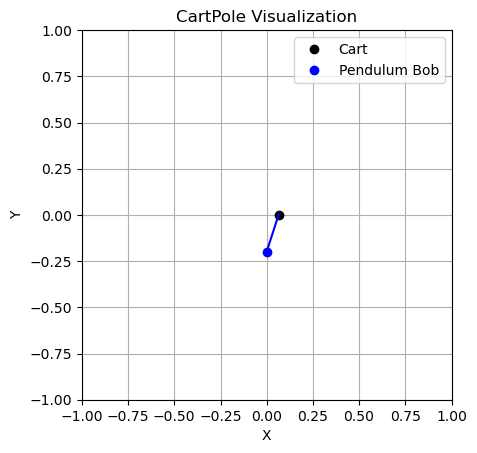


STEP:  9
CART POSITION:  0.08372936
CART VELOCITY:  1.1722583
POLE ANGLE WRT CART:  -0.14839038
VELOCITY AT TOP OF POLE:  -1.8957909
ACTION: Push cart to right


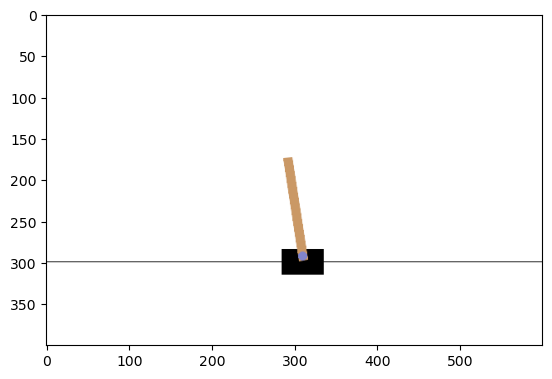

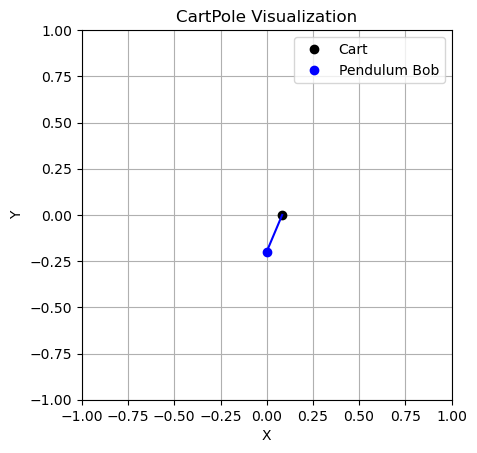


STEP:  10
CART POSITION:  0.10717452
CART VELOCITY:  1.3686447
POLE ANGLE WRT CART:  -0.18630621
VELOCITY AT TOP OF POLE:  -2.2306
ACTION: Push cart to right


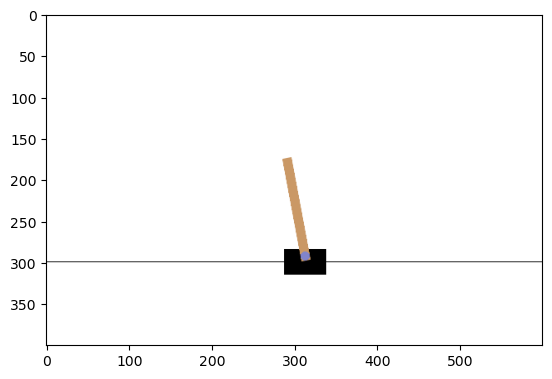

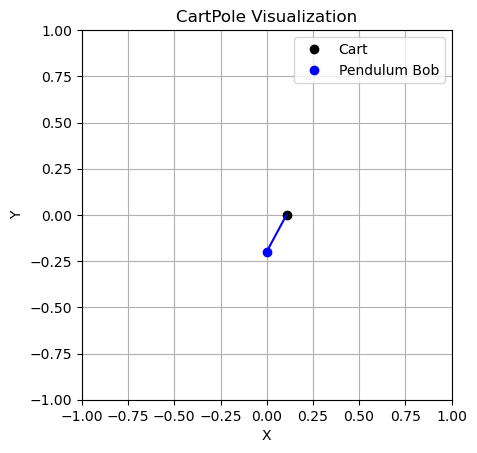


STEP:  1
CART POSITION:  0.03156571
CART VELOCITY:  -0.045080695
POLE ANGLE WRT CART:  0.016553637
VELOCITY AT TOP OF POLE:  0.036367435
ACTION: Push cart to right


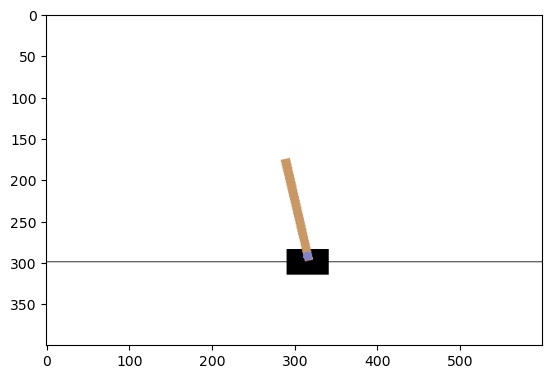

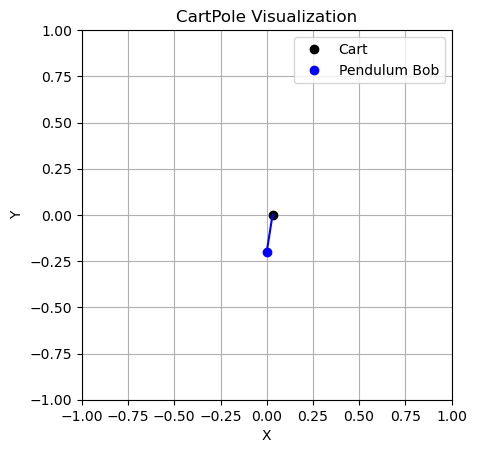


STEP:  2
CART POSITION:  0.030664098
CART VELOCITY:  0.14980002
POLE ANGLE WRT CART:  0.017280987
VELOCITY AT TOP OF POLE:  -0.25104702
ACTION: Push cart to left


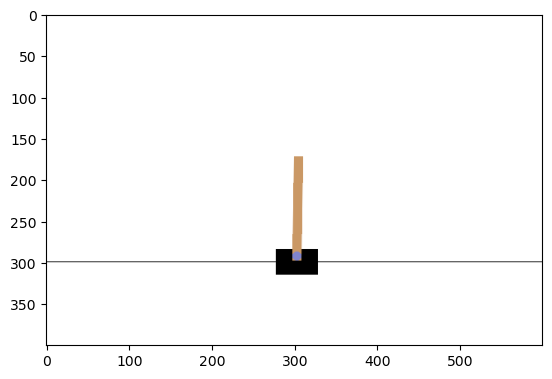

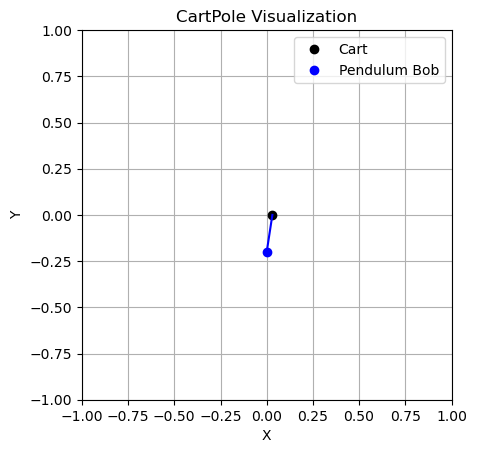


STEP:  3
CART POSITION:  0.0336601
CART VELOCITY:  -0.045564394
POLE ANGLE WRT CART:  0.012260046
VELOCITY AT TOP OF POLE:  0.047036186
ACTION: Push cart to left


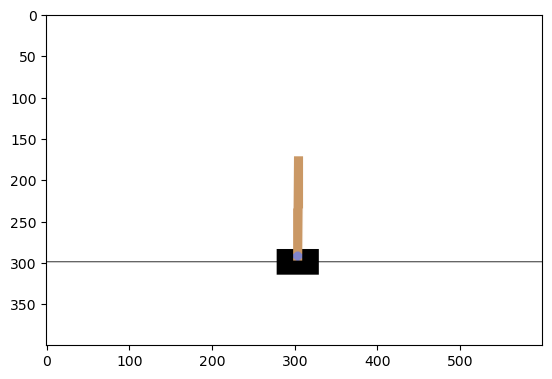

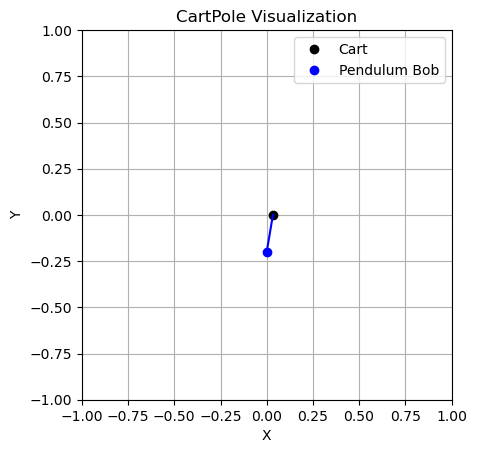


STEP:  4
CART POSITION:  0.03274881
CART VELOCITY:  -0.24085999
POLE ANGLE WRT CART:  0.013200769
VELOCITY AT TOP OF POLE:  0.34356192
ACTION: Push cart to left


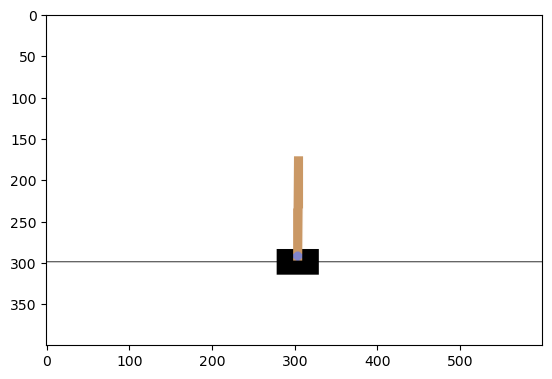

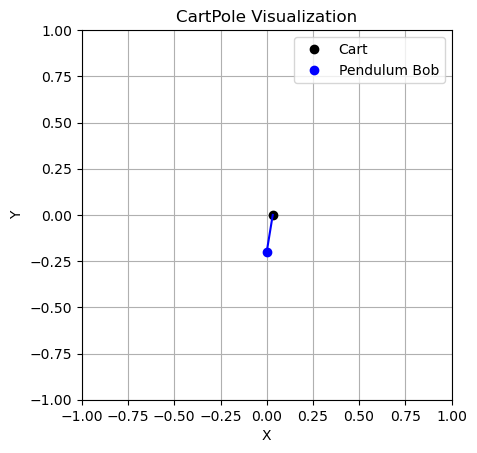


STEP:  5
CART POSITION:  0.02793161
CART VELOCITY:  -0.4361672
POLE ANGLE WRT CART:  0.020072008
VELOCITY AT TOP OF POLE:  0.6403782
ACTION: Push cart to left


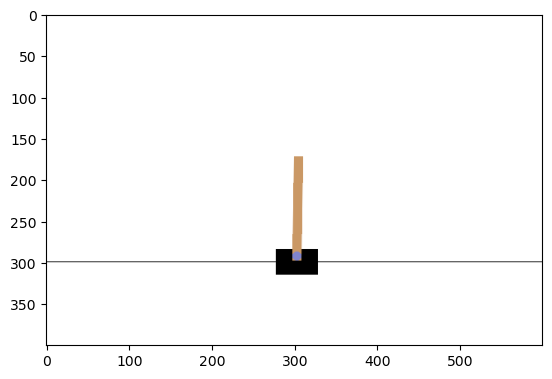

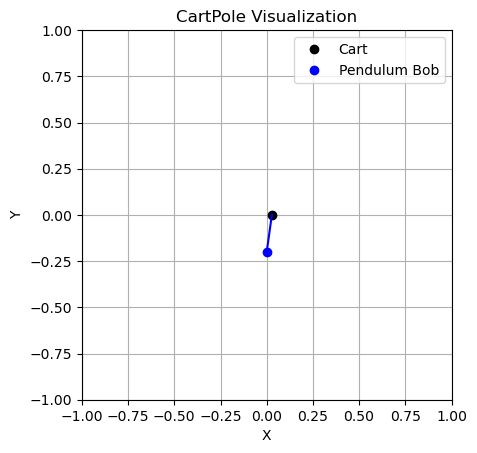


STEP:  6
CART POSITION:  0.019208265
CART VELOCITY:  -0.6315632
POLE ANGLE WRT CART:  0.032879572
VELOCITY AT TOP OF POLE:  0.9393138
ACTION: Push cart to left


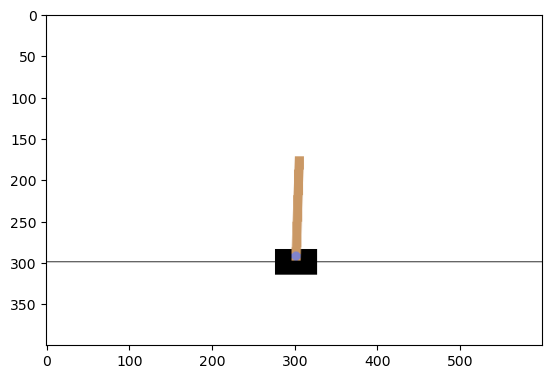

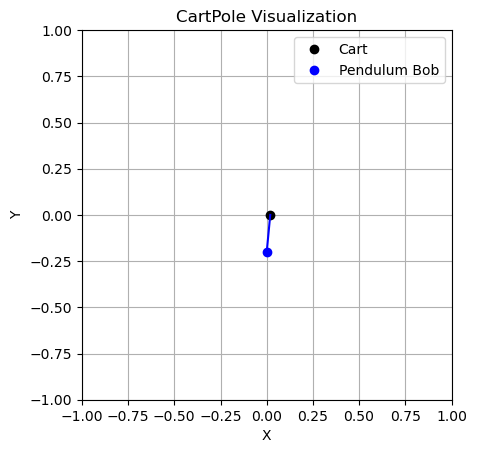


STEP:  7
CART POSITION:  0.0065770024
CART VELOCITY:  -0.82711256
POLE ANGLE WRT CART:  0.051665846
VELOCITY AT TOP OF POLE:  1.2421442
ACTION: Push cart to left


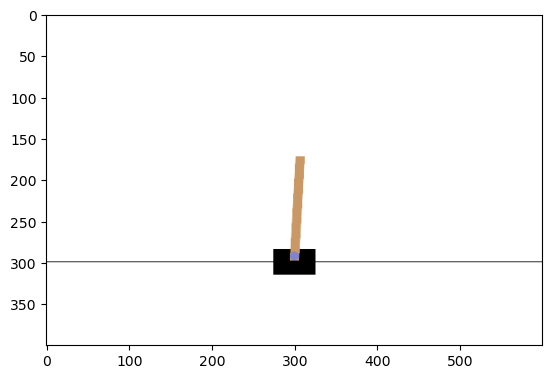

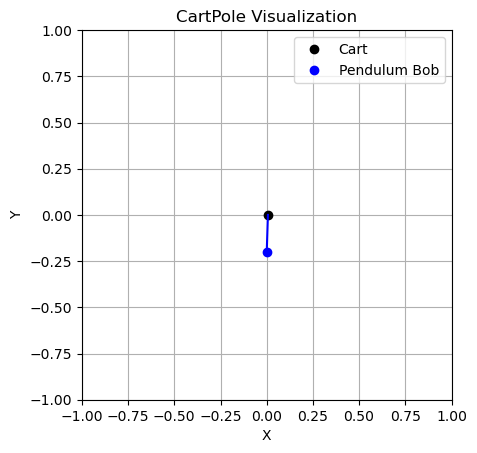


STEP:  8
CART POSITION:  -0.009965248
CART VELOCITY:  -1.0228583
POLE ANGLE WRT CART:  0.07650873
VELOCITY AT TOP OF POLE:  1.5505539
ACTION: Push cart to left


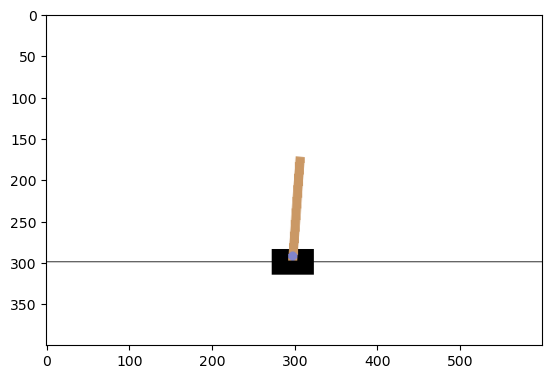

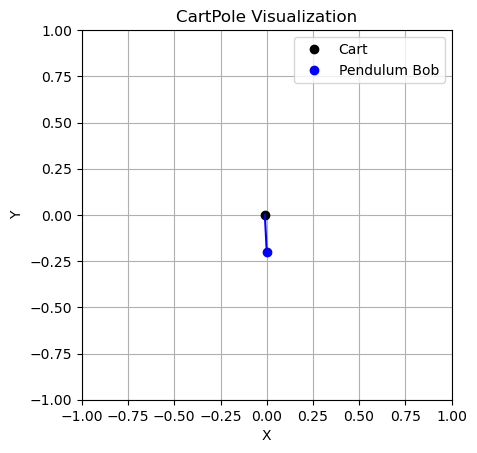


STEP:  9
CART POSITION:  -0.030422414
CART VELOCITY:  -1.2188101
POLE ANGLE WRT CART:  0.10751981
VELOCITY AT TOP OF POLE:  1.8660935
ACTION: Push cart to left


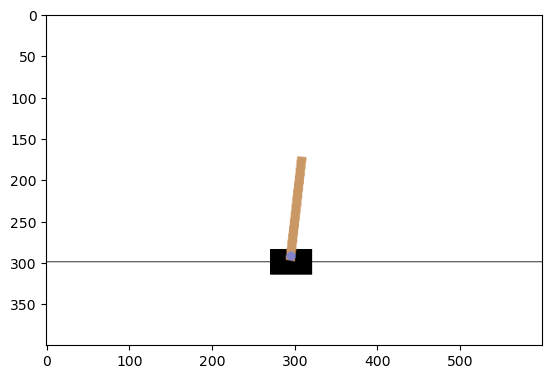

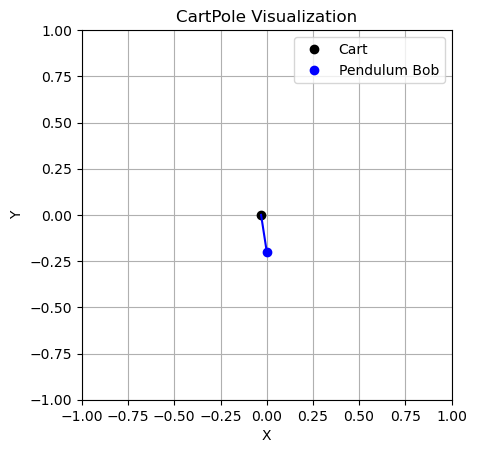


STEP:  10
CART POSITION:  -0.054798614
CART VELOCITY:  -1.4149324
POLE ANGLE WRT CART:  0.14484169
VELOCITY AT TOP OF POLE:  2.190128
ACTION: Push cart to left


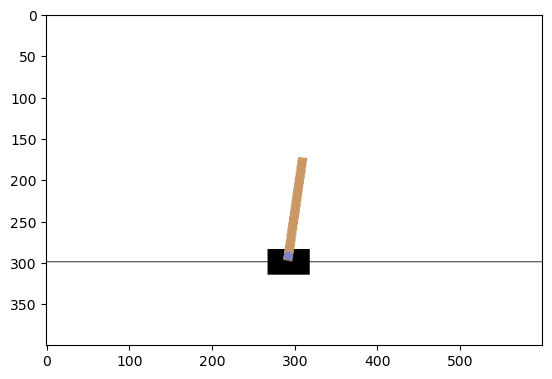

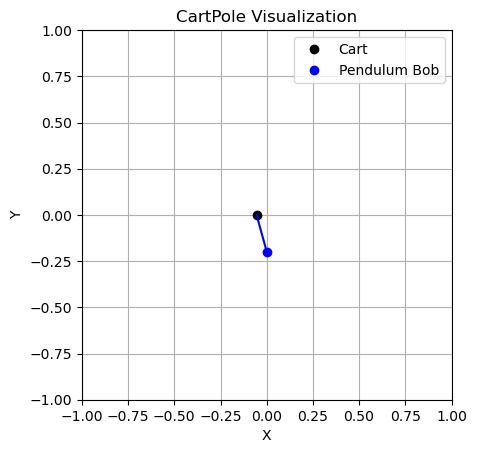


STEP:  11
CART POSITION:  -0.083097264
CART VELOCITY:  -1.6111281
POLE ANGLE WRT CART:  0.18864425
VELOCITY AT TOP OF POLE:  2.5237746
ACTION: Push cart to left


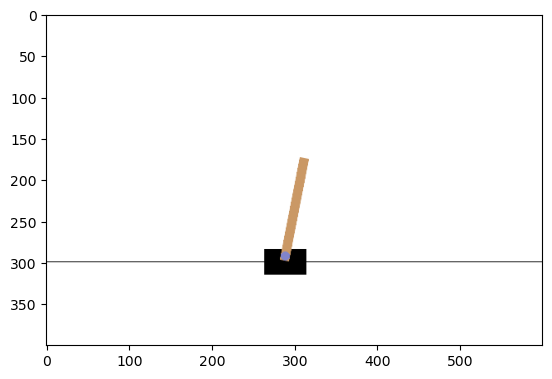

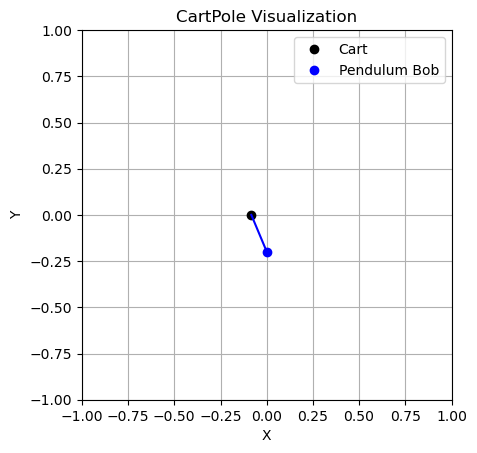


STEP:  1
CART POSITION:  -0.014872427
CART VELOCITY:  -0.03528734
POLE ANGLE WRT CART:  -0.030975573
VELOCITY AT TOP OF POLE:  0.00051843136
ACTION: Push cart to right


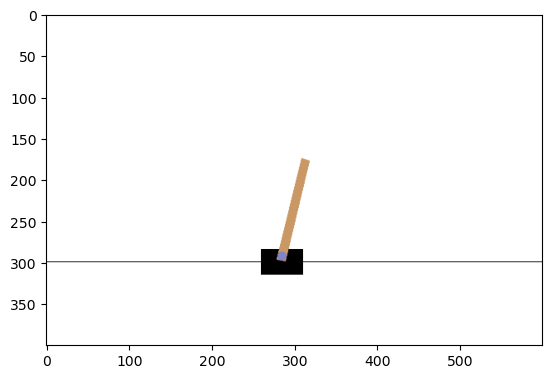

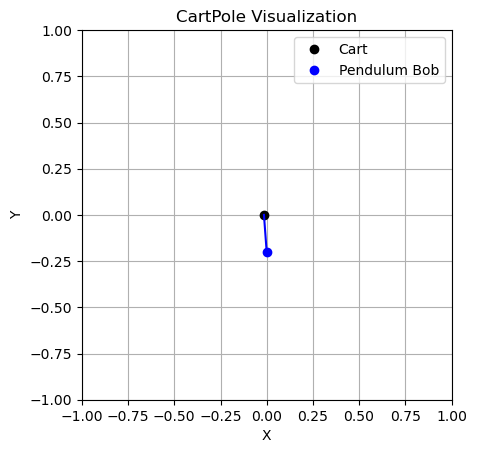


STEP:  2
CART POSITION:  -0.015578174
CART VELOCITY:  0.16026483
POLE ANGLE WRT CART:  -0.030965205
VELOCITY AT TOP OF POLE:  -0.30177447
ACTION: Push cart to right


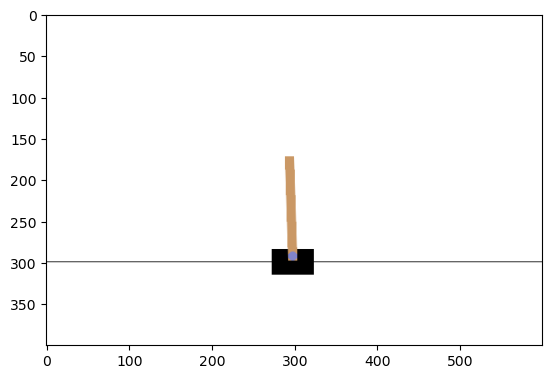

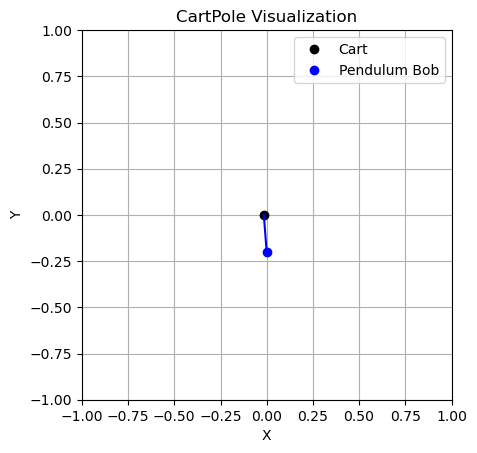


STEP:  3
CART POSITION:  -0.012372877
CART VELOCITY:  0.35581413
POLE ANGLE WRT CART:  -0.037000693
VELOCITY AT TOP OF POLE:  -0.6040601
ACTION: Push cart to right


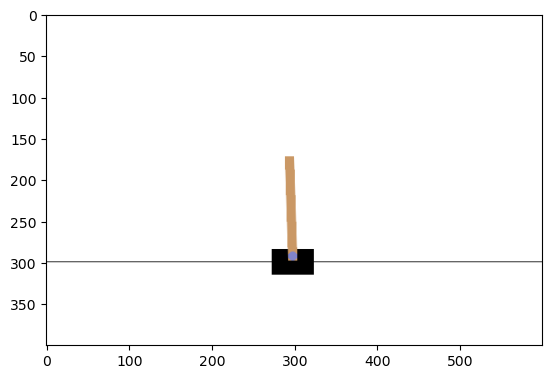

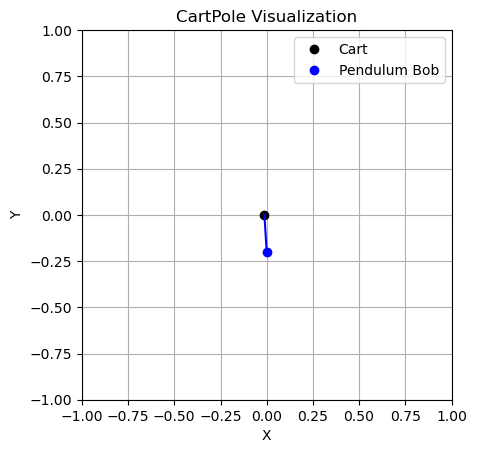


STEP:  4
CART POSITION:  -0.0052565946
CART VELOCITY:  0.5514335
POLE ANGLE WRT CART:  -0.049081896
VELOCITY AT TOP OF POLE:  -0.908164
ACTION: Push cart to right


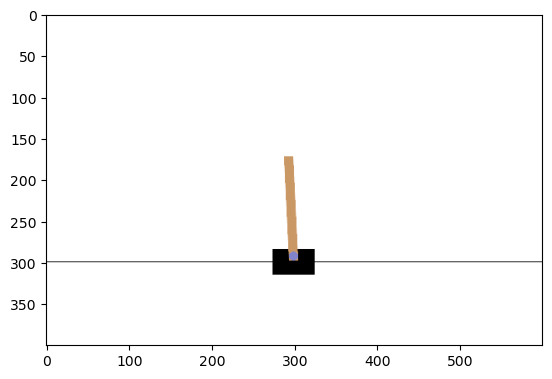

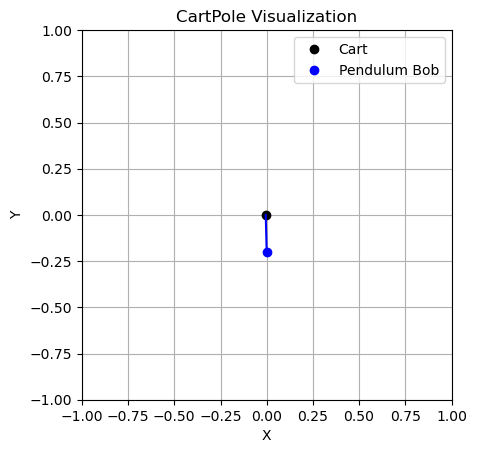


STEP:  5
CART POSITION:  0.0057720747
CART VELOCITY:  0.7471843
POLE ANGLE WRT CART:  -0.06724518
VELOCITY AT TOP OF POLE:  -1.2158608
ACTION: Push cart to right


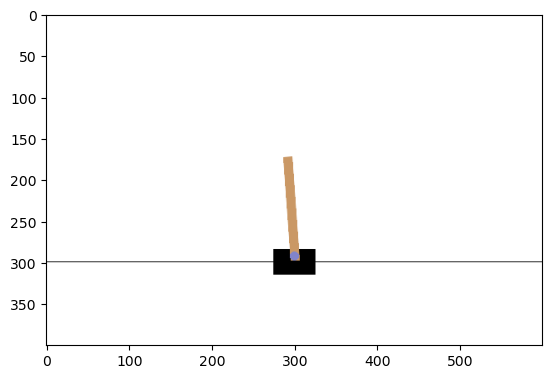

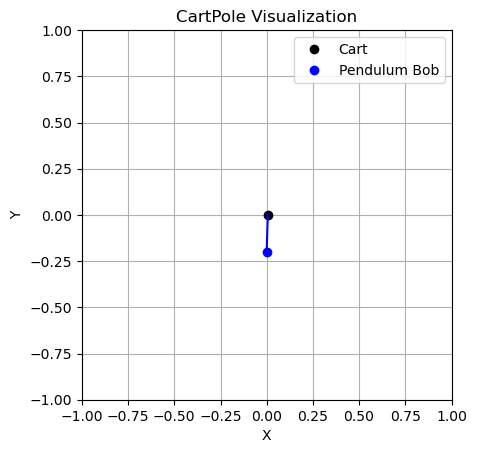


STEP:  6
CART POSITION:  0.02071576
CART VELOCITY:  0.94310606
POLE ANGLE WRT CART:  -0.0915624
VELOCITY AT TOP OF POLE:  -1.5288346
ACTION: Push cart to right


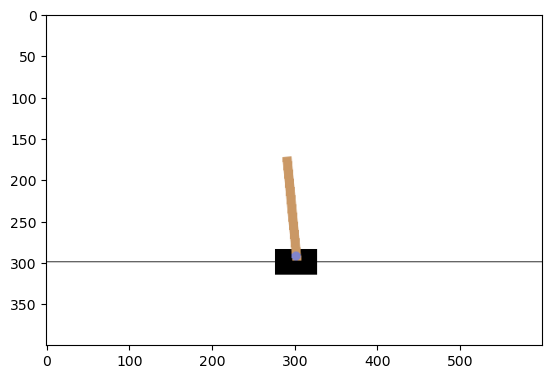

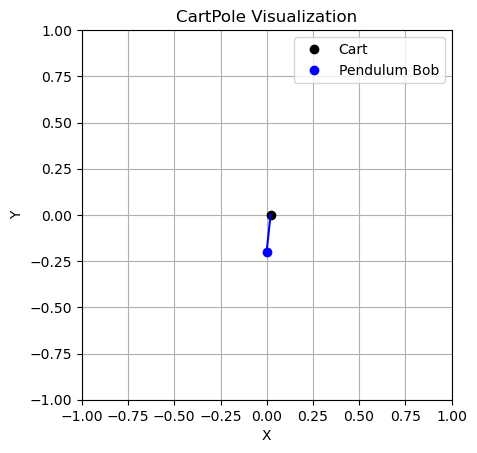


STEP:  7
CART POSITION:  0.03957788
CART VELOCITY:  1.1392053
POLE ANGLE WRT CART:  -0.12213909
VELOCITY AT TOP OF POLE:  -1.848633
ACTION: Push cart to right


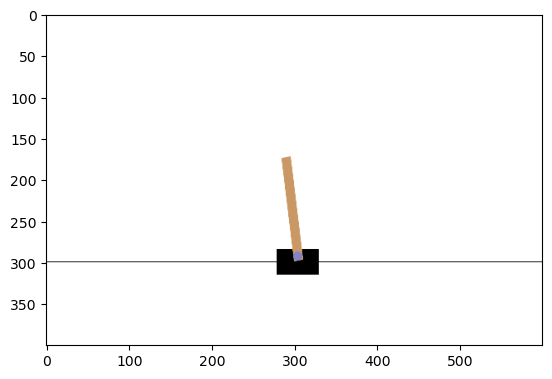

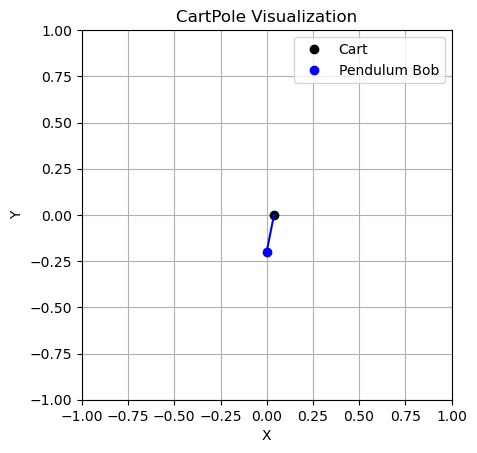


STEP:  8
CART POSITION:  0.06236199
CART VELOCITY:  1.3354422
POLE ANGLE WRT CART:  -0.15911175
VELOCITY AT TOP OF POLE:  -2.1766152
ACTION: Push cart to right


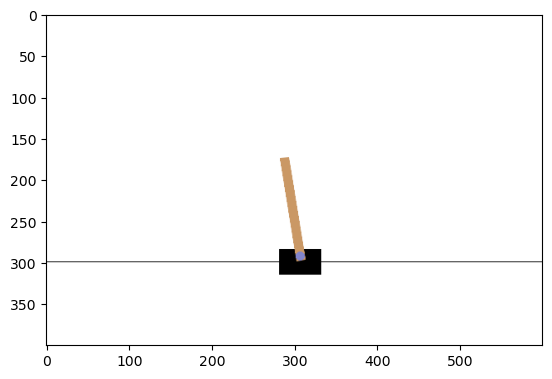

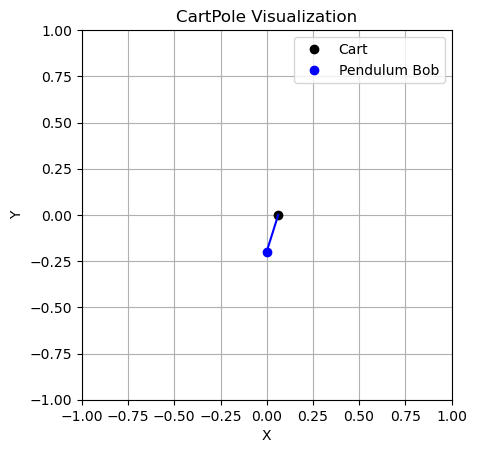


STEP:  9
CART POSITION:  0.089070834
CART VELOCITY:  1.5317149
POLE ANGLE WRT CART:  -0.20264405
VELOCITY AT TOP OF POLE:  -2.5138872
ACTION: Push cart to right


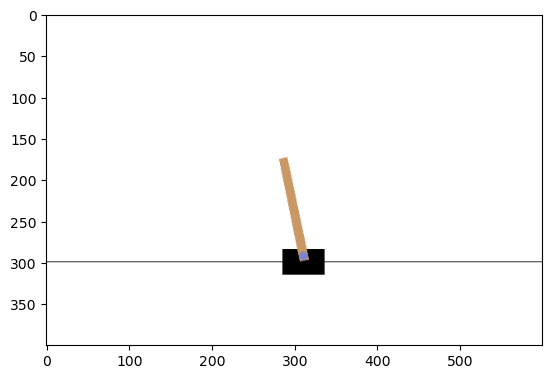

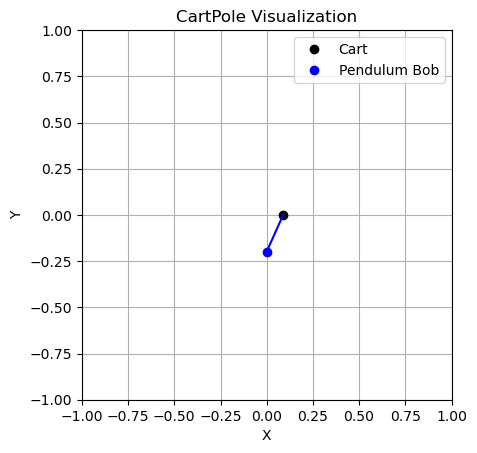


STEP:  1
CART POSITION:  0.015646923
CART VELOCITY:  0.03888661
POLE ANGLE WRT CART:  -0.00632235
VELOCITY AT TOP OF POLE:  -0.030432085
ACTION: Push cart to left


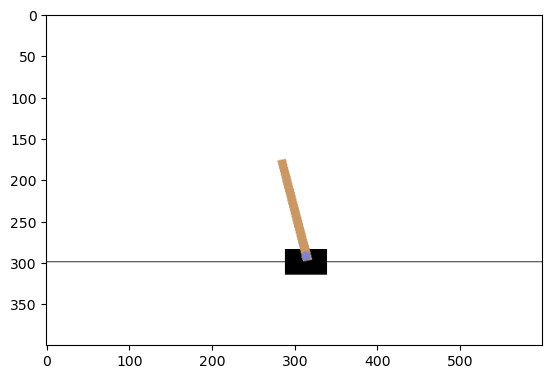

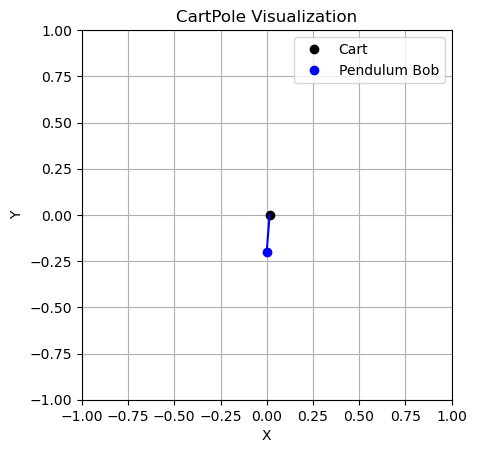


STEP:  2
CART POSITION:  0.016424656
CART VELOCITY:  -0.15614411
POLE ANGLE WRT CART:  -0.0069309915
VELOCITY AT TOP OF POLE:  0.26024938
ACTION: Push cart to left


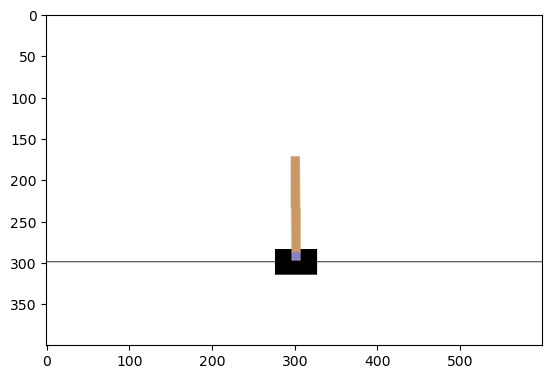

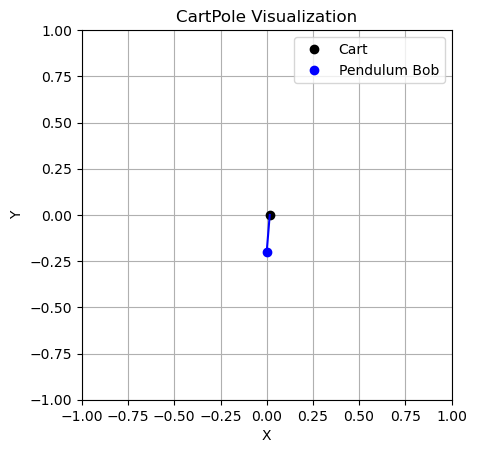


STEP:  3
CART POSITION:  0.013301774
CART VELOCITY:  -0.35116643
POLE ANGLE WRT CART:  -0.001726004
VELOCITY AT TOP OF POLE:  0.55073816
ACTION: Push cart to left


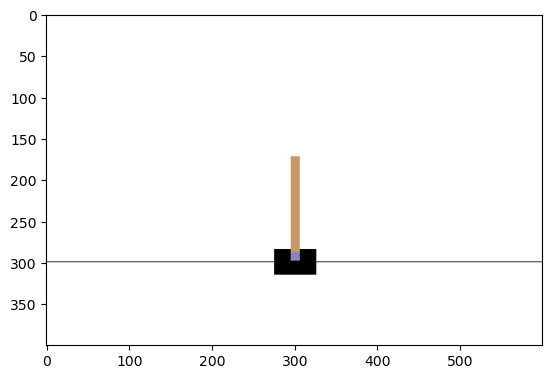

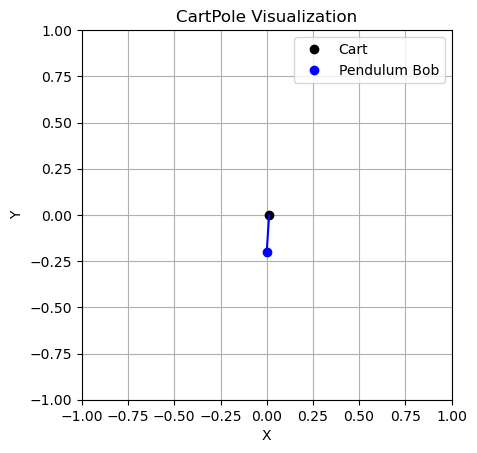


STEP:  4
CART POSITION:  0.006278445
CART VELOCITY:  -0.5462641
POLE ANGLE WRT CART:  0.009288759
VELOCITY AT TOP OF POLE:  0.8428768
ACTION: Push cart to left


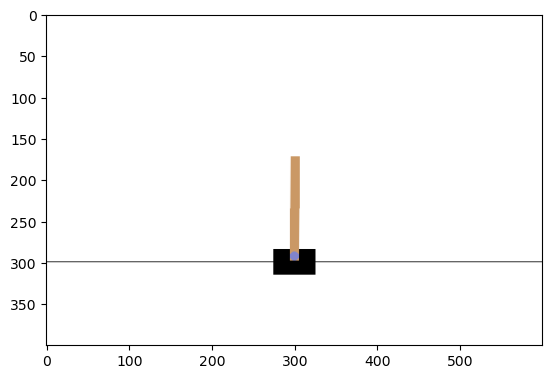

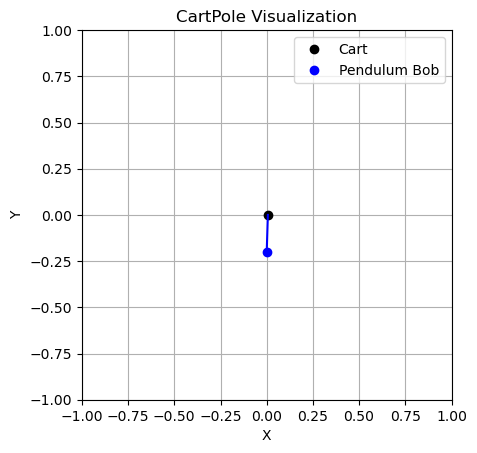


STEP:  5
CART POSITION:  -0.004646837
CART VELOCITY:  -0.7415116
POLE ANGLE WRT CART:  0.026146295
VELOCITY AT TOP OF POLE:  1.1384662
ACTION: Push cart to left


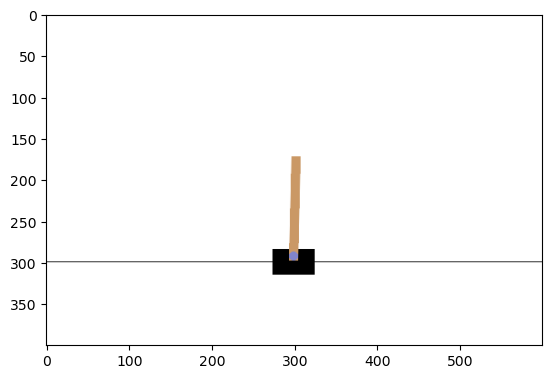

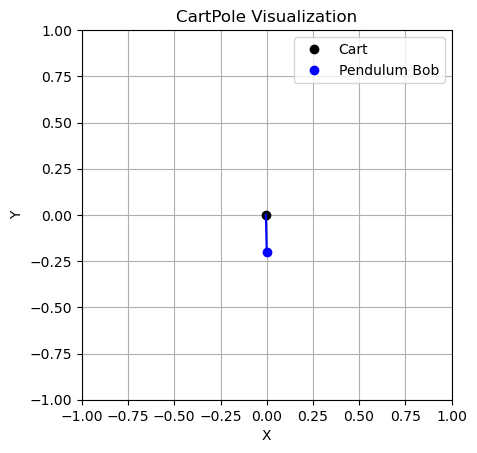


STEP:  6
CART POSITION:  -0.01947707
CART VELOCITY:  -0.9369655
POLE ANGLE WRT CART:  0.048915617
VELOCITY AT TOP OF POLE:  1.4392331
ACTION: Push cart to left


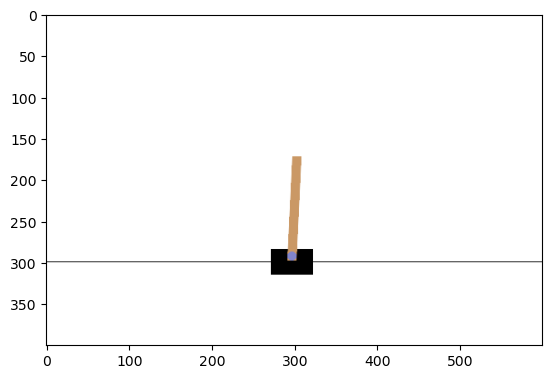

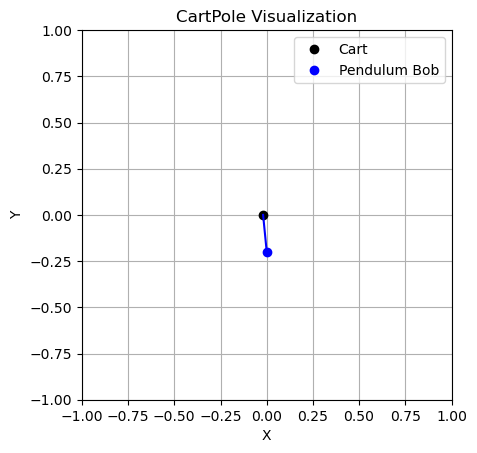


STEP:  7
CART POSITION:  -0.03821638
CART VELOCITY:  -1.1326548
POLE ANGLE WRT CART:  0.07770028
VELOCITY AT TOP OF POLE:  1.7467914
ACTION: Push cart to left


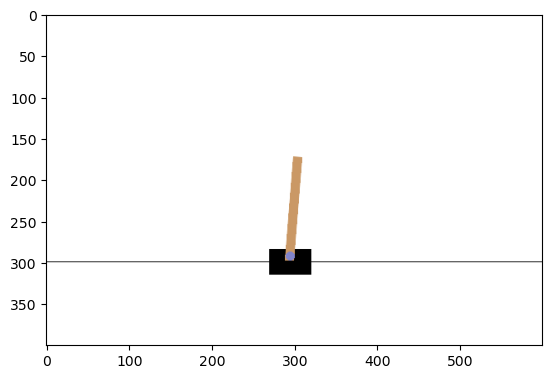

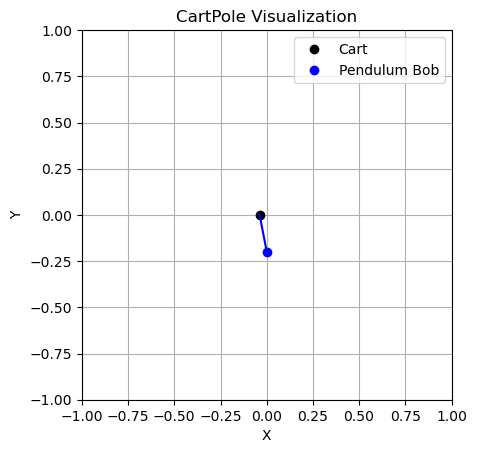


STEP:  8
CART POSITION:  -0.060869474
CART VELOCITY:  -1.3285692
POLE ANGLE WRT CART:  0.112636104
VELOCITY AT TOP OF POLE:  2.062597
ACTION: Push cart to left


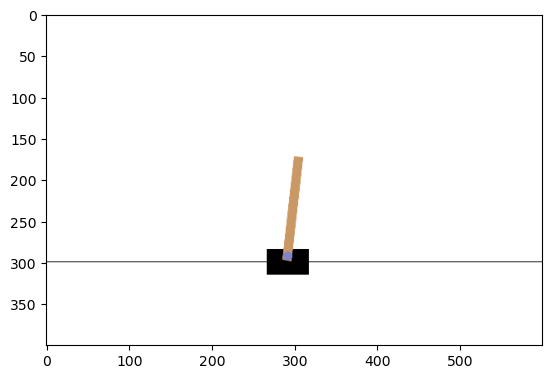

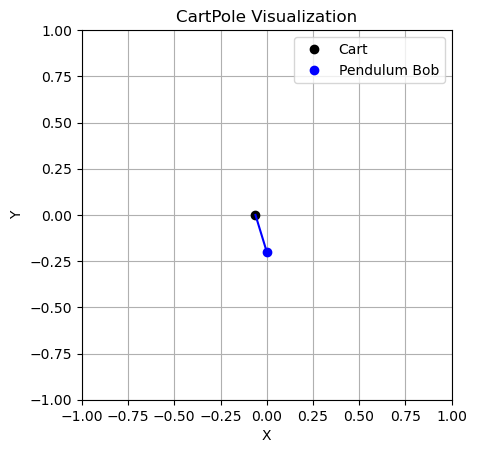


STEP:  9
CART POSITION:  -0.087440856
CART VELOCITY:  -1.5246451
POLE ANGLE WRT CART:  0.15388805
VELOCITY AT TOP OF POLE:  2.3878922
ACTION: Push cart to left


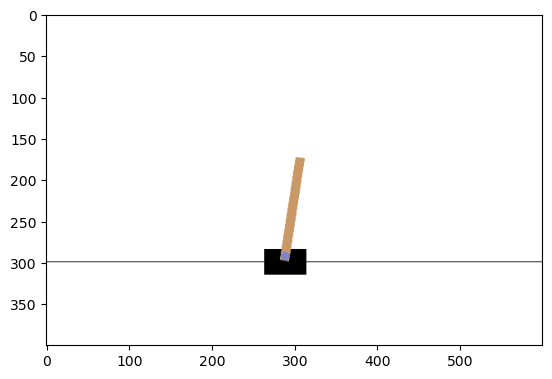

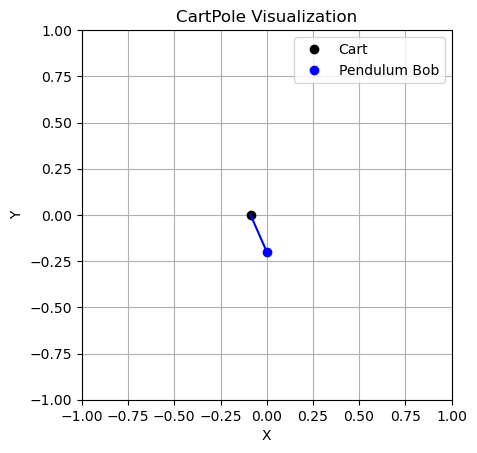


STEP:  10
CART POSITION:  -0.11793376
CART VELOCITY:  -1.7207495
POLE ANGLE WRT CART:  0.2016459
VELOCITY AT TOP OF POLE:  2.7236376
ACTION: Push cart to left


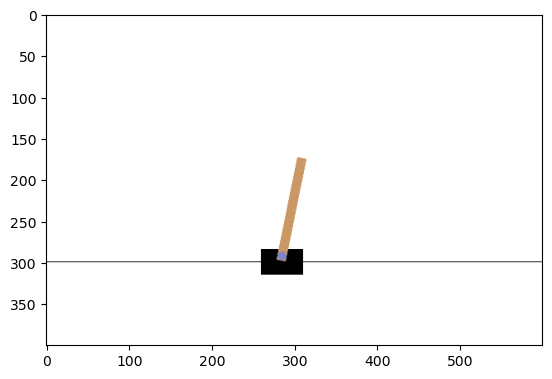

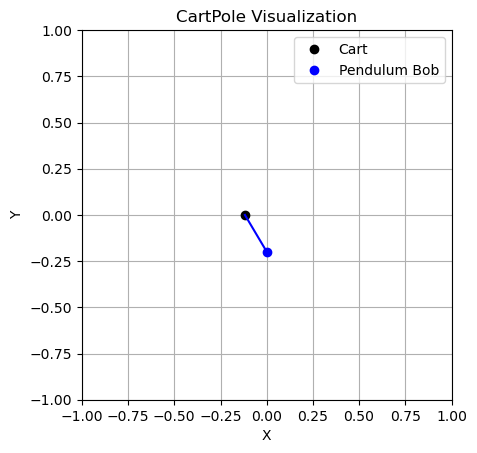


STEP:  1
CART POSITION:  0.04179714
CART VELOCITY:  -0.034185886
POLE ANGLE WRT CART:  -0.007913249
VELOCITY AT TOP OF POLE:  0.0047307857
ACTION: Push cart to left


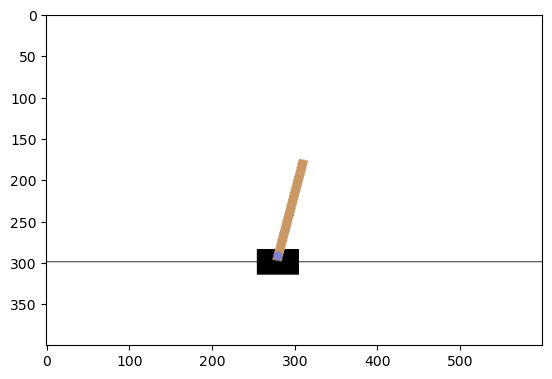

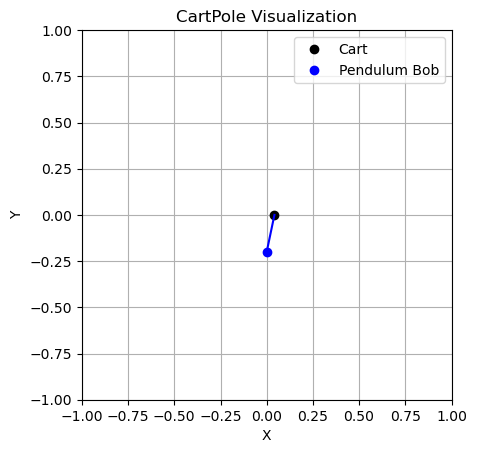


STEP:  2
CART POSITION:  0.04111342
CART VELOCITY:  -0.22919346
POLE ANGLE WRT CART:  -0.007818634
VELOCITY AT TOP OF POLE:  0.29490653
ACTION: Push cart to left


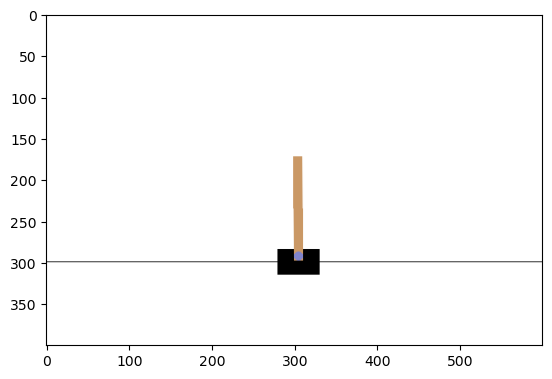

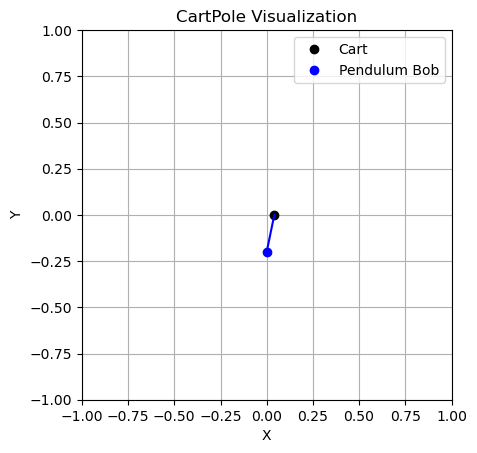


STEP:  3
CART POSITION:  0.036529552
CART VELOCITY:  -0.42420307
POLE ANGLE WRT CART:  -0.0019205029
VELOCITY AT TOP OF POLE:  0.58511335
ACTION: Push cart to left


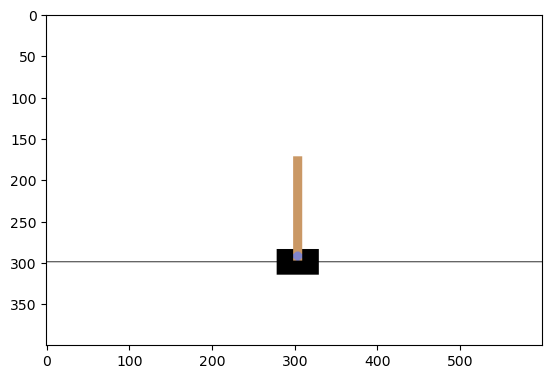

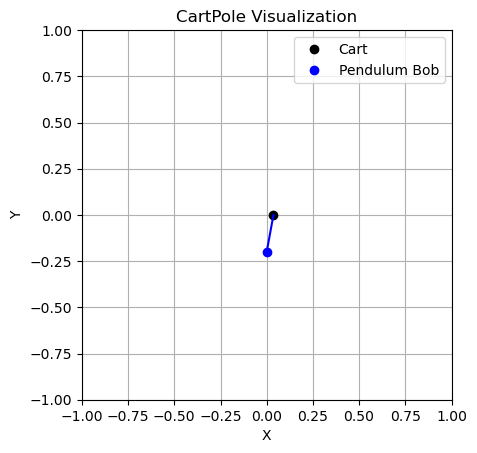


STEP:  4
CART POSITION:  0.02804549
CART VELOCITY:  -0.6192981
POLE ANGLE WRT CART:  0.009781764
VELOCITY AT TOP OF POLE:  0.87719065
ACTION: Push cart to left


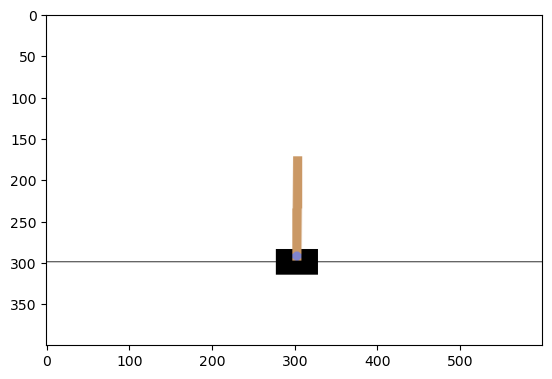

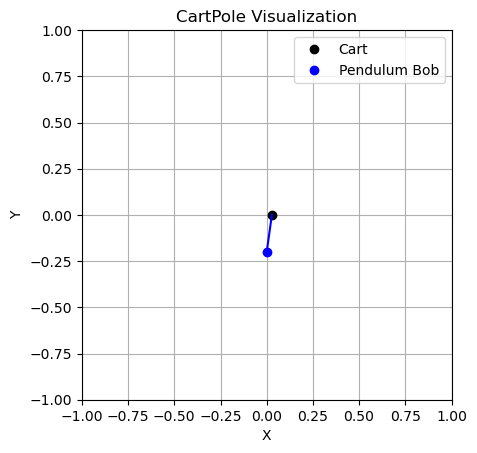


STEP:  5
CART POSITION:  0.015659528
CART VELOCITY:  -0.8145516
POLE ANGLE WRT CART:  0.027325578
VELOCITY AT TOP OF POLE:  1.1729327
ACTION: Push cart to left


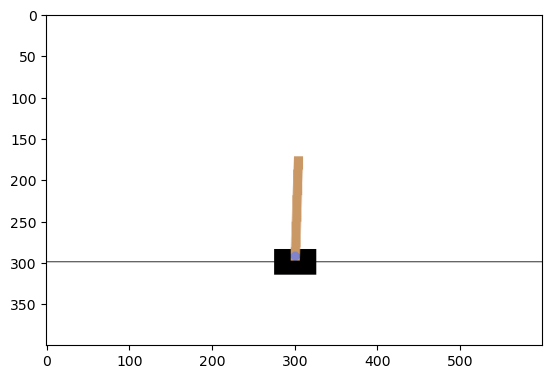

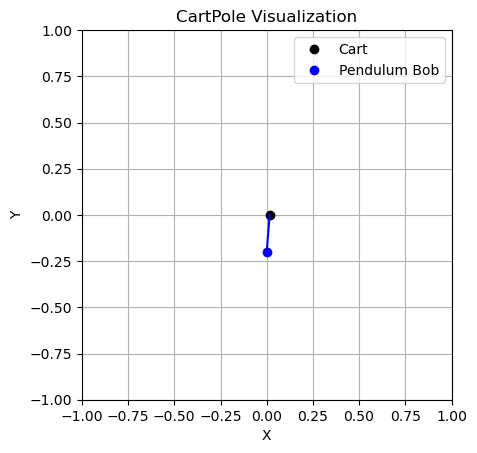


STEP:  6
CART POSITION:  -0.00063150324
CART VELOCITY:  -1.0100179
POLE ANGLE WRT CART:  0.050784234
VELOCITY AT TOP OF POLE:  1.4740554
ACTION: Push cart to left


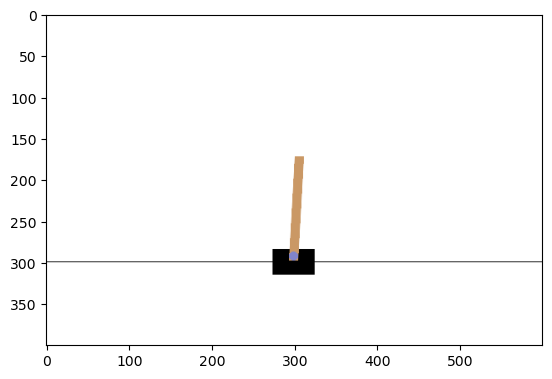

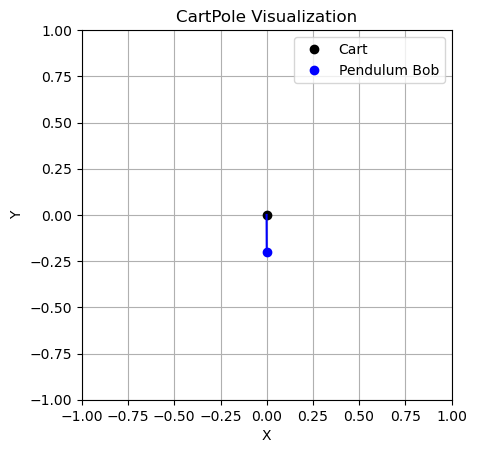


STEP:  7
CART POSITION:  -0.02083186
CART VELOCITY:  -1.2057225
POLE ANGLE WRT CART:  0.08026534
VELOCITY AT TOP OF POLE:  1.7821579
ACTION: Push cart to left


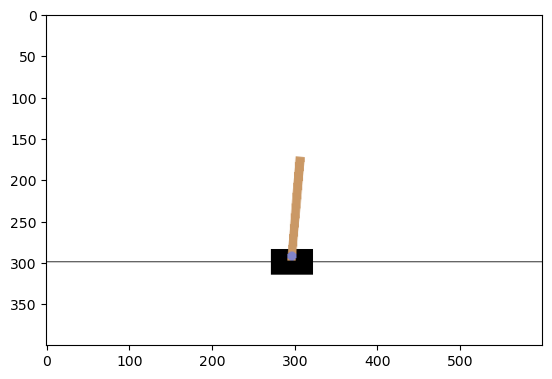

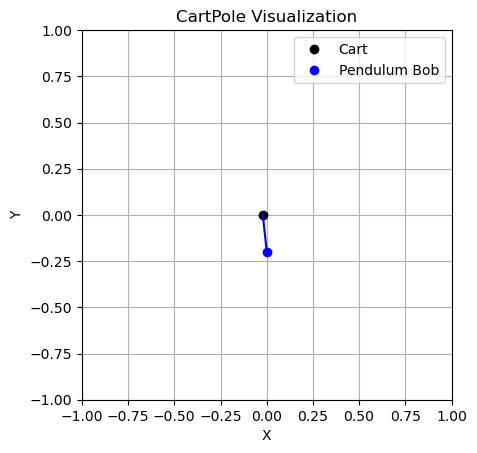


STEP:  8
CART POSITION:  -0.04494631
CART VELOCITY:  -1.40165
POLE ANGLE WRT CART:  0.115908496
VELOCITY AT TOP OF POLE:  2.0986757
ACTION: Push cart to left


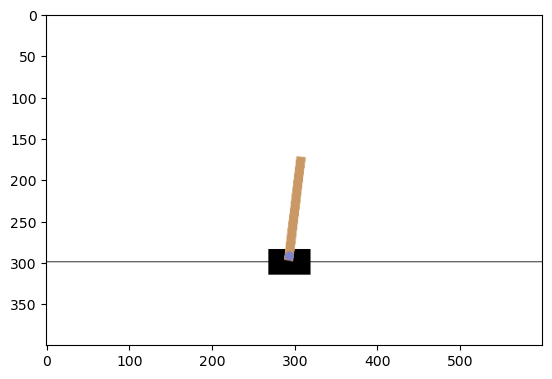

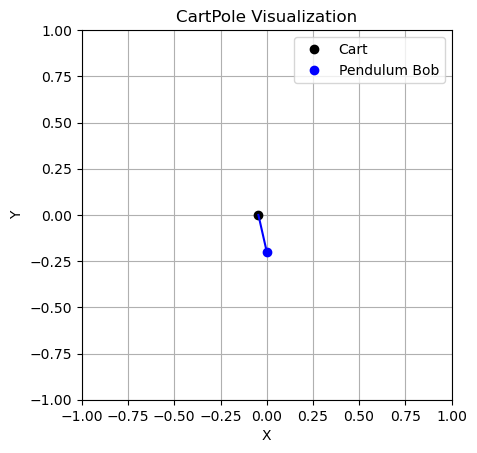


STEP:  9
CART POSITION:  -0.07297931
CART VELOCITY:  -1.5977305
POLE ANGLE WRT CART:  0.157882
VELOCITY AT TOP OF POLE:  2.4248238
ACTION: Push cart to left


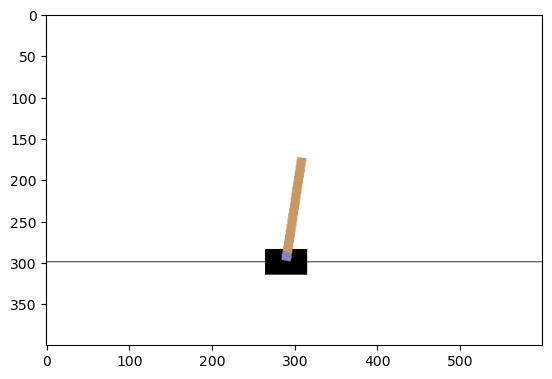

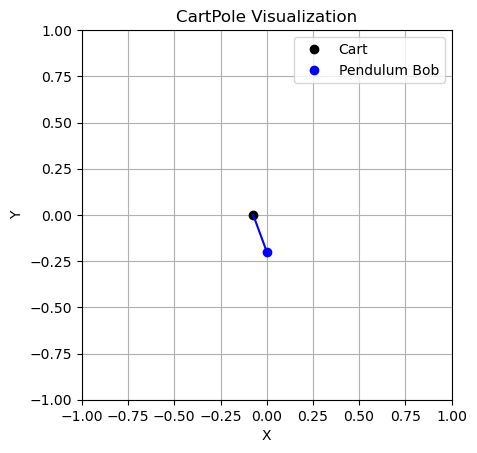


STEP:  10
CART POSITION:  -0.10493392
CART VELOCITY:  -1.7938226
POLE ANGLE WRT CART:  0.20637849
VELOCITY AT TOP OF POLE:  2.7615285
ACTION: Push cart to left


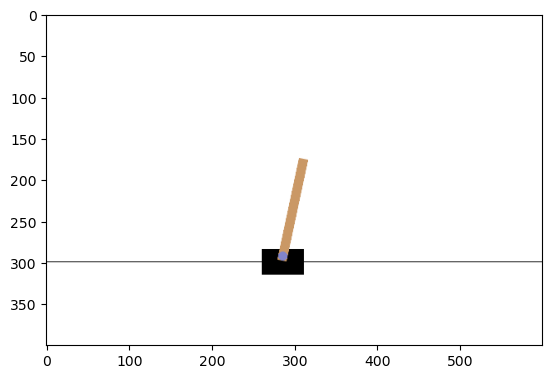

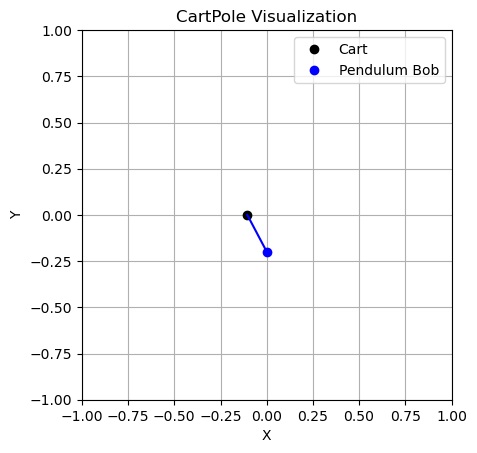


STEP:  1
CART POSITION:  0.039272264
CART VELOCITY:  -0.0041850526
POLE ANGLE WRT CART:  -0.029253481
VELOCITY AT TOP OF POLE:  -0.02520009
ACTION: Push cart to left


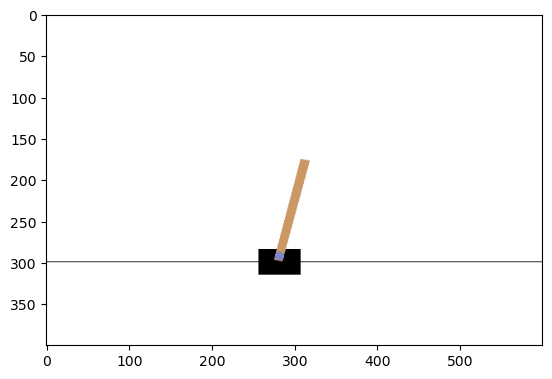

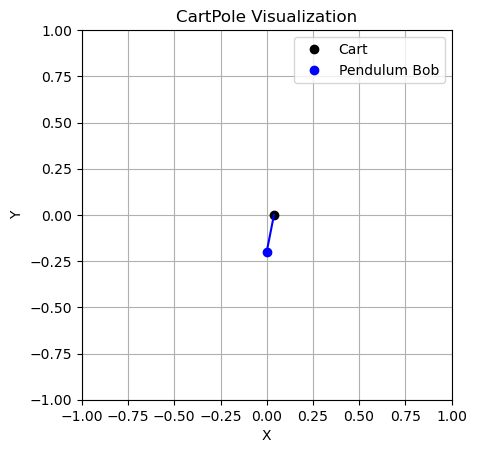


STEP:  2
CART POSITION:  0.03918856
CART VELOCITY:  -0.19887553
POLE ANGLE WRT CART:  -0.029757481
VELOCITY AT TOP OF POLE:  0.2581114
ACTION: Push cart to left


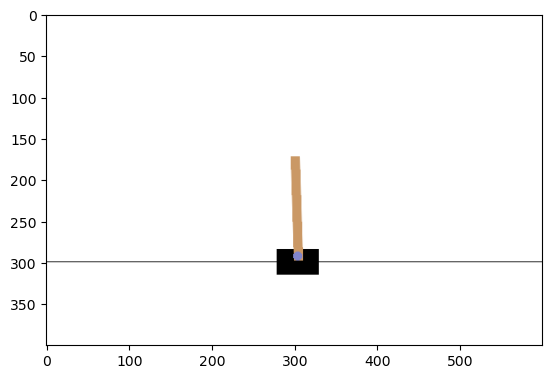

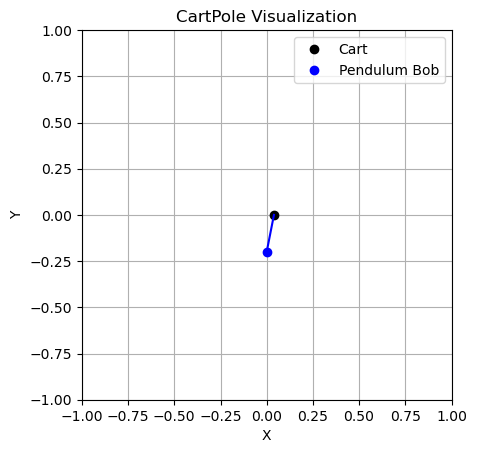


STEP:  3
CART POSITION:  0.035211053
CART VELOCITY:  -0.3935603
POLE ANGLE WRT CART:  -0.024595255
VELOCITY AT TOP OF POLE:  0.54126185
ACTION: Push cart to left


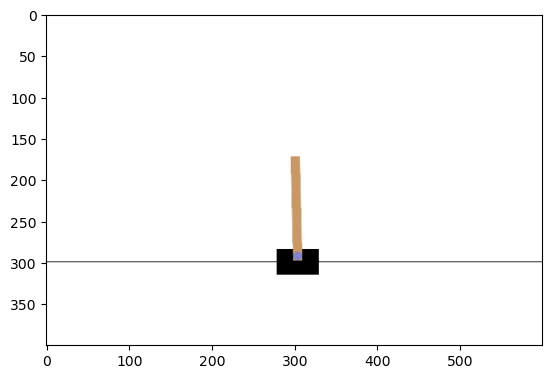

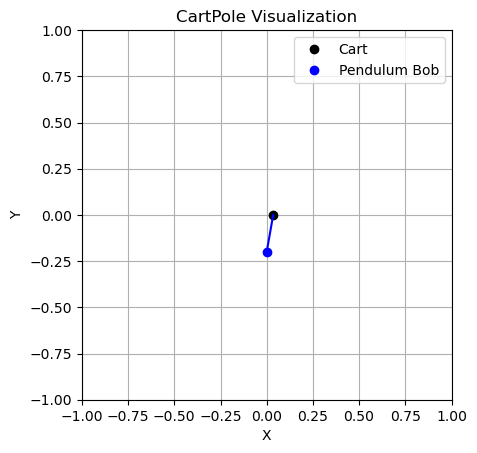


STEP:  4
CART POSITION:  0.027339846
CART VELOCITY:  -0.58832806
POLE ANGLE WRT CART:  -0.013770018
VELOCITY AT TOP OF POLE:  0.82609487
ACTION: Push cart to left


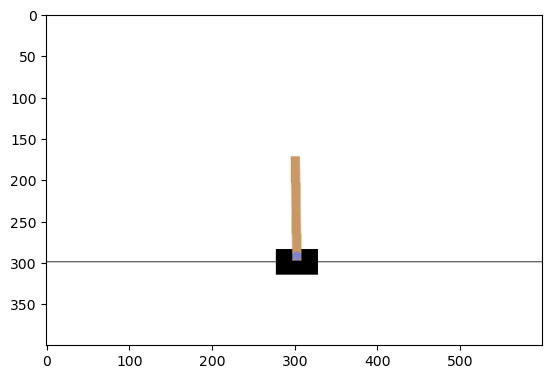

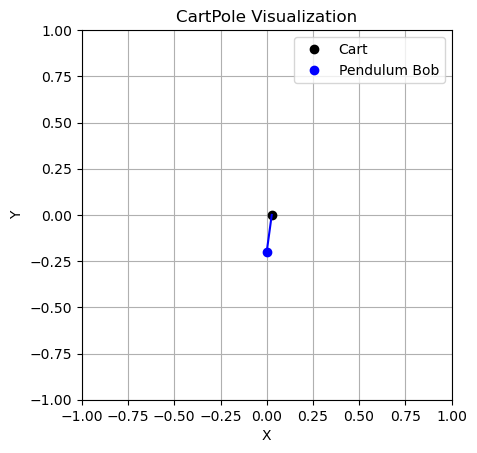


STEP:  5
CART POSITION:  0.015573284
CART VELOCITY:  -0.78325903
POLE ANGLE WRT CART:  0.0027518799
VELOCITY AT TOP OF POLE:  1.1144153
ACTION: Push cart to left


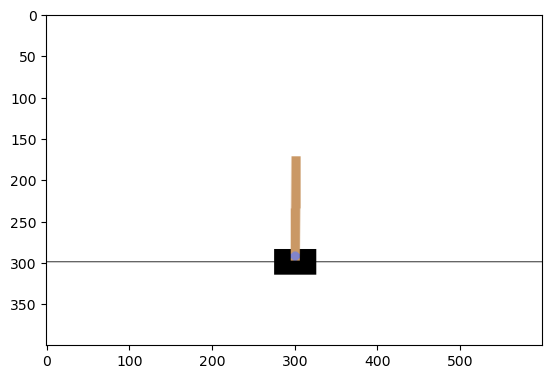

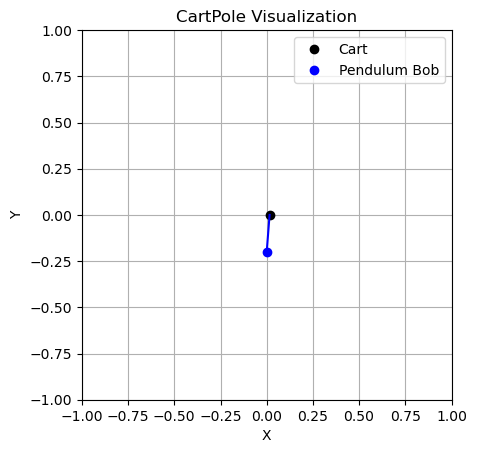


STEP:  6
CART POSITION:  -9.1896654e-05
CART VELOCITY:  -0.978417
POLE ANGLE WRT CART:  0.025040187
VELOCITY AT TOP OF POLE:  1.4079602
ACTION: Push cart to left


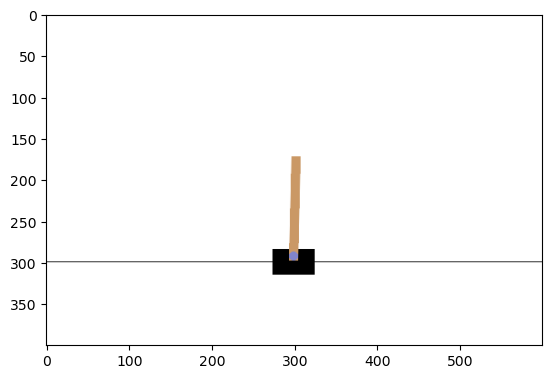

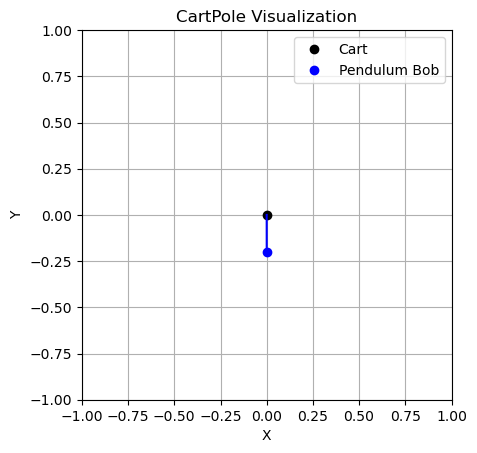


STEP:  7
CART POSITION:  -0.019660236
CART VELOCITY:  -1.1738405
POLE ANGLE WRT CART:  0.05319939
VELOCITY AT TOP OF POLE:  1.7083646
ACTION: Push cart to left


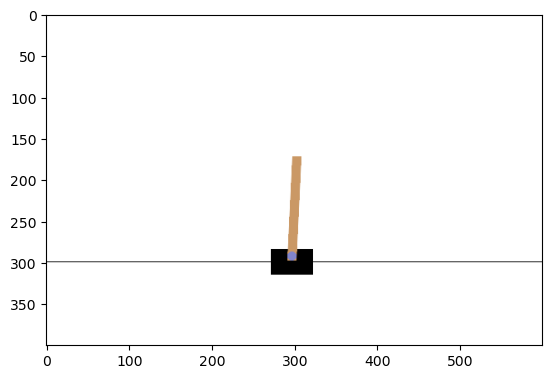

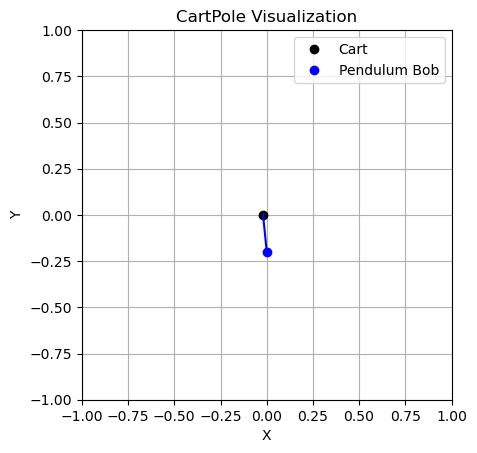


STEP:  8
CART POSITION:  -0.043137047
CART VELOCITY:  -1.3695321
POLE ANGLE WRT CART:  0.087366685
VELOCITY AT TOP OF POLE:  2.01712
ACTION: Push cart to left


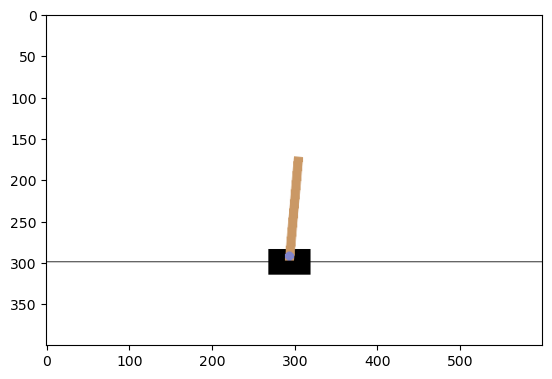

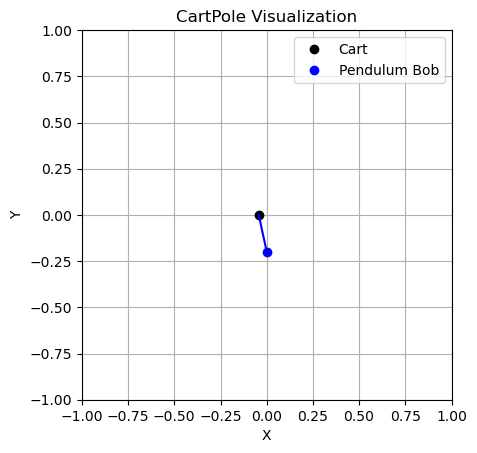


STEP:  9
CART POSITION:  -0.07052769
CART VELOCITY:  -1.5654452
POLE ANGLE WRT CART:  0.12770909
VELOCITY AT TOP OF POLE:  2.335522
ACTION: Push cart to left


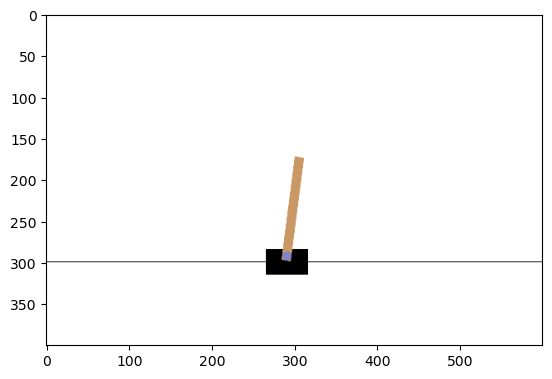

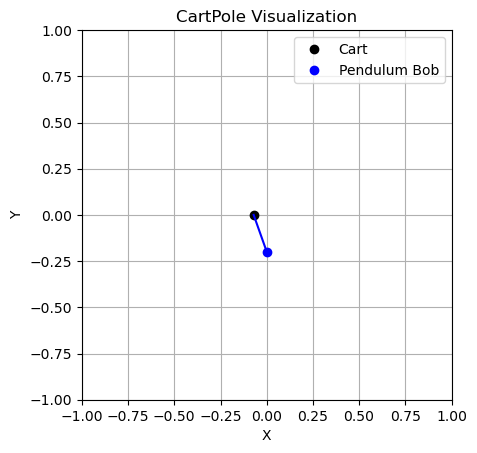


STEP:  10
CART POSITION:  -0.10183659
CART VELOCITY:  -1.7614684
POLE ANGLE WRT CART:  0.17441952
VELOCITY AT TOP OF POLE:  2.6646066
ACTION: Push cart to left


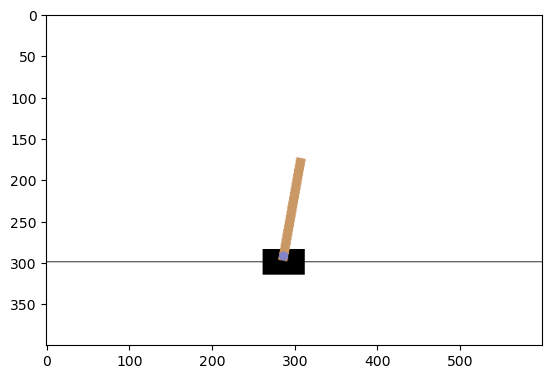

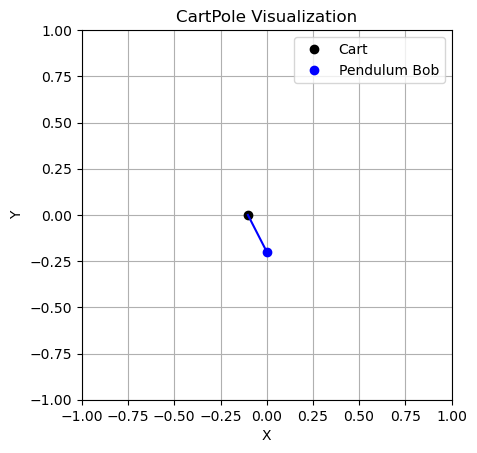


STEP:  1
CART POSITION:  0.017350536
CART VELOCITY:  0.009693165
POLE ANGLE WRT CART:  0.030927936
VELOCITY AT TOP OF POLE:  0.043951623
ACTION: Push cart to right


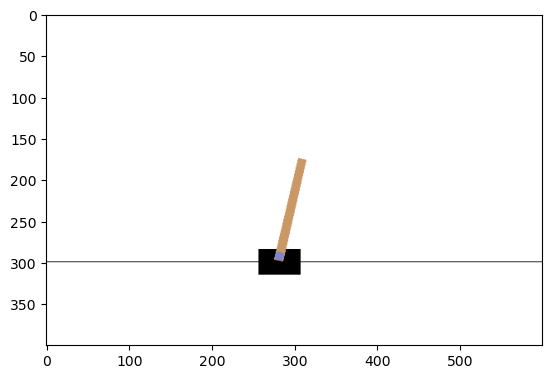

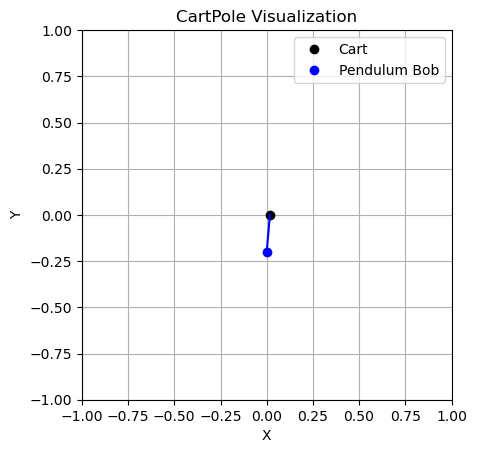


STEP:  2
CART POSITION:  0.017544398
CART VELOCITY:  0.20435828
POLE ANGLE WRT CART:  0.03180697
VELOCITY AT TOP OF POLE:  -0.23881505
ACTION: Push cart to left


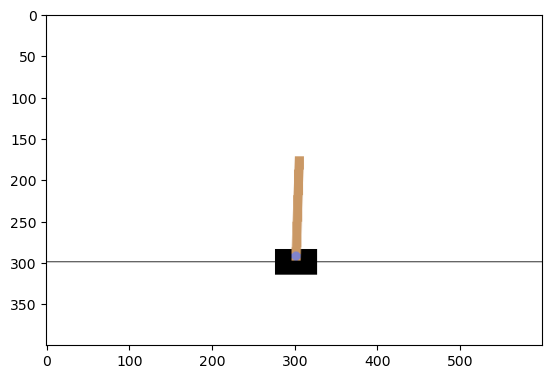

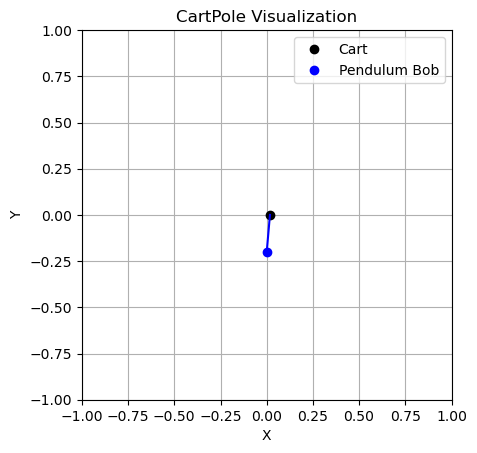


STEP:  3
CART POSITION:  0.021631565
CART VELOCITY:  0.0087967245
POLE ANGLE WRT CART:  0.027030667
VELOCITY AT TOP OF POLE:  0.06372859
ACTION: Push cart to right


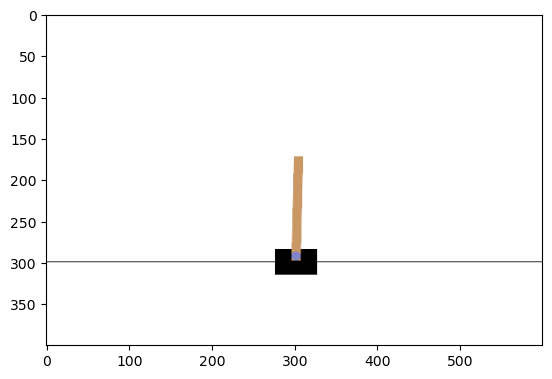

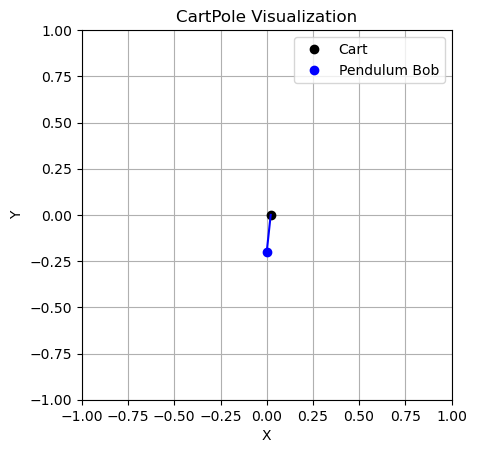


STEP:  4
CART POSITION:  0.0218075
CART VELOCITY:  0.20352091
POLE ANGLE WRT CART:  0.028305238
VELOCITY AT TOP OF POLE:  -0.22030494
ACTION: Push cart to right


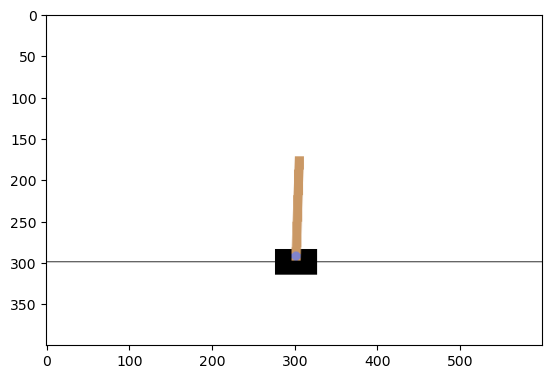

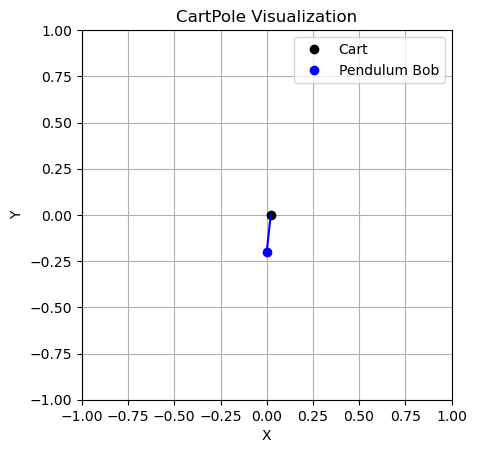


STEP:  5
CART POSITION:  0.025877917
CART VELOCITY:  0.39822707
POLE ANGLE WRT CART:  0.02389914
VELOCITY AT TOP OF POLE:  -0.5039266
ACTION: Push cart to right


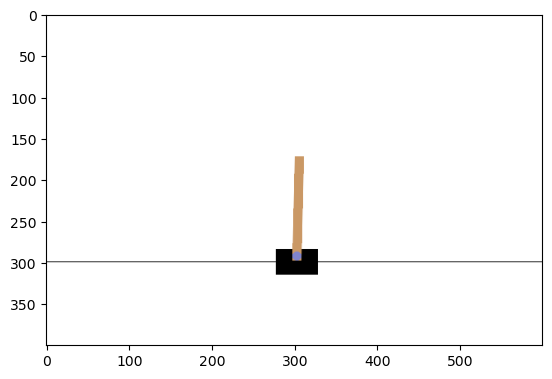

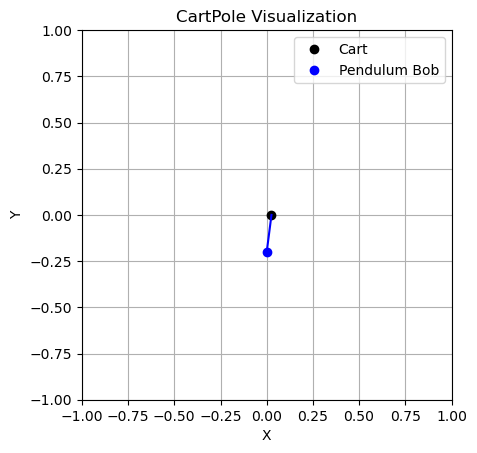


STEP:  6
CART POSITION:  0.03384246
CART VELOCITY:  0.59300417
POLE ANGLE WRT CART:  0.013820609
VELOCITY AT TOP OF POLE:  -0.7889831
ACTION: Push cart to right


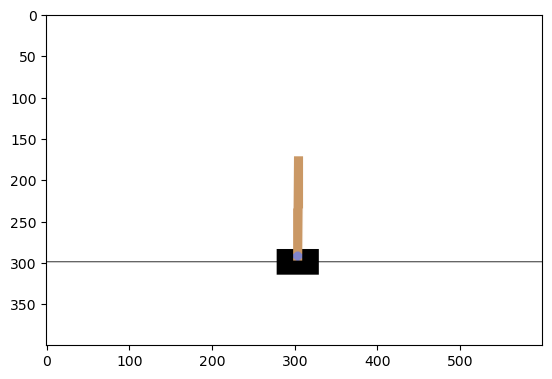

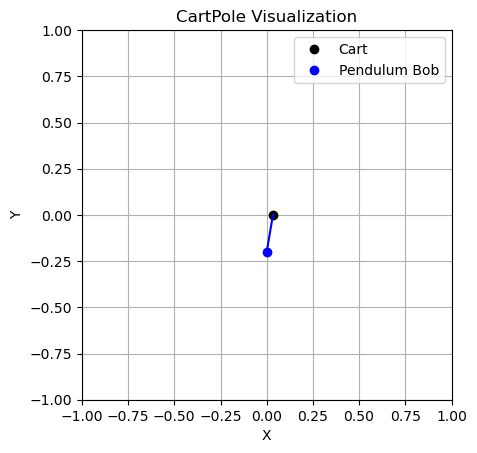


STEP:  7
CART POSITION:  0.045702543
CART VELOCITY:  0.7879336
POLE ANGLE WRT CART:  -0.0019590526
VELOCITY AT TOP OF POLE:  -1.0772862
ACTION: Push cart to right


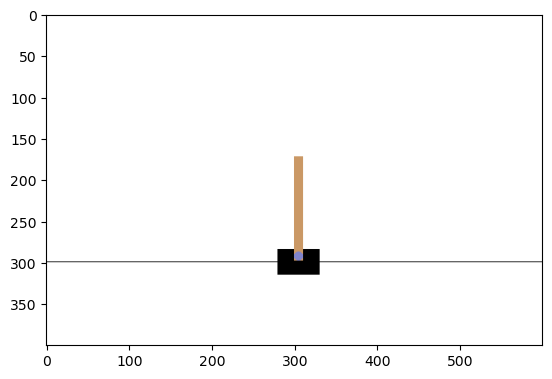

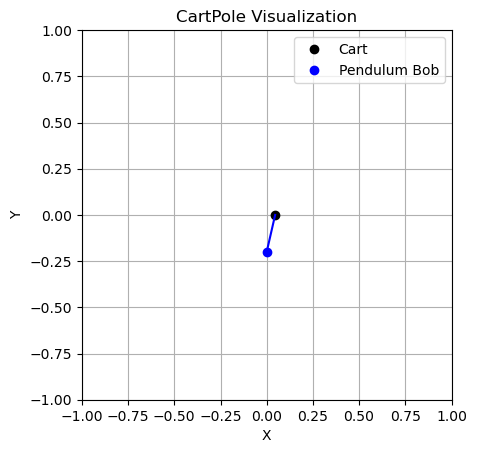


STEP:  8
CART POSITION:  0.061461214
CART VELOCITY:  0.9830814
POLE ANGLE WRT CART:  -0.023504777
VELOCITY AT TOP OF POLE:  -1.3705833
ACTION: Push cart to right


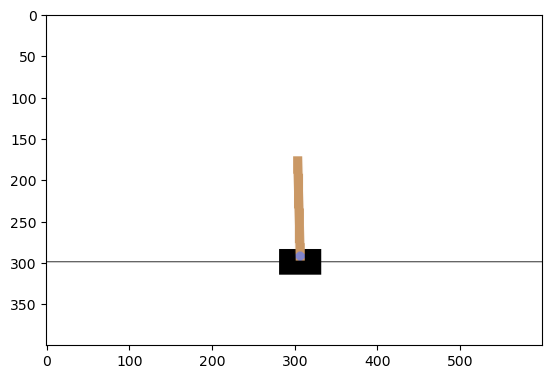

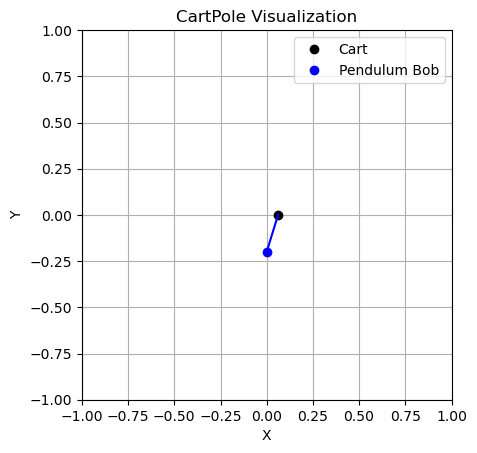


STEP:  9
CART POSITION:  0.081122845
CART VELOCITY:  1.1784893
POLE ANGLE WRT CART:  -0.05091644
VELOCITY AT TOP OF POLE:  -1.670524
ACTION: Push cart to right


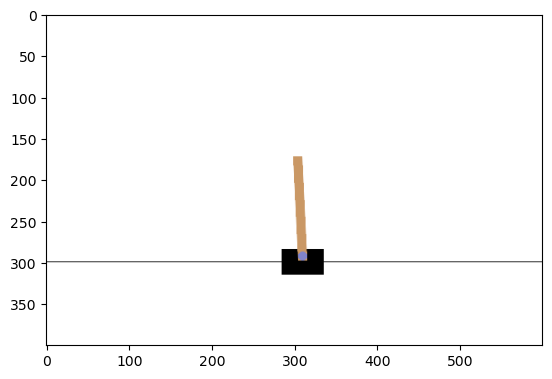

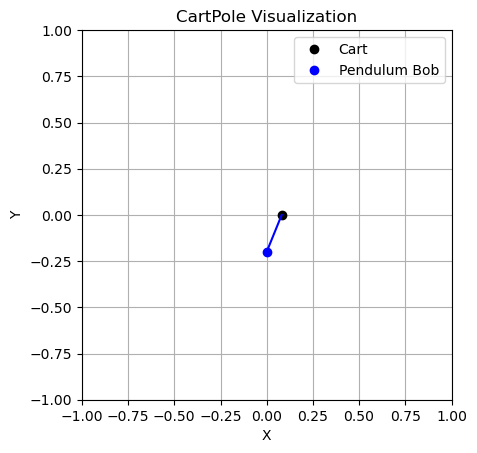


STEP:  10
CART POSITION:  0.10469263
CART VELOCITY:  1.3741646
POLE ANGLE WRT CART:  -0.08432692
VELOCITY AT TOP OF POLE:  -1.9786195
ACTION: Push cart to right


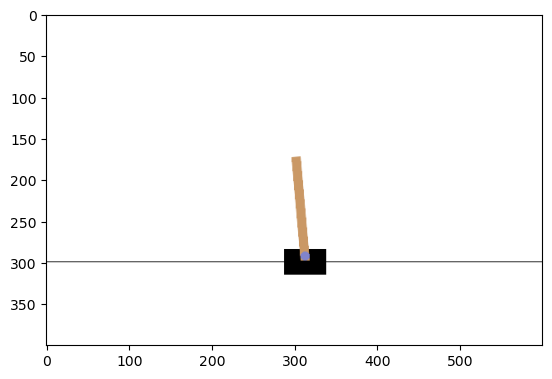

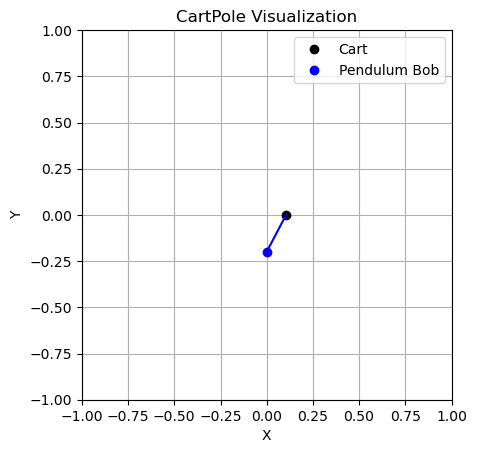


STEP:  11
CART POSITION:  0.13217592
CART VELOCITY:  1.5700668
POLE ANGLE WRT CART:  -0.12389931
VELOCITY AT TOP OF POLE:  -2.2961915
ACTION: Push cart to right


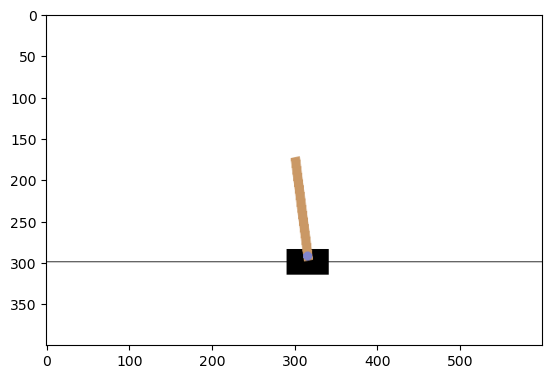

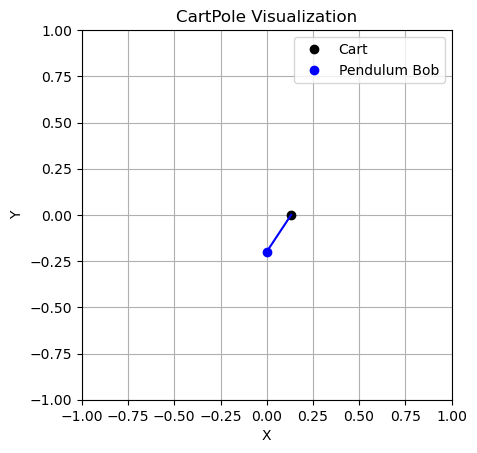


STEP:  12
CART POSITION:  0.16357726
CART VELOCITY:  1.7660928
POLE ANGLE WRT CART:  -0.16982314
VELOCITY AT TOP OF POLE:  -2.6243095
ACTION: Push cart to right


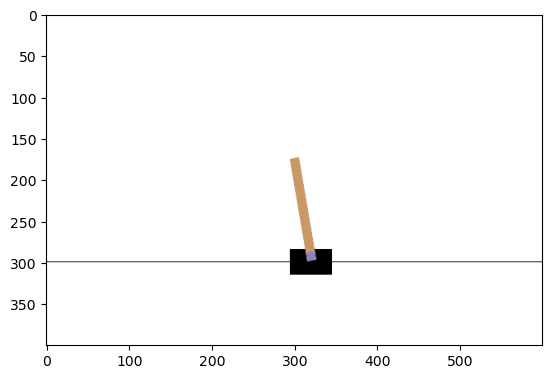

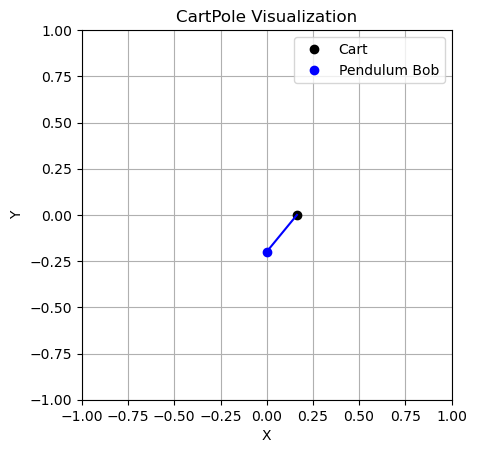


STEP:  1
CART POSITION:  -0.029215433
CART VELOCITY:  -0.03357541
POLE ANGLE WRT CART:  -0.031899434
VELOCITY AT TOP OF POLE:  0.007889787
ACTION: Push cart to left


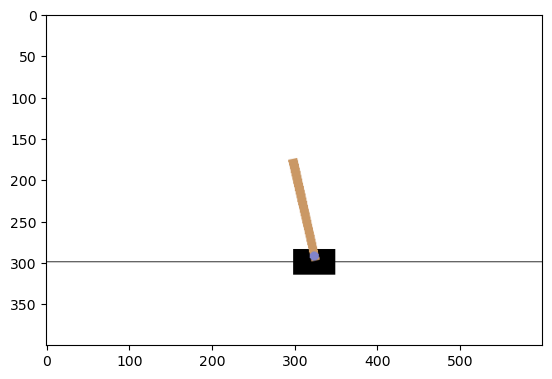

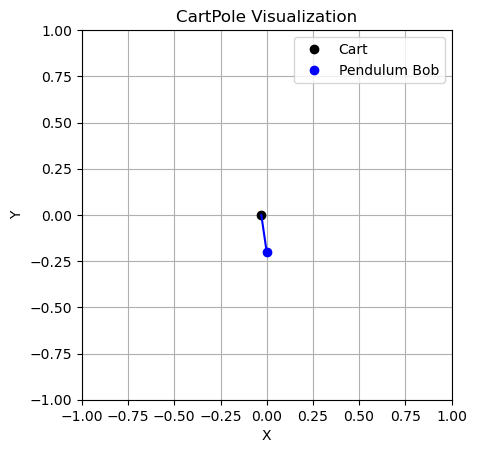


STEP:  2
CART POSITION:  -0.029886942
CART VELOCITY:  -0.2282257
POLE ANGLE WRT CART:  -0.031741638
VELOCITY AT TOP OF POLE:  0.29033983
ACTION: Push cart to left


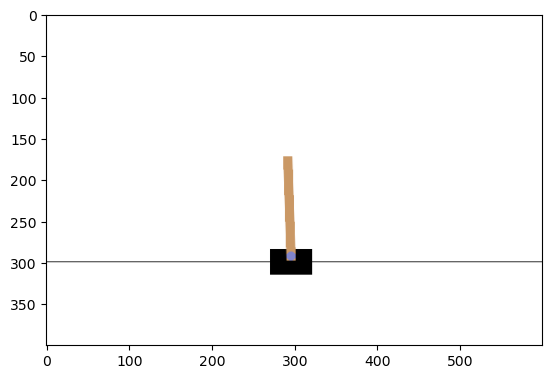

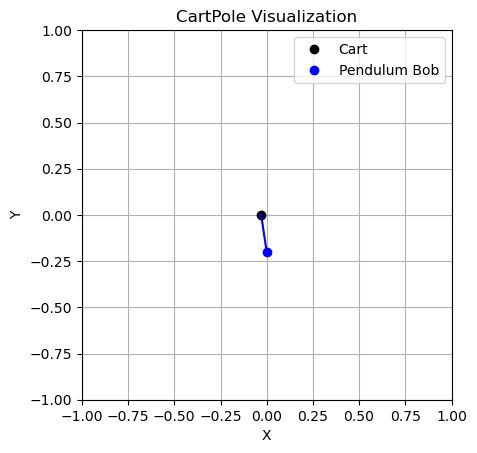


STEP:  3
CART POSITION:  -0.034451455
CART VELOCITY:  -0.422881
POLE ANGLE WRT CART:  -0.02593484
VELOCITY AT TOP OF POLE:  0.5728452
ACTION: Push cart to left


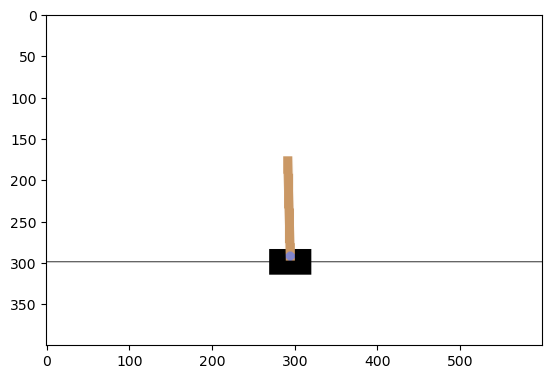

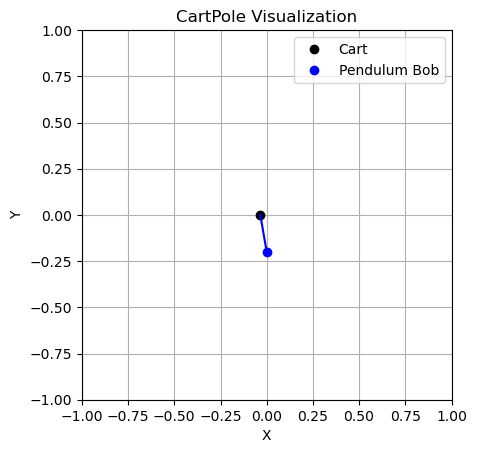


STEP:  4
CART POSITION:  -0.042909075
CART VELOCITY:  -0.6176299
POLE ANGLE WRT CART:  -0.014477936
VELOCITY AT TOP OF POLE:  0.85724634
ACTION: Push cart to left


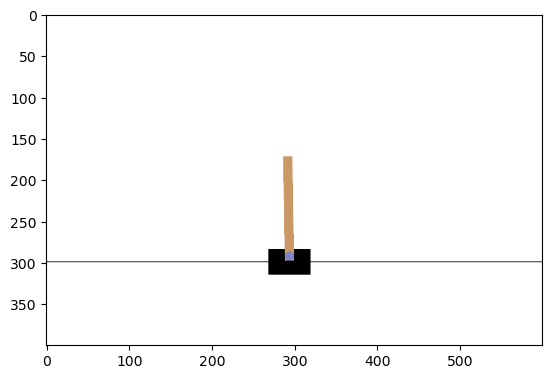

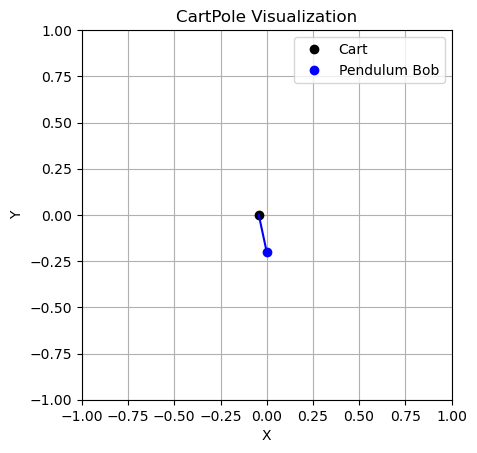


STEP:  5
CART POSITION:  -0.05526167
CART VELOCITY:  -0.8125516
POLE ANGLE WRT CART:  0.0026669914
VELOCITY AT TOP OF POLE:  1.145342
ACTION: Push cart to left


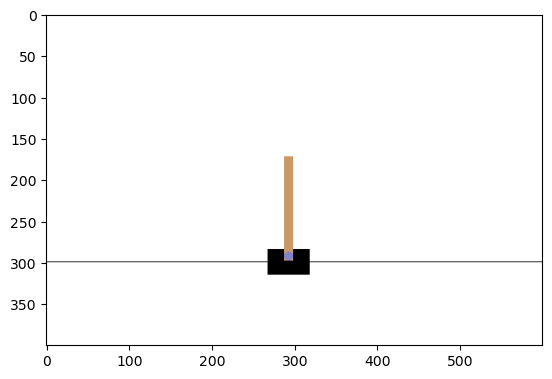

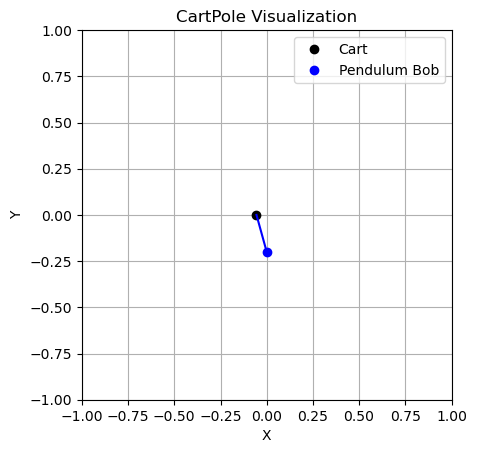


STEP:  6
CART POSITION:  -0.07151271
CART VELOCITY:  -1.0077083
POLE ANGLE WRT CART:  0.025573831
VELOCITY AT TOP OF POLE:  1.43886
ACTION: Push cart to left


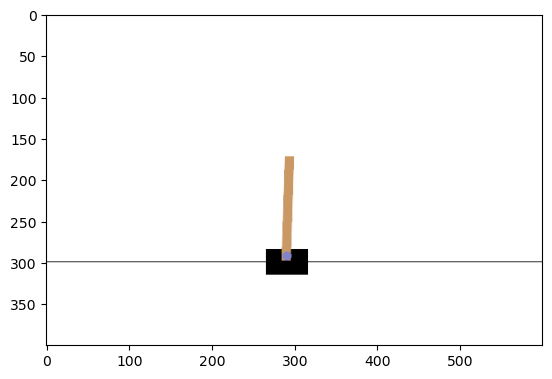

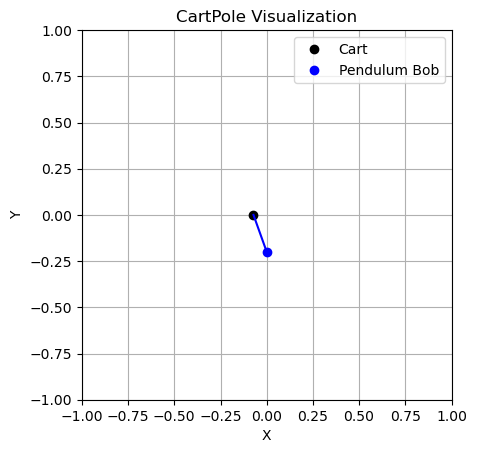


STEP:  7
CART POSITION:  -0.09166687
CART VELOCITY:  -1.2031358
POLE ANGLE WRT CART:  0.05435103
VELOCITY AT TOP OF POLE:  1.7394234
ACTION: Push cart to left


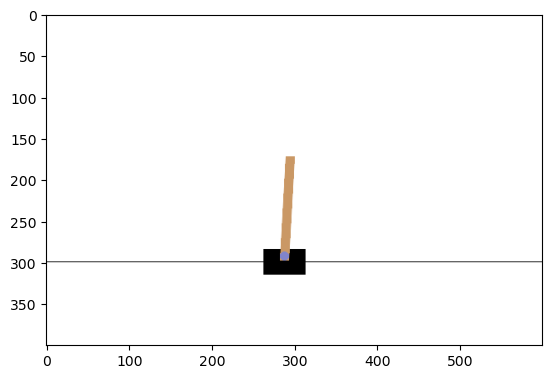

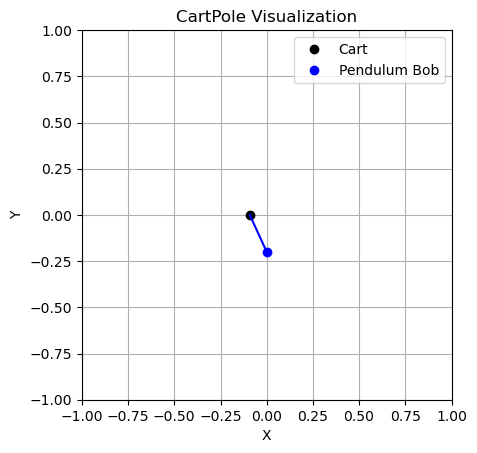


STEP:  8
CART POSITION:  -0.11572959
CART VELOCITY:  -1.3988332
POLE ANGLE WRT CART:  0.0891395
VELOCITY AT TOP OF POLE:  2.0485072
ACTION: Push cart to left


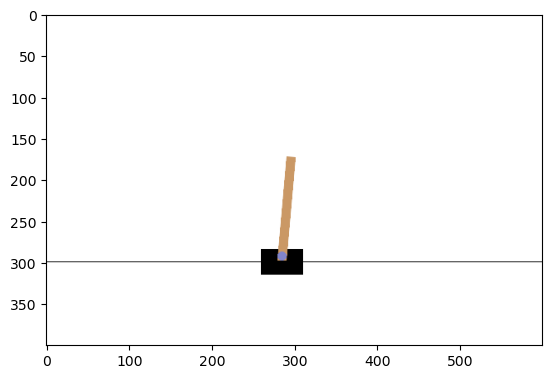

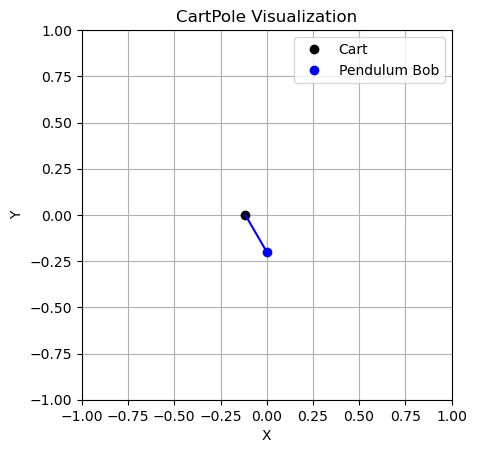


STEP:  9
CART POSITION:  -0.14370625
CART VELOCITY:  -1.5947486
POLE ANGLE WRT CART:  0.13010964
VELOCITY AT TOP OF POLE:  2.367386
ACTION: Push cart to left


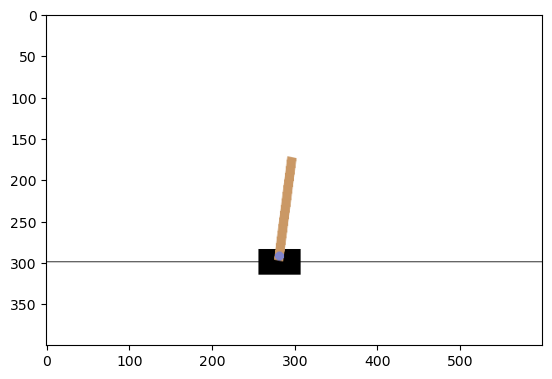

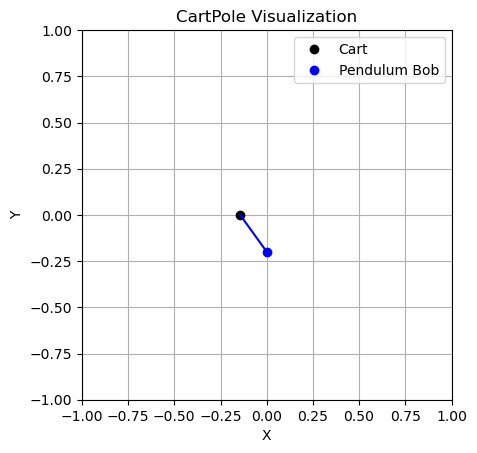


STEP:  10
CART POSITION:  -0.17560123
CART VELOCITY:  -1.7907648
POLE ANGLE WRT CART:  0.17745736
VELOCITY AT TOP OF POLE:  2.6970694
ACTION: Push cart to left


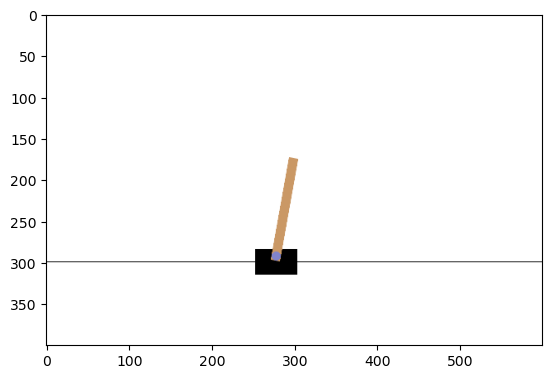

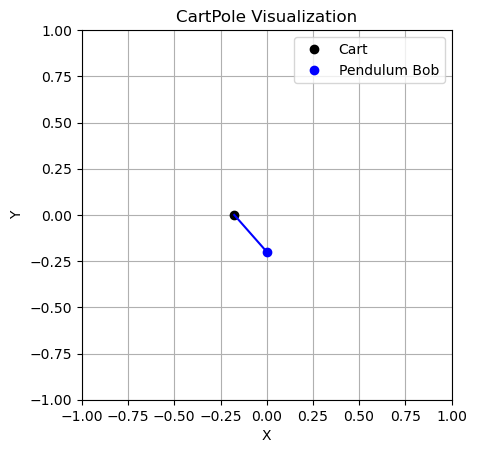


STEP:  1
CART POSITION:  0.028779551
CART VELOCITY:  0.0111668
POLE ANGLE WRT CART:  -0.013924204
VELOCITY AT TOP OF POLE:  -0.0040979004
ACTION: Push cart to left


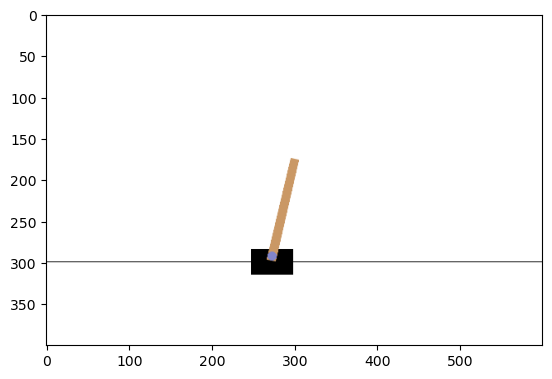

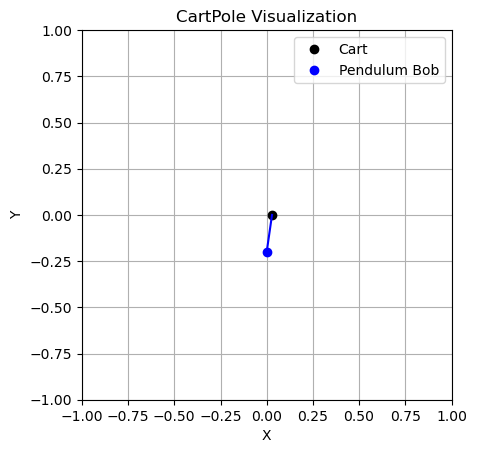


STEP:  2
CART POSITION:  0.029002886
CART VELOCITY:  -0.18375272
POLE ANGLE WRT CART:  -0.014006161
VELOCITY AT TOP OF POLE:  0.28415945
ACTION: Push cart to left


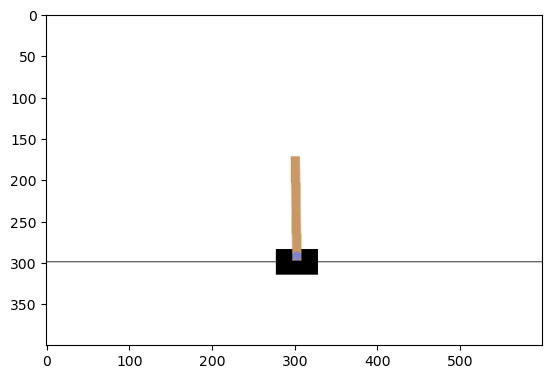

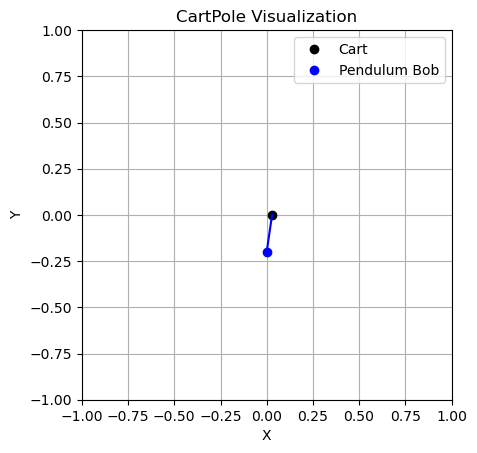


STEP:  3
CART POSITION:  0.025327832
CART VELOCITY:  -0.37867212
POLE ANGLE WRT CART:  -0.008322973
VELOCITY AT TOP OF POLE:  0.5723922
ACTION: Push cart to left


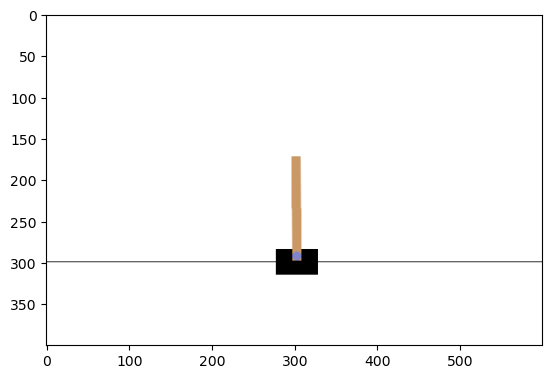

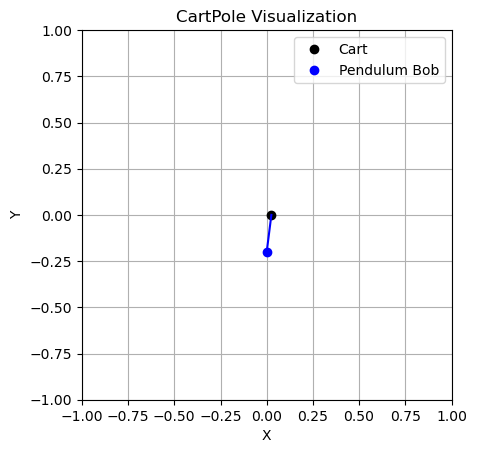


STEP:  4
CART POSITION:  0.017754389
CART VELOCITY:  -0.5736764
POLE ANGLE WRT CART:  0.0031248718
VELOCITY AT TOP OF POLE:  0.86244154
ACTION: Push cart to left


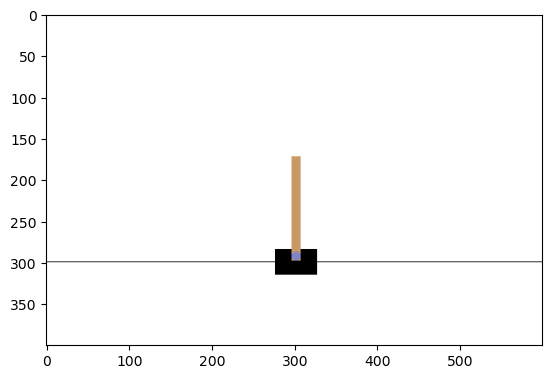

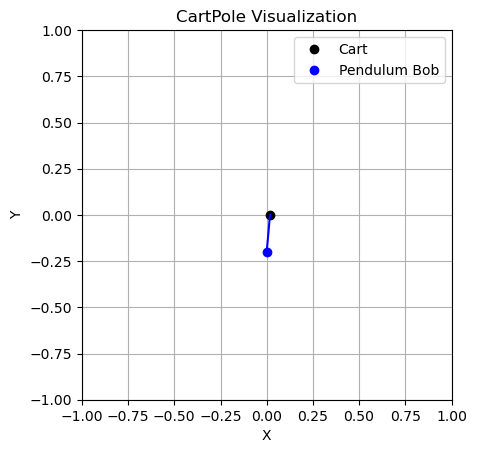


STEP:  5
CART POSITION:  0.006280862
CART VELOCITY:  -0.76884073
POLE ANGLE WRT CART:  0.020373702
VELOCITY AT TOP OF POLE:  1.1561054
ACTION: Push cart to left


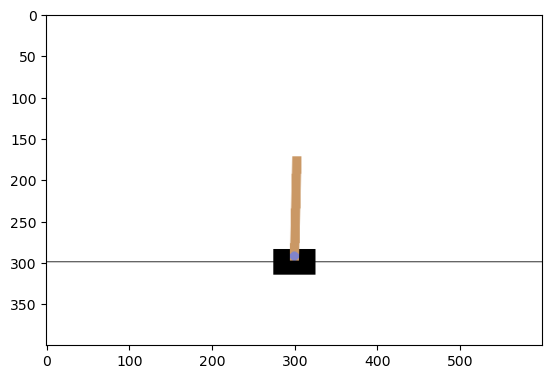

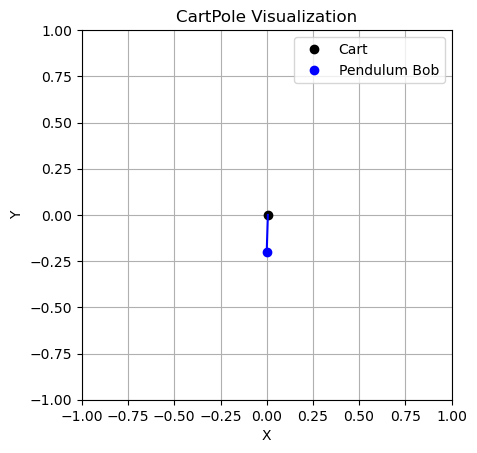


STEP:  6
CART POSITION:  -0.009095954
CART VELOCITY:  -0.9642223
POLE ANGLE WRT CART:  0.04349581
VELOCITY AT TOP OF POLE:  1.4551064
ACTION: Push cart to left


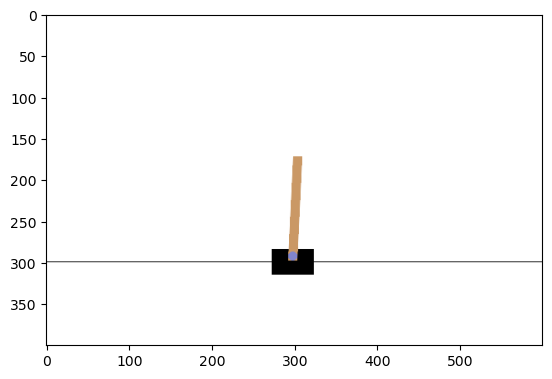

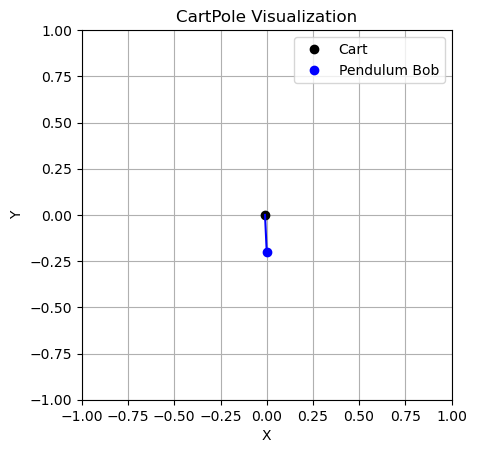


STEP:  7
CART POSITION:  -0.0283804
CART VELOCITY:  -1.1598504
POLE ANGLE WRT CART:  0.072597936
VELOCITY AT TOP OF POLE:  1.7610546
ACTION: Push cart to left


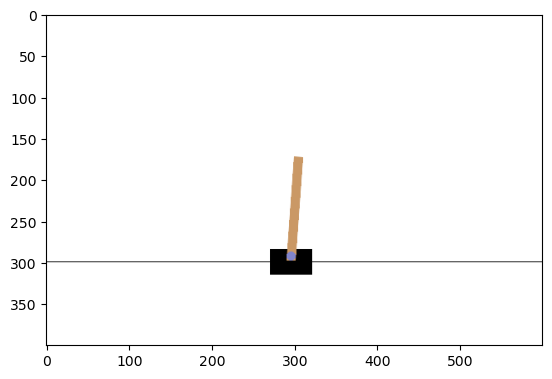

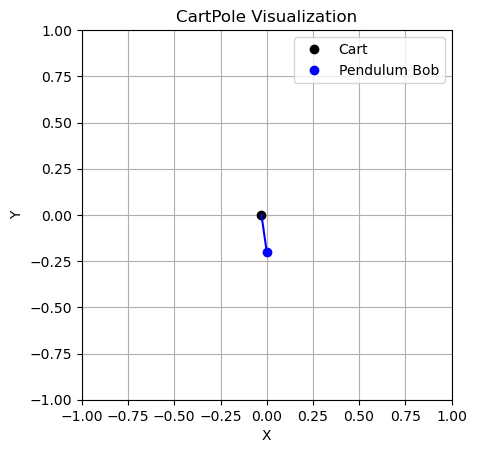


STEP:  8
CART POSITION:  -0.051577408
CART VELOCITY:  -1.355715
POLE ANGLE WRT CART:  0.10781903
VELOCITY AT TOP OF POLE:  2.0754027
ACTION: Push cart to left


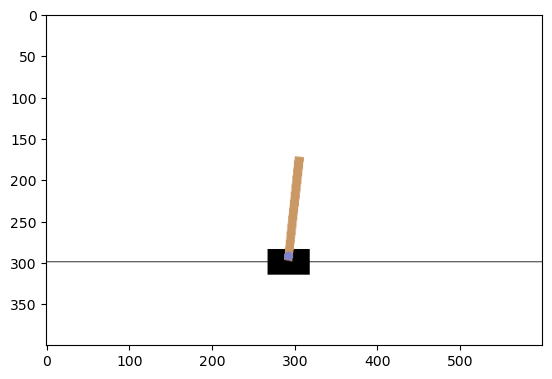

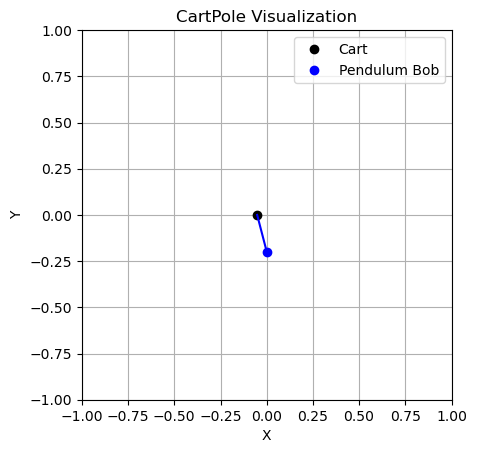


STEP:  9
CART POSITION:  -0.078691706
CART VELOCITY:  -1.5517529
POLE ANGLE WRT CART:  0.14932708
VELOCITY AT TOP OF POLE:  2.3993895
ACTION: Push cart to left


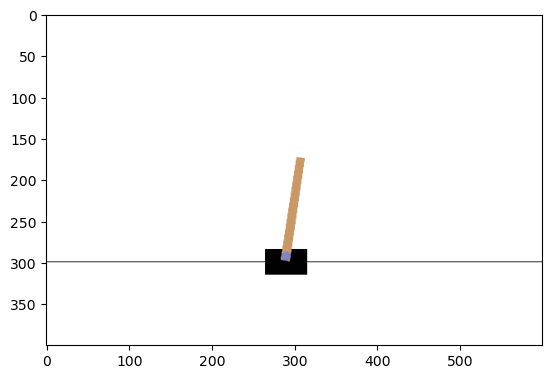

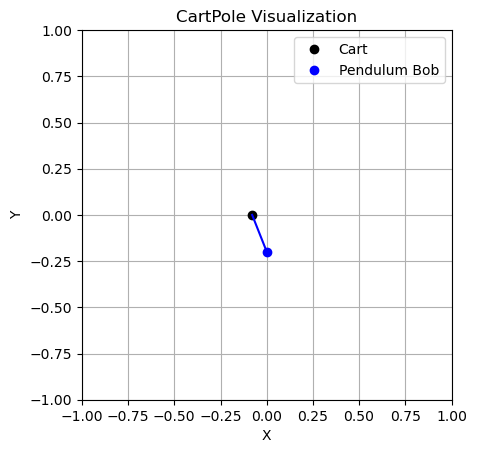


STEP:  10
CART POSITION:  -0.109726764
CART VELOCITY:  -1.7478316
POLE ANGLE WRT CART:  0.19731487
VELOCITY AT TOP OF POLE:  2.7339735
ACTION: Push cart to left


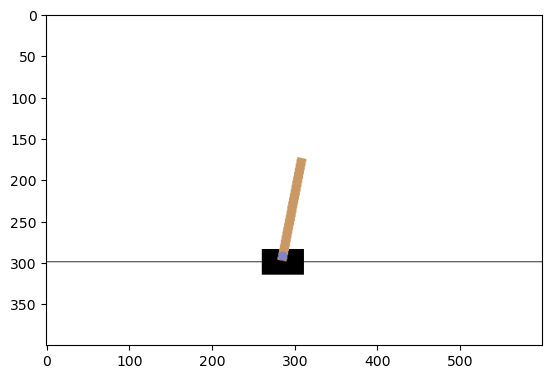

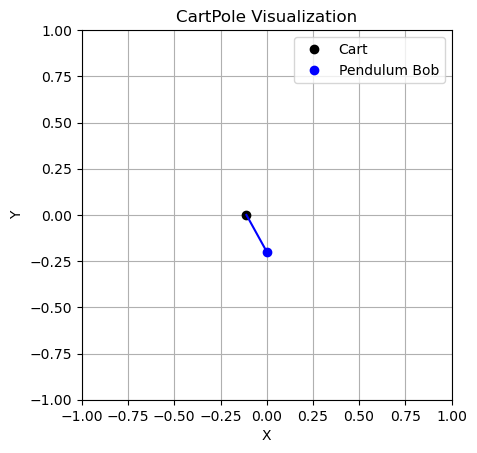


STEP:  1
CART POSITION:  -0.049402323
CART VELOCITY:  0.0008324062
POLE ANGLE WRT CART:  0.009350133
VELOCITY AT TOP OF POLE:  -0.042846765
ACTION: Push cart to right


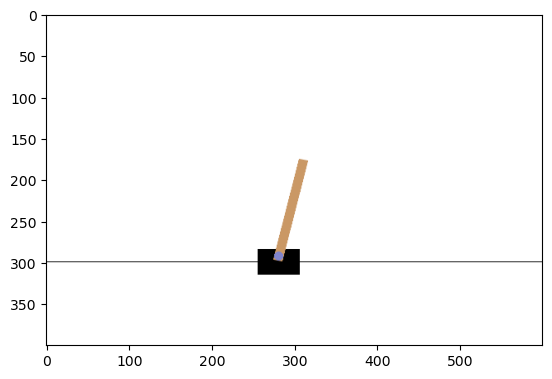

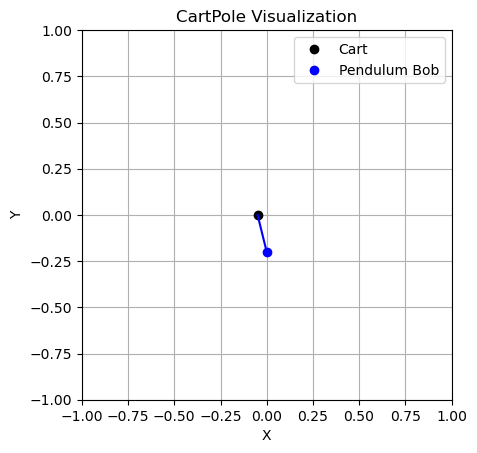


STEP:  2
CART POSITION:  -0.049385674
CART VELOCITY:  0.19581904
POLE ANGLE WRT CART:  0.008493197
VELOCITY AT TOP OF POLE:  -0.33256504
ACTION: Push cart to left


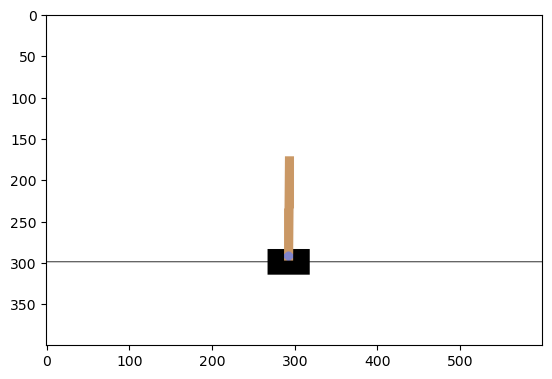

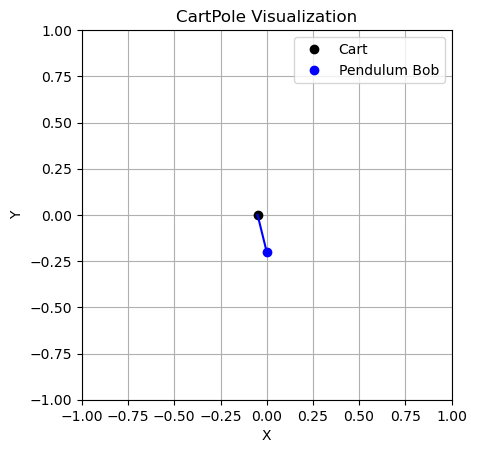


STEP:  3
CART POSITION:  -0.045469295
CART VELOCITY:  0.0005772368
POLE ANGLE WRT CART:  0.0018418968
VELOCITY AT TOP OF POLE:  -0.037215922
ACTION: Push cart to left


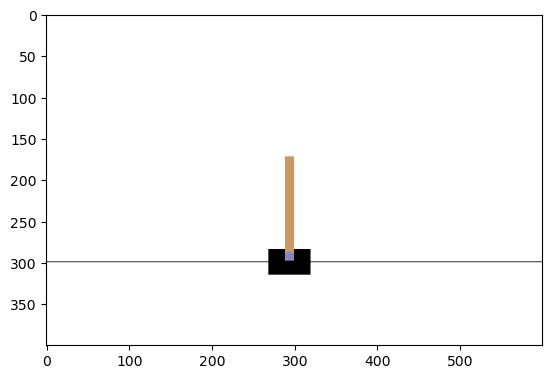

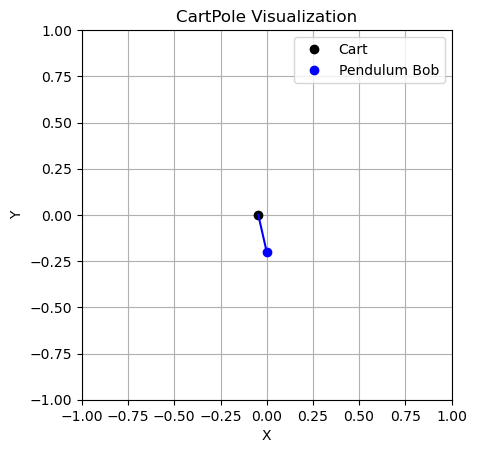


STEP:  4
CART POSITION:  -0.04545775
CART VELOCITY:  -0.19457108
POLE ANGLE WRT CART:  0.0010975784
VELOCITY AT TOP OF POLE:  0.25604758
ACTION: Push cart to left


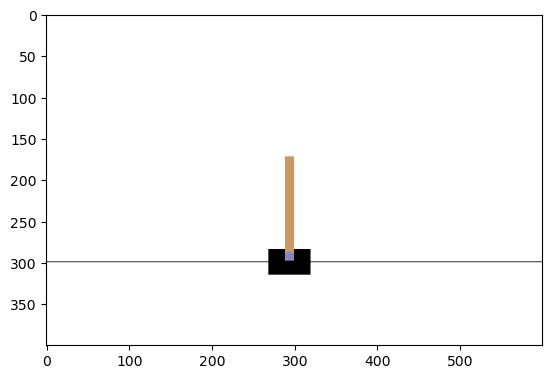

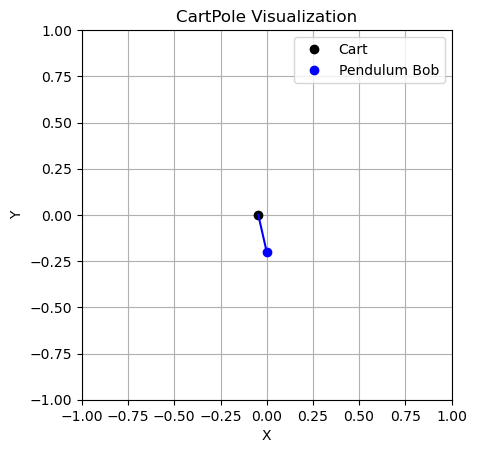


STEP:  5
CART POSITION:  -0.04934917
CART VELOCITY:  -0.3897087
POLE ANGLE WRT CART:  0.00621853
VELOCITY AT TOP OF POLE:  0.5490765
ACTION: Push cart to left


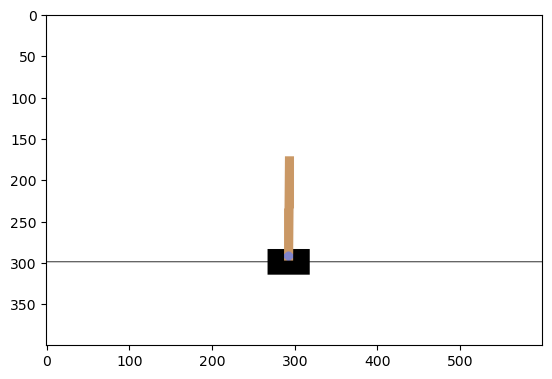

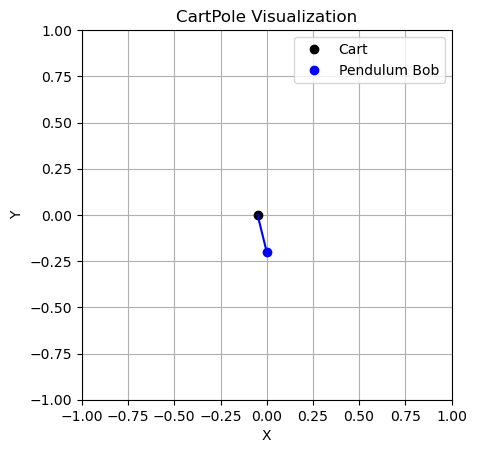


STEP:  6
CART POSITION:  -0.057143345
CART VELOCITY:  -0.5849174
POLE ANGLE WRT CART:  0.01720006
VELOCITY AT TOP OF POLE:  0.8437122
ACTION: Push cart to left


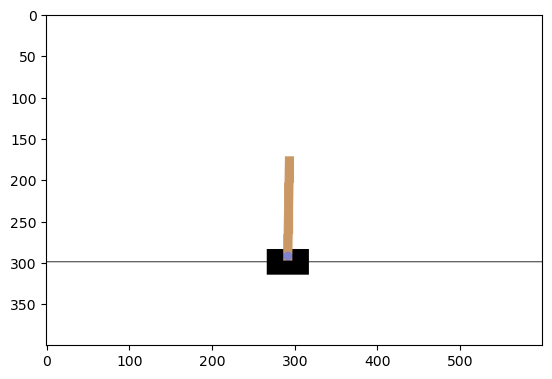

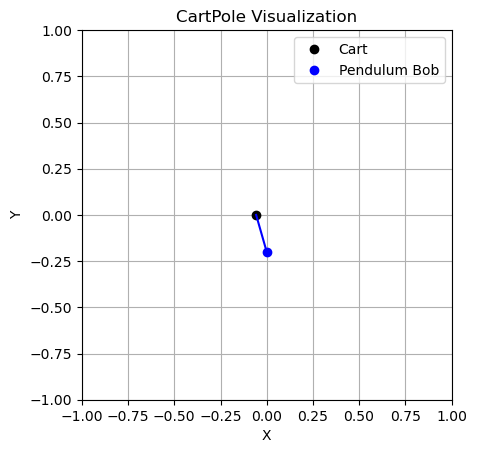


STEP:  7
CART POSITION:  -0.068841696
CART VELOCITY:  -0.78026986
POLE ANGLE WRT CART:  0.034074303
VELOCITY AT TOP OF POLE:  1.141754
ACTION: Push cart to left


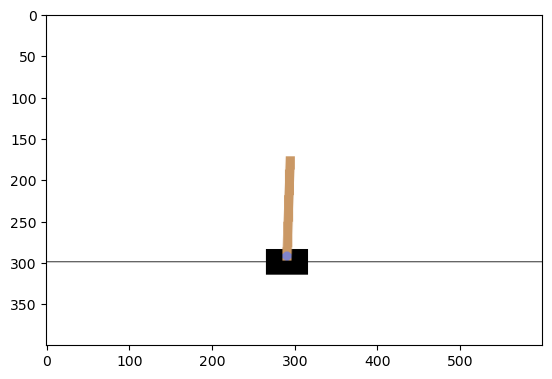

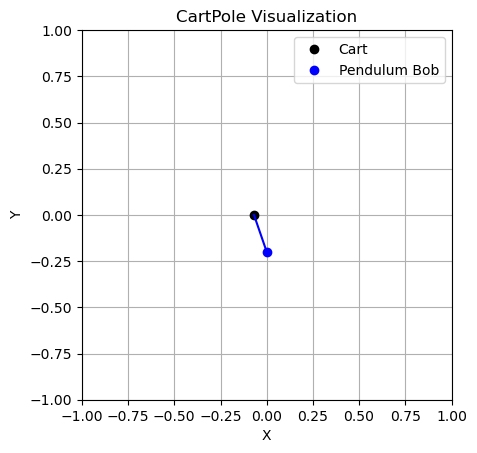


STEP:  8
CART POSITION:  -0.08444709
CART VELOCITY:  -0.9758201
POLE ANGLE WRT CART:  0.056909382
VELOCITY AT TOP OF POLE:  1.4449252
ACTION: Push cart to left


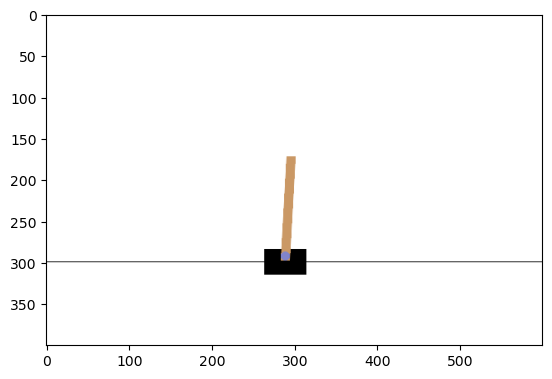

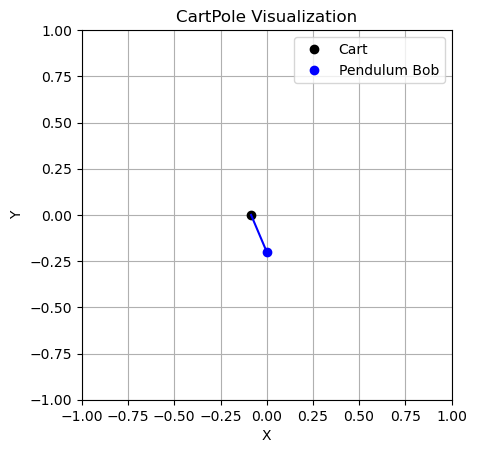


STEP:  9
CART POSITION:  -0.103963494
CART VELOCITY:  -1.1715943
POLE ANGLE WRT CART:  0.08580789
VELOCITY AT TOP OF POLE:  1.7548333
ACTION: Push cart to left


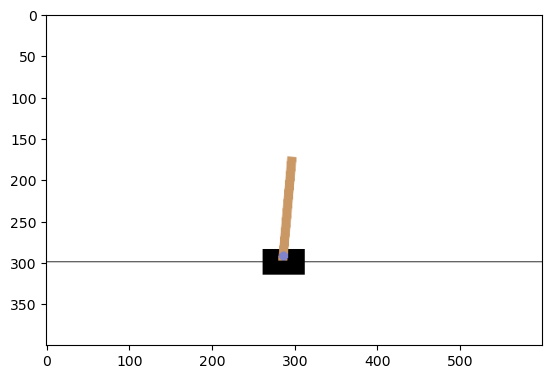

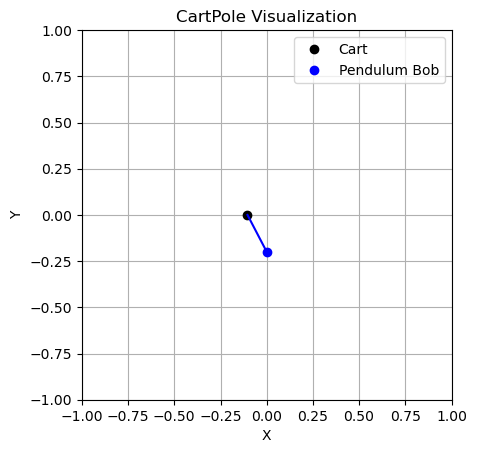


STEP:  10
CART POSITION:  -0.12739538
CART VELOCITY:  -1.367578
POLE ANGLE WRT CART:  0.12090455
VELOCITY AT TOP OF POLE:  2.072924
ACTION: Push cart to left


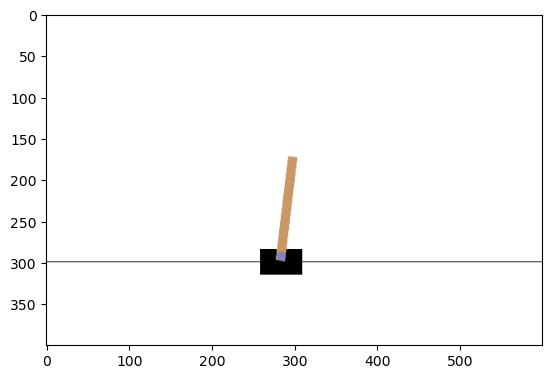

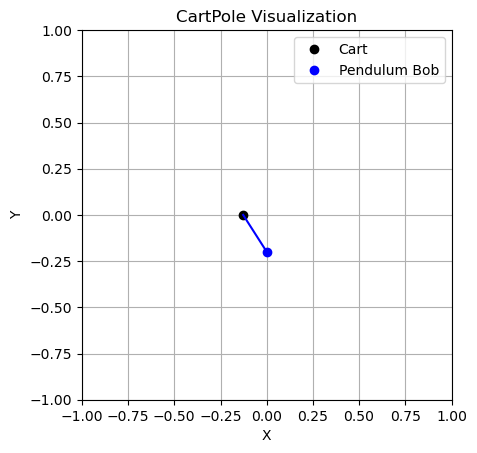


STEP:  11
CART POSITION:  -0.15474693
CART VELOCITY:  -1.5637027
POLE ANGLE WRT CART:  0.16236302
VELOCITY AT TOP OF POLE:  2.4004226
ACTION: Push cart to left


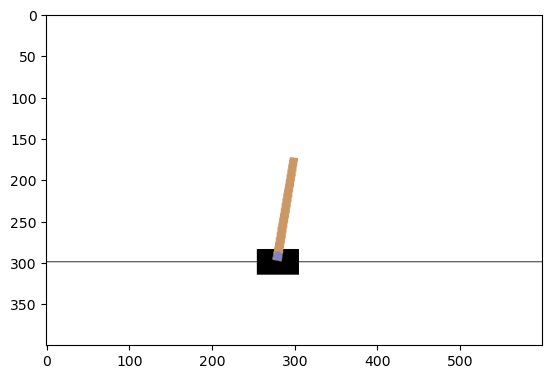

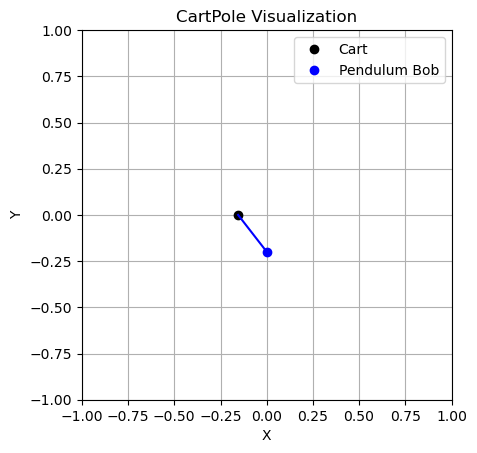


STEP:  1
CART POSITION:  -0.034174185
CART VELOCITY:  -0.04296477
POLE ANGLE WRT CART:  0.0146619715
VELOCITY AT TOP OF POLE:  0.04688147
ACTION: Push cart to left


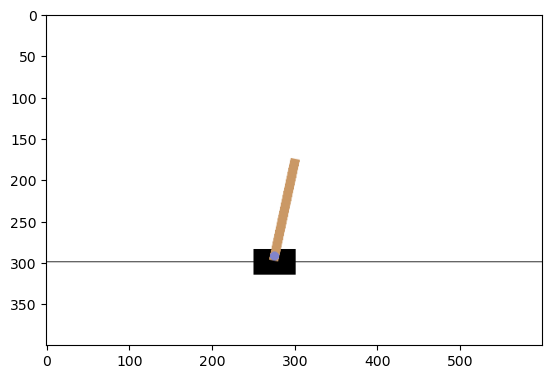

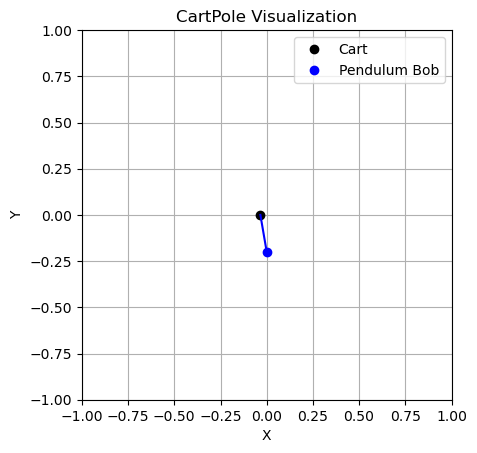


STEP:  2
CART POSITION:  -0.03503348
CART VELOCITY:  -0.23829386
POLE ANGLE WRT CART:  0.015599601
VELOCITY AT TOP OF POLE:  0.3441541
ACTION: Push cart to right


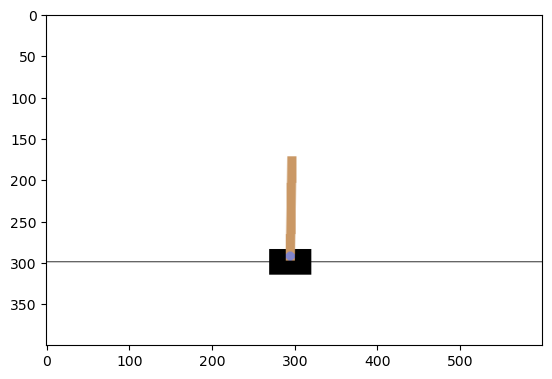

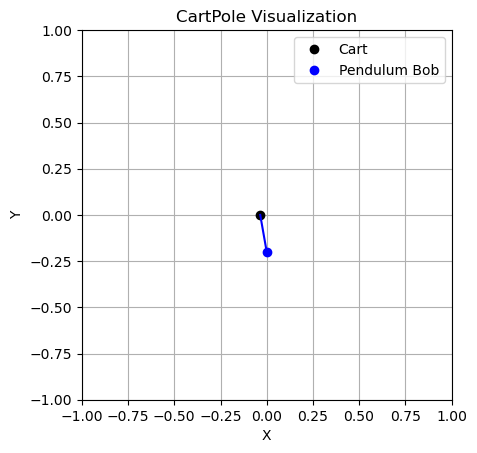


STEP:  3
CART POSITION:  -0.03979936
CART VELOCITY:  -0.043397263
POLE ANGLE WRT CART:  0.022482682
VELOCITY AT TOP OF POLE:  0.056430846
ACTION: Push cart to right


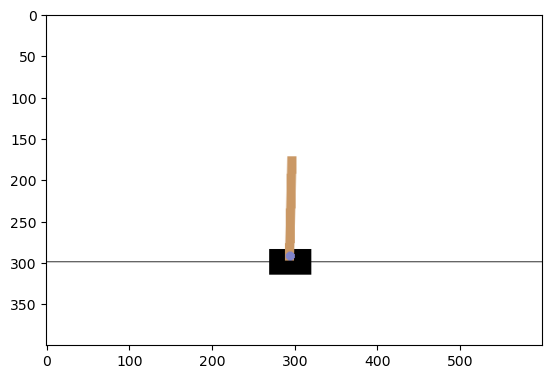

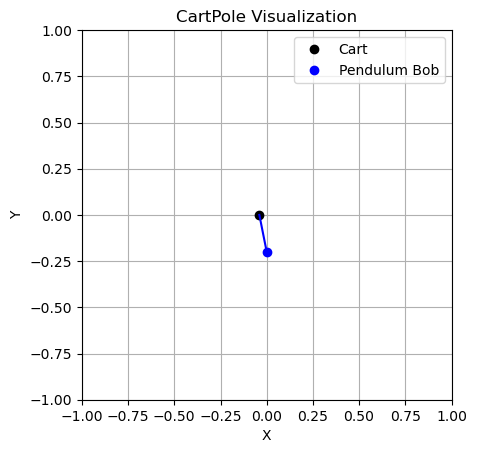


STEP:  4
CART POSITION:  -0.040667303
CART VELOCITY:  0.15139523
POLE ANGLE WRT CART:  0.0236113
VELOCITY AT TOP OF POLE:  -0.2290747
ACTION: Push cart to right


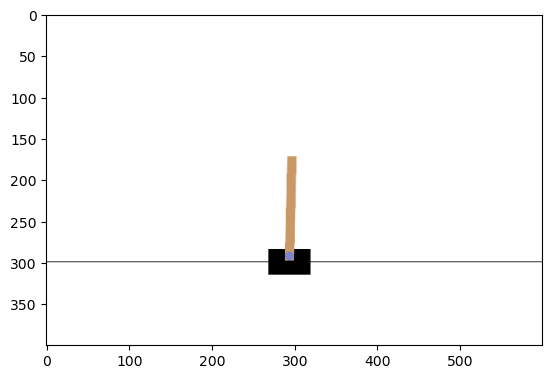

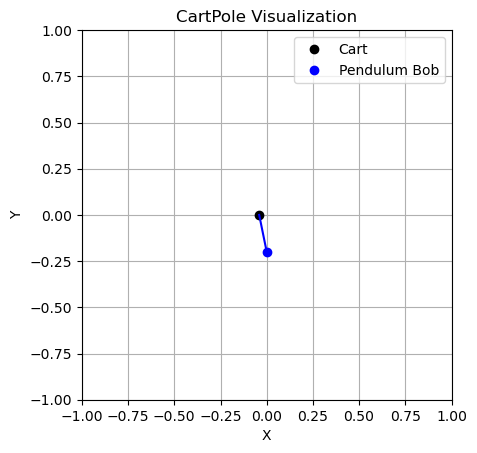


STEP:  5
CART POSITION:  -0.037639398
CART VELOCITY:  0.34617195
POLE ANGLE WRT CART:  0.019029805
VELOCITY AT TOP OF POLE:  -0.51421726
ACTION: Push cart to left


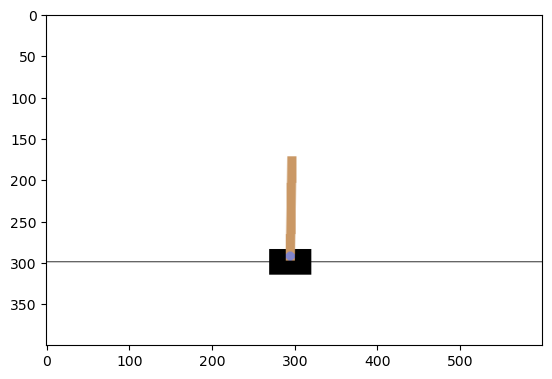

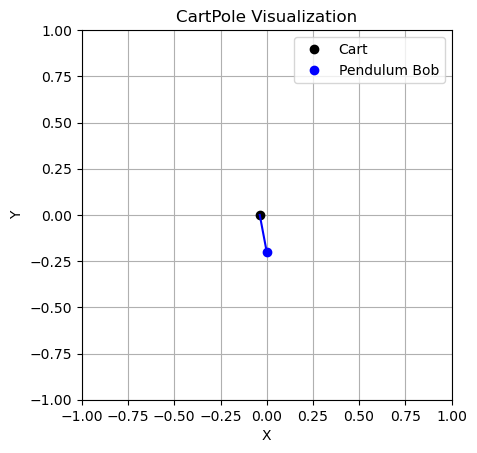


STEP:  6
CART POSITION:  -0.03071596
CART VELOCITY:  0.15078723
POLE ANGLE WRT CART:  0.00874546
VELOCITY AT TOP OF POLE:  -0.21559884
ACTION: Push cart to right


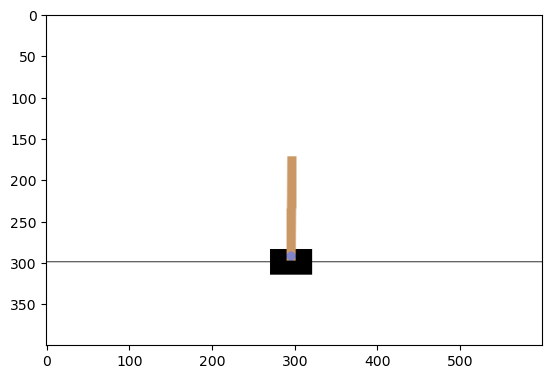

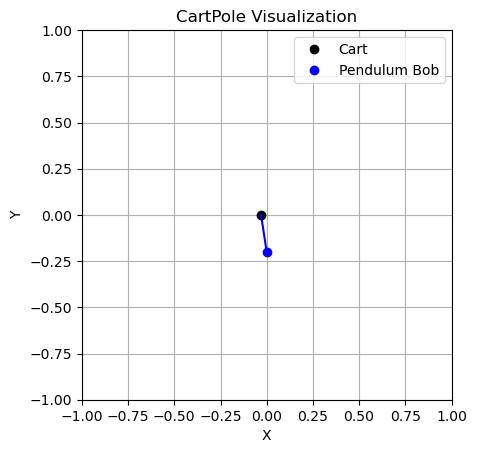


STEP:  7
CART POSITION:  -0.027700216
CART VELOCITY:  0.34578308
POLE ANGLE WRT CART:  0.0044334834
VELOCITY AT TOP OF POLE:  -0.5055103
ACTION: Push cart to right


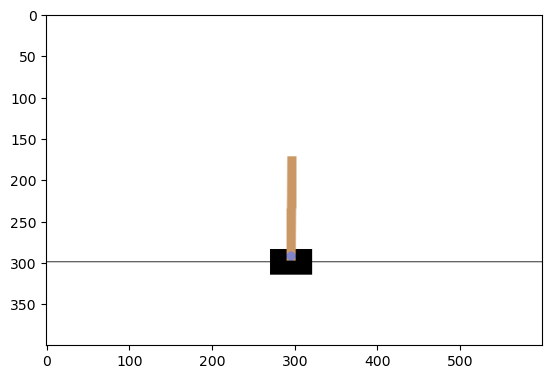

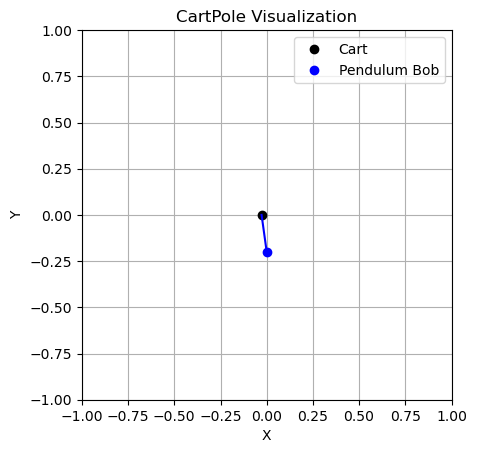


STEP:  8
CART POSITION:  -0.020784553
CART VELOCITY:  0.5408423
POLE ANGLE WRT CART:  -0.005676722
VELOCITY AT TOP OF POLE:  -0.79679275
ACTION: Push cart to right


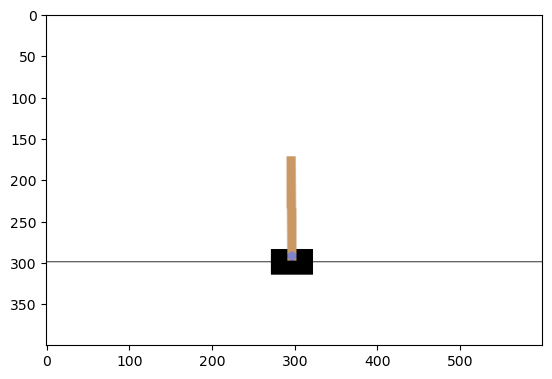

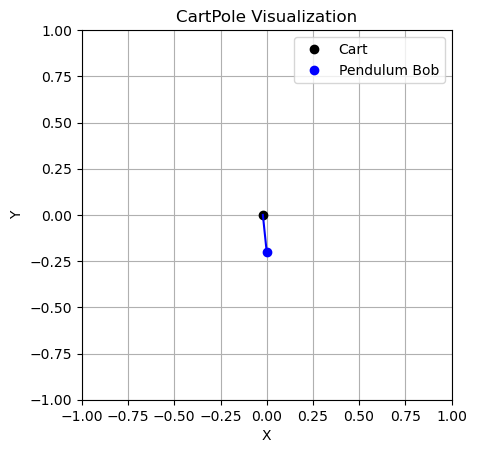


STEP:  9
CART POSITION:  -0.009967708
CART VELOCITY:  0.73604167
POLE ANGLE WRT CART:  -0.021612577
VELOCITY AT TOP OF POLE:  -1.091256
ACTION: Push cart to right


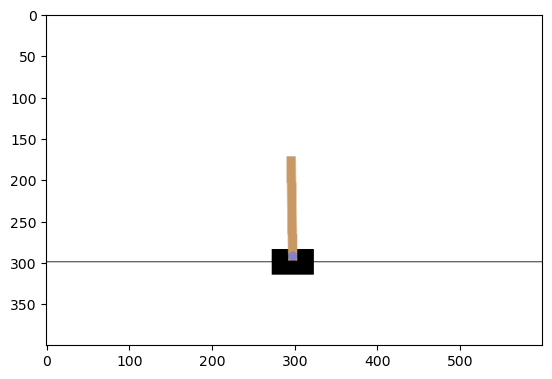

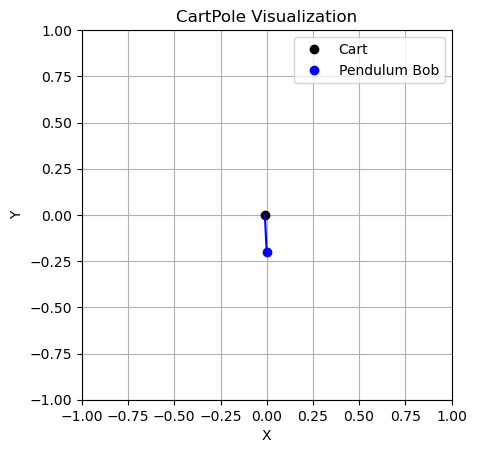


STEP:  10
CART POSITION:  0.004753125
CART VELOCITY:  0.93144166
POLE ANGLE WRT CART:  -0.043437697
VELOCITY AT TOP OF POLE:  -1.3906412
ACTION: Push cart to right


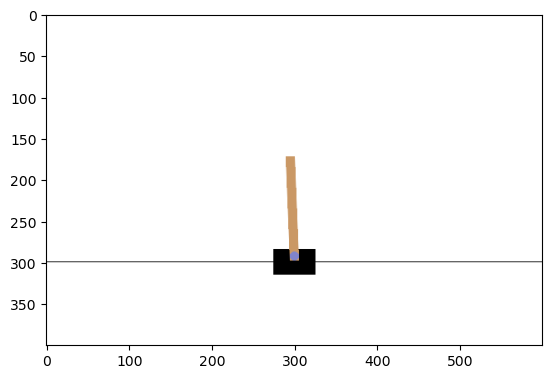

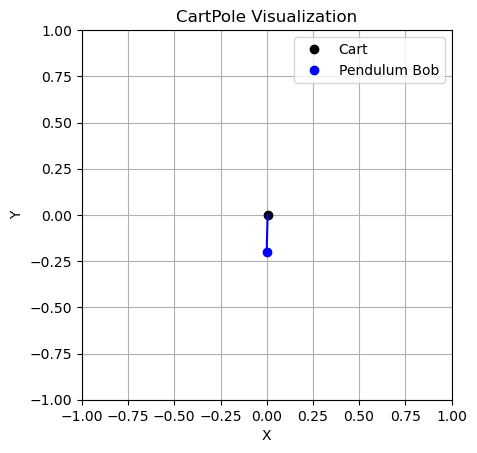


STEP:  11
CART POSITION:  0.023381958
CART VELOCITY:  1.1270769
POLE ANGLE WRT CART:  -0.07125052
VELOCITY AT TOP OF POLE:  -1.6965839
ACTION: Push cart to right


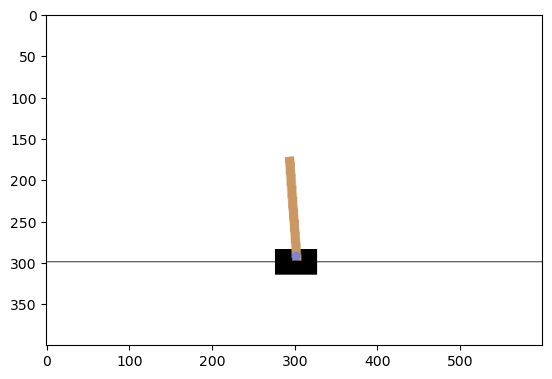

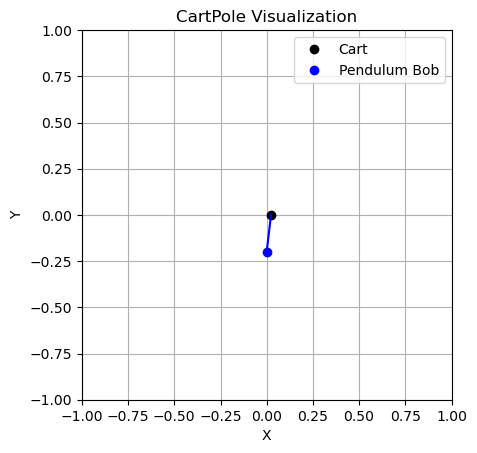


STEP:  12
CART POSITION:  0.045923498
CART VELOCITY:  1.3229446
POLE ANGLE WRT CART:  -0.1051822
VELOCITY AT TOP OF POLE:  -2.01057
ACTION: Push cart to right


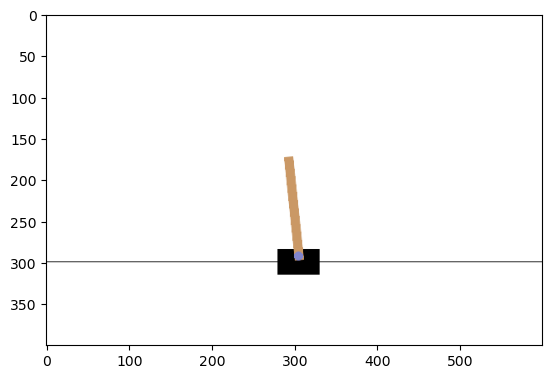

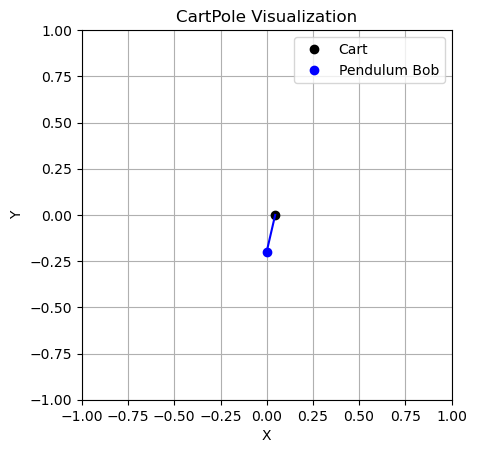


STEP:  13
CART POSITION:  0.07238239
CART VELOCITY:  1.5189918
POLE ANGLE WRT CART:  -0.14539361
VELOCITY AT TOP OF POLE:  -2.333882
ACTION: Push cart to right


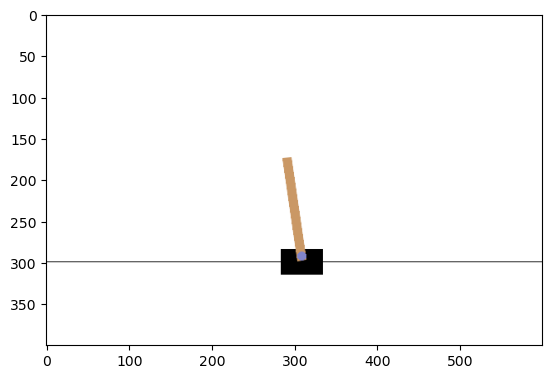

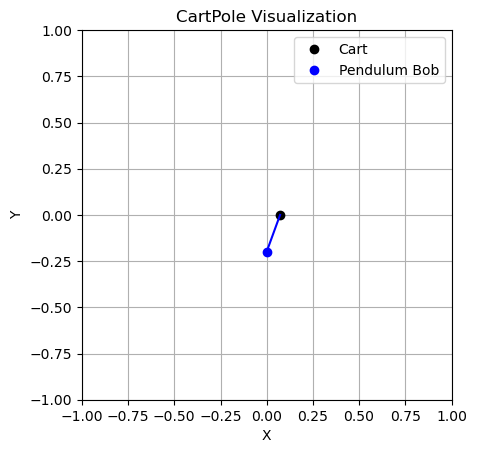


STEP:  14
CART POSITION:  0.10276222
CART VELOCITY:  1.7150985
POLE ANGLE WRT CART:  -0.19207124
VELOCITY AT TOP OF POLE:  -2.6675339
ACTION: Push cart to right


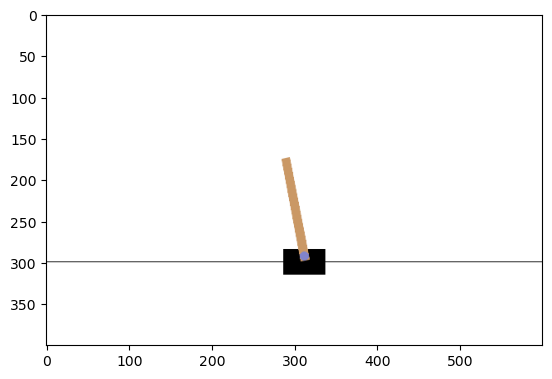

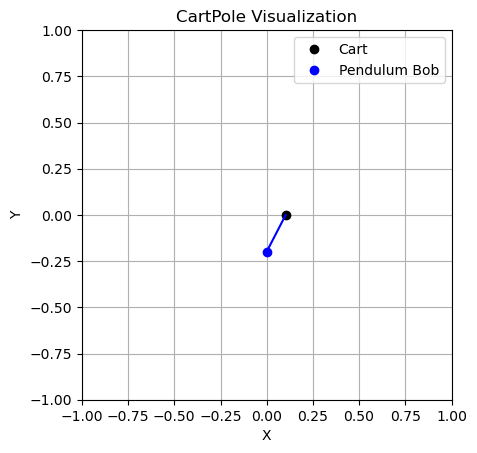


STEP:  1
CART POSITION:  0.03782861
CART VELOCITY:  0.0194792
POLE ANGLE WRT CART:  -0.028408764
VELOCITY AT TOP OF POLE:  -0.0015208443
ACTION: Push cart to left


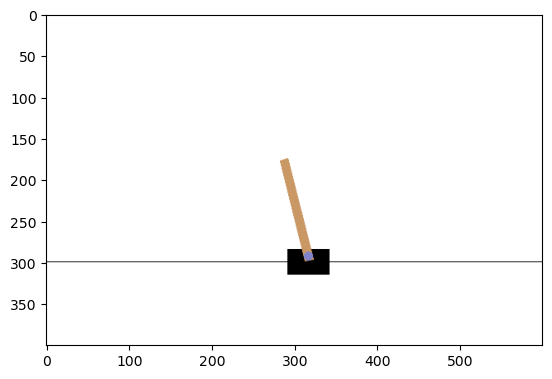

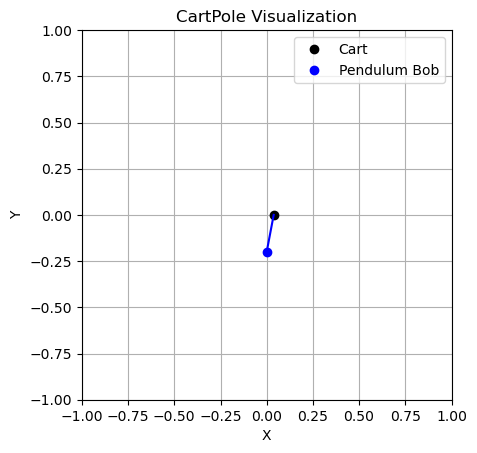


STEP:  2
CART POSITION:  0.038218193
CART VELOCITY:  -0.17522405
POLE ANGLE WRT CART:  -0.028439179
VELOCITY AT TOP OF POLE:  0.28206512
ACTION: Push cart to right


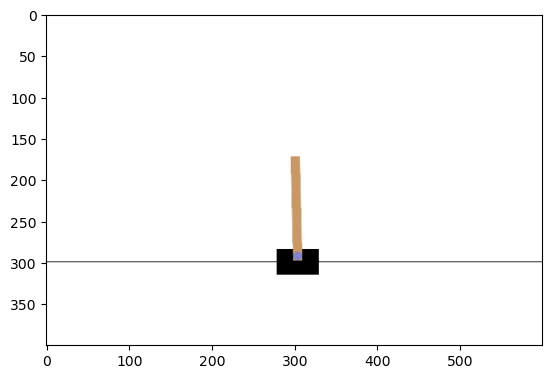

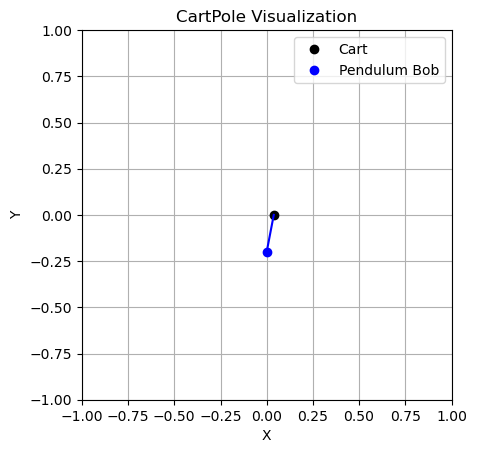


STEP:  3
CART POSITION:  0.03471371
CART VELOCITY:  0.020291762
POLE ANGLE WRT CART:  -0.022797877
VELOCITY AT TOP OF POLE:  -0.01944999
ACTION: Push cart to right


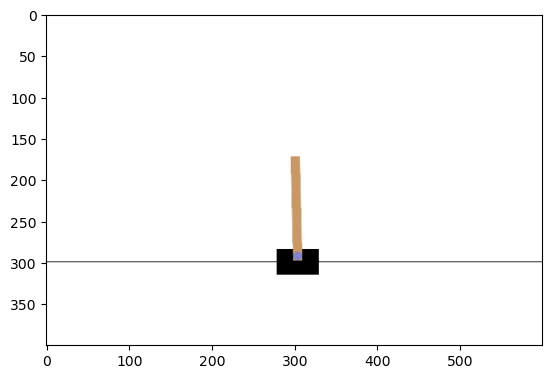

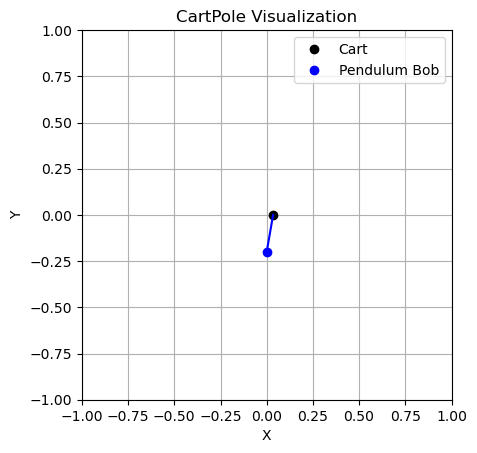


STEP:  4
CART POSITION:  0.035119545
CART VELOCITY:  0.21573311
POLE ANGLE WRT CART:  -0.023186877
VELOCITY AT TOP OF POLE:  -0.31923783
ACTION: Push cart to right


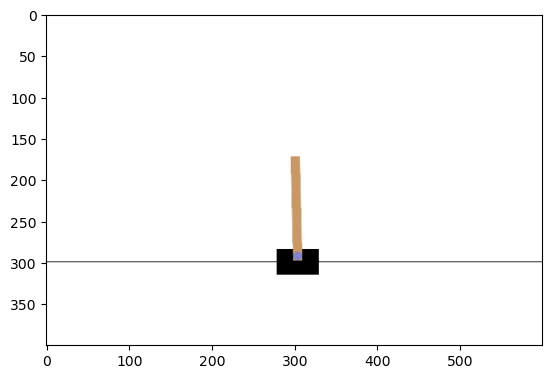

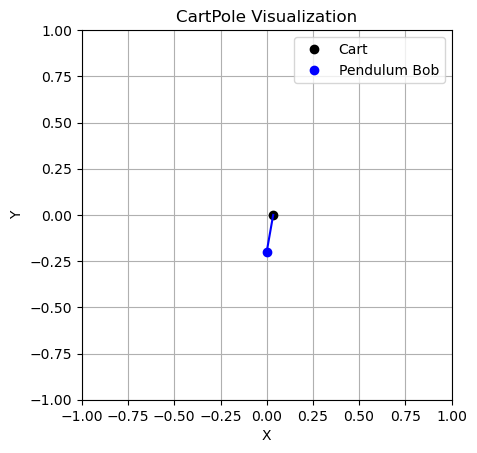


STEP:  5
CART POSITION:  0.03943421
CART VELOCITY:  0.4111775
POLE ANGLE WRT CART:  -0.029571634
VELOCITY AT TOP OF POLE:  -0.61914194
ACTION: Push cart to right


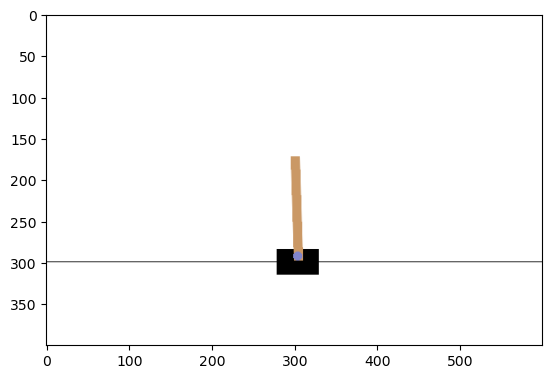

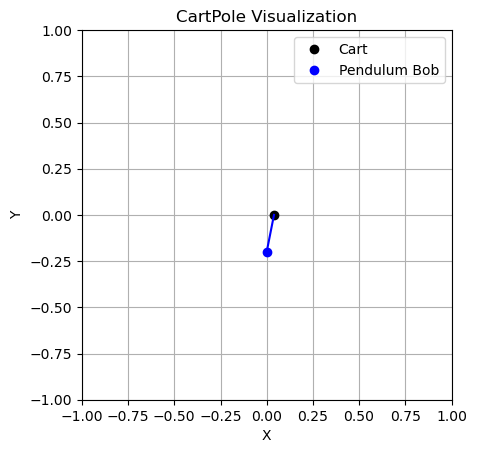


STEP:  6
CART POSITION:  0.047657758
CART VELOCITY:  0.6066997
POLE ANGLE WRT CART:  -0.041954473
VELOCITY AT TOP OF POLE:  -0.9209899
ACTION: Push cart to right


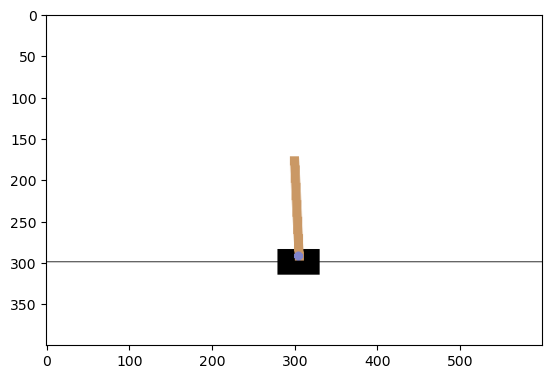

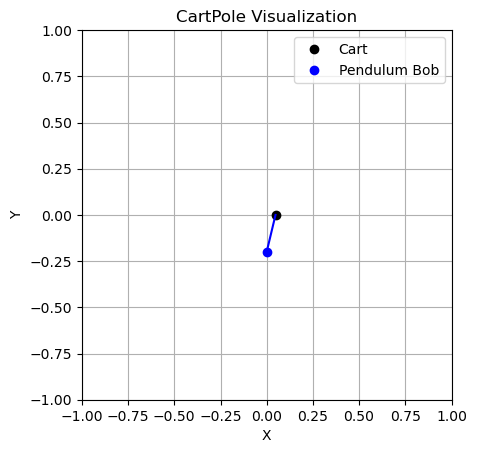


STEP:  7
CART POSITION:  0.059791755
CART VELOCITY:  0.80236274
POLE ANGLE WRT CART:  -0.060374267
VELOCITY AT TOP OF POLE:  -1.2265571
ACTION: Push cart to right


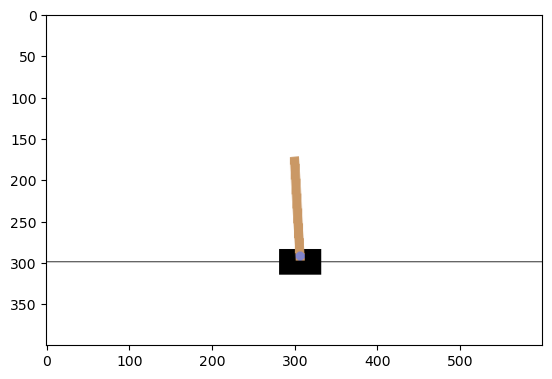

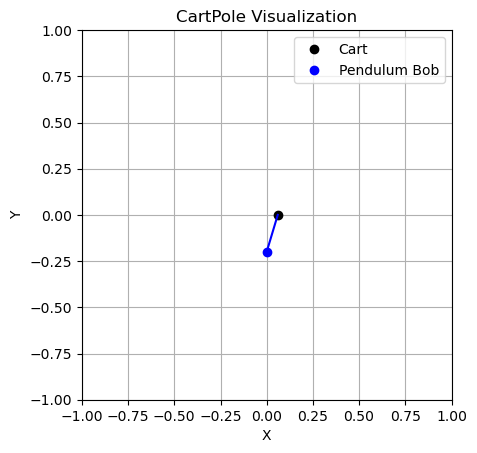


STEP:  8
CART POSITION:  0.075839005
CART VELOCITY:  0.99820775
POLE ANGLE WRT CART:  -0.08490541
VELOCITY AT TOP OF POLE:  -1.5375286
ACTION: Push cart to right


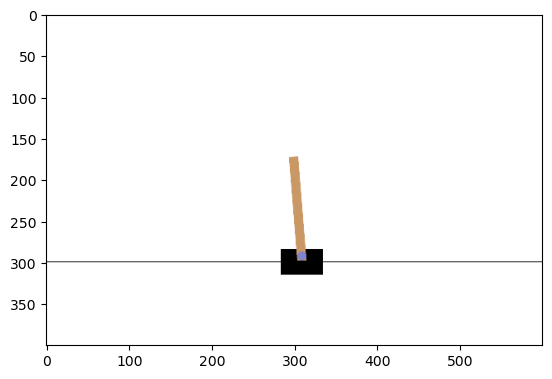

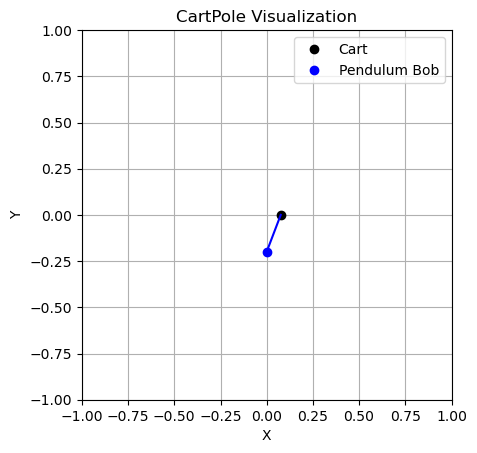


STEP:  9
CART POSITION:  0.095803164
CART VELOCITY:  1.1942428
POLE ANGLE WRT CART:  -0.11565598
VELOCITY AT TOP OF POLE:  -1.8554541
ACTION: Push cart to right


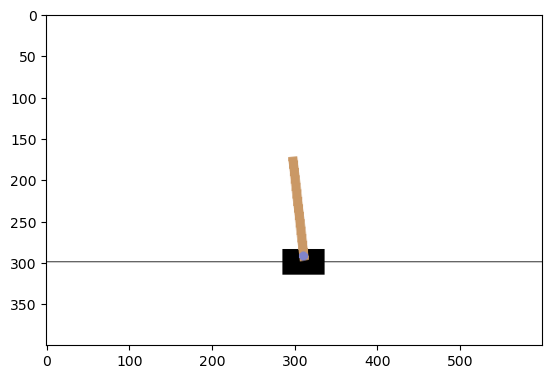

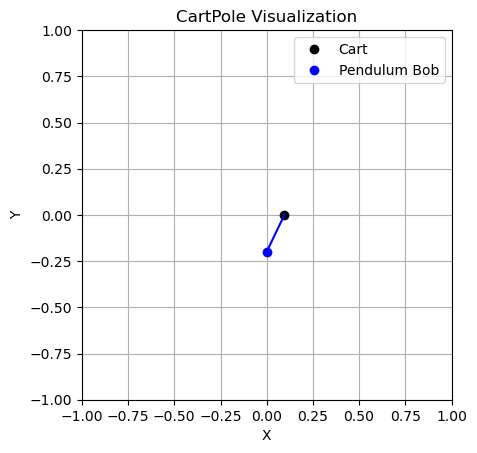


STEP:  10
CART POSITION:  0.11968802
CART VELOCITY:  1.3904299
POLE ANGLE WRT CART:  -0.15276507
VELOCITY AT TOP OF POLE:  -2.181696
ACTION: Push cart to right


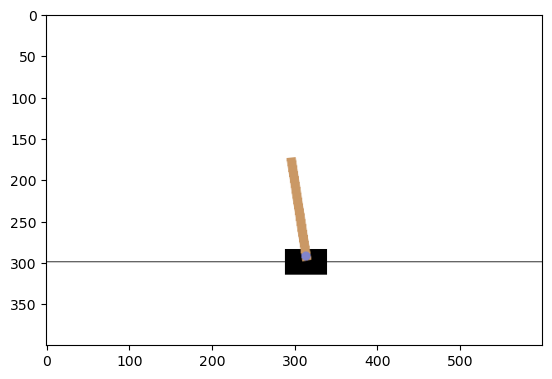

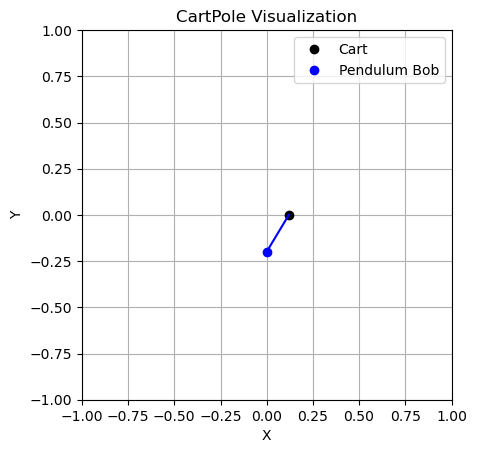


STEP:  11
CART POSITION:  0.14749661
CART VELOCITY:  1.5866697
POLE ANGLE WRT CART:  -0.19639899
VELOCITY AT TOP OF POLE:  -2.517366
ACTION: Push cart to right


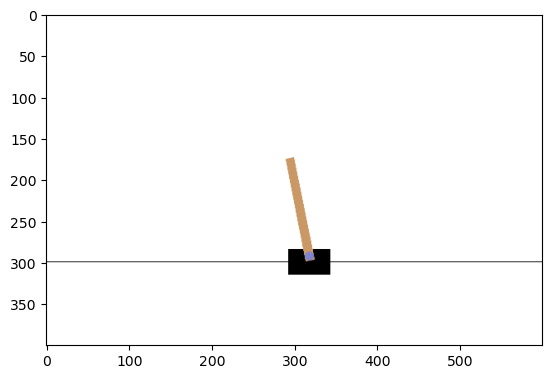

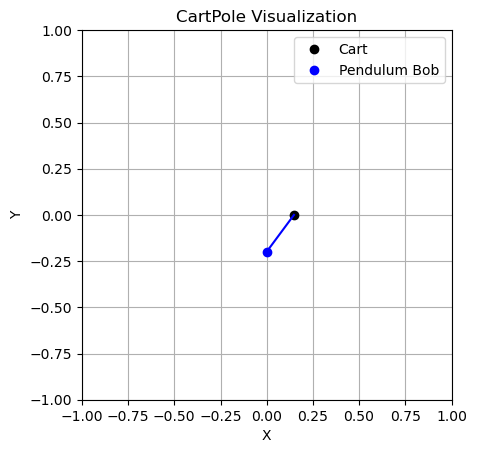


STEP:  1
CART POSITION:  -0.025594264
CART VELOCITY:  -0.018430773
POLE ANGLE WRT CART:  0.042871
VELOCITY AT TOP OF POLE:  0.03563386
ACTION: Push cart to right


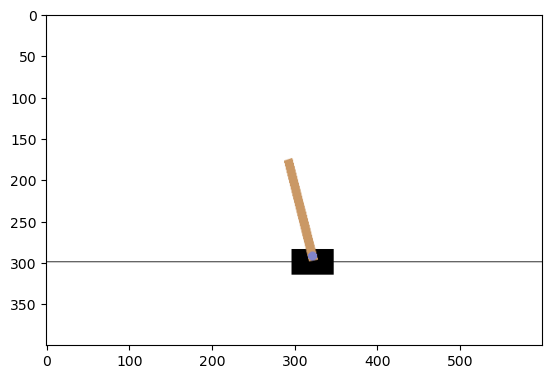

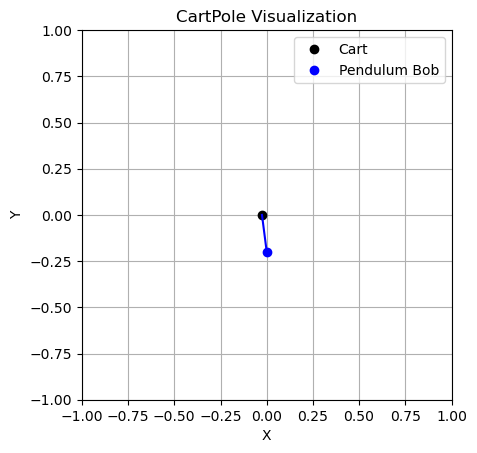


STEP:  2
CART POSITION:  -0.02596288
CART VELOCITY:  0.176051
POLE ANGLE WRT CART:  0.043583672
VELOCITY AT TOP OF POLE:  -0.24322057
ACTION: Push cart to right


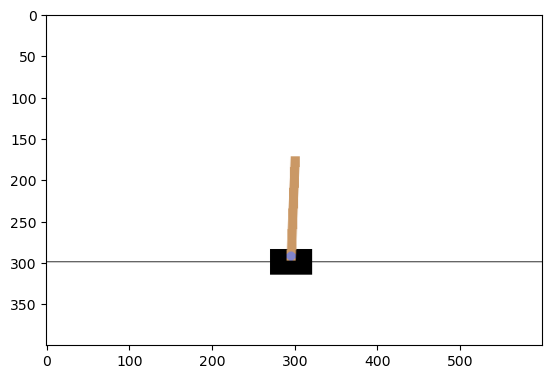

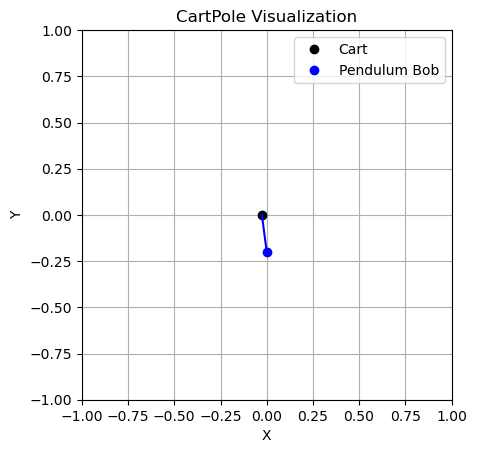


STEP:  3
CART POSITION:  -0.022441858
CART VELOCITY:  0.3705242
POLE ANGLE WRT CART:  0.038719263
VELOCITY AT TOP OF POLE:  -0.5218438
ACTION: Push cart to left


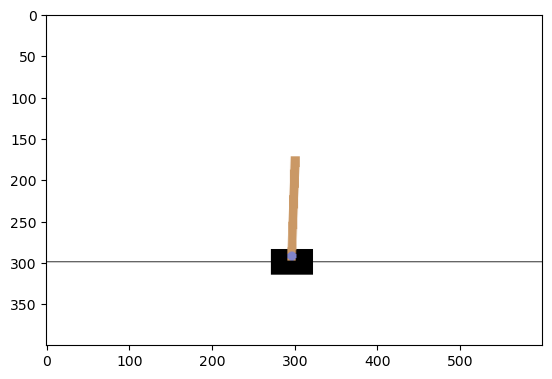

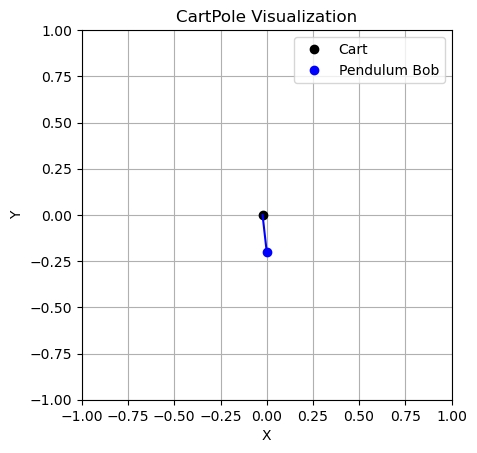


STEP:  4
CART POSITION:  -0.015031375
CART VELOCITY:  0.17487925
POLE ANGLE WRT CART:  0.028282387
VELOCITY AT TOP OF POLE:  -0.2172157
ACTION: Push cart to left


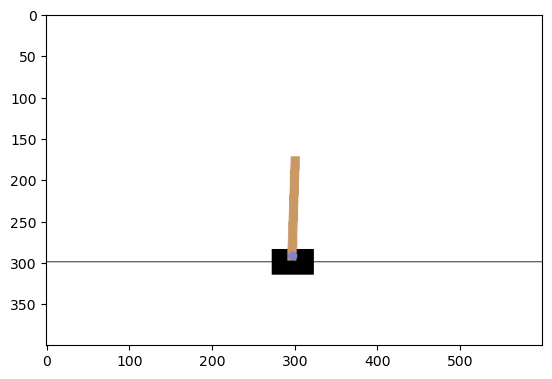

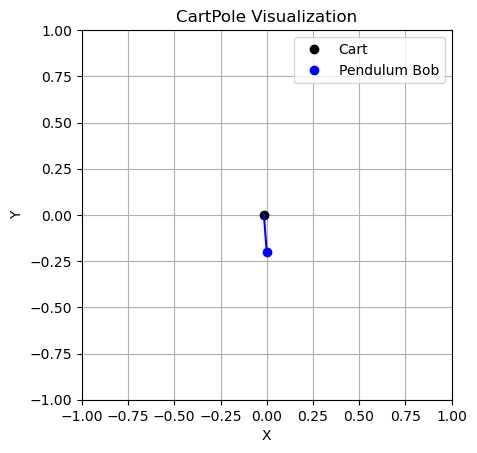


STEP:  5
CART POSITION:  -0.01153379
CART VELOCITY:  -0.020635353
POLE ANGLE WRT CART:  0.023938073
VELOCITY AT TOP OF POLE:  0.08425283
ACTION: Push cart to right


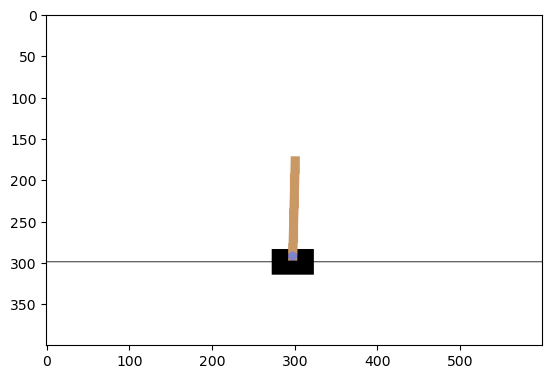

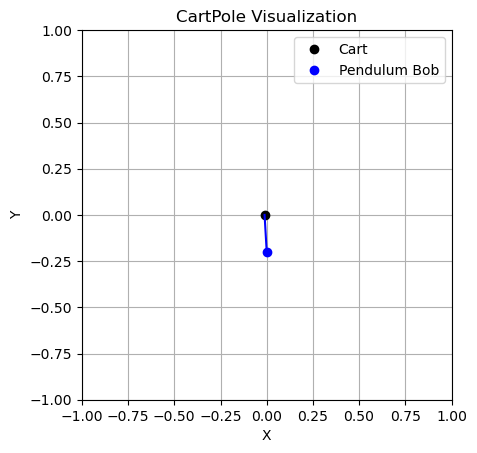


STEP:  6
CART POSITION:  -0.011946497
CART VELOCITY:  0.17413542
POLE ANGLE WRT CART:  0.02562313
VELOCITY AT TOP OF POLE:  -0.20078251
ACTION: Push cart to right


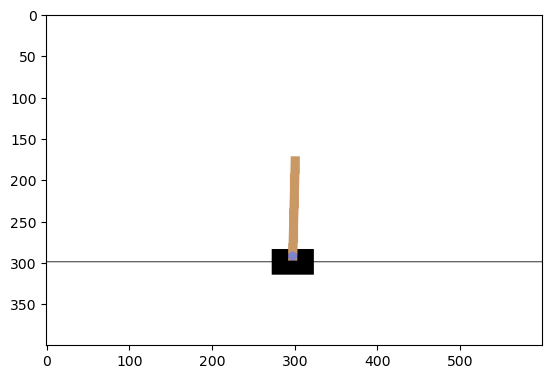

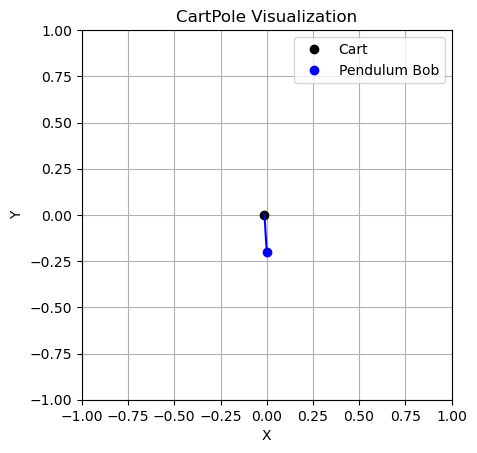


STEP:  7
CART POSITION:  -0.008463789
CART VELOCITY:  0.3688817
POLE ANGLE WRT CART:  0.02160748
VELOCITY AT TOP OF POLE:  -0.4852737
ACTION: Push cart to right


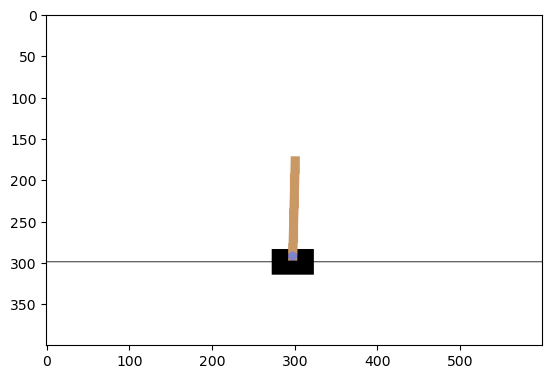

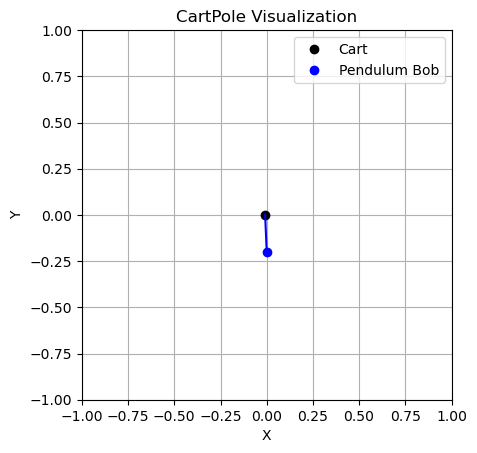


STEP:  8
CART POSITION:  -0.0010861541
CART VELOCITY:  0.5636922
POLE ANGLE WRT CART:  0.011902005
VELOCITY AT TOP OF POLE:  -0.77106905
ACTION: Push cart to right


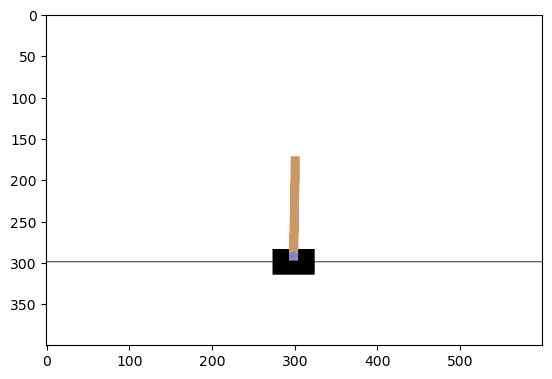

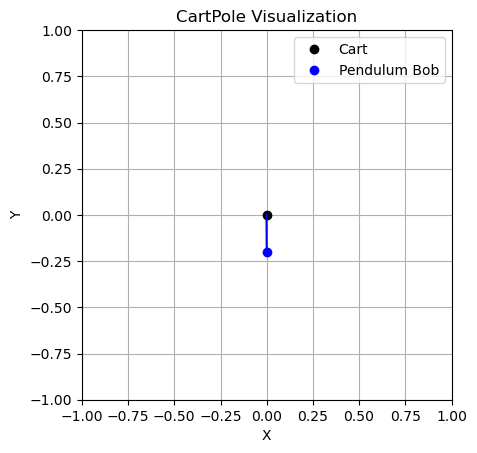


STEP:  9
CART POSITION:  0.01018769
CART VELOCITY:  0.75864834
POLE ANGLE WRT CART:  -0.003519376
VELOCITY AT TOP OF POLE:  -1.0599835
ACTION: Push cart to left


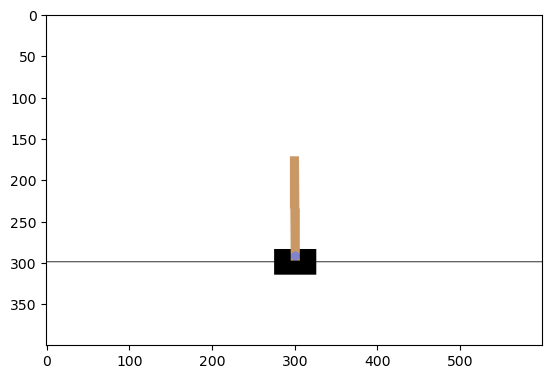

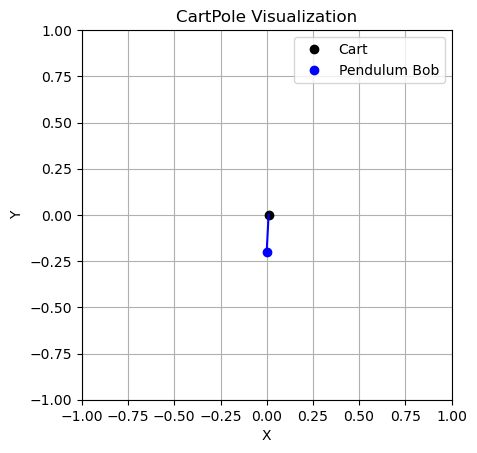


STEP:  10
CART POSITION:  0.025360657
CART VELOCITY:  0.5635732
POLE ANGLE WRT CART:  -0.024719046
VELOCITY AT TOP OF POLE:  -0.7684073
ACTION: Push cart to right


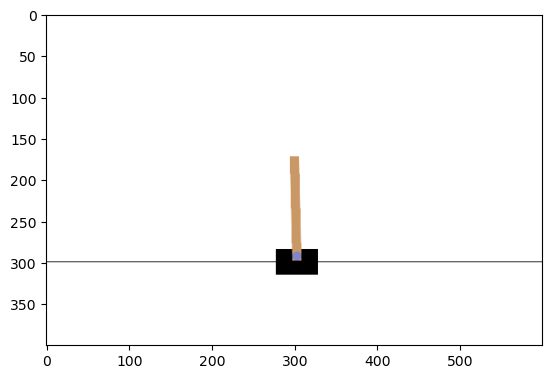

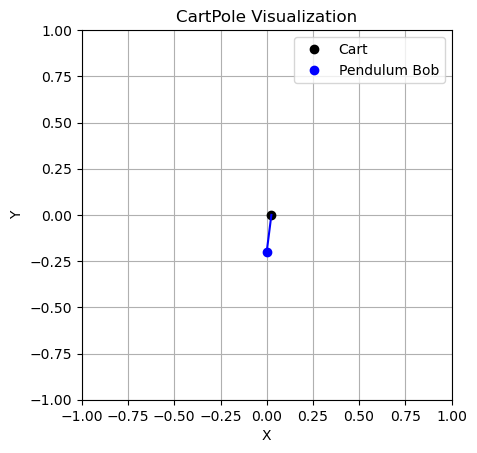


STEP:  11
CART POSITION:  0.03663212
CART VELOCITY:  0.7590265
POLE ANGLE WRT CART:  -0.04008719
VELOCITY AT TOP OF POLE:  -1.0687643
ACTION: Push cart to right


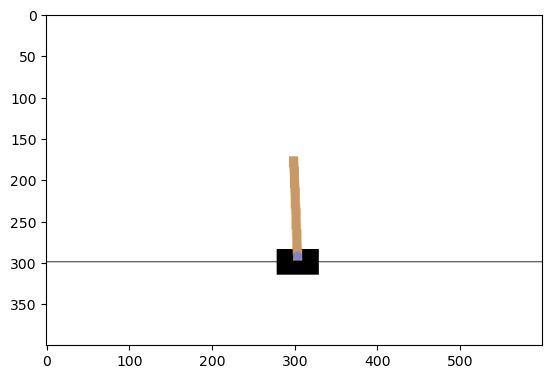

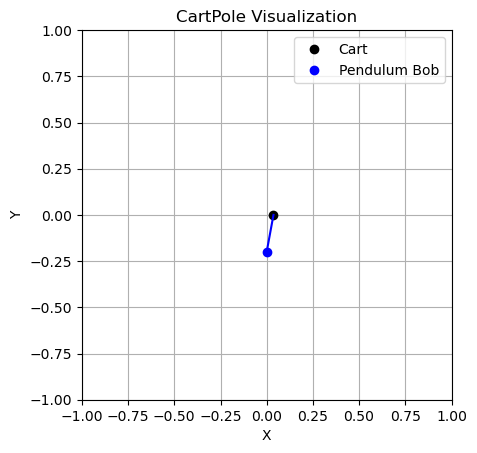


STEP:  12
CART POSITION:  0.051812652
CART VELOCITY:  0.9546551
POLE ANGLE WRT CART:  -0.061462477
VELOCITY AT TOP OF POLE:  -1.373754
ACTION: Push cart to right


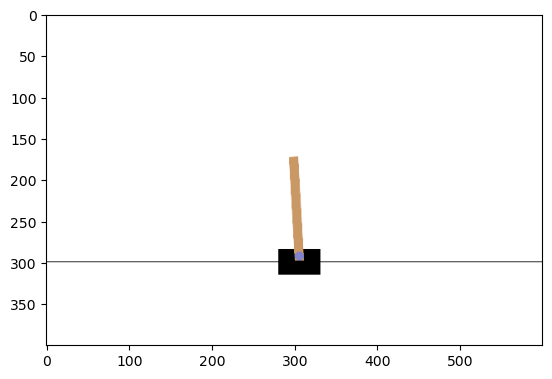

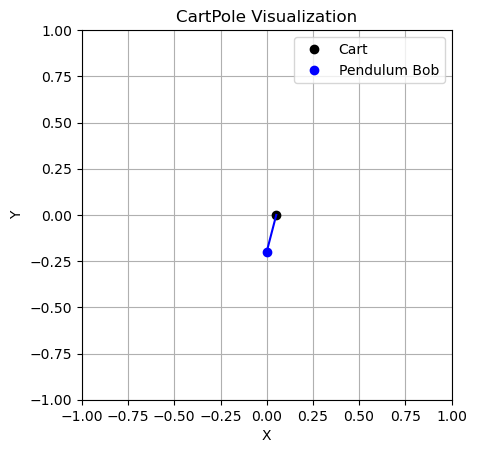


STEP:  13
CART POSITION:  0.07090575
CART VELOCITY:  1.1504892
POLE ANGLE WRT CART:  -0.08893756
VELOCITY AT TOP OF POLE:  -1.685009
ACTION: Push cart to right


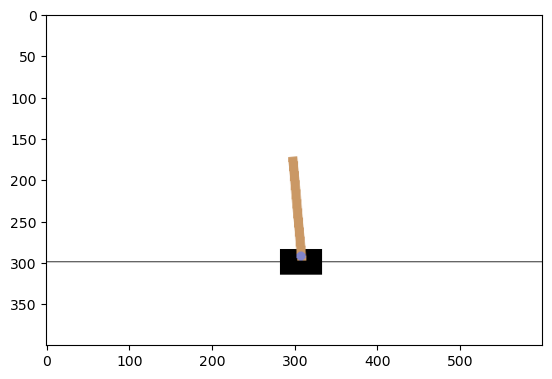

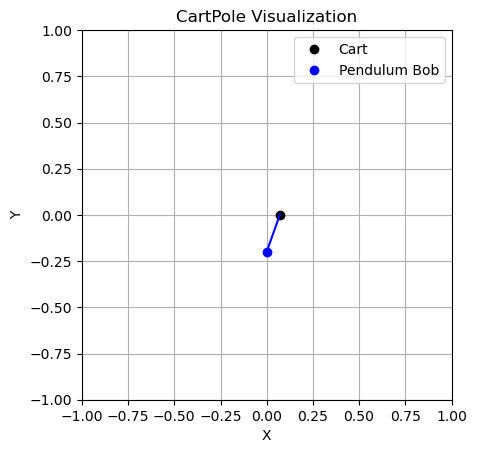


STEP:  14
CART POSITION:  0.09391554
CART VELOCITY:  1.3465207
POLE ANGLE WRT CART:  -0.12263774
VELOCITY AT TOP OF POLE:  -2.0040073
ACTION: Push cart to right


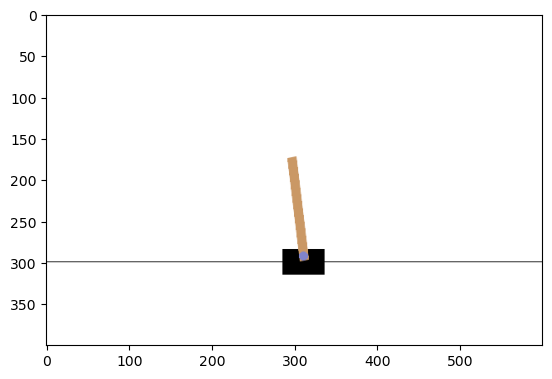

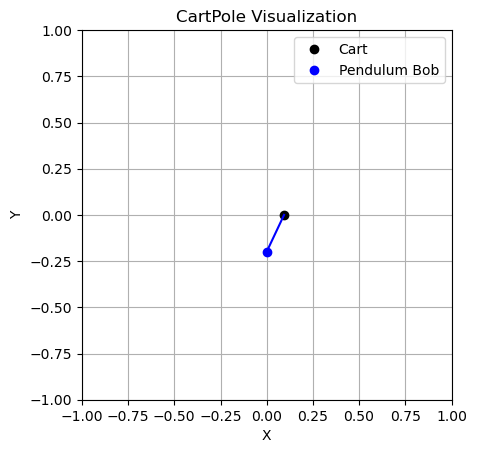


STEP:  15
CART POSITION:  0.12084595
CART VELOCITY:  1.5426898
POLE ANGLE WRT CART:  -0.16271788
VELOCITY AT TOP OF POLE:  -2.332016
ACTION: Push cart to right


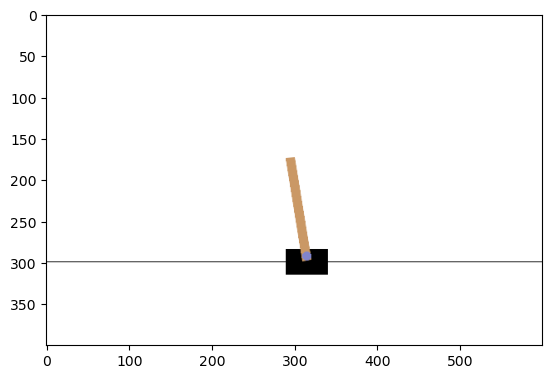

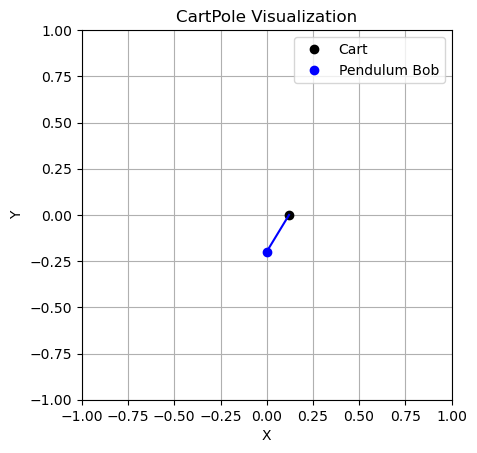


STEP:  16
CART POSITION:  0.15169975
CART VELOCITY:  1.7388681
POLE ANGLE WRT CART:  -0.2093582
VELOCITY AT TOP OF POLE:  -2.6700246
ACTION: Push cart to right


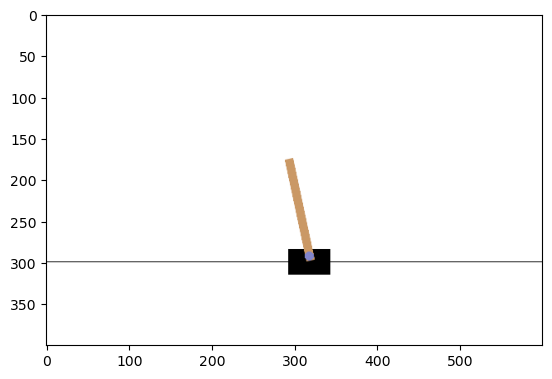

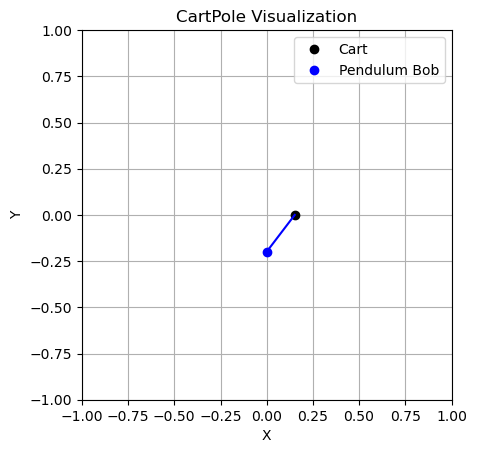


STEP:  1
CART POSITION:  0.0334617
CART VELOCITY:  -0.02449664
POLE ANGLE WRT CART:  -0.045241177
VELOCITY AT TOP OF POLE:  0.027796464
ACTION: Push cart to left


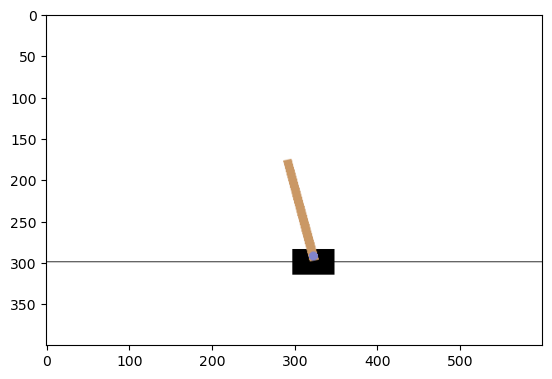

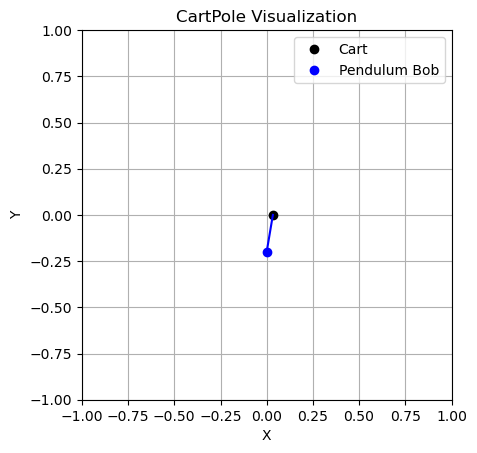


STEP:  2
CART POSITION:  0.032971766
CART VELOCITY:  -0.21894158
POLE ANGLE WRT CART:  -0.04468525
VELOCITY AT TOP OF POLE:  0.30586907
ACTION: Push cart to left


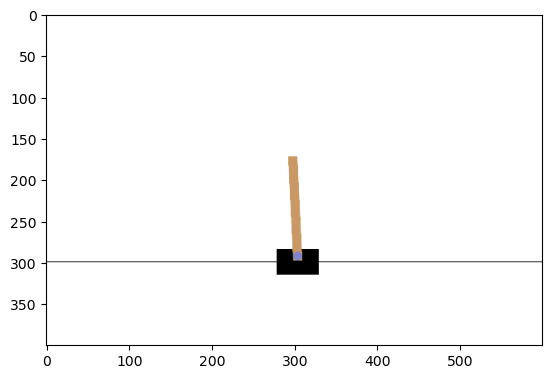

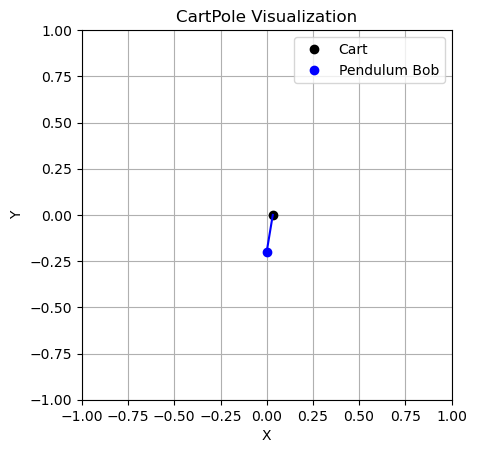


STEP:  3
CART POSITION:  0.028592935
CART VELOCITY:  -0.41339922
POLE ANGLE WRT CART:  -0.038567867
VELOCITY AT TOP OF POLE:  0.5841313
ACTION: Push cart to left


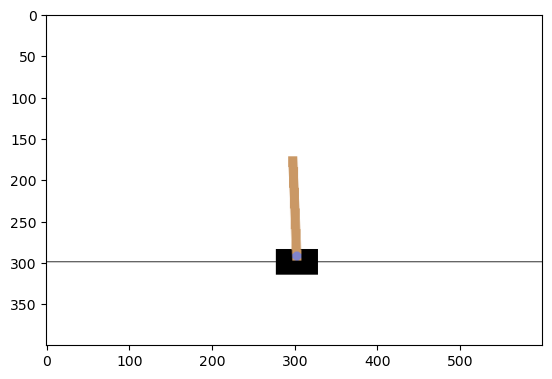

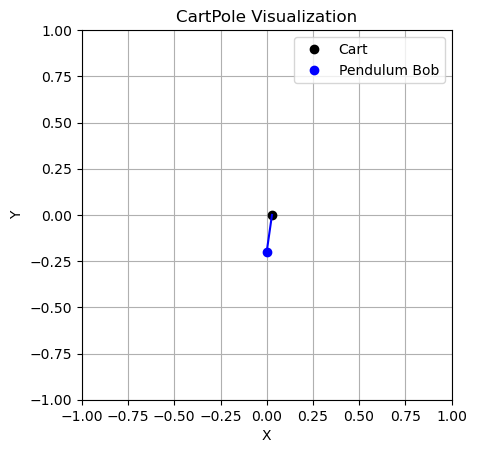


STEP:  4
CART POSITION:  0.020324951
CART VELOCITY:  -0.6079603
POLE ANGLE WRT CART:  -0.026885241
VELOCITY AT TOP OF POLE:  0.8644197
ACTION: Push cart to left


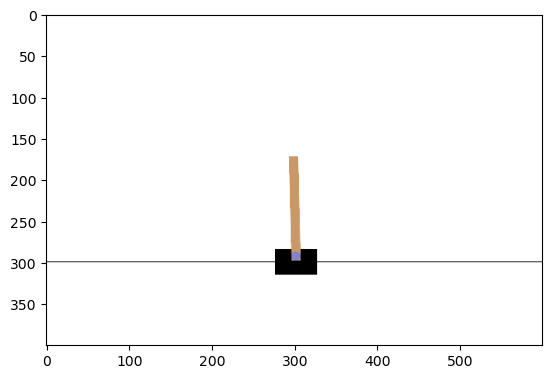

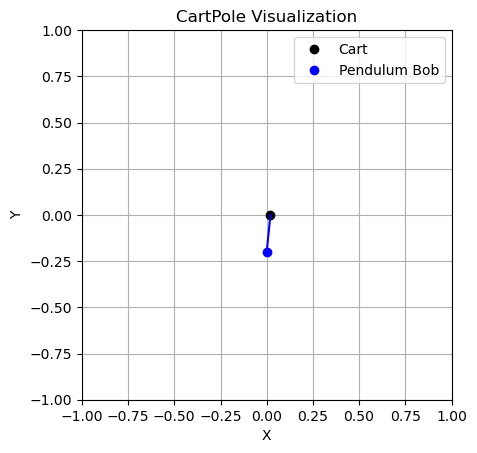


STEP:  5
CART POSITION:  0.008165745
CART VELOCITY:  -0.8027061
POLE ANGLE WRT CART:  -0.009596849
VELOCITY AT TOP OF POLE:  1.1485296
ACTION: Push cart to left


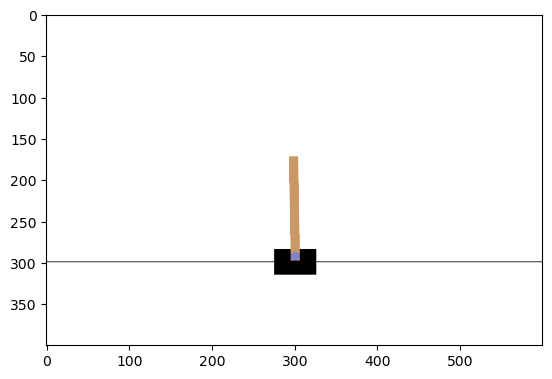

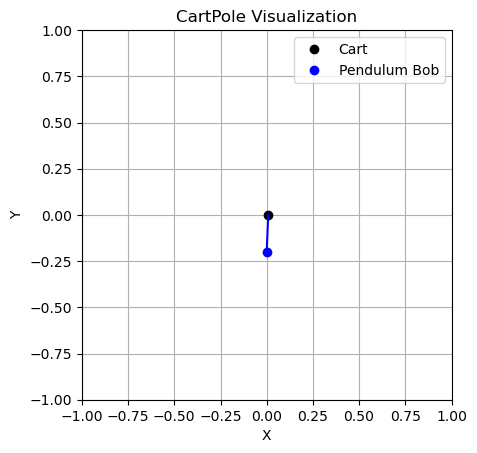


STEP:  6
CART POSITION:  -0.007888378
CART VELOCITY:  -0.9977015
POLE ANGLE WRT CART:  0.013373744
VELOCITY AT TOP OF POLE:  1.4381877
ACTION: Push cart to left


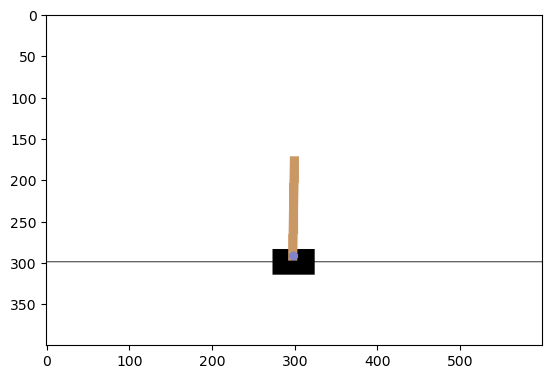

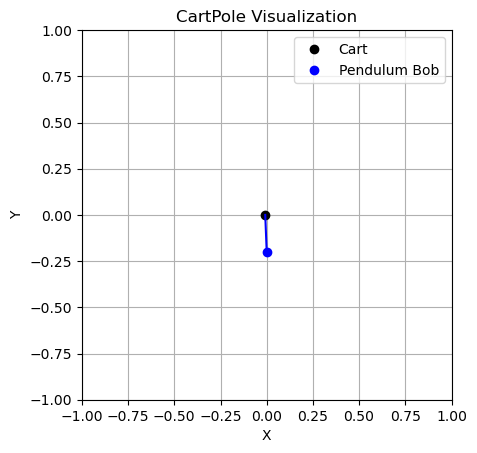


STEP:  7
CART POSITION:  -0.027842408
CART VELOCITY:  -1.1929857
POLE ANGLE WRT CART:  0.0421375
VELOCITY AT TOP OF POLE:  1.7350196
ACTION: Push cart to left


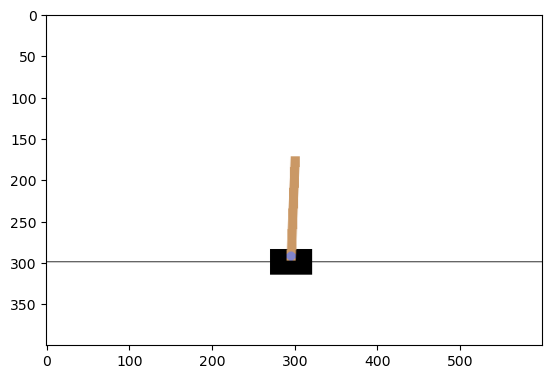

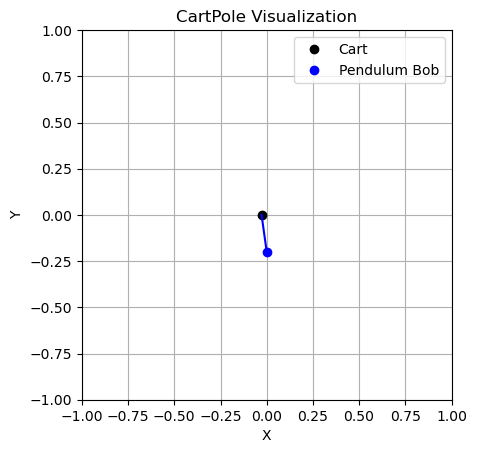


STEP:  8
CART POSITION:  -0.05170212
CART VELOCITY:  -1.3885621
POLE ANGLE WRT CART:  0.07683789
VELOCITY AT TOP OF POLE:  2.0405085
ACTION: Push cart to left


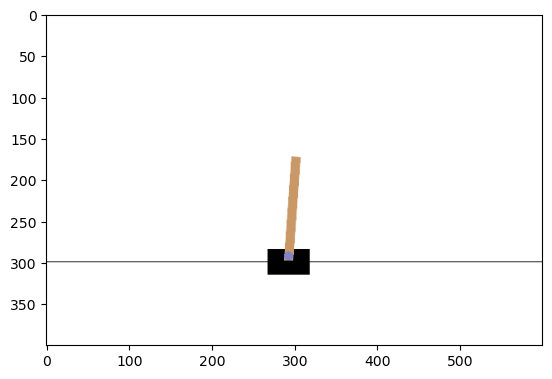

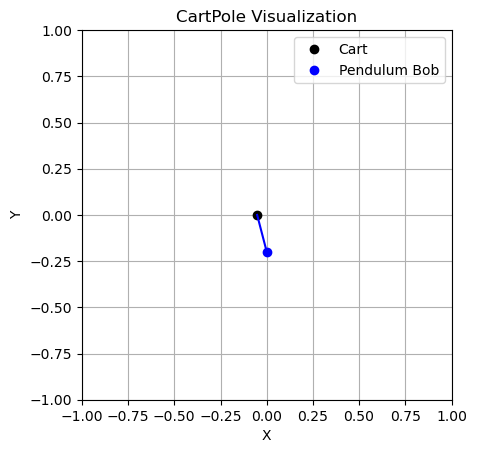


STEP:  9
CART POSITION:  -0.07947336
CART VELOCITY:  -1.5843855
POLE ANGLE WRT CART:  0.117648065
VELOCITY AT TOP OF POLE:  2.355945
ACTION: Push cart to left


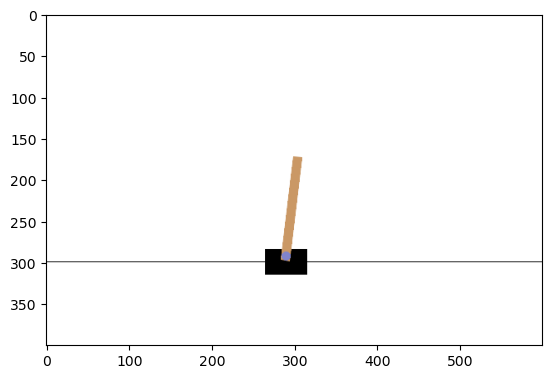

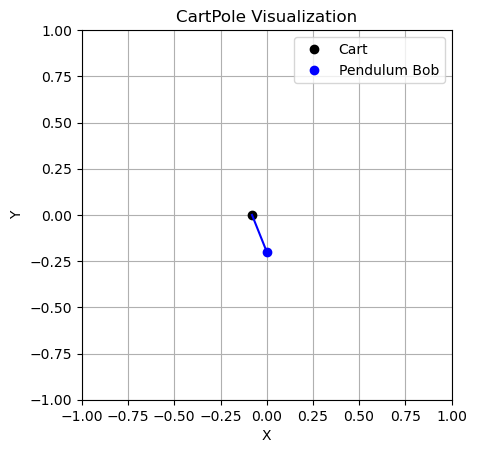


STEP:  10
CART POSITION:  -0.111161076
CART VELOCITY:  -1.7803459
POLE ANGLE WRT CART:  0.16476697
VELOCITY AT TOP OF POLE:  2.6823628
ACTION: Push cart to left


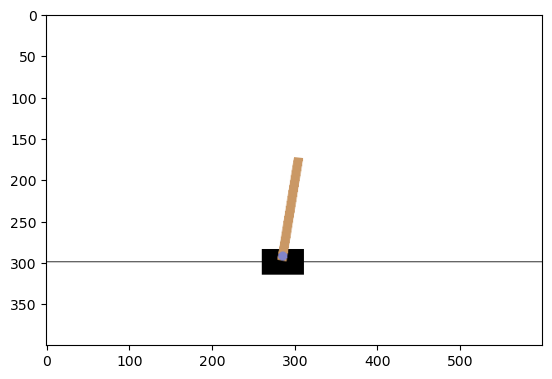

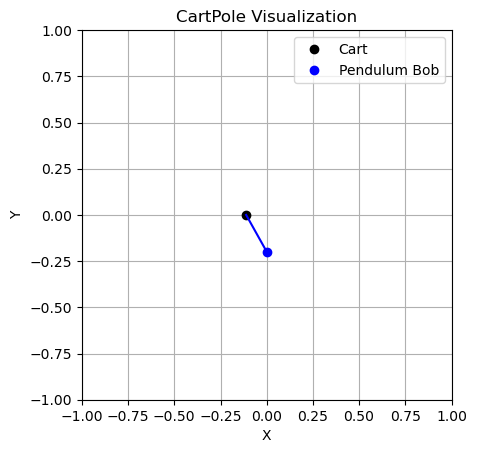


STEP:  1
CART POSITION:  -0.009802038
CART VELOCITY:  -0.044141803
POLE ANGLE WRT CART:  0.03773548
VELOCITY AT TOP OF POLE:  -0.042777956
ACTION: Push cart to left


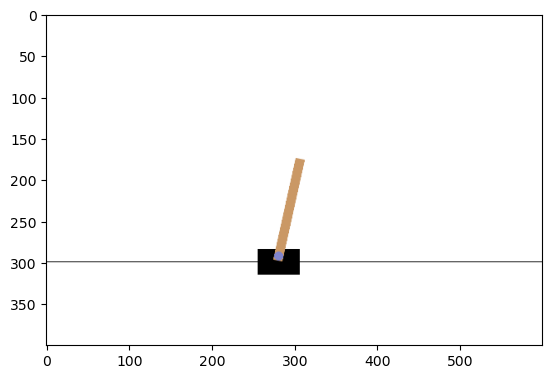

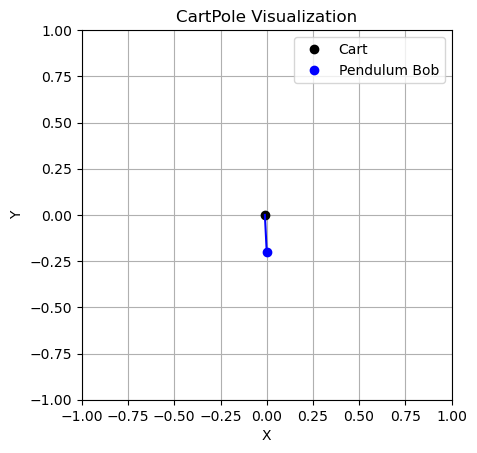


STEP:  2
CART POSITION:  -0.010684874
CART VELOCITY:  -0.23978397
POLE ANGLE WRT CART:  0.03687992
VELOCITY AT TOP OF POLE:  0.26156798
ACTION: Push cart to left


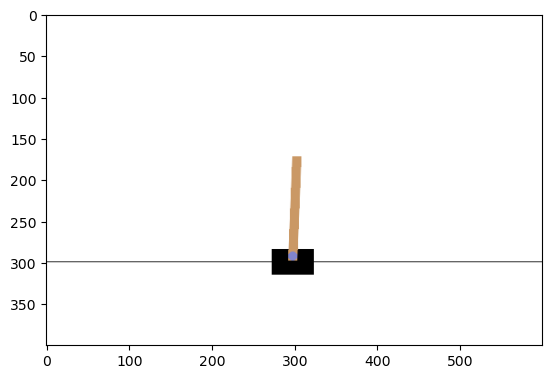

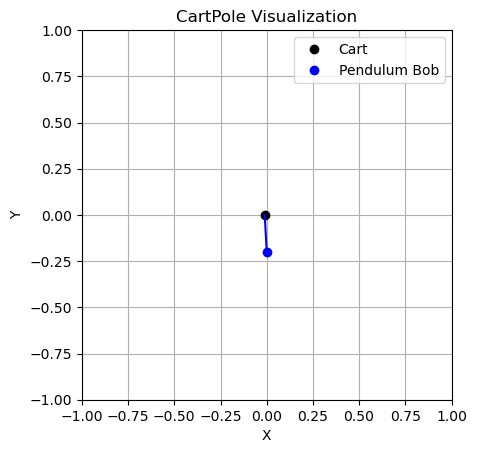


STEP:  3
CART POSITION:  -0.015480554
CART VELOCITY:  -0.43541244
POLE ANGLE WRT CART:  0.04211128
VELOCITY AT TOP OF POLE:  0.5656514
ACTION: Push cart to left


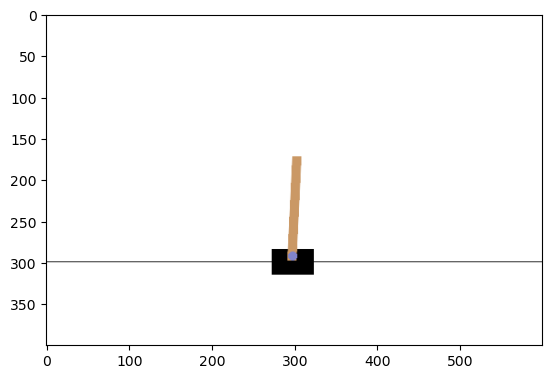

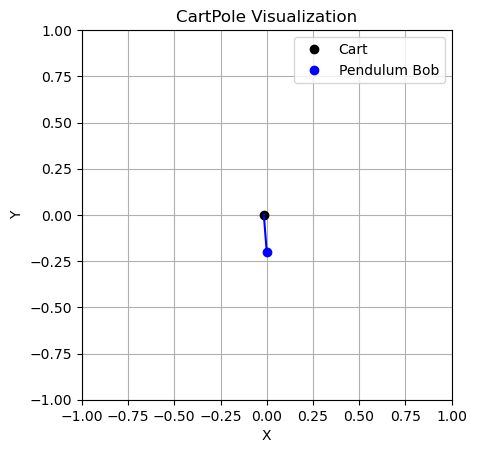


STEP:  4
CART POSITION:  -0.024188802
CART VELOCITY:  -0.6310991
POLE ANGLE WRT CART:  0.053424306
VELOCITY AT TOP OF POLE:  0.8712982
ACTION: Push cart to left


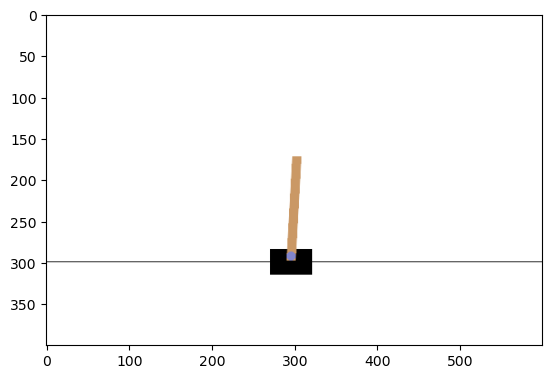

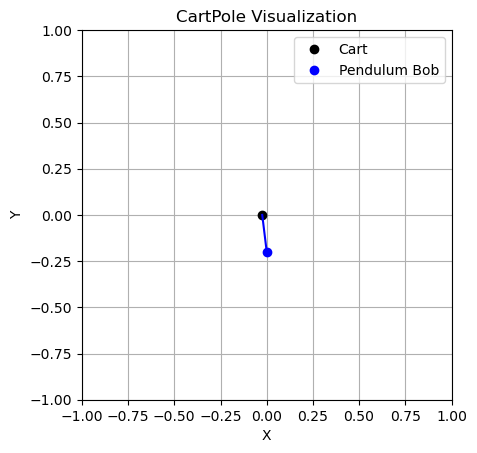


STEP:  5
CART POSITION:  -0.036810786
CART VELOCITY:  -0.82690537
POLE ANGLE WRT CART:  0.070850275
VELOCITY AT TOP OF POLE:  1.1802878
ACTION: Push cart to left


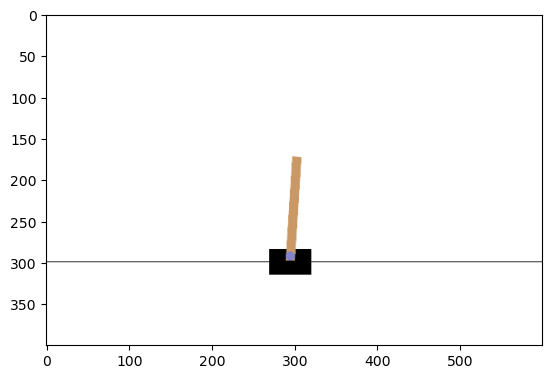

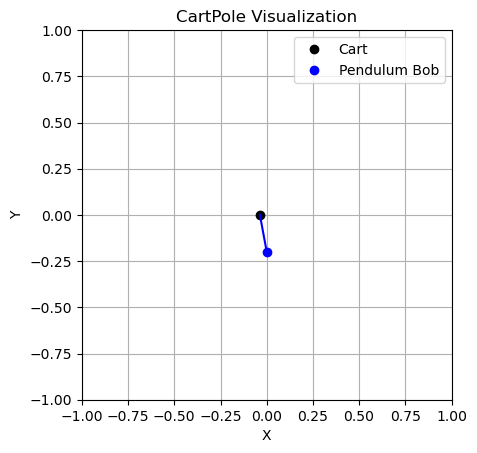


STEP:  6
CART POSITION:  -0.05334889
CART VELOCITY:  -1.022872
POLE ANGLE WRT CART:  0.09445603
VELOCITY AT TOP OF POLE:  1.4943128
ACTION: Push cart to left


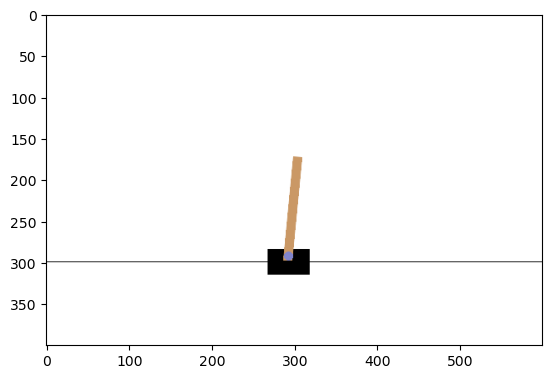

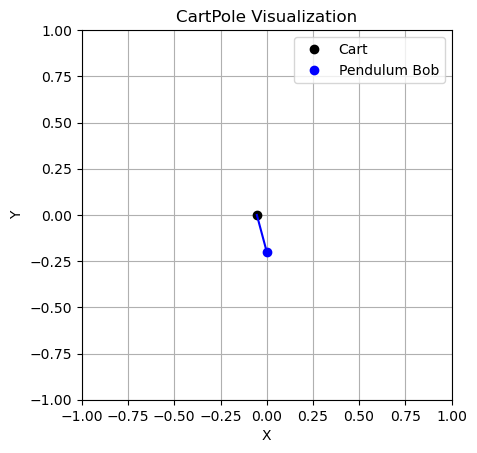


STEP:  7
CART POSITION:  -0.07380633
CART VELOCITY:  -1.2190074
POLE ANGLE WRT CART:  0.124342285
VELOCITY AT TOP OF POLE:  1.8149333
ACTION: Push cart to left


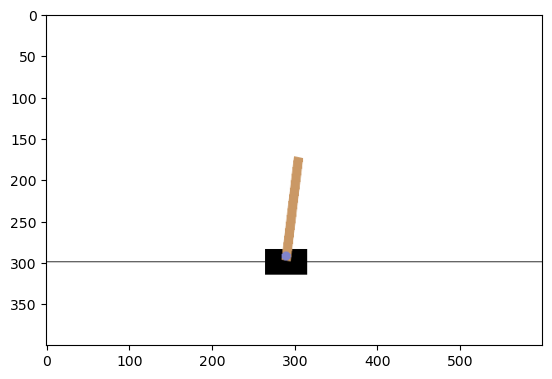

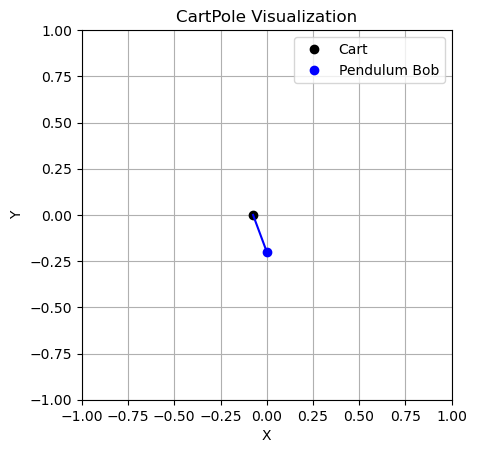


STEP:  8
CART POSITION:  -0.09818648
CART VELOCITY:  -1.4152747
POLE ANGLE WRT CART:  0.16064095
VELOCITY AT TOP OF POLE:  2.143524
ACTION: Push cart to left


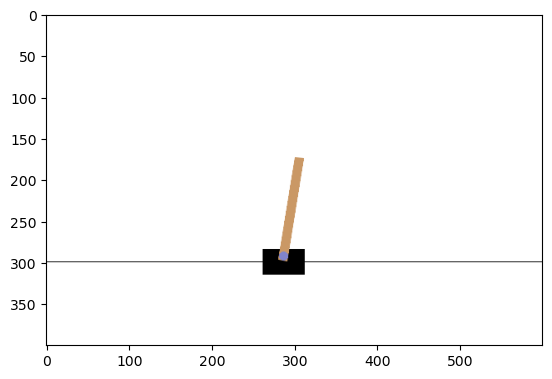

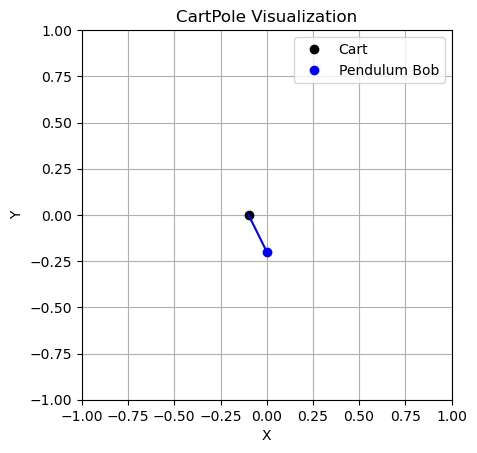


STEP:  9
CART POSITION:  -0.12649198
CART VELOCITY:  -1.6115767
POLE ANGLE WRT CART:  0.20351143
VELOCITY AT TOP OF POLE:  2.4812112
ACTION: Push cart to left


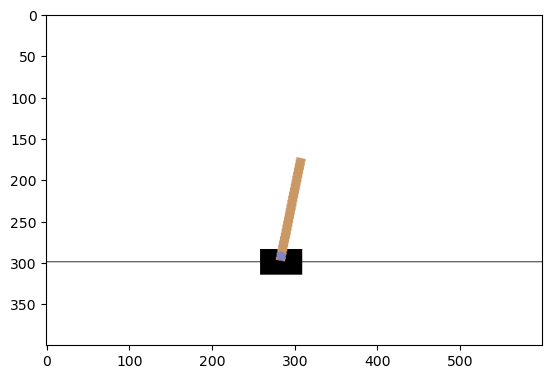

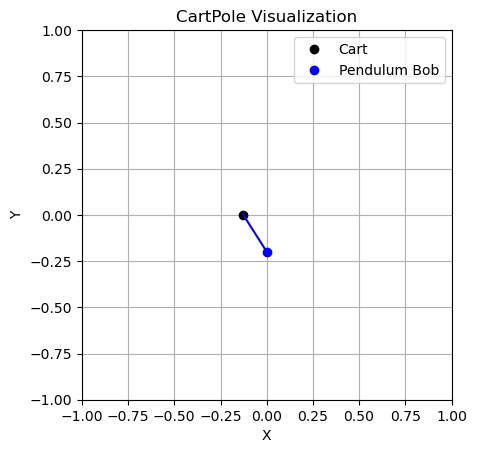


STEP:  1
CART POSITION:  -0.031394914
CART VELOCITY:  0.045950335
POLE ANGLE WRT CART:  -0.021622622
VELOCITY AT TOP OF POLE:  -0.0056491788
ACTION: Push cart to right


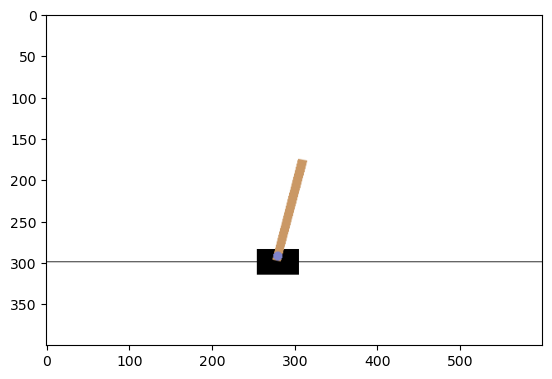

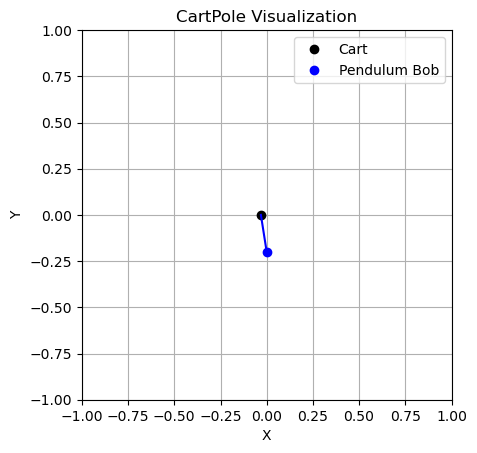


STEP:  2
CART POSITION:  -0.030475905
CART VELOCITY:  0.24137561
POLE ANGLE WRT CART:  -0.021735607
VELOCITY AT TOP OF POLE:  -0.3050751
ACTION: Push cart to left


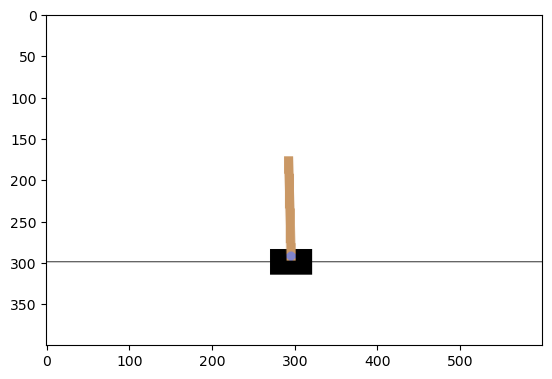

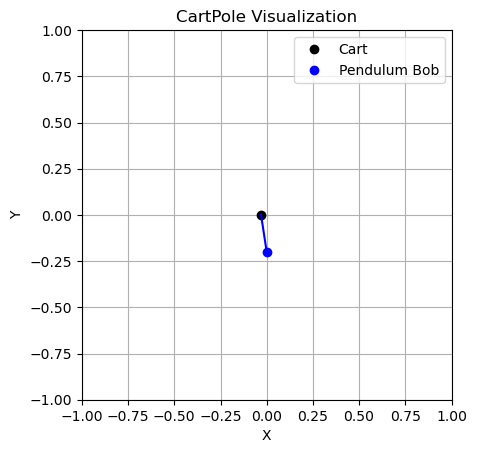


STEP:  3
CART POSITION:  -0.025648393
CART VELOCITY:  0.046570033
POLE ANGLE WRT CART:  -0.027837109
VELOCITY AT TOP OF POLE:  -0.019325549
ACTION: Push cart to right


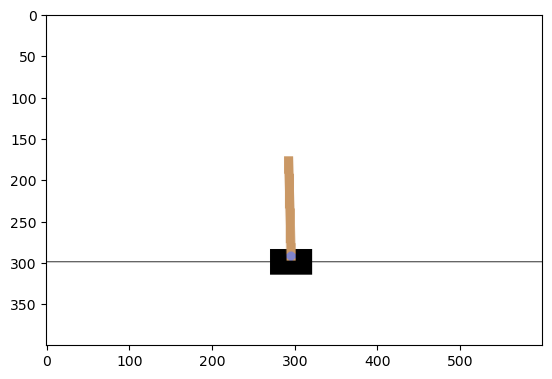

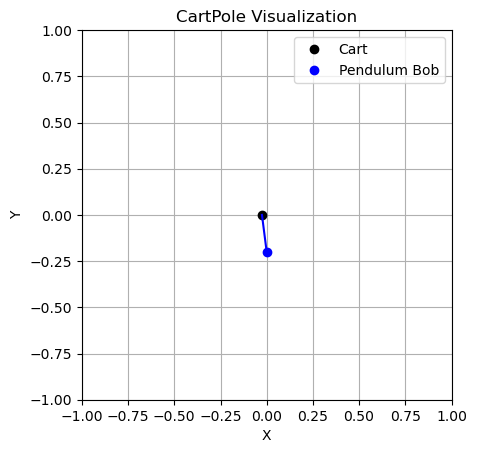


STEP:  4
CART POSITION:  -0.024716994
CART VELOCITY:  0.24207991
POLE ANGLE WRT CART:  -0.02822362
VELOCITY AT TOP OF POLE:  -0.3206598
ACTION: Push cart to right


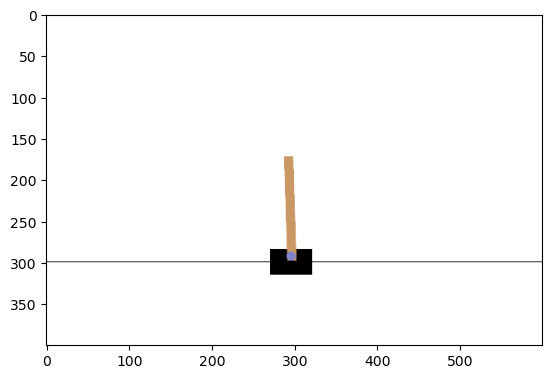

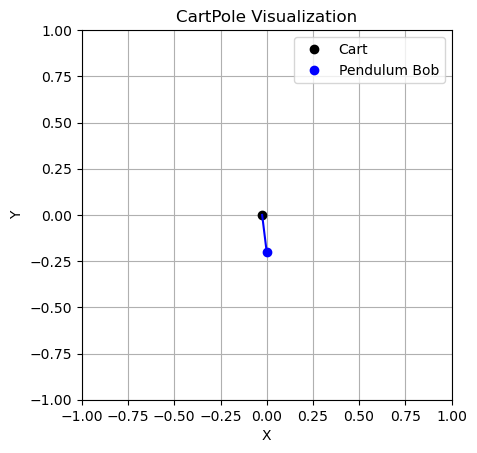


STEP:  5
CART POSITION:  -0.019875394
CART VELOCITY:  0.43759218
POLE ANGLE WRT CART:  -0.034636814
VELOCITY AT TOP OF POLE:  -0.62210804
ACTION: Push cart to right


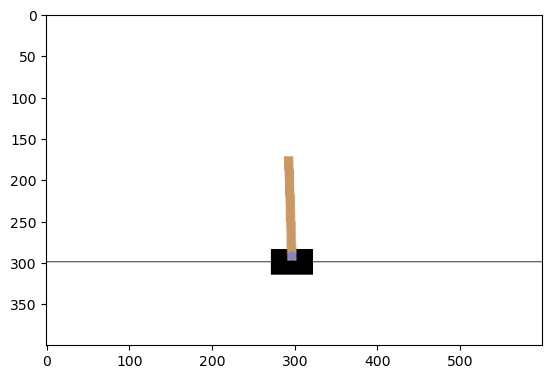

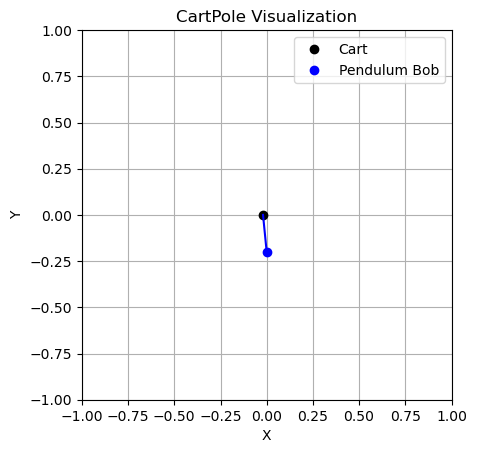


STEP:  6
CART POSITION:  -0.011123551
CART VELOCITY:  0.63318026
POLE ANGLE WRT CART:  -0.04707898
VELOCITY AT TOP OF POLE:  -0.9254954
ACTION: Push cart to right


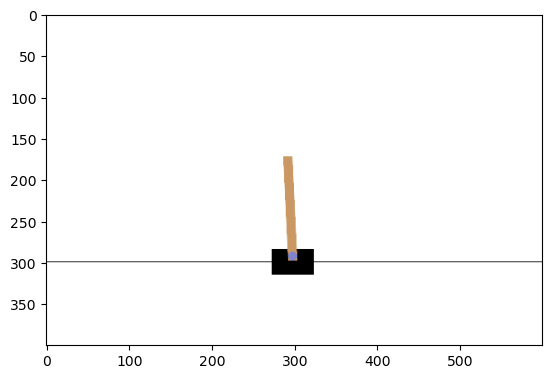

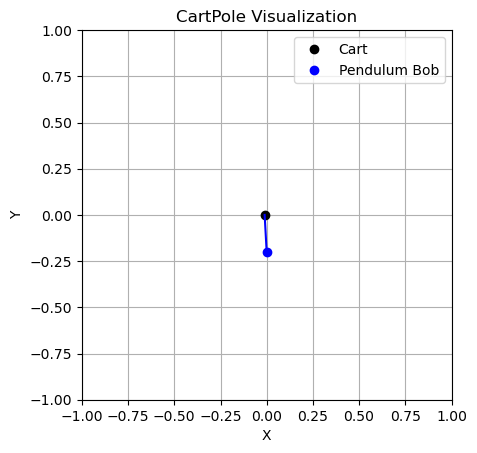


STEP:  7
CART POSITION:  0.0015400541
CART VELOCITY:  0.82890534
POLE ANGLE WRT CART:  -0.065588884
VELOCITY AT TOP OF POLE:  -1.2325938
ACTION: Push cart to right


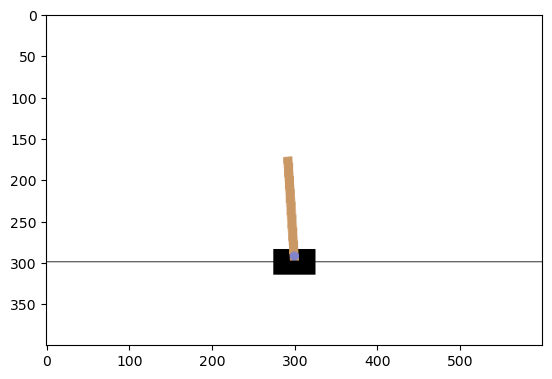

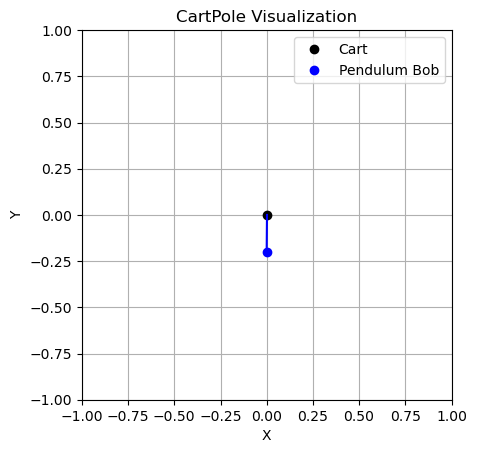


STEP:  8
CART POSITION:  0.018118162
CART VELOCITY:  1.0248065
POLE ANGLE WRT CART:  -0.09024076
VELOCITY AT TOP OF POLE:  -1.545083
ACTION: Push cart to right


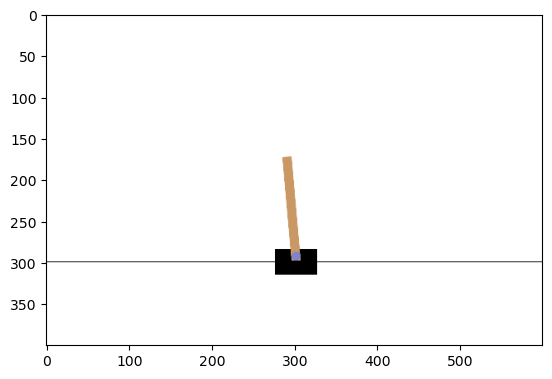

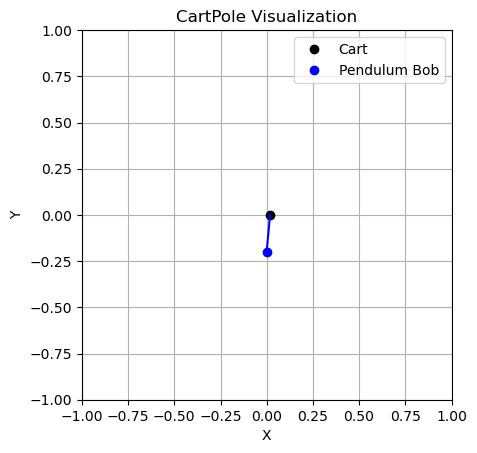


STEP:  9
CART POSITION:  0.03861429
CART VELOCITY:  1.2208892
POLE ANGLE WRT CART:  -0.121142425
VELOCITY AT TOP OF POLE:  -1.8645052
ACTION: Push cart to right


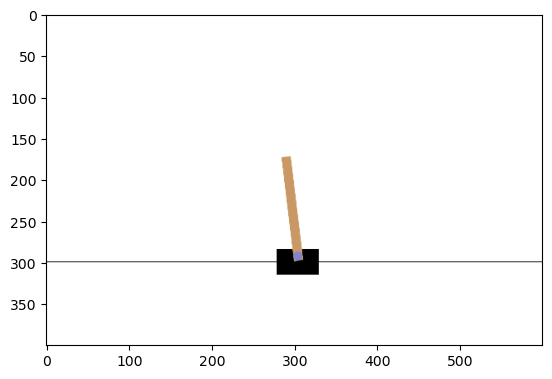

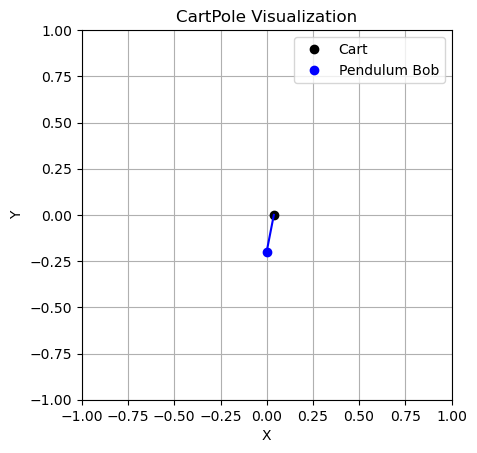


STEP:  10
CART POSITION:  0.063032076
CART VELOCITY:  1.417112
POLE ANGLE WRT CART:  -0.15843253
VELOCITY AT TOP OF POLE:  -2.1922112
ACTION: Push cart to right


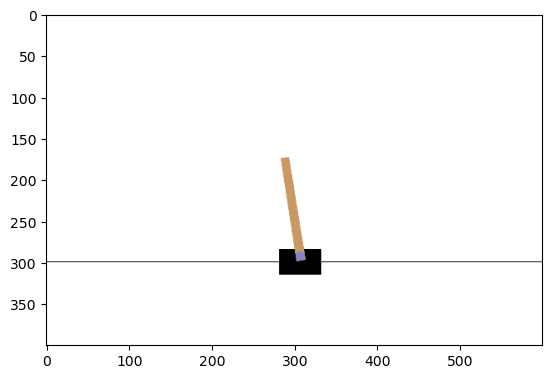

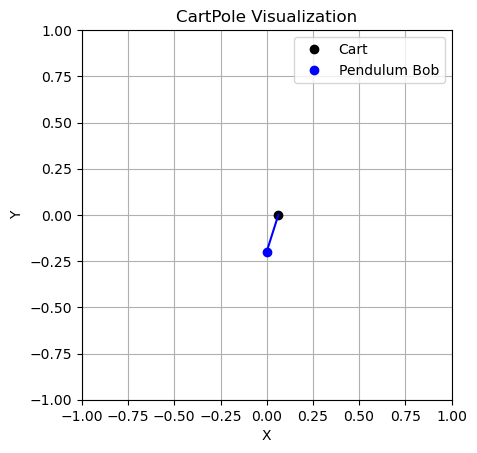


STEP:  11
CART POSITION:  0.091374315
CART VELOCITY:  1.6133711
POLE ANGLE WRT CART:  -0.20227675
VELOCITY AT TOP OF POLE:  -2.5292974
ACTION: Push cart to right


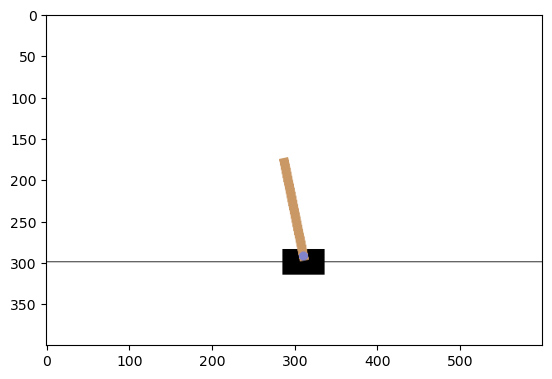

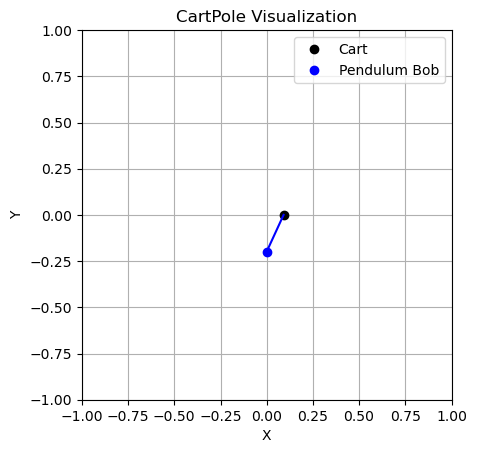


STEP:  1
CART POSITION:  -0.003335541
CART VELOCITY:  -0.030774932
POLE ANGLE WRT CART:  0.00092702097
VELOCITY AT TOP OF POLE:  -0.034756288
ACTION: Push cart to right


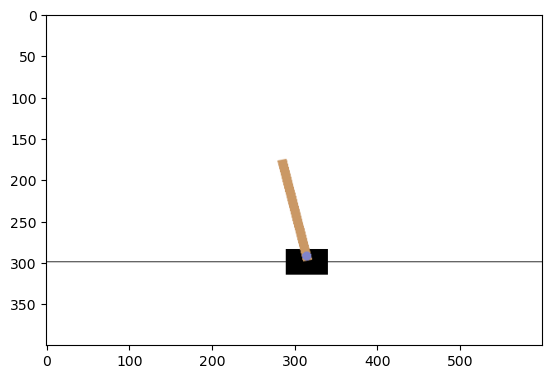

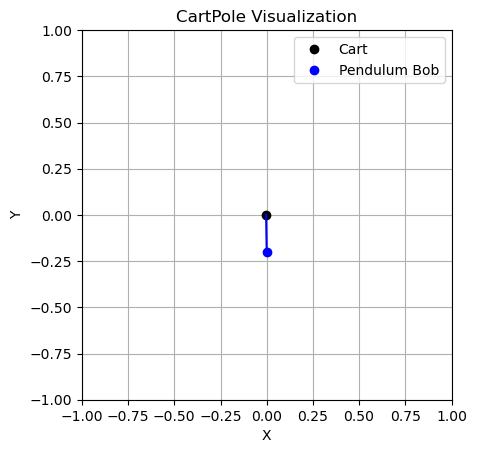


STEP:  2
CART POSITION:  -0.0039510396
CART VELOCITY:  0.16433372
POLE ANGLE WRT CART:  0.00023189519
VELOCITY AT TOP OF POLE:  -0.3271466
ACTION: Push cart to right


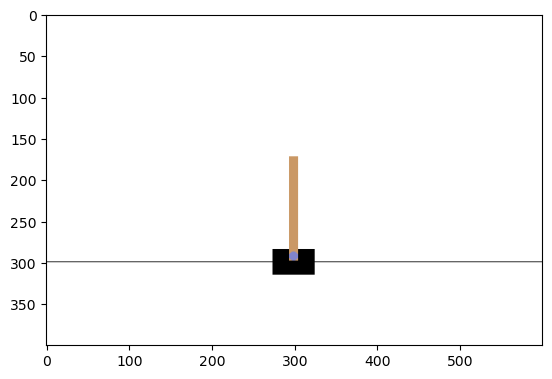

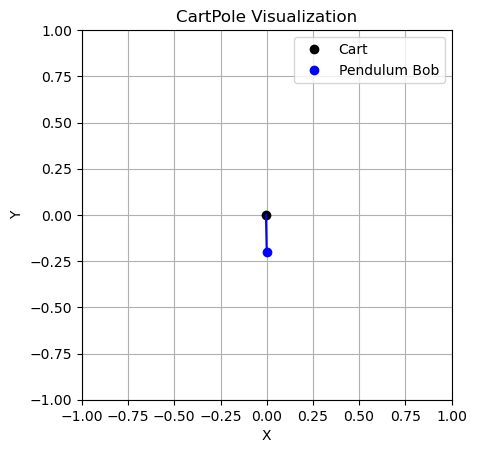


STEP:  3
CART POSITION:  -0.00066436536
CART VELOCITY:  0.35945237
POLE ANGLE WRT CART:  -0.0063110366
VELOCITY AT TOP OF POLE:  -0.6197564
ACTION: Push cart to right


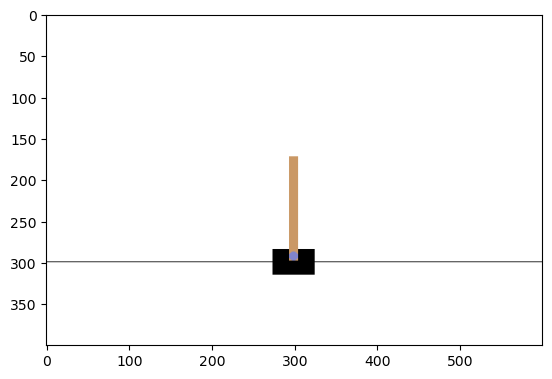

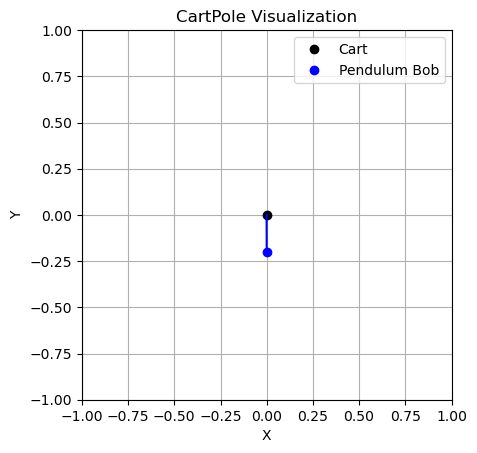


STEP:  4
CART POSITION:  0.006524682
CART VELOCITY:  0.55466187
POLE ANGLE WRT CART:  -0.018706163
VELOCITY AT TOP OF POLE:  -0.91442025
ACTION: Push cart to right


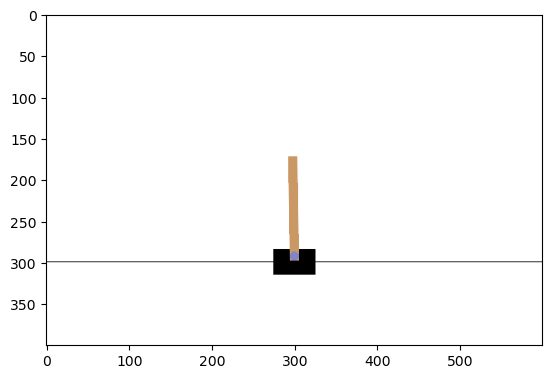

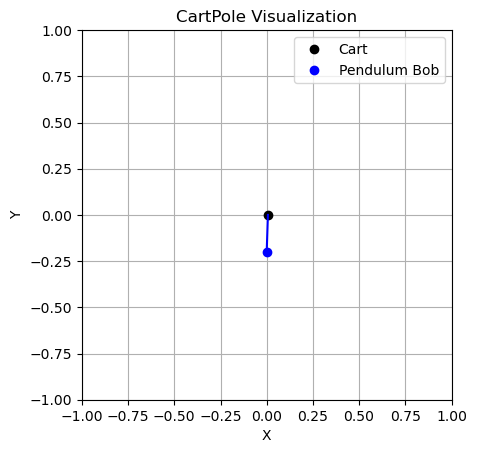


STEP:  5
CART POSITION:  0.01761792
CART VELOCITY:  0.75003177
POLE ANGLE WRT CART:  -0.03699457
VELOCITY AT TOP OF POLE:  -1.2129232
ACTION: Push cart to right


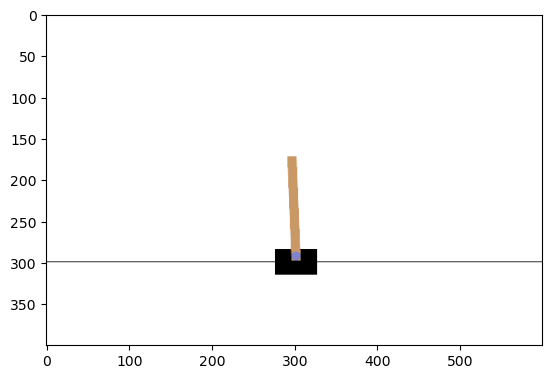

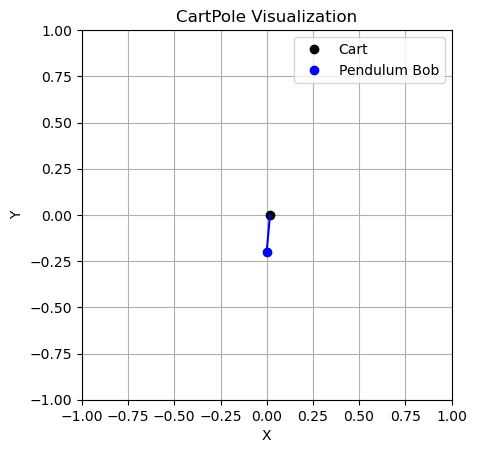


STEP:  6
CART POSITION:  0.032618556
CART VELOCITY:  0.9456112
POLE ANGLE WRT CART:  -0.061253034
VELOCITY AT TOP OF POLE:  -1.5169654
ACTION: Push cart to right


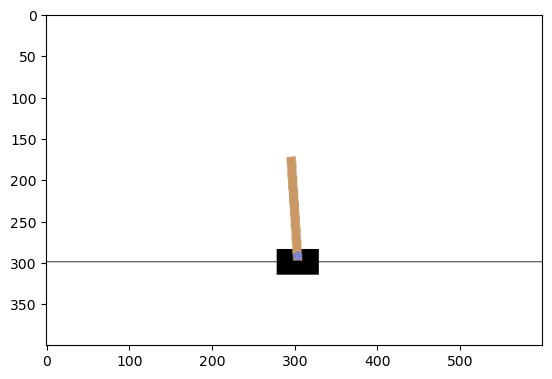

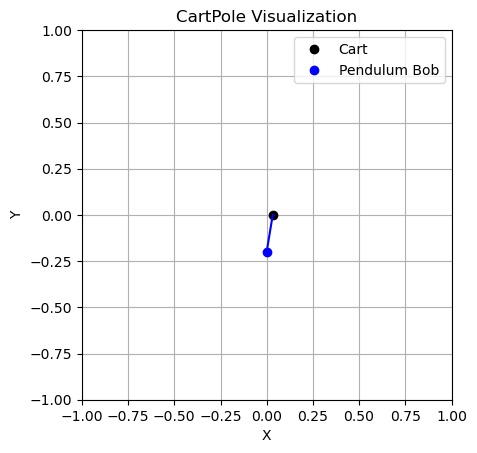


STEP:  7
CART POSITION:  0.05153078
CART VELOCITY:  1.1414182
POLE ANGLE WRT CART:  -0.09159234
VELOCITY AT TOP OF POLE:  -1.8281224
ACTION: Push cart to right


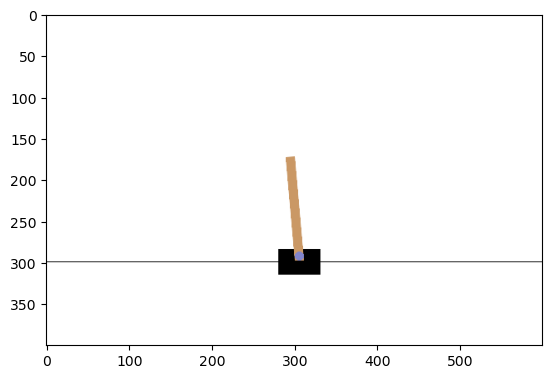

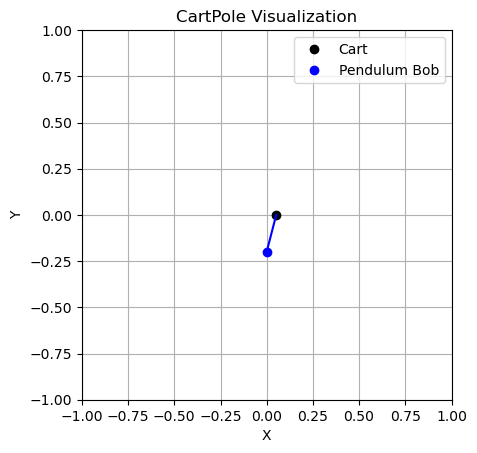


STEP:  8
CART POSITION:  0.07435914
CART VELOCITY:  1.3374282
POLE ANGLE WRT CART:  -0.12815478
VELOCITY AT TOP OF POLE:  -2.1477954
ACTION: Push cart to right


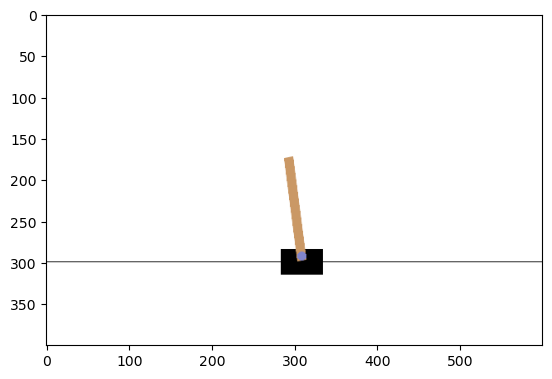

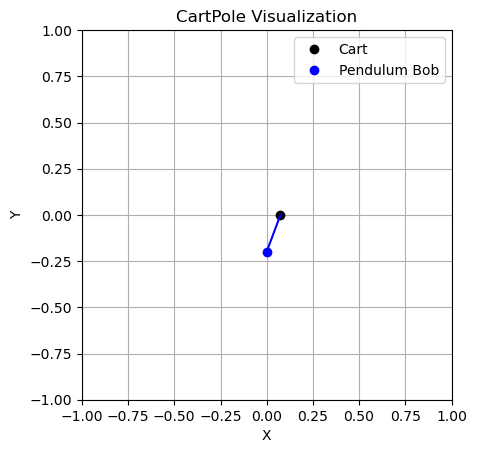


STEP:  9
CART POSITION:  0.10110771
CART VELOCITY:  1.5335585
POLE ANGLE WRT CART:  -0.17111069
VELOCITY AT TOP OF POLE:  -2.4771526
ACTION: Push cart to right


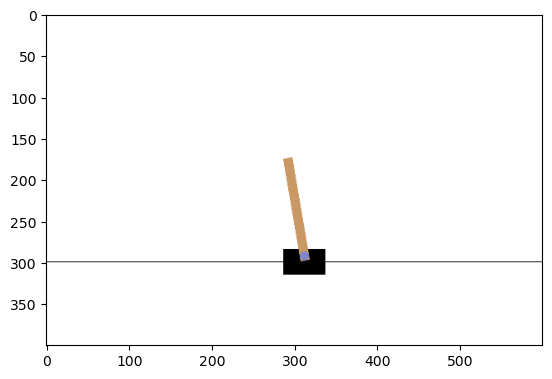

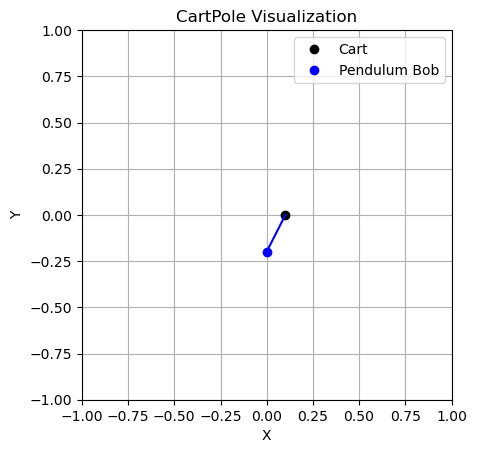


STEP:  1
CART POSITION:  -0.002846267
CART VELOCITY:  0.01718264
POLE ANGLE WRT CART:  -0.030156467
VELOCITY AT TOP OF POLE:  0.02524346
ACTION: Push cart to left


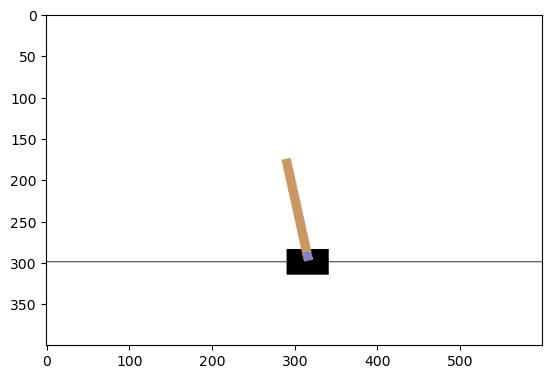

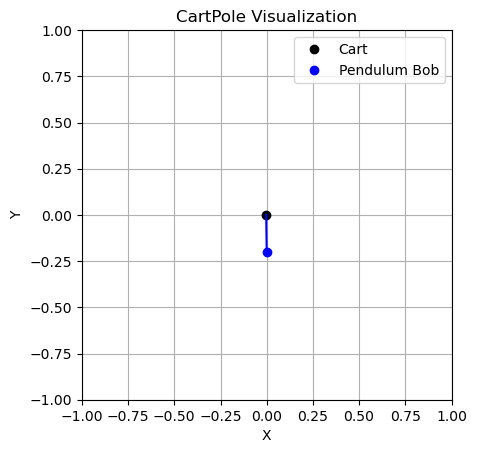


STEP:  2
CART POSITION:  -0.0025026142
CART VELOCITY:  -0.17749415
POLE ANGLE WRT CART:  -0.029651597
VELOCITY AT TOP OF POLE:  0.30826122
ACTION: Push cart to left


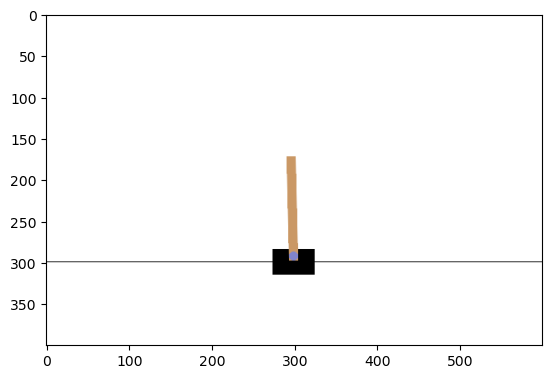

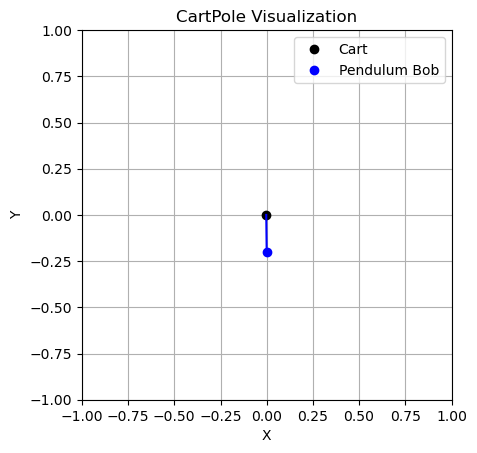


STEP:  3
CART POSITION:  -0.0060524973
CART VELOCITY:  -0.37218133
POLE ANGLE WRT CART:  -0.023486374
VELOCITY AT TOP OF POLE:  0.59144735
ACTION: Push cart to left


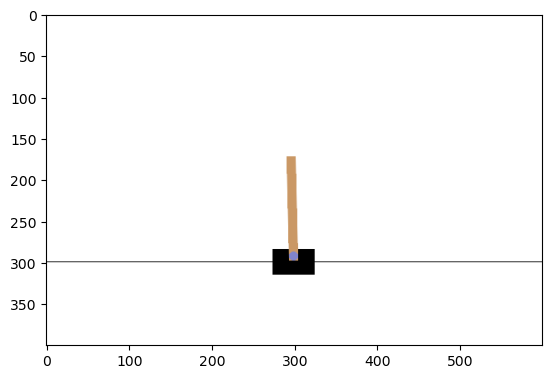

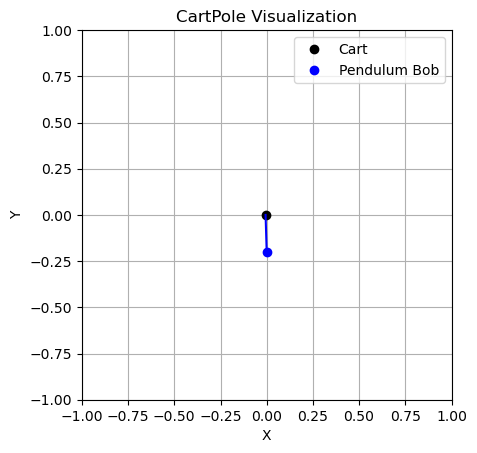


STEP:  4
CART POSITION:  -0.013496124
CART VELOCITY:  -0.5669667
POLE ANGLE WRT CART:  -0.011657427
VELOCITY AT TOP OF POLE:  0.8766405
ACTION: Push cart to left


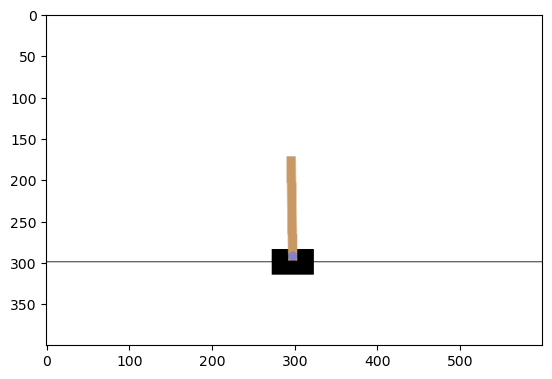

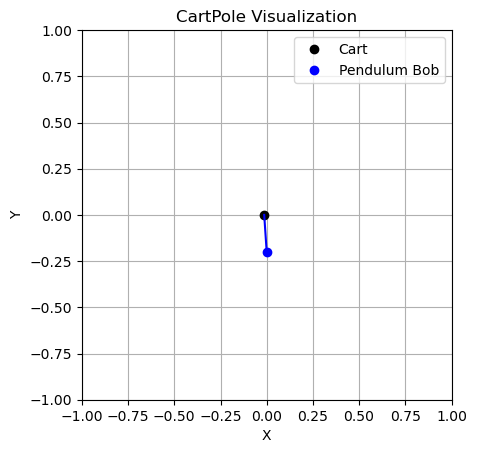


STEP:  5
CART POSITION:  -0.024835458
CART VELOCITY:  -0.7619283
POLE ANGLE WRT CART:  0.005875383
VELOCITY AT TOP OF POLE:  1.1656358
ACTION: Push cart to left


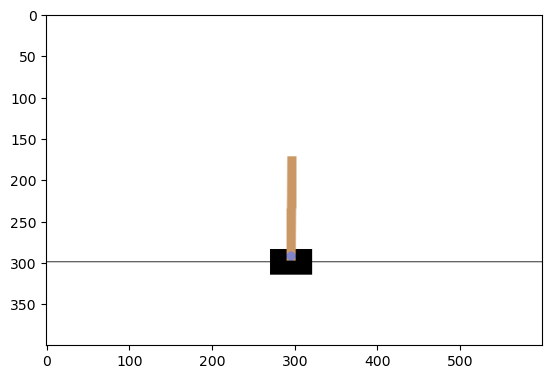

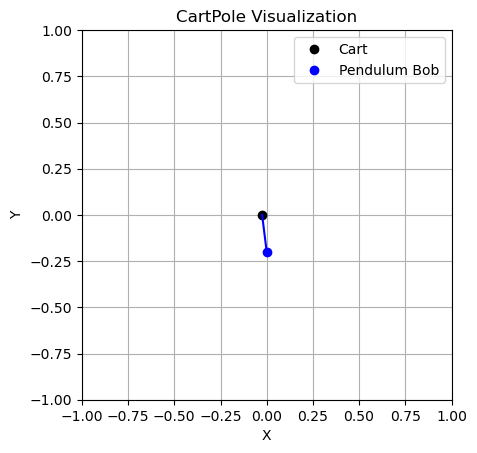


STEP:  6
CART POSITION:  -0.040074024
CART VELOCITY:  -0.95712626
POLE ANGLE WRT CART:  0.029188098
VELOCITY AT TOP OF POLE:  1.460155
ACTION: Push cart to left


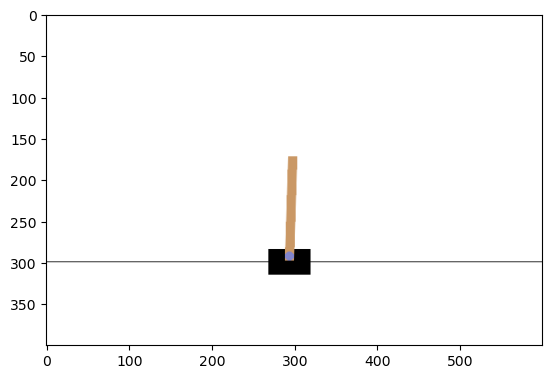

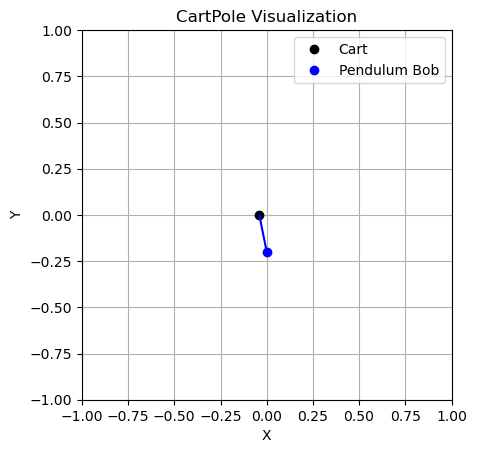


STEP:  7
CART POSITION:  -0.05921655
CART VELOCITY:  -1.1525937
POLE ANGLE WRT CART:  0.0583912
VELOCITY AT TOP OF POLE:  1.7618114
ACTION: Push cart to left


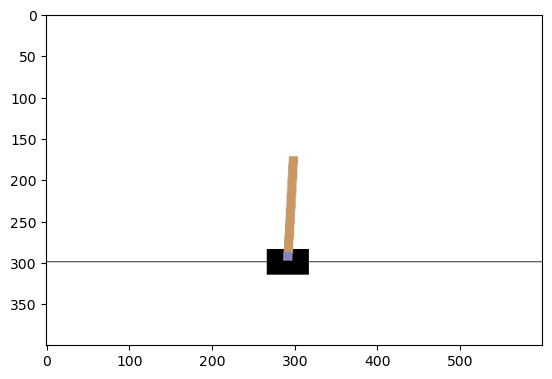

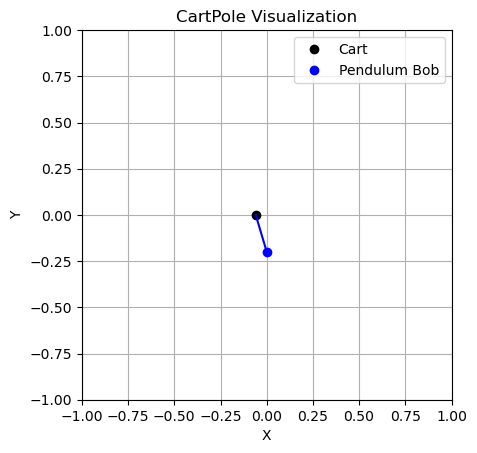


STEP:  8
CART POSITION:  -0.082268424
CART VELOCITY:  -1.3483256
POLE ANGLE WRT CART:  0.09362742
VELOCITY AT TOP OF POLE:  2.072066
ACTION: Push cart to left


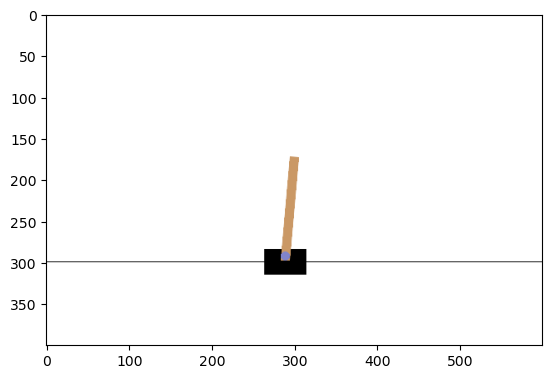

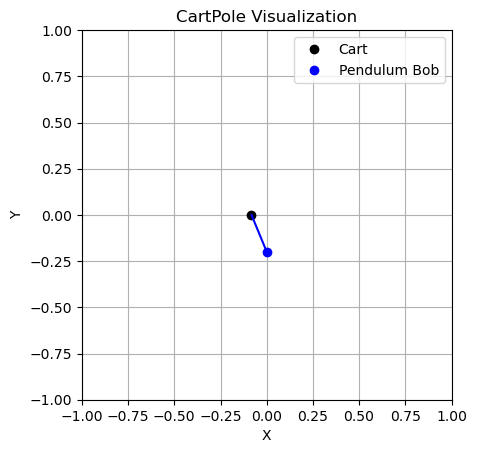


STEP:  9
CART POSITION:  -0.10923494
CART VELOCITY:  -1.5442656
POLE ANGLE WRT CART:  0.13506874
VELOCITY AT TOP OF POLE:  2.392175
ACTION: Push cart to left


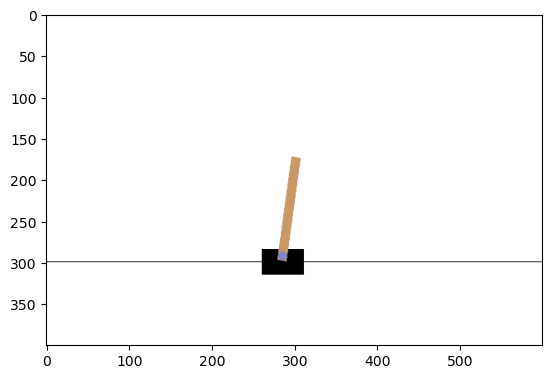

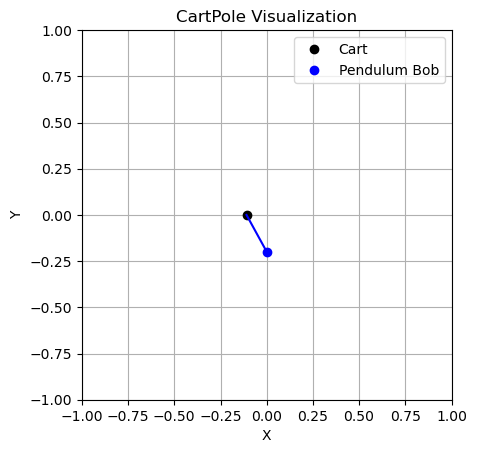


STEP:  10
CART POSITION:  -0.14012025
CART VELOCITY:  -1.7402893
POLE ANGLE WRT CART:  0.18291225
VELOCITY AT TOP OF POLE:  2.7231221
ACTION: Push cart to left


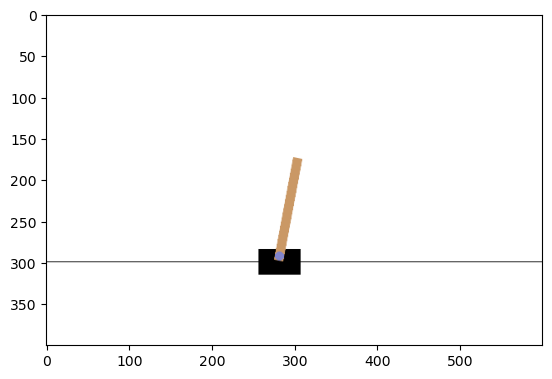

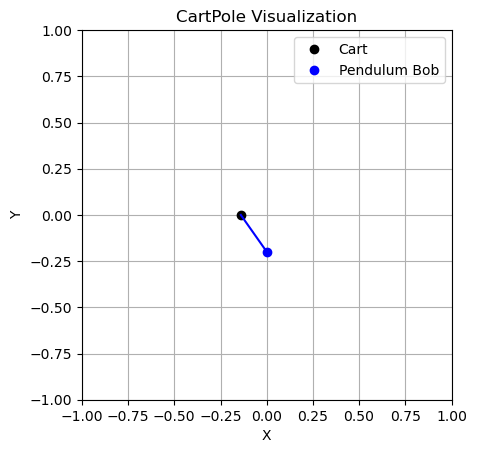


STEP:  1
CART POSITION:  0.037052333
CART VELOCITY:  -0.016987564
POLE ANGLE WRT CART:  -0.044802744
VELOCITY AT TOP OF POLE:  0.037081525
ACTION: Push cart to left


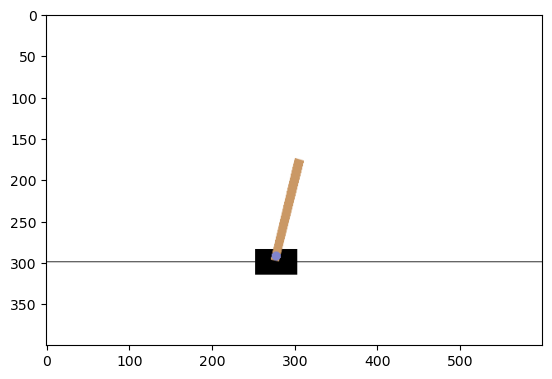

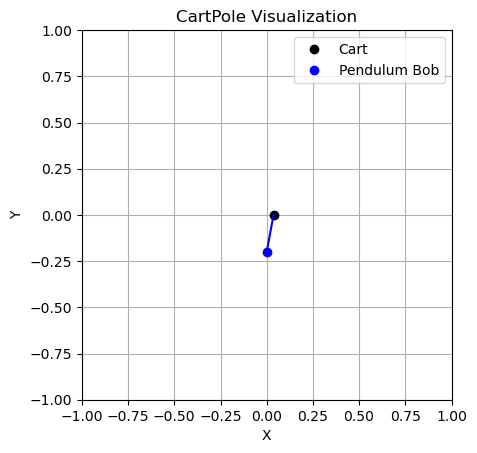


STEP:  2
CART POSITION:  0.03671258
CART VELOCITY:  -0.21143936
POLE ANGLE WRT CART:  -0.044061113
VELOCITY AT TOP OF POLE:  0.31529891
ACTION: Push cart to left


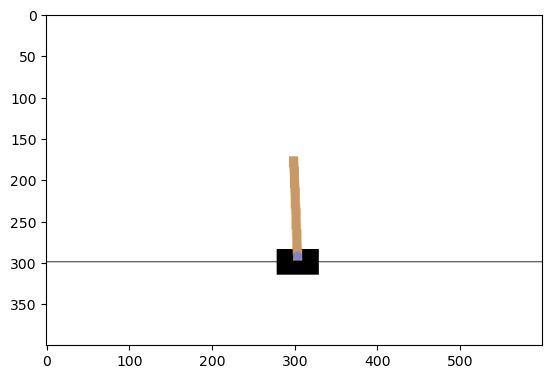

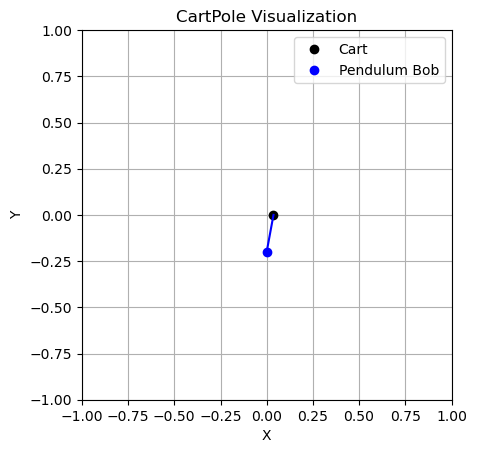


STEP:  3
CART POSITION:  0.032483794
CART VELOCITY:  -0.4059069
POLE ANGLE WRT CART:  -0.037755135
VELOCITY AT TOP OF POLE:  0.59376734
ACTION: Push cart to left


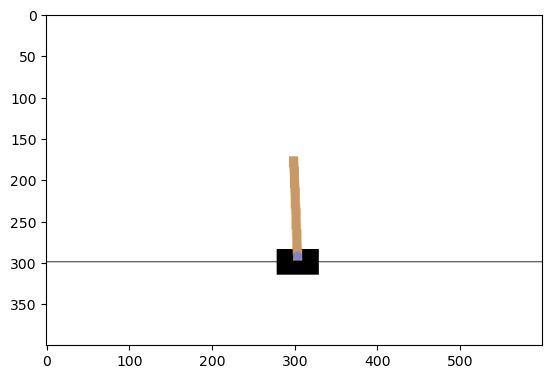

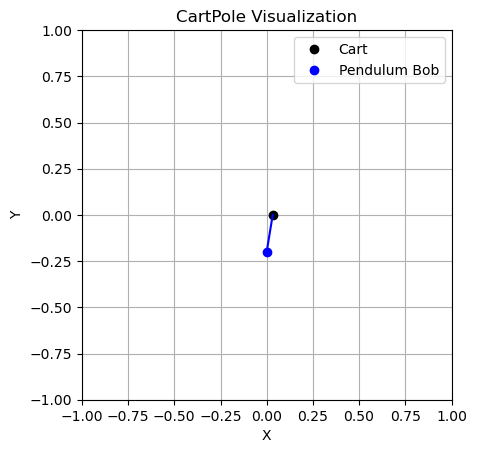


STEP:  4
CART POSITION:  0.024365656
CART VELOCITY:  -0.6004806
POLE ANGLE WRT CART:  -0.02587979
VELOCITY AT TOP OF POLE:  0.87432253
ACTION: Push cart to left


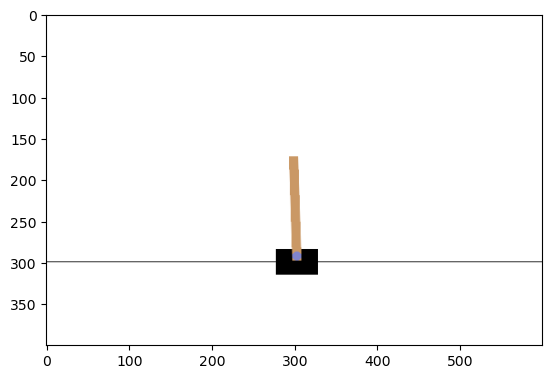

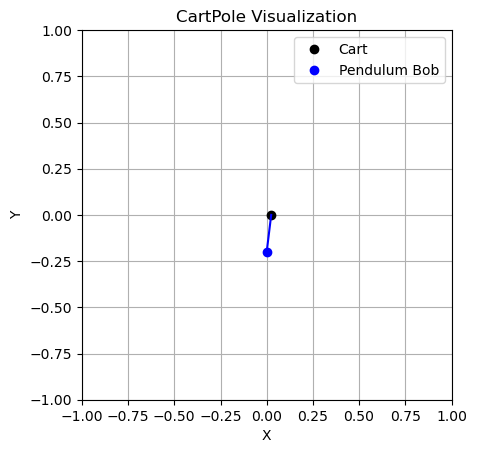


STEP:  5
CART POSITION:  0.012356044
CART VELOCITY:  -0.7952413
POLE ANGLE WRT CART:  -0.008393339
VELOCITY AT TOP OF POLE:  1.1587579
ACTION: Push cart to left


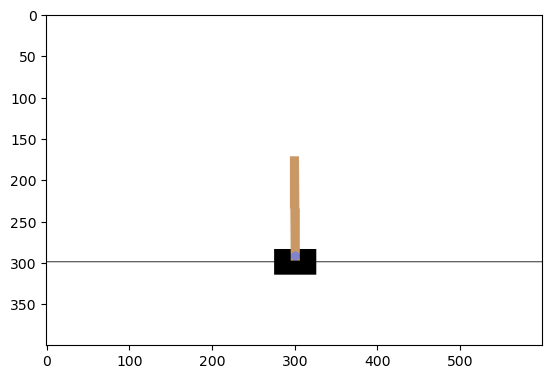

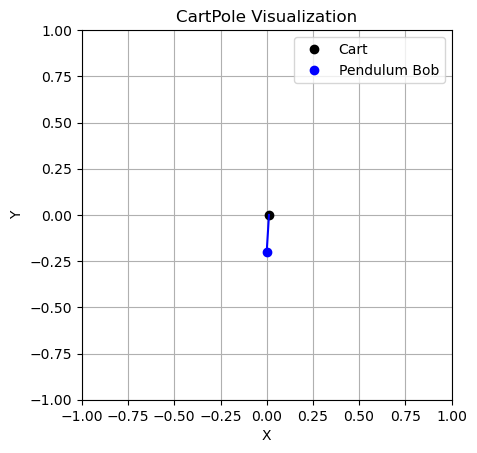


STEP:  6
CART POSITION:  -0.0035487826
CART VELOCITY:  -0.9902529
POLE ANGLE WRT CART:  0.014781821
VELOCITY AT TOP OF POLE:  1.4487975
ACTION: Push cart to left


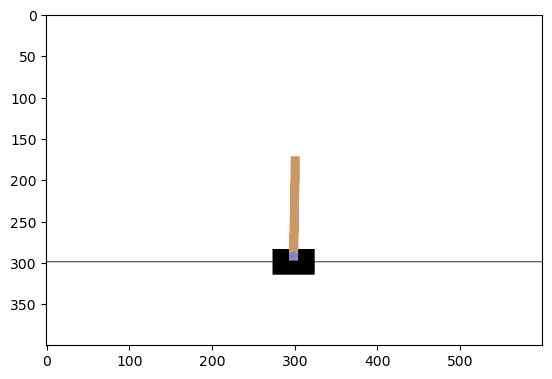

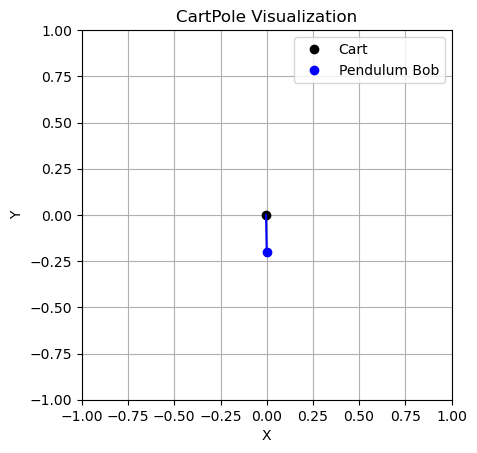


STEP:  7
CART POSITION:  -0.023353841
CART VELOCITY:  -1.1855534
POLE ANGLE WRT CART:  0.04375777
VELOCITY AT TOP OF POLE:  1.7460619
ACTION: Push cart to left


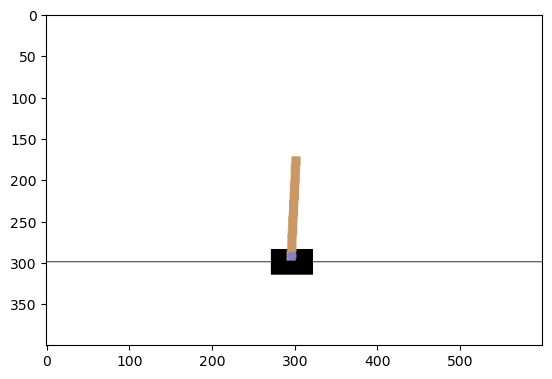

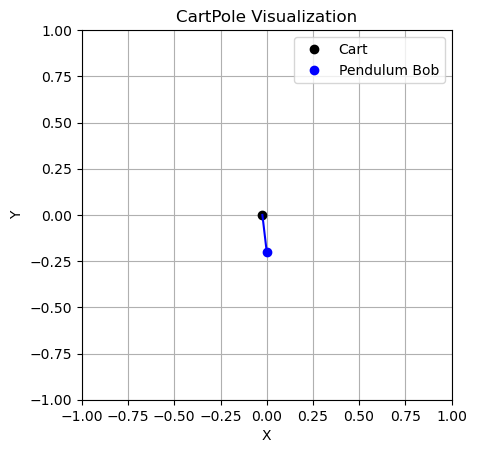


STEP:  8
CART POSITION:  -0.047064908
CART VELOCITY:  -1.3811446
POLE ANGLE WRT CART:  0.078679
VELOCITY AT TOP OF POLE:  2.0520287
ACTION: Push cart to left


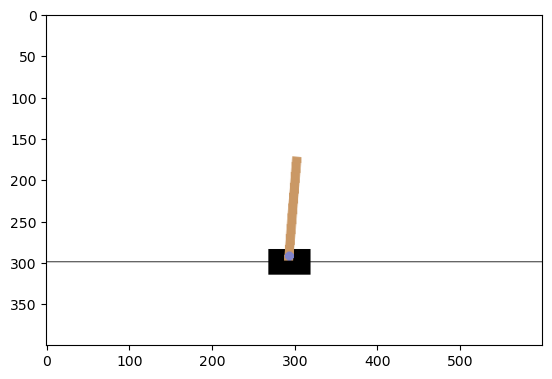

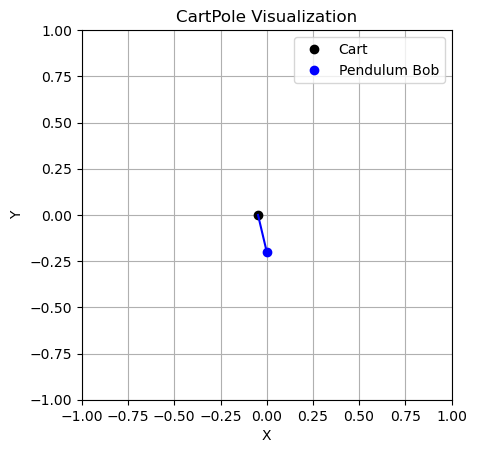


STEP:  9
CART POSITION:  -0.0746878
CART VELOCITY:  -1.5769789
POLE ANGLE WRT CART:  0.11971958
VELOCITY AT TOP OF POLE:  2.367979
ACTION: Push cart to left


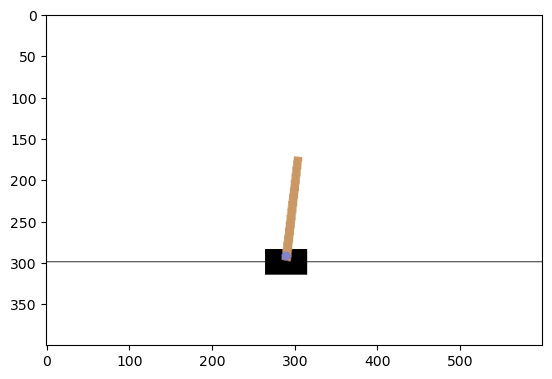

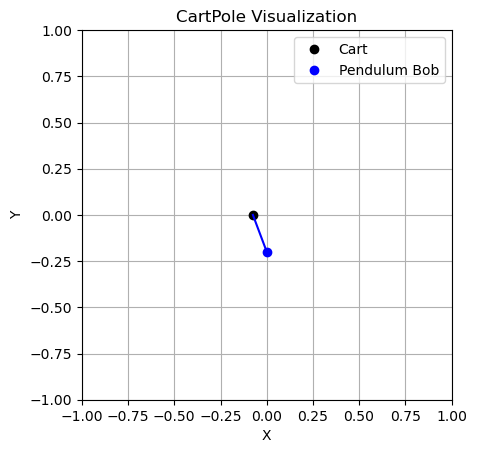


STEP:  10
CART POSITION:  -0.106227376
CART VELOCITY:  -1.7729435
POLE ANGLE WRT CART:  0.16707915
VELOCITY AT TOP OF POLE:  2.6949353
ACTION: Push cart to left


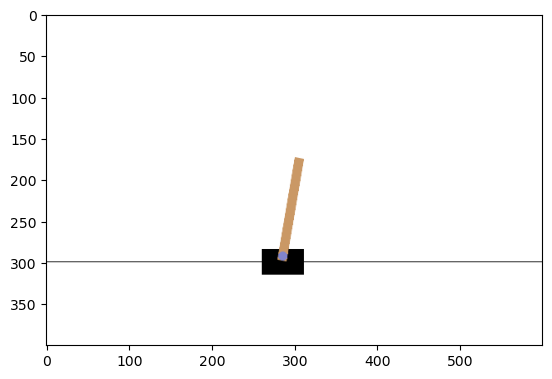

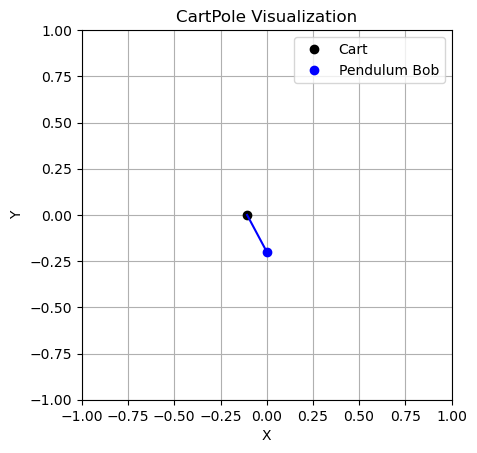


STEP:  1
CART POSITION:  -0.0338071
CART VELOCITY:  -0.035639152
POLE ANGLE WRT CART:  -0.037415534
VELOCITY AT TOP OF POLE:  -0.033057515
ACTION: Push cart to right


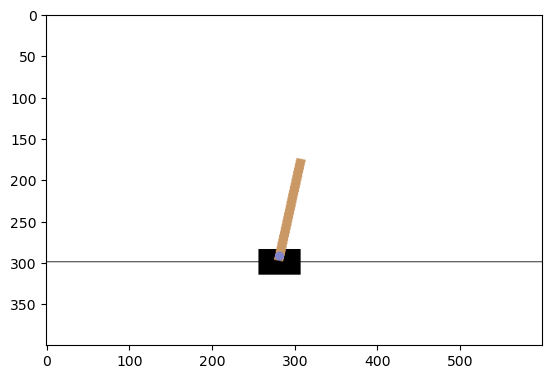

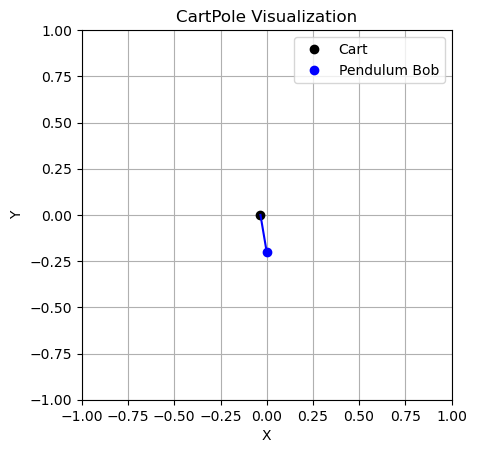


STEP:  2
CART POSITION:  -0.034519885
CART VELOCITY:  0.15999882
POLE ANGLE WRT CART:  -0.038076688
VELOCITY AT TOP OF POLE:  -0.33730668
ACTION: Push cart to right


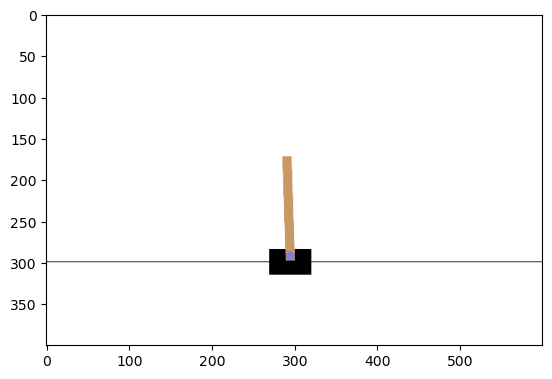

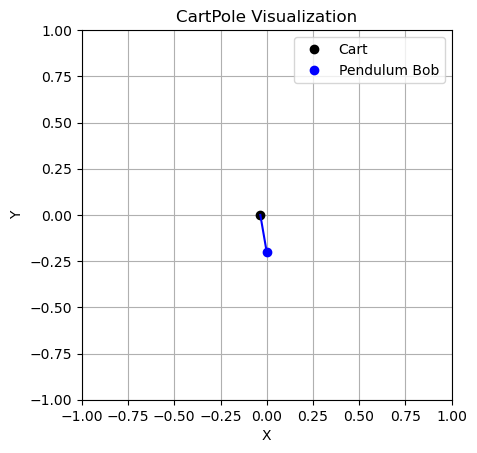


STEP:  3
CART POSITION:  -0.031319905
CART VELOCITY:  0.35564134
POLE ANGLE WRT CART:  -0.04482282
VELOCITY AT TOP OF POLE:  -0.6417496
ACTION: Push cart to right


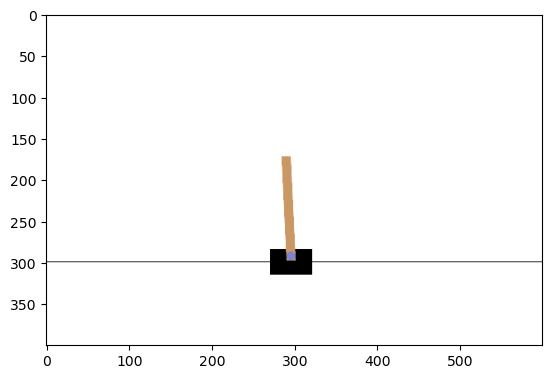

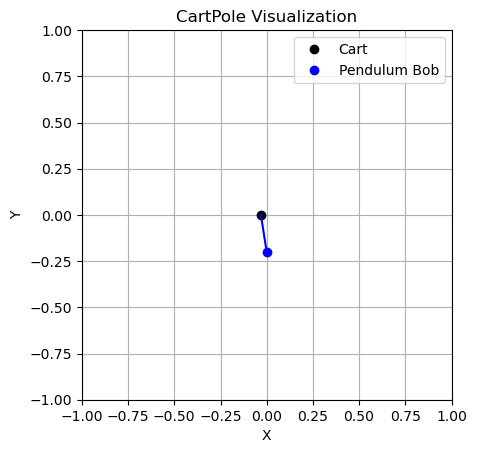


STEP:  4
CART POSITION:  -0.02420708
CART VELOCITY:  0.5513585
POLE ANGLE WRT CART:  -0.05765781
VELOCITY AT TOP OF POLE:  -0.948204
ACTION: Push cart to right


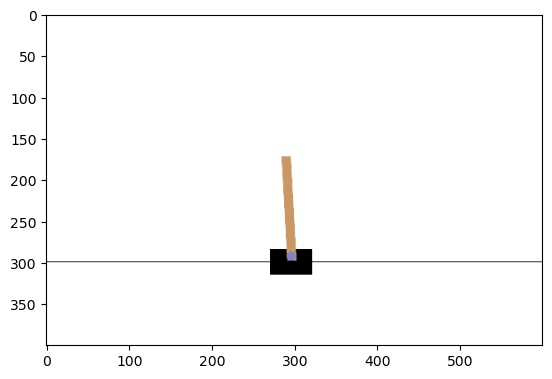

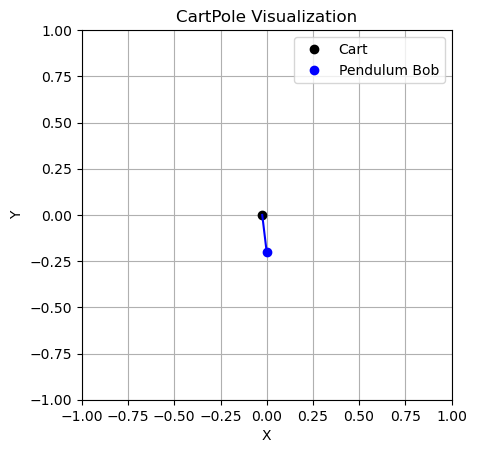


STEP:  5
CART POSITION:  -0.013179909
CART VELOCITY:  0.7472074
POLE ANGLE WRT CART:  -0.07662189
VELOCITY AT TOP OF POLE:  -1.2584312
ACTION: Push cart to right


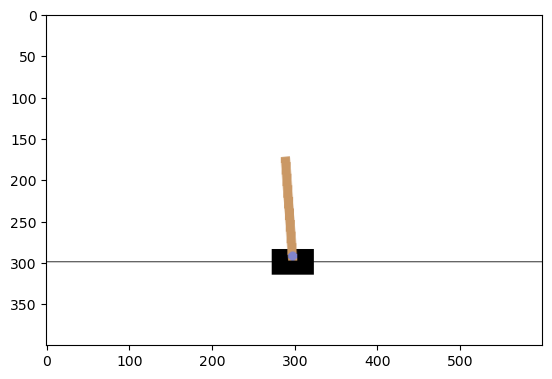

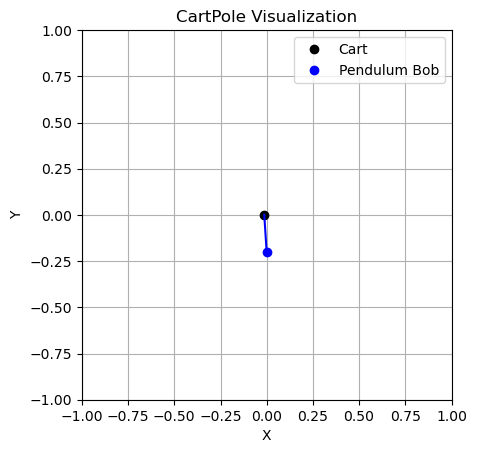


STEP:  6
CART POSITION:  0.001764238
CART VELOCITY:  0.9432216
POLE ANGLE WRT CART:  -0.10179052
VELOCITY AT TOP OF POLE:  -1.5740947
ACTION: Push cart to left


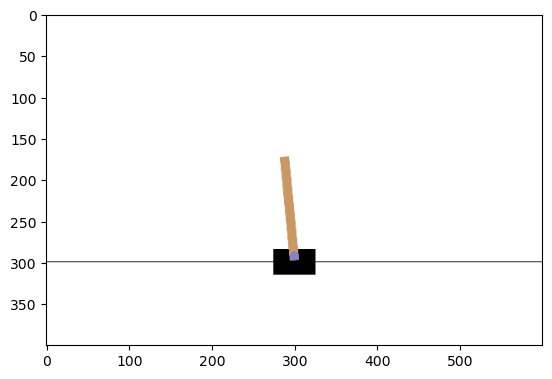

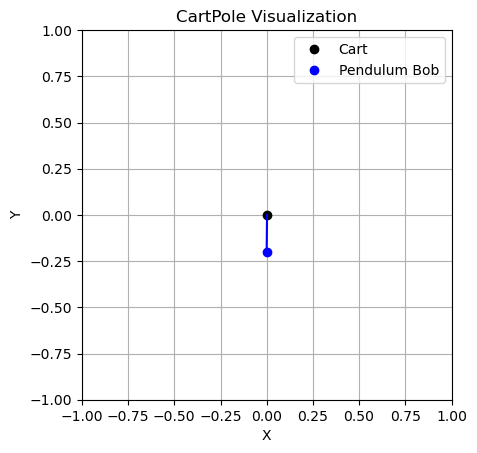


STEP:  7
CART POSITION:  0.02062867
CART VELOCITY:  0.7494502
POLE ANGLE WRT CART:  -0.13327241
VELOCITY AT TOP OF POLE:  -1.3148167
ACTION: Push cart to right


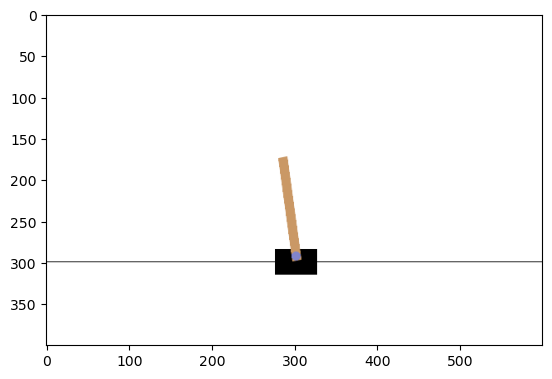

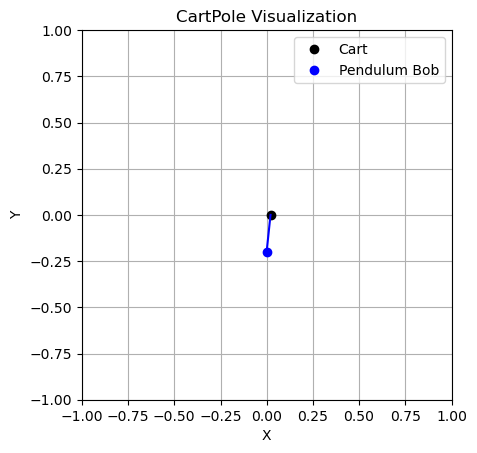


STEP:  8
CART POSITION:  0.035617676
CART VELOCITY:  0.9459829
POLE ANGLE WRT CART:  -0.15956874
VELOCITY AT TOP OF POLE:  -1.6460679
ACTION: Push cart to right


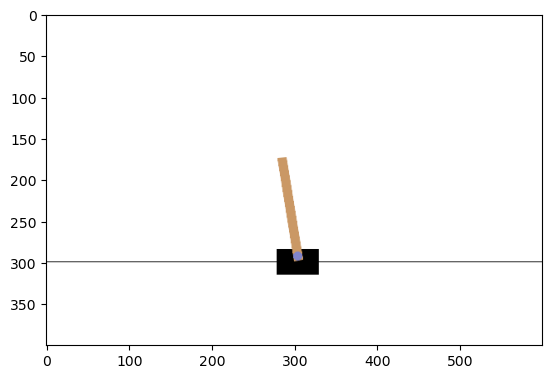

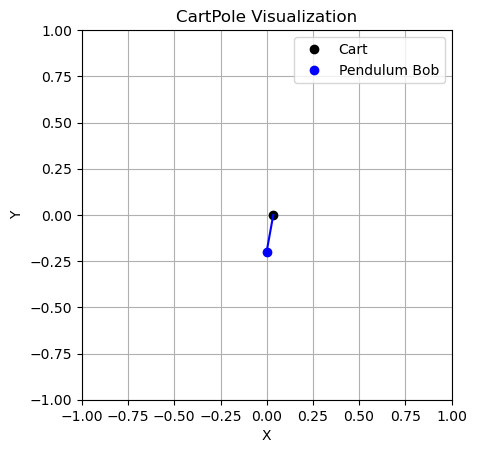


STEP:  9
CART POSITION:  0.05453733
CART VELOCITY:  1.1425714
POLE ANGLE WRT CART:  -0.1924901
VELOCITY AT TOP OF POLE:  -1.9839188
ACTION: Push cart to right


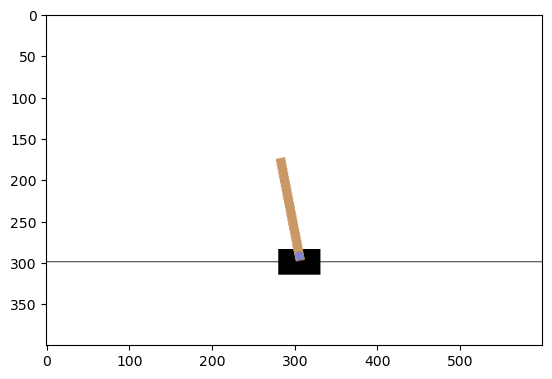

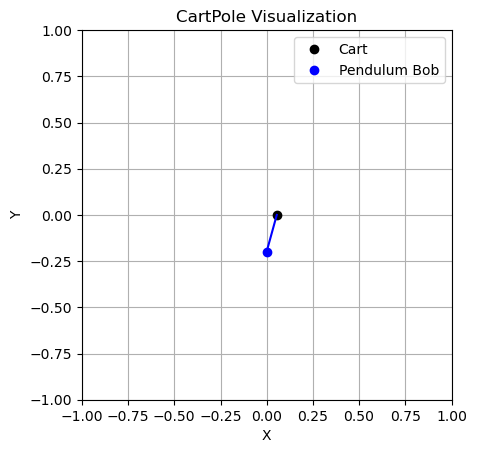


STEP:  1
CART POSITION:  0.028510038
CART VELOCITY:  0.013751211
POLE ANGLE WRT CART:  0.0039681257
VELOCITY AT TOP OF POLE:  0.033741318
ACTION: Push cart to left


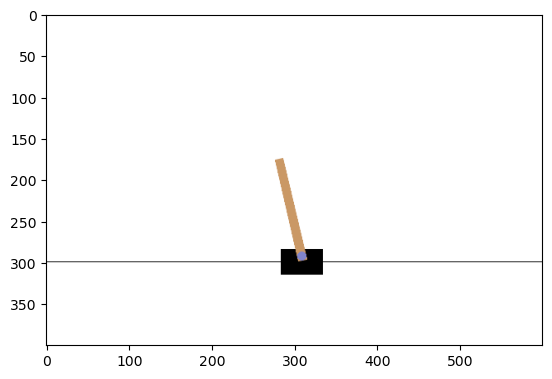

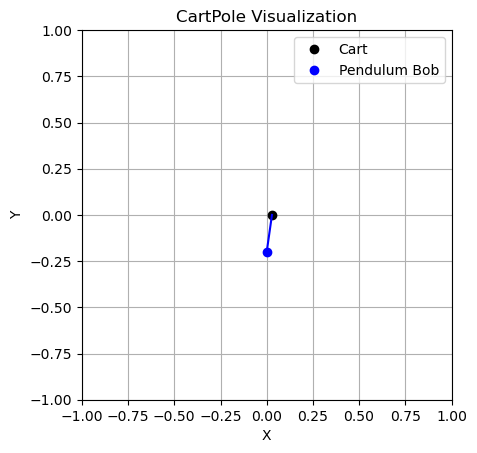


STEP:  2
CART POSITION:  0.028785063
CART VELOCITY:  -0.18142742
POLE ANGLE WRT CART:  0.0046429522
VELOCITY AT TOP OF POLE:  0.32767358
ACTION: Push cart to left


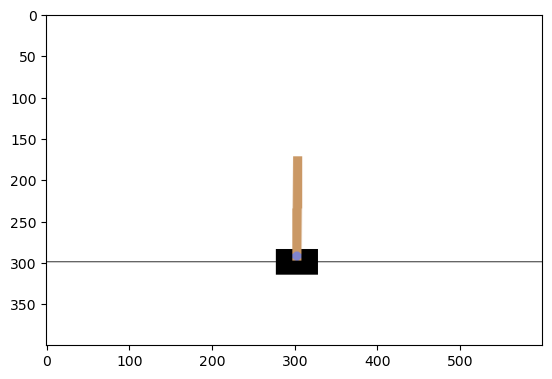

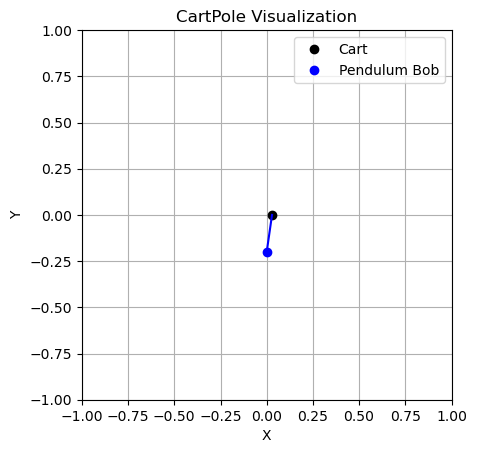


STEP:  3
CART POSITION:  0.025156515
CART VELOCITY:  -0.37661517
POLE ANGLE WRT CART:  0.011196423
VELOCITY AT TOP OF POLE:  0.62181705
ACTION: Push cart to left


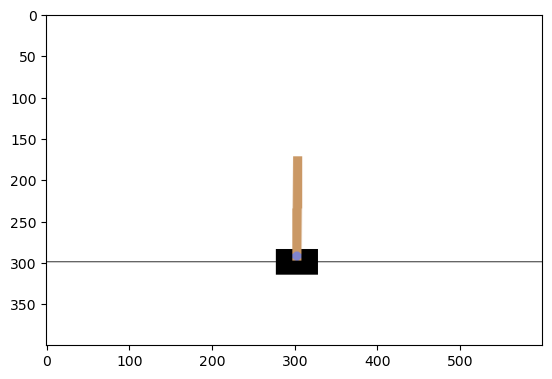

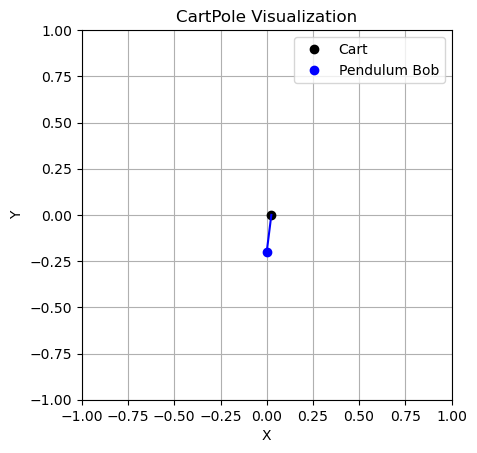


STEP:  4
CART POSITION:  0.01762421
CART VELOCITY:  -0.57189167
POLE ANGLE WRT CART:  0.023632765
VELOCITY AT TOP OF POLE:  0.9180051
ACTION: Push cart to left


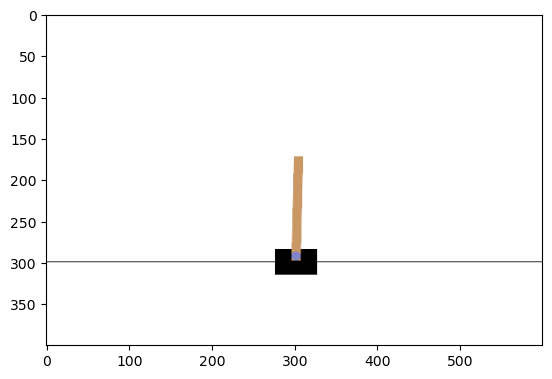

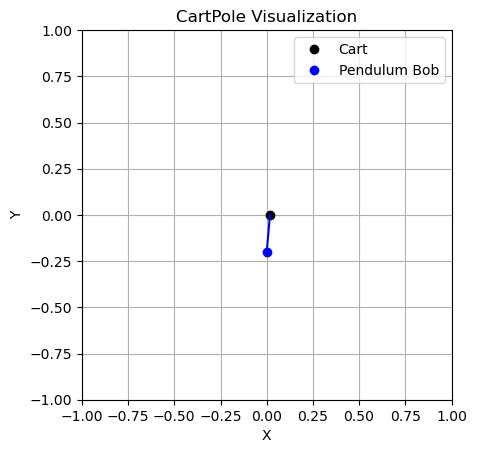


STEP:  5
CART POSITION:  0.0061863773
CART VELOCITY:  -0.767325
POLE ANGLE WRT CART:  0.04199287
VELOCITY AT TOP OF POLE:  1.2180207
ACTION: Push cart to left


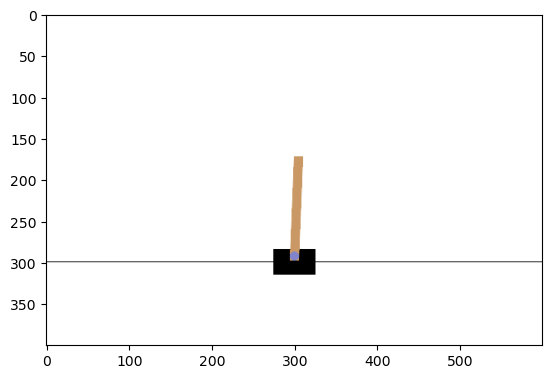

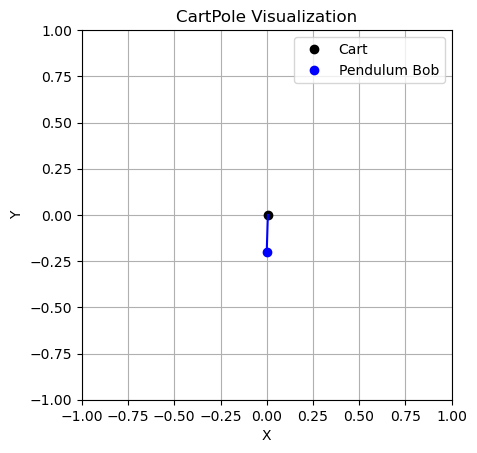


STEP:  6
CART POSITION:  -0.009160123
CART VELOCITY:  -0.9629625
POLE ANGLE WRT CART:  0.066353284
VELOCITY AT TOP OF POLE:  1.5235605
ACTION: Push cart to left


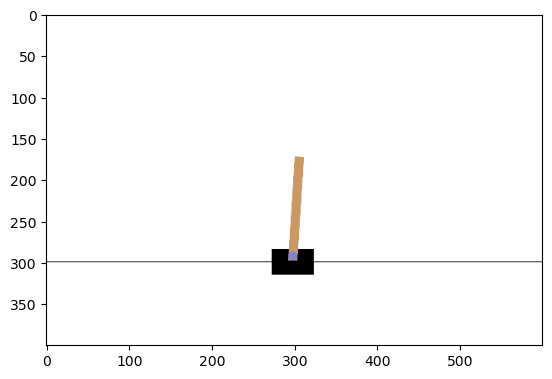

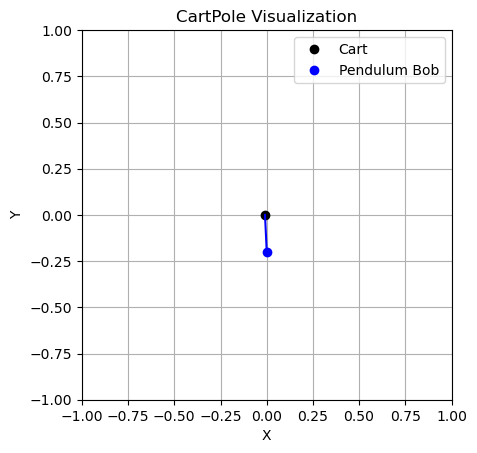


STEP:  7
CART POSITION:  -0.028419372
CART VELOCITY:  -1.1588202
POLE ANGLE WRT CART:  0.09682449
VELOCITY AT TOP OF POLE:  1.8361939
ACTION: Push cart to left


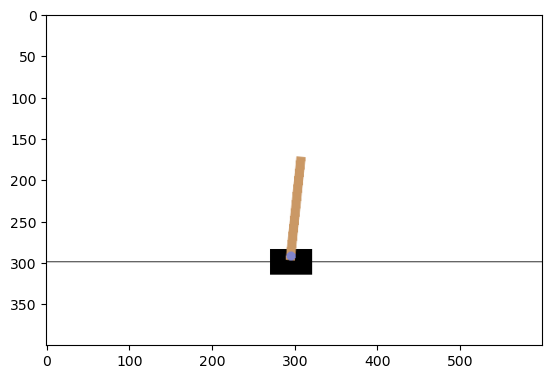

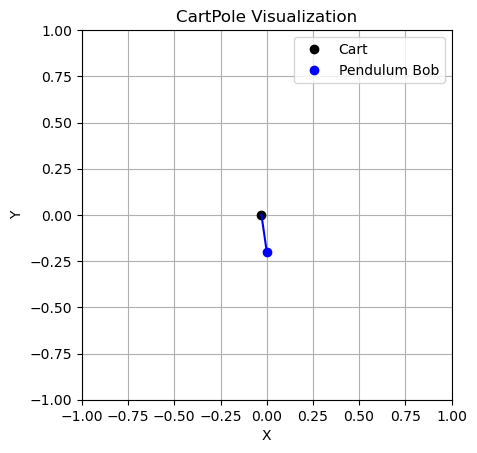


STEP:  8
CART POSITION:  -0.051595774
CART VELOCITY:  -1.35487
POLE ANGLE WRT CART:  0.13354836
VELOCITY AT TOP OF POLE:  2.1573133
ACTION: Push cart to left


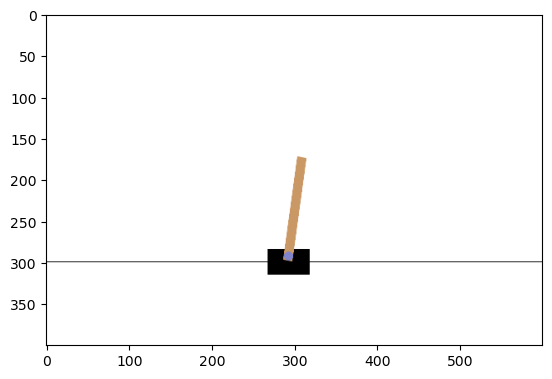

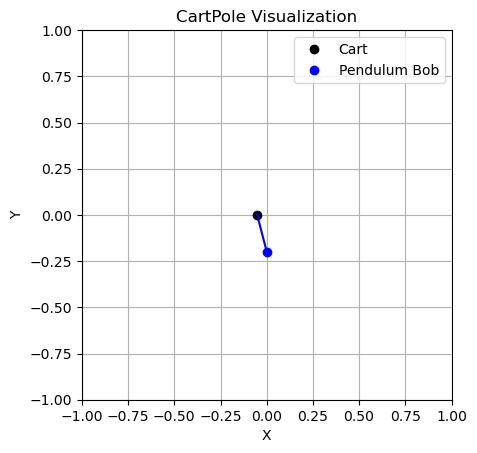


STEP:  9
CART POSITION:  -0.078693174
CART VELOCITY:  -1.5510254
POLE ANGLE WRT CART:  0.17669463
VELOCITY AT TOP OF POLE:  2.488073
ACTION: Push cart to left


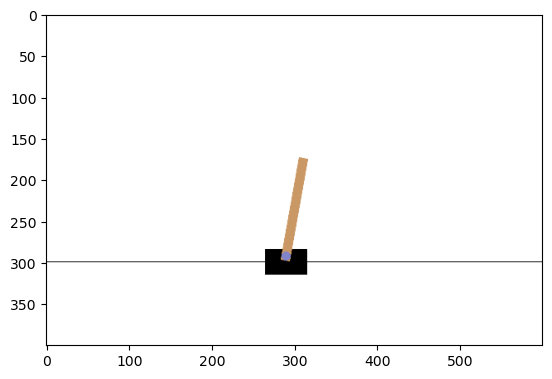

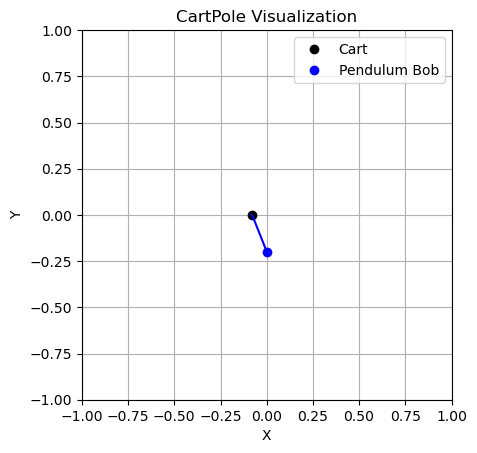


STEP:  1
CART POSITION:  -0.044741992
CART VELOCITY:  0.0452978
POLE ANGLE WRT CART:  0.0023258685
VELOCITY AT TOP OF POLE:  -0.025327202
ACTION: Push cart to right


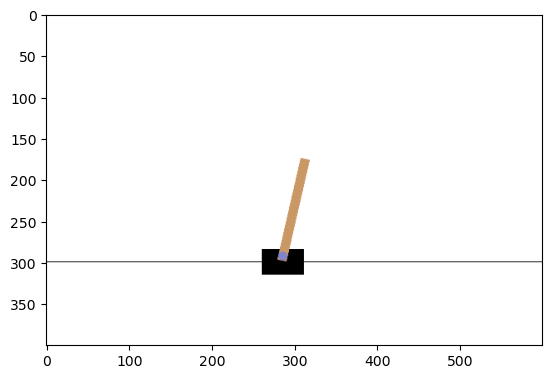

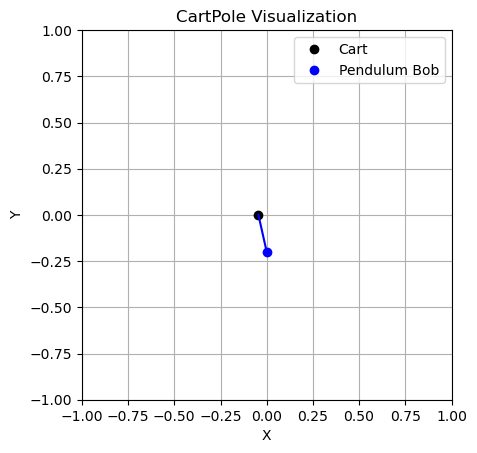


STEP:  2
CART POSITION:  -0.04383604
CART VELOCITY:  0.24038632
POLE ANGLE WRT CART:  0.0018193246
VELOCITY AT TOP OF POLE:  -0.31727538
ACTION: Push cart to right


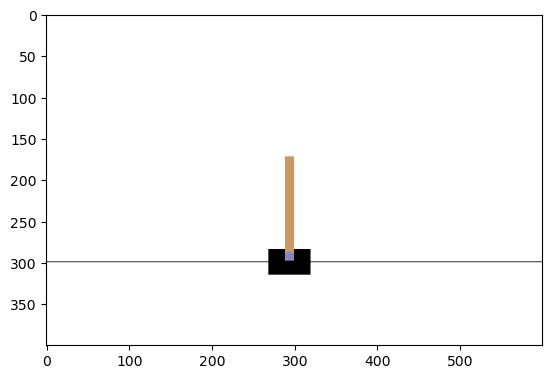

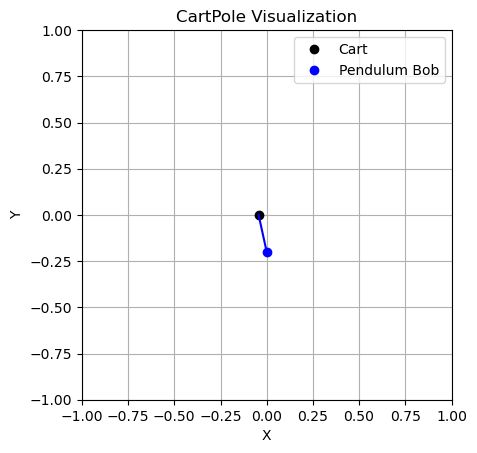


STEP:  3
CART POSITION:  -0.03902831
CART VELOCITY:  0.43548232
POLE ANGLE WRT CART:  -0.004526183
VELOCITY AT TOP OF POLE:  -0.609384
ACTION: Push cart to right


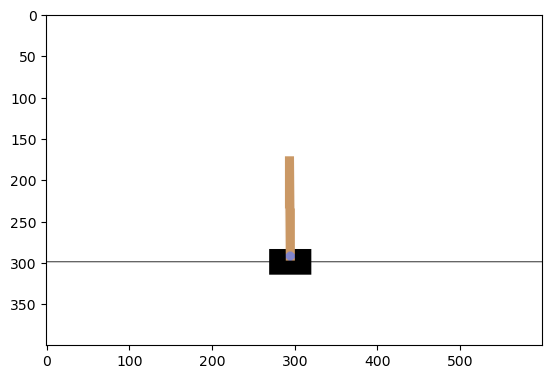

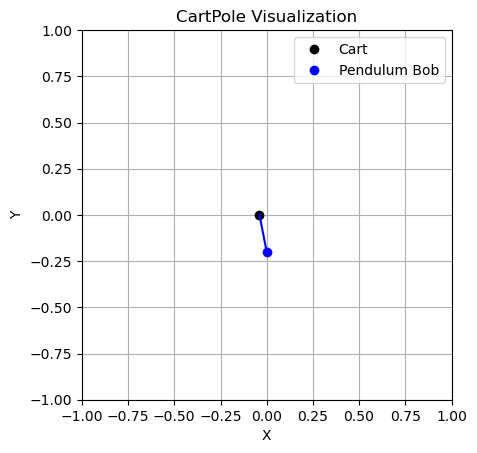


STEP:  4
CART POSITION:  -0.030318664
CART VELOCITY:  0.63066727
POLE ANGLE WRT CART:  -0.016713863
VELOCITY AT TOP OF POLE:  -0.9034891
ACTION: Push cart to right


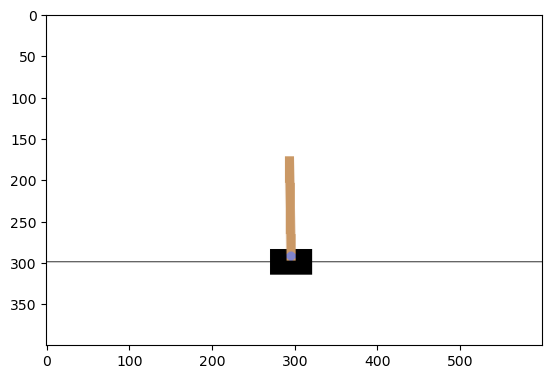

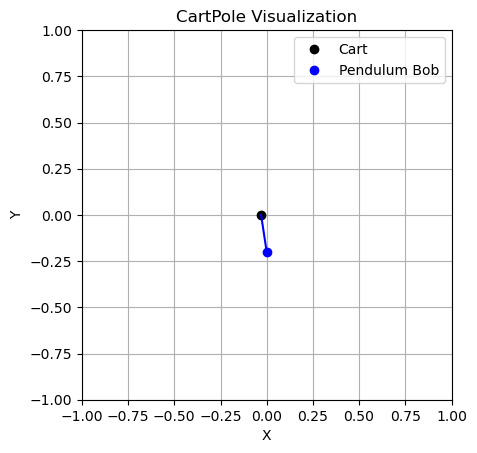


STEP:  5
CART POSITION:  -0.01770532
CART VELOCITY:  0.82601154
POLE ANGLE WRT CART:  -0.034783646
VELOCITY AT TOP OF POLE:  -1.2013782
ACTION: Push cart to right


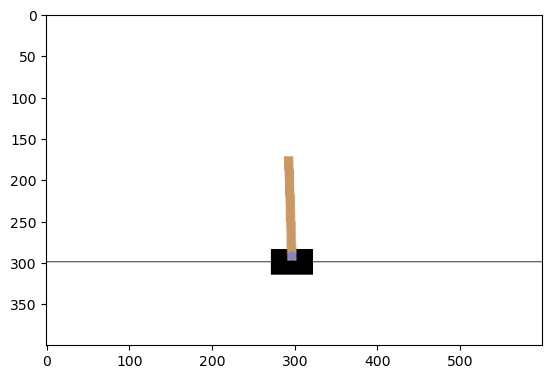

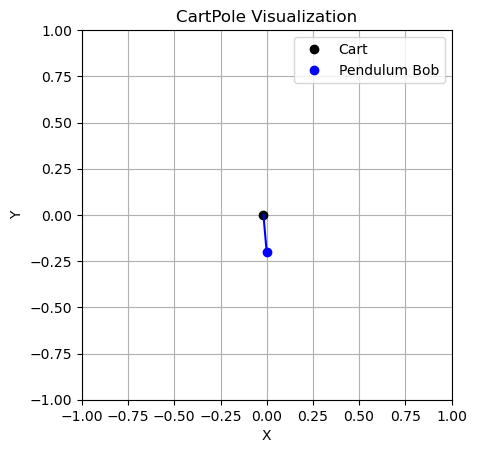


STEP:  6
CART POSITION:  -0.0011850885
CART VELOCITY:  1.0215657
POLE ANGLE WRT CART:  -0.05881121
VELOCITY AT TOP OF POLE:  -1.5047563
ACTION: Push cart to right


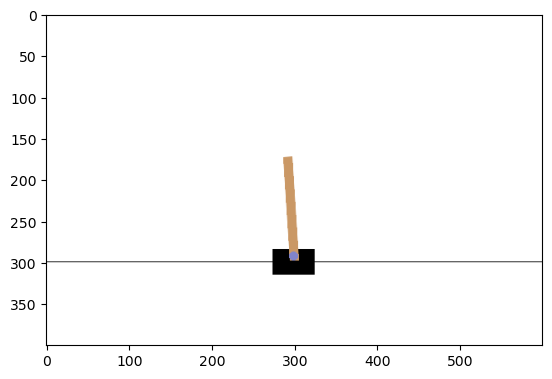

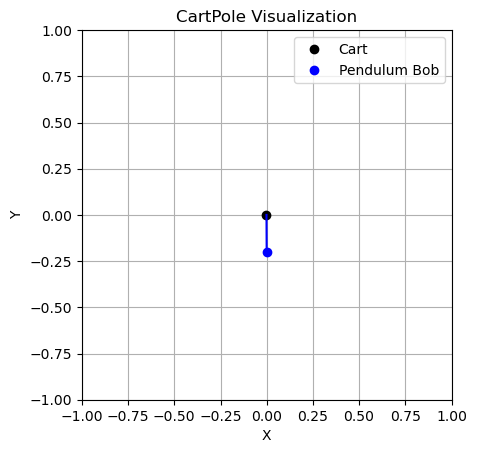


STEP:  7
CART POSITION:  0.019246224
CART VELOCITY:  1.2173498
POLE ANGLE WRT CART:  -0.08890634
VELOCITY AT TOP OF POLE:  -1.8152053
ACTION: Push cart to right


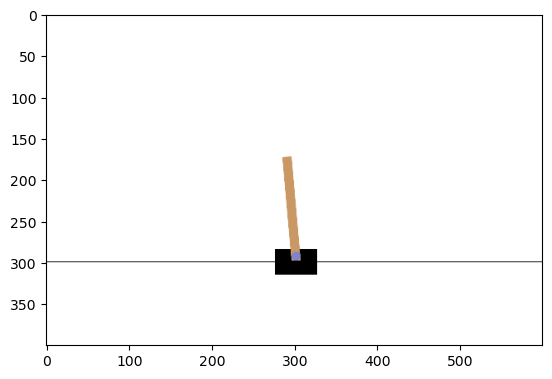

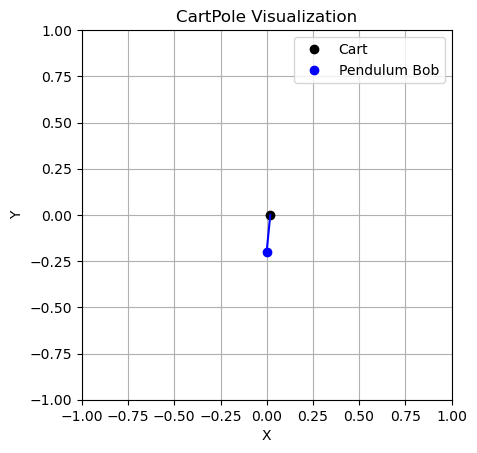


STEP:  8
CART POSITION:  0.04359322
CART VELOCITY:  1.4133416
POLE ANGLE WRT CART:  -0.12521045
VELOCITY AT TOP OF POLE:  -2.134136
ACTION: Push cart to right


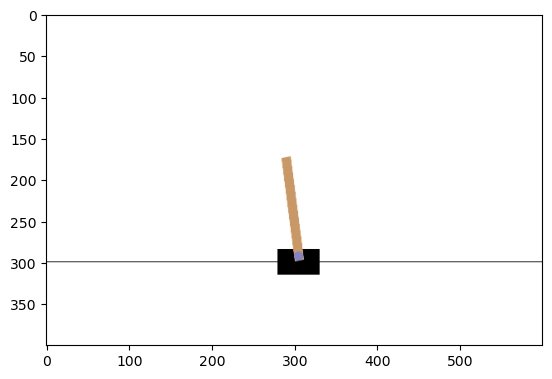

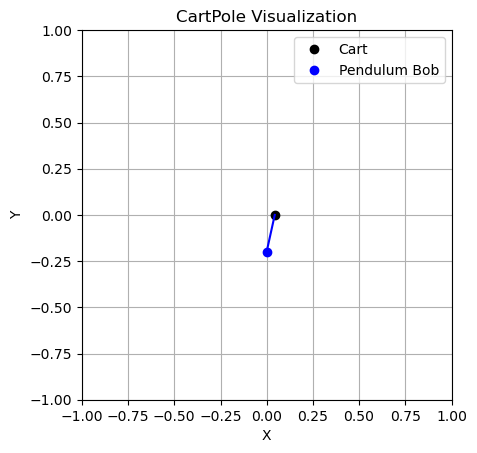


STEP:  9
CART POSITION:  0.07186005
CART VELOCITY:  1.6094618
POLE ANGLE WRT CART:  -0.16789316
VELOCITY AT TOP OF POLE:  -2.462729
ACTION: Push cart to right


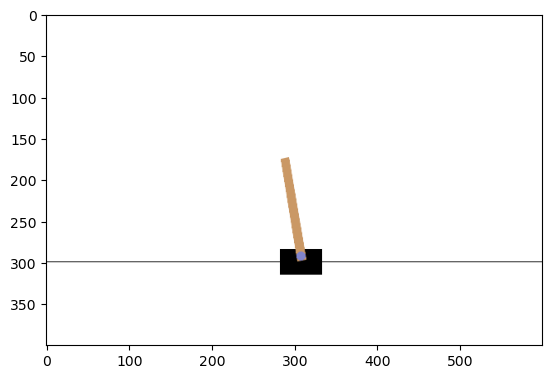

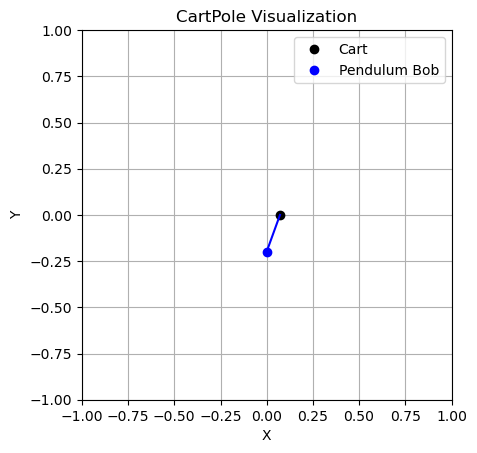

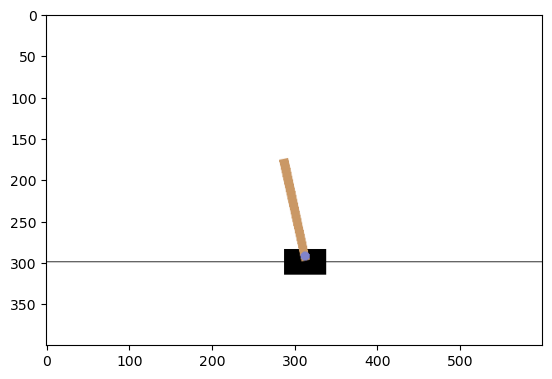

In [10]:
for i in trange(n_episodes):
    total_reward = agent.run_episode()
    episodic_rewards.append(total_reward)

Text(0, 0.5, 'Rewards')

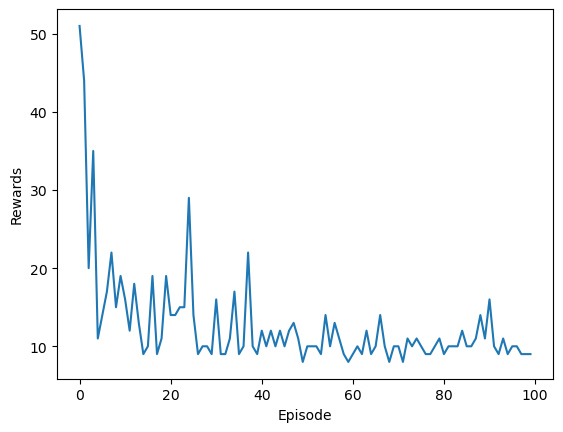

In [11]:
plt.plot(episodic_rewards)
plt.xlabel("Episode")
plt.ylabel("Rewards")

Text(0, 0.5, 'Loss')

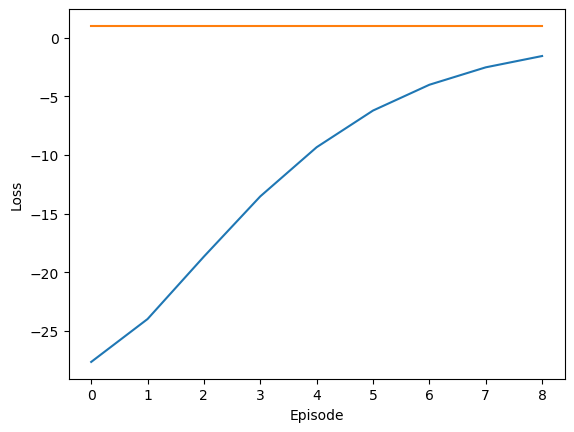

In [12]:
plt.plot(episodic_loss)
plt.xlabel("Episode")
plt.ylabel("Loss")